<a href="https://colab.research.google.com/github/hugobaur/ear_predict/blob/main/Level_Water_Forcast_V2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Regressão Linear (Polinomial) + Tuning + Regularização

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import Ridge
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.pipeline import Pipeline

# Carregar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

# Preprocessamento
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d')

# Filtrar dados de Tucuruí
df_tucurui = df[df.id_posto == 275]

# Definir o índice de tempo
df_tucurui.set_index('id_tempo', inplace=True)
df_tucurui = df_tucurui.asfreq('D').sort_index()

In [ ]:
# Adicionar características sazonais
df_tucurui['month'] = df_tucurui.index.month
df_tucurui['dayofyear'] = df_tucurui.index.dayofyear

# Separação dos dados em treino, validação e teste
train_val, test = train_test_split(df_tucurui, test_size=0.15, shuffle=False)
train, val = train_test_split(train_val, test_size=0.1765, shuffle=False)  # 0.1765 * 0.85 ≈ 0.15

train = train.dropna(subset=['volume_armazenado'])
val = val.dropna(subset=['volume_armazenado'])
test = test.dropna(subset=['volume_armazenado'])

# Features e target
train_features = train[['month', 'dayofyear']]
val_features = val[['month', 'dayofyear']]
test_features = test[['month', 'dayofyear']]
train_target = train['volume_armazenado']
val_target = val['volume_armazenado']
test_target = test['volume_armazenado']


In [ ]:
# Definir o pipeline de Regressão Polinomial com normalização e regularização Ridge
pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Normalizar as características
    ('poly', PolynomialFeatures()),
    ('ridge', Ridge())
])

# Definir a grade de parâmetros para a busca
param_grid = {
    'poly__degree': [2, 3, 4],
    'ridge__alpha': [0.1, 1.0, 10.0, 100.0]  # Aumentar o intervalo de alpha para testar valores maiores
}

# Executar a busca em grade
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='r2', n_jobs=-1)
grid_search.fit(train_features, train_target)

# Exibir os melhores parâmetros
best_params = grid_search.best_params_
print(f'Melhores parâmetros: {best_params}')


Melhores parâmetros: {'poly__degree': 3, 'ridge__alpha': 0.1}


In [ ]:
# Fazer previsões com o modelo ajustado
train_pred_poly = grid_search.predict(train_features)
val_pred_poly = grid_search.predict(val_features)
test_pred_poly = grid_search.predict(test_features)


In [ ]:
# Calcular métricas para a Regressão Polinomial com os melhores parâmetros
def calculate_metrics(y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mre = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    return r2, rmse, mre

metrics_poly_train = calculate_metrics(train_target, train_pred_poly)
metrics_poly_val = calculate_metrics(val_target, val_pred_poly)
metrics_poly_test = calculate_metrics(test_target, test_pred_poly)

print(f"Regressão Polinomial Treino - R²: {metrics_poly_train[0]}, RMSE: {metrics_poly_train[1]}, MRE: {metrics_poly_train[2]}%")
print(f"Regressão Polinomial Validação - R²: {metrics_poly_val[0]}, RMSE: {metrics_poly_val[1]}, MRE: {metrics_poly_val[2]}%")
print(f"Regressão Polinomial Teste - R²: {metrics_poly_test[0]}, RMSE: {metrics_poly_test[1]}, MRE: {metrics_poly_test[2]}%")


Regressão Polinomial Treino - R²: 0.9066587983115113, RMSE: 9.237464132240229, MRE: 14.125736958386995%
Regressão Polinomial Validação - R²: -0.2371973176255635, RMSE: 26.260843030925308, MRE: 25.143795287323194%
Regressão Polinomial Teste - R²: 0.6799277743186884, RMSE: 14.76713147372304, MRE: 15.926368708832713%


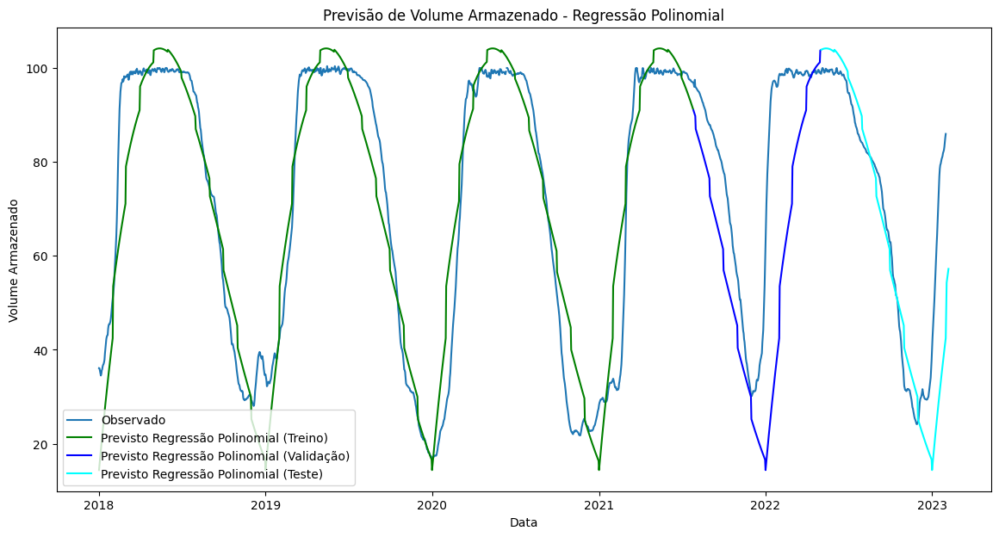

In [ ]:
# Plotar previsões Regressão Polinomial para treino, validação e teste
plt.figure(figsize=(14, 7))

# Plotar dados observados
plt.plot(df_tucurui.index, df_tucurui['volume_armazenado'], label='Observado')

# Plotar previsões Regressão Polinomial
plt.plot(train.index, train_pred_poly, label='Previsto Regressão Polinomial (Treino)', color='green')
plt.plot(val.index, val_pred_poly, label='Previsto Regressão Polinomial (Validação)', color='blue')
plt.plot(test.index, test_pred_poly, label='Previsto Regressão Polinomial (Teste)', color='cyan')

plt.title('Previsão de Volume Armazenado - Regressão Polinomial')
plt.xlabel('Data')
plt.ylabel('Volume Armazenado')
plt.legend()
plt.show()


# TESTE DE LINEARIDADE

## 1

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, r2_score
import statsmodels.api as sm
from statsmodels.stats.diagnostic import linear_reset

# Carregar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

# Preprocessamento
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d')

# Filtrar dados de Tucuruí
df_tucurui = df[df.id_posto == 275]

# Definir o índice de tempo
df_tucurui.set_index('id_tempo', inplace=True)
df_tucurui = df_tucurui.asfreq('D').sort_index()

# Apenas garantir que não haja NaNs
df_tucurui = df_tucurui.fillna(method='ffill')
df_tucurui = df_tucurui.fillna(method='bfill')

# Separação dos dados em treino e teste
train, test = train_test_split(df_tucurui, test_size=0.2, shuffle=False)

train_target = train['volume_armazenado']
test_target = test['volume_armazenado']

def calculate_metrics(y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mre = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    return r2, rmse, mre

# Função para ajustar e avaliar modelos polinomiais
def evaluate_polynomial_model(degree, train_features, train_target, test_features, test_target):
    model = Pipeline([
        ('poly', PolynomialFeatures(degree=degree)),
        ('linear', LinearRegression())
    ])
    model.fit(train_features, train_target)

    train_pred = model.predict(train_features)
    test_pred = model.predict(test_features)

    train_metrics = calculate_metrics(train_target, train_pred)
    test_metrics = calculate_metrics(test_target, test_pred)

    return model, train_metrics, test_metrics

# Função para executar o teste de Ramsey RESET
def ramsey_reset_test(model, features, target):
    features = PolynomialFeatures(degree=1).fit_transform(features)  # Ajuste para garantir a interceptação
    ols_model = sm.OLS(target, features).fit()
    reset_test = linear_reset(ols_model, test_type='fitted', power=2, use_f=True)
    return reset_test

# Avaliar modelos com polinômios de grau 1, 2 e 3
degrees = [1, 2, 3]
results = {}

for degree in degrees:
    model, train_metrics, test_metrics = evaluate_polynomial_model(degree, train[['volume_armazenado']], train_target, test[['volume_armazenado']], test_target)
    results[degree] = {
        'train': train_metrics,
        'test': test_metrics
    }

    if degree == 1:
        reset_test = ramsey_reset_test(model.named_steps['linear'], train[['volume_armazenado']], train_target)
        results[degree]['reset_test'] = reset_test

    print(f"Modelo Polinomial Grau {degree} - Treino: R²: {train_metrics[0]}, RMSE: {train_metrics[1]}, MRE: {train_metrics[2]}%")
    print(f"Modelo Polinomial Grau {degree} - Teste: R²: {test_metrics[0]}, RMSE: {test_metrics[1]}, MRE: {test_metrics[2]}%")
    if degree == 1:
        print(f"Teste de Ramsey RESET (Grau {degree}): {reset_test}")
    print("----------")

# Função de decisão para determinar se o modelo é linear ou não-linear
def is_non_linear(results):
    improvement_threshold = 0.05  # Limite de melhoria de R² para considerar não-linear
    reset_test_p_value_threshold = 0.05  # Limite de p-value para o teste de Ramsey RESET

    # Verificar se o modelo polinomial de grau 2 ou 3 melhora significativamente o R² em relação ao grau 1
    if results[2]['test'][0] - results[1]['test'][0] > improvement_threshold or results[3]['test'][0] - results[1]['test'][0] > improvement_threshold:
        return True

    # Verificar o p-value do teste de Ramsey RESET para o modelo de grau 1
    reset_test_p_value = results[1]['reset_test'].pvalue
    if reset_test_p_value < reset_test_p_value_threshold:
        return True

    return False

# Determinar se o modelo é linear ou não-linear
if is_non_linear(results):
    print("A relação é não-linear.")
else:
    print("A relação é linear.")


Modelo Polinomial Grau 1 - Treino: R²: 1.0, RMSE: 2.842170943040401e-14, MRE: 5.252577721749605e-14%
Modelo Polinomial Grau 1 - Teste: R²: 1.0, RMSE: 2.842170943040401e-14, MRE: 4.5437114789931026e-14%
Teste de Ramsey RESET (Grau 1): <F test: F=0.35814172167624225, p=0.5496312340990014, df_denom=1.49e+03, df_num=1>
----------
Modelo Polinomial Grau 2 - Treino: R²: 1.0, RMSE: 2.7243184272843844e-13, MRE: 4.924212319705782e-13%
Modelo Polinomial Grau 2 - Teste: R²: 1.0, RMSE: 2.576860620274634e-13, MRE: 3.89638146724059e-13%
----------
Modelo Polinomial Grau 3 - Treino: R²: 1.0, RMSE: 7.268441660475054e-11, MRE: 1.4388092499955033e-10%
Modelo Polinomial Grau 3 - Teste: R²: 1.0, RMSE: 6.613523107517813e-11, MRE: 1.0779065075670052e-10%
----------
A relação é linear.


## 2

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, r2_score
import statsmodels.api as sm
from statsmodels.stats.diagnostic import linear_reset

# Carregar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

# Preprocessamento
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d')

# Filtrar dados de Tucuruí
df_tucurui = df[df.id_posto == 275]

# Definir o índice de tempo
df_tucurui.set_index('id_tempo', inplace=True)
df_tucurui = df_tucurui.asfreq('D').sort_index()

# Apenas garantir que não haja NaNs
df_tucurui = df_tucurui.fillna(method='ffill')
df_tucurui = df_tucurui.fillna(method='bfill')

# Adicionar ruído sintético aos dados para teste de robustez
noise = np.random.normal(0, 0.01, df_tucurui['volume_armazenado'].shape)
df_tucurui['volume_armazenado_noisy'] = df_tucurui['volume_armazenado'] + noise

# Separação dos dados em treino e teste
train, test = train_test_split(df_tucurui, test_size=0.2, shuffle=False)

train_target = train['volume_armazenado_noisy']
test_target = test['volume_armazenado_noisy']

def calculate_metrics(y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mre = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    return r2, rmse, mre

# Função para ajustar e avaliar modelos polinomiais
def evaluate_polynomial_model(degree, train_features, train_target, test_features, test_target):
    model = Pipeline([
        ('poly', PolynomialFeatures(degree=degree)),
        ('linear', LinearRegression())
    ])
    model.fit(train_features, train_target)

    train_pred = model.predict(train_features)
    test_pred = model.predict(test_features)

    train_metrics = calculate_metrics(train_target, train_pred)
    test_metrics = calculate_metrics(test_target, test_pred)

    return model, train_metrics, test_metrics

# Função para executar o teste de Ramsey RESET
def ramsey_reset_test(model, features, target):
    features = PolynomialFeatures(degree=1).fit_transform(features)  # Ajuste para garantir a interceptação
    ols_model = sm.OLS(target, features).fit()
    reset_test = linear_reset(ols_model, test_type='fitted', power=2, use_f=True)
    return reset_test

# Avaliar modelos com polinômios de grau 1, 2 e 3
degrees = [1, 2, 3]
results = {}

for degree in degrees:
    model, train_metrics, test_metrics = evaluate_polynomial_model(degree, train[['volume_armazenado_noisy']], train_target, test[['volume_armazenado_noisy']], test_target)
    results[degree] = {
        'train': train_metrics,
        'test': test_metrics
    }

    if degree == 1:
        reset_test = ramsey_reset_test(model.named_steps['linear'], train[['volume_armazenado_noisy']], train_target)
        results[degree]['reset_test'] = reset_test

    print(f"Modelo Polinomial Grau {degree} - Treino: R²: {train_metrics[0]}, RMSE: {train_metrics[1]}, MRE: {train_metrics[2]}%")
    print(f"Modelo Polinomial Grau {degree} - Teste: R²: {test_metrics[0]}, RMSE: {test_metrics[1]}, MRE: {test_metrics[2]}%")
    if degree == 1:
        print(f"Teste de Ramsey RESET (Grau {degree}): {reset_test}")
    print("----------")

# Função de decisão para determinar se o modelo é linear ou não-linear
def is_non_linear(results):
    improvement_threshold = 0.05  # Limite de melhoria de R² para considerar não-linear
    reset_test_p_value_threshold = 0.05  # Limite de p-value para o teste de Ramsey RESET

    # Verificar se o modelo polinomial de grau 2 ou 3 melhora significativamente o R² em relação ao grau 1
    if results[2]['test'][0] - results[1]['test'][0] > improvement_threshold or results[3]['test'][0] - results[1]['test'][0] > improvement_threshold:
        return True

    # Verificar o p-value do teste de Ramsey RESET para o modelo de grau 1
    reset_test_p_value = results[1]['reset_test'].pvalue
    if reset_test_p_value < reset_test_p_value_threshold:
        return True

    return False

# Determinar se o modelo é linear ou não-linear
if is_non_linear(results):
    print("A relação é não-linear.")
else:
    print("A relação é linear.")


Modelo Polinomial Grau 1 - Treino: R²: 1.0, RMSE: 1.2172129728602857e-13, MRE: 1.928934538630225e-13%
Modelo Polinomial Grau 1 - Teste: R²: 1.0, RMSE: 1.2530314586571324e-13, MRE: 1.781989734103678e-13%
Teste de Ramsey RESET (Grau 1): <F test: F=4.20504820878212, p=0.040478789339715285, df_denom=1.49e+03, df_num=1>
----------
Modelo Polinomial Grau 2 - Treino: R²: 1.0, RMSE: 1.3417076116151055e-13, MRE: 2.8395122722401424e-13%
Modelo Polinomial Grau 2 - Teste: R²: 1.0, RMSE: 1.1764034692173577e-13, MRE: 2.097566997146452e-13%
----------
Modelo Polinomial Grau 3 - Treino: R²: 1.0, RMSE: 4.835300008313544e-11, MRE: 9.603483377101599e-11%
Modelo Polinomial Grau 3 - Teste: R²: 1.0, RMSE: 4.399332089393146e-11, MRE: 7.224133139584068e-11%
----------
A relação é não-linear.


## 3

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, r2_score
import statsmodels.api as sm
from statsmodels.stats.diagnostic import linear_reset

# Carregar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

# Preprocessamento
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d')

# Filtrar dados de Tucuruí
df_tucurui = df[df.id_posto == 275]

# Definir o índice de tempo
df_tucurui.set_index('id_tempo', inplace=True)
df_tucurui = df_tucurui.asfreq('D').sort_index()

# Apenas garantir que não haja NaNs
df_tucurui = df_tucurui.fillna(method='ffill')
df_tucurui = df_tucurui.fillna(method='bfill')

# Separação dos dados em treino e teste
train, test = train_test_split(df_tucurui, test_size=0.2, shuffle=False)

# Adicionar ruído sintético aos dados para teste de robustez
noise = np.random.normal(0, 0.01, train['volume_armazenado'].shape)
train['volume_armazenado_noisy'] = train['volume_armazenado'] + noise
test['volume_armazenado_noisy'] = test['volume_armazenado']  # Não adicionar ruído ao conjunto de teste para avaliação

train_target = train['volume_armazenado_noisy']
test_target = test['volume_armazenado_noisy']

def calculate_metrics(y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mre = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    return r2, rmse, mre

# Função para ajustar e avaliar modelos polinomiais
def evaluate_polynomial_model(degree, train_features, train_target, test_features, test_target):
    model = Pipeline([
        ('poly', PolynomialFeatures(degree=degree)),
        ('linear', LinearRegression())
    ])
    model.fit(train_features, train_target)

    train_pred = model.predict(train_features)
    test_pred = model.predict(test_features)

    train_metrics = calculate_metrics(train_target, train_pred)
    test_metrics = calculate_metrics(test_target, test_pred)

    return model, train_metrics, test_metrics

# Função para executar o teste de Ramsey RESET
def ramsey_reset_test(model, features, target):
    features = PolynomialFeatures(degree=1).fit_transform(features)  # Ajuste para garantir a interceptação
    ols_model = sm.OLS(target, features).fit()
    reset_test = linear_reset(ols_model, test_type='fitted', power=2, use_f=True)
    return reset_test

# Avaliar modelos com polinômios de grau 1, 2 e 3
degrees = [1, 2, 3]
results = {}

for degree in degrees:
    model, train_metrics, test_metrics = evaluate_polynomial_model(degree, train[['volume_armazenado_noisy']], train_target, test[['volume_armazenado_noisy']], test_target)
    results[degree] = {
        'train': train_metrics,
        'test': test_metrics
    }

    if degree == 1:
        reset_test = ramsey_reset_test(model.named_steps['linear'], train[['volume_armazenado_noisy']], train_target)
        results[degree]['reset_test'] = reset_test

    print(f"Modelo Polinomial Grau {degree} - Treino: R²: {train_metrics[0]}, RMSE: {train_metrics[1]}, MRE: {train_metrics[2]}%")
    print(f"Modelo Polinomial Grau {degree} - Teste: R²: {test_metrics[0]}, RMSE: {test_metrics[1]}, MRE: {test_metrics[2]}%")
    if degree == 1:
        print(f"Teste de Ramsey RESET (Grau {degree}): {reset_test}")
    print("----------")

# Função de decisão para determinar se o modelo é linear ou não-linear
def is_non_linear(results):
    improvement_threshold = 0.05  # Limite de melhoria de R² para considerar não-linear
    reset_test_p_value_threshold = 0.05  # Limite de p-value para o teste de Ramsey RESET

    # Verificar se o modelo polinomial de grau 2 ou 3 melhora significativamente o R² em relação ao grau 1
    if results[2]['test'][0] - results[1]['test'][0] > improvement_threshold or results[3]['test'][0] - results[1]['test'][0] > improvement_threshold:
        return True

    # Verificar o p-value do teste de Ramsey RESET para o modelo de grau 1
    reset_test_p_value = results[1]['reset_test'].pvalue
    if reset_test_p_value < reset_test_p_value_threshold:
        return True

    return False

# Determinar se o modelo é linear ou não-linear
if is_non_linear(results):
    print("A relação é não-linear.")
else:
    print("A relação é linear.")


Modelo Polinomial Grau 1 - Treino: R²: 1.0, RMSE: 1.73276009561511e-14, MRE: 3.4836607867726566e-14%
Modelo Polinomial Grau 1 - Teste: R²: 1.0, RMSE: 1.4674755622577528e-14, MRE: 2.3781189978060164e-14%
Teste de Ramsey RESET (Grau 1): <F test: F=0.45182260341382274, p=0.5015751216080007, df_denom=1.49e+03, df_num=1>
----------
Modelo Polinomial Grau 2 - Treino: R²: 1.0, RMSE: 3.5906928115637414e-13, MRE: 7.100816563081329e-13%
Modelo Polinomial Grau 2 - Teste: R²: 1.0, RMSE: 3.288572940541222e-13, MRE: 5.370309276032853e-13%
----------
Modelo Polinomial Grau 3 - Treino: R²: 1.0, RMSE: 3.396604807152959e-11, MRE: 6.906362899160307e-11%
Modelo Polinomial Grau 3 - Teste: R²: 1.0, RMSE: 3.0397314190876806e-11, MRE: 5.1047884505559724e-11%
----------
A relação é linear.


## 4

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, r2_score
import statsmodels.api as sm
from statsmodels.stats.diagnostic import linear_reset

# Carregar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

# Preprocessamento
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d')

# Filtrar dados de Tucuruí
df_tucurui = df[df.id_posto == 275]

# Definir o índice de tempo
df_tucurui.set_index('id_tempo', inplace=True)
df_tucurui = df_tucurui.asfreq('D').sort_index()

# Apenas garantir que não haja NaNs
df_tucurui = df_tucurui.fillna(method='ffill')
df_tucurui = df_tucurui.fillna(method='bfill')

# Separação dos dados em treino e teste
train, test = train_test_split(df_tucurui, test_size=0.2, shuffle=False)

# Adicionar ruído sintético aos dados de treino
noise_train = np.random.normal(0, 0.01, train['volume_armazenado'].shape)
train['volume_armazenado_noisy'] = train['volume_armazenado'] + noise_train

# Manter o conjunto de teste sem ruído para avaliação
test['volume_armazenado_noisy'] = test['volume_armazenado']

train_target = train['volume_armazenado_noisy']
test_target = test['volume_armazenado_noisy']

def calculate_metrics(y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mre = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    return r2, rmse, mre
# Função para ajustar e avaliar modelos polinomiais
def evaluate_polynomial_model(degree, train_features, train_target):
    model = Pipeline([
        ('poly', PolynomialFeatures(degree=degree)),
        ('linear', LinearRegression())
    ])
    # Validação cruzada para avaliar o modelo
    cv_scores = cross_val_score(model, train_features, train_target, cv=5, scoring='r2')
    model.fit(train_features, train_target)

    train_pred = model.predict(train_features)

    train_metrics = calculate_metrics(train_target, train_pred)

    return model, train_metrics, cv_scores.mean()

# Função para executar o teste de Ramsey RESET
def ramsey_reset_test(model, features, target):
    features = PolynomialFeatures(degree=1).fit_transform(features)  # Ajuste para garantir a interceptação
    ols_model = sm.OLS(target, features).fit()
    reset_test = linear_reset(ols_model, test_type='fitted', power=2, use_f=True)
    return reset_test
# Avaliar modelos com polinômios de grau 1, 2 e 3
degrees = [1, 2, 3]
results = {}

for degree in degrees:
    model, train_metrics, cv_r2_mean = evaluate_polynomial_model(degree, train[['volume_armazenado_noisy']], train_target)
    results[degree] = {
        'train': train_metrics,
        'cv_r2_mean': cv_r2_mean
    }

    if degree == 1:
        reset_test = ramsey_reset_test(model.named_steps['linear'], train[['volume_armazenado_noisy']], train_target)
        results[degree]['reset_test'] = reset_test

    print(f"Modelo Polinomial Grau {degree} - Treino: R²: {train_metrics[0]}, RMSE: {train_metrics[1]}, MRE: {train_metrics[2]}%")
    print(f"Modelo Polinomial Grau {degree} - Validação Cruzada: R² Médio: {cv_r2_mean}")
    if degree == 1:
        print(f"Teste de Ramsey RESET (Grau {degree}): {reset_test}")
    print("----------")
# Função de decisão para determinar se o modelo é linear ou não-linear
def is_non_linear(results):
    improvement_threshold = 0.05  # Limite de melhoria de R² para considerar não-linear
    reset_test_p_value_threshold = 0.05  # Limite de p-value para o teste de Ramsey RESET

    # Verificar se o modelo polinomial de grau 2 ou 3 melhora significativamente o R² em relação ao grau 1
    if results[2]['cv_r2_mean'] - results[1]['cv_r2_mean'] > improvement_threshold or results[3]['cv_r2_mean'] - results[1]['cv_r2_mean'] > improvement_threshold:
        return True

    # Verificar o p-value do teste de Ramsey RESET para o modelo de grau 1
    reset_test_p_value = results[1]['reset_test'].pvalue
    if reset_test_p_value < reset_test_p_value_threshold:
        return True

    return False

# Determinar se o modelo é linear ou não-linear
if is_non_linear(results):
    print("A relação é não-linear.")
else:
    print("A relação é linear.")


Modelo Polinomial Grau 1 - Treino: R²: 1.0, RMSE: 2.842170943040401e-14, MRE: 5.252598219863775e-14%
Modelo Polinomial Grau 1 - Validação Cruzada: R² Médio: 1.0
Teste de Ramsey RESET (Grau 1): <F test: F=2.161294117224557, p=0.1417370009352794, df_denom=1.49e+03, df_num=1>
----------
Modelo Polinomial Grau 2 - Treino: R²: 1.0, RMSE: 2.8667406062335645e-13, MRE: 5.693803318916475e-13%
Modelo Polinomial Grau 2 - Validação Cruzada: R² Médio: 1.0
----------
Modelo Polinomial Grau 3 - Treino: R²: 1.0, RMSE: 3.159027201015031e-11, MRE: 6.173961118582722e-11%
Modelo Polinomial Grau 3 - Validação Cruzada: R² Médio: 1.0
----------
A relação é linear.


## 5

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, r2_score
import statsmodels.api as sm
from statsmodels.stats.diagnostic import linear_reset

# Carregar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

# Preprocessamento
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d')

# Filtrar dados de Tucuruí
df_tucurui = df[df.id_posto == 275]

# Definir o índice de tempo
df_tucurui.set_index('id_tempo', inplace=True)
df_tucurui = df_tucurui.asfreq('D').sort_index()

# Apenas garantir que não haja NaNs
df_tucurui = df_tucurui.fillna(method='ffill')
df_tucurui = df_tucurui.fillna(method='bfill')

# Separação dos dados em treino e teste
train, test = train_test_split(df_tucurui, test_size=0.2, shuffle=False)

# Adicionar ruído sintético aos dados de treino
noise_train = np.random.normal(0, 0.1, train['volume_armazenado'].shape)  # Aumentar a magnitude do ruído
train['volume_armazenado_noisy'] = train['volume_armazenado'] + noise_train

# Manter o conjunto de teste sem ruído para avaliação
test['volume_armazenado_noisy'] = test['volume_armazenado']

train_target = train['volume_armazenado_noisy']
test_target = test['volume_armazenado_noisy']

def calculate_metrics(y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mre = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    return r2, rmse, mre

# Função para ajustar e avaliar modelos polinomiais
def evaluate_polynomial_model(degree, train_features, train_target):
    model = Pipeline([
        ('poly', PolynomialFeatures(degree=degree)),
        ('linear', LinearRegression())
    ])
    # Validação cruzada para avaliar o modelo
    cv_scores = cross_val_score(model, train_features, train_target, cv=5, scoring='r2')
    model.fit(train_features, train_target)

    train_pred = model.predict(train_features)

    train_metrics = calculate_metrics(train_target, train_pred)

    return model, train_metrics, cv_scores.mean()

# Função para executar o teste de Ramsey RESET
def ramsey_reset_test(model, features, target):
    features = PolynomialFeatures(degree=1).fit_transform(features)  # Ajuste para garantir a interceptação
    ols_model = sm.OLS(target, features).fit()
    reset_test = linear_reset(ols_model, test_type='fitted', power=2, use_f=True)
    return reset_test

# Avaliar modelos com polinômios de grau 1, 2 e 3
degrees = [1, 2, 3]
results = {}

for degree in degrees:
    model, train_metrics, cv_r2_mean = evaluate_polynomial_model(degree, train[['volume_armazenado_noisy']], train_target)
    results[degree] = {
        'train': train_metrics,
        'cv_r2_mean': cv_r2_mean
    }

    if degree == 1:
        reset_test = ramsey_reset_test(model.named_steps['linear'], train[['volume_armazenado_noisy']], train_target)
        results[degree]['reset_test'] = reset_test

    print(f"Modelo Polinomial Grau {degree} - Treino: R²: {train_metrics[0]}, RMSE: {train_metrics[1]}, MRE: {train_metrics[2]}%")
    print(f"Modelo Polinomial Grau {degree} - Validação Cruzada: R² Médio: {cv_r2_mean}")
    if degree == 1:
        print(f"Teste de Ramsey RESET (Grau {degree}): {reset_test}")
    print("----------")

# Função de decisão para determinar se o modelo é linear ou não-linear
def is_non_linear(results):
    improvement_threshold = 0.05  # Limite de melhoria de R² para considerar não-linear
    reset_test_p_value_threshold = 0.05  # Limite de p-value para o teste de Ramsey RESET

    # Verificar se o modelo polinomial de grau 2 ou 3 melhora significativamente o R² em relação ao grau 1
    if results[2]['cv_r2_mean'] - results[1]['cv_r2_mean'] > improvement_threshold or results[3]['cv_r2_mean'] - results[1]['cv_r2_mean'] > improvement_threshold:
        return True

    # Verificar o p-value do teste de Ramsey RESET para o modelo de grau 1
    reset_test_p_value = results[1]['reset_test'].pvalue
    if reset_test_p_value < reset_test_p_value_threshold:
        return True

    return False

# Determinar se o modelo é linear ou não-linear
if is_non_linear(results):
    print("A relação é não-linear.")
else:
    print("A relação é linear.")


Modelo Polinomial Grau 1 - Treino: R²: 1.0, RMSE: 2.5429812130952495e-14, MRE: 4.180227573326626e-14%
Modelo Polinomial Grau 1 - Validação Cruzada: R² Médio: 1.0
Teste de Ramsey RESET (Grau 1): <F test: F=0.3018065907719038, p=0.5828345500869341, df_denom=1.49e+03, df_num=1>
----------
Modelo Polinomial Grau 2 - Treino: R²: 1.0, RMSE: 2.959221985686109e-13, MRE: 6.113549256560402e-13%
Modelo Polinomial Grau 2 - Validação Cruzada: R² Médio: 1.0
----------
Modelo Polinomial Grau 3 - Treino: R²: 1.0, RMSE: 3.244509782817124e-11, MRE: 5.896925699527444e-11%
Modelo Polinomial Grau 3 - Validação Cruzada: R² Médio: 1.0
----------
A relação é linear.


## 6

Execute o código para carregar os dados, adicionar ruído ao conjunto de treino, excluir volume_armazenado das features, dividir em conjuntos de treino e teste, ajustar modelos polinomiais de diferentes graus, obter resumos detalhados dos modelos, executar o teste de Ramsey RESET e determinar se a relação é linear ou não-linear com base nas melhorias de 𝑅2 e no valor p do teste de Ramsey RESET. Verifique as saídas para garantir que o ruído está sendo adicionado corretamente e que os resumos dos modelos fornecem as informações detalhadas necessárias.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, r2_score
import statsmodels.api as sm
from statsmodels.stats.diagnostic import linear_reset

# Carregar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

# Preprocessamento
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d')

# Filtrar dados de Tucuruí
df_tucurui = df[df.id_posto == 275]

# Definir o índice de tempo
df_tucurui.set_index('id_tempo', inplace=True)
df_tucurui = df_tucurui.asfreq('D').sort_index()

# Apenas garantir que não haja NaNs
df_tucurui = df_tucurui.fillna(method='ffill')
df_tucurui = df_tucurui.fillna(method='bfill')

# Separação dos dados em treino e teste
train, test = train_test_split(df_tucurui, test_size=0.2, shuffle=False)

# Adicionar ruído sintético aos dados de treino
noise_train = np.random.normal(0, 1, train['volume_armazenado'].shape)  # Aumentar significativamente a magnitude do ruído
train['volume_armazenado_noisy'] = train['volume_armazenado'] + noise_train

# Manter o conjunto de teste sem ruído para avaliação
test['volume_armazenado_noisy'] = test['volume_armazenado']

train_target = train['volume_armazenado_noisy']
test_target = test['volume_armazenado']

# Selecionar features (excluindo volume_armazenado para evitar overfitting)
features = ['vazao_natural', 'nivel_reservatorio', 'vazao_defluente', 'vazao_afluente', 'vazao_turbinada', 'vazao_vertida', 'vazao_restituida', 'vazao_transferida']

train_features = train[features]
test_features = test[features]

# Verificar a adição de ruído
print("Treino - Volume Armazenado Original: ", train['volume_armazenado'].head())
print("Treino - Volume Armazenado com Ruído: ", train['volume_armazenado_noisy'].head())

def calculate_metrics(y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mre = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    return r2, rmse, mre

# Função para ajustar e avaliar modelos polinomiais e retornar o summary
def evaluate_polynomial_model(degree, train_features, train_target):
    poly = PolynomialFeatures(degree=degree)
    X_poly = poly.fit_transform(train_features)

    model = sm.OLS(train_target, X_poly).fit()

    train_pred = model.predict(X_poly)

    train_metrics = calculate_metrics(train_target, train_pred)

    return model, train_metrics, model.summary()

# Função para executar o teste de Ramsey RESET
def ramsey_reset_test(model, features, target):
    features = PolynomialFeatures(degree=1).fit_transform(features)  # Ajuste para garantir a interceptação
    ols_model = sm.OLS(target, features).fit()
    reset_test = linear_reset(ols_model, test_type='fitted', power=2, use_f=True)
    return reset_test

# Avaliar modelos com polinômios de grau 1, 2 e 3
degrees = [1, 2, 3]
results = {}

for degree in degrees:
    model, train_metrics, summary = evaluate_polynomial_model(degree, train_features, train_target)
    results[degree] = {
        'train': train_metrics,
        'summary': summary
    }

    if degree == 1:
        reset_test = ramsey_reset_test(model, train_features, train_target)
        results[degree]['reset_test'] = reset_test

    print(f"Modelo Polinomial Grau {degree} - Treino: R²: {train_metrics[0]}, RMSE: {train_metrics[1]}, MRE: {train_metrics[2]}%")
    print(f"Resumo do Modelo Polinomial Grau {degree}:")
    print(summary)
    if degree == 1:
        print(f"Teste de Ramsey RESET (Grau {degree}): {reset_test}")
    print("----------")

# Função de decisão para determinar se o modelo é linear ou não-linear
def is_non_linear(results):
    improvement_threshold = 0.05  # Limite de melhoria de R² para considerar não-linear
    reset_test_p_value_threshold = 0.05  # Limite de p-value para o teste de Ramsey RESET

    # Verificar se o modelo polinomial de grau 2 ou 3 melhora significativamente o R² em relação ao grau 1
    if results[2]['train'][0] - results[1]['train'][0] > improvement_threshold or results[3]['train'][0] - results[1]['train'][0] > improvement_threshold:
        return True

    # Verificar o p-value do teste de Ramsey RESET para o modelo de grau 1
    reset_test_p_value = results[1]['reset_test'].pvalue
    if reset_test_p_value < reset_test_p_value_threshold:
        return True

    return False

# Determinar se o modelo é linear ou não-linear
if is_non_linear(results):
    print("A relação é não-linear.")
else:
    print("A relação é linear.")


Treino - Volume Armazenado Original:  id_tempo
2018-01-01    36.09
2018-01-02    36.05
2018-01-03    35.50
2018-01-04    34.87
2018-01-05    34.51
Freq: D, Name: volume_armazenado, dtype: float64
Treino - Volume Armazenado com Ruído:  id_tempo
2018-01-01    38.370724
2018-01-02    36.615944
2018-01-03    35.977846
2018-01-04    34.018608
2018-01-05    35.014342
Freq: D, Name: volume_armazenado_noisy, dtype: float64
Modelo Polinomial Grau 1 - Treino: R²: 0.9927342923033159, RMSE: 2.5119656651012336, MRE: 4.3454766717677895%
Resumo do Modelo Polinomial Grau 1:
                               OLS Regression Results                              
Dep. Variable:     volume_armazenado_noisy   R-squared:                       0.993
Model:                                 OLS   Adj. R-squared:                  0.993
Method:                      Least Squares   F-statistic:                 5.072e+04
Date:                     Mon, 17 Jun 2024   Prob (F-statistic):               0.00
Time:          

/usr/local/lib/python3.10/dist-packages/statsmodels/regression/linear_model.py:1967: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sqrt(eigvals[0]/eigvals[-1])


## 7

Execute o código para carregar os dados, dividir em conjuntos de treino e teste, ajustar modelos polinomiais de diferentes graus, obter resumos detalhados dos modelos, executar o teste de Ramsey RESET e determinar se a relação é linear ou não-linear com base nas melhorias de R2 e no valor p do teste de Ramsey RESET. Verifique as saídas para garantir que os resumos dos modelos fornecem as informações detalhadas necessárias

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, r2_score
import statsmodels.api as sm
from statsmodels.stats.diagnostic import linear_reset

# Carregar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

# Preprocessamento
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d')

# Filtrar dados de Tucuruí
df_tucurui = df[df.id_posto == 275]

# Definir o índice de tempo
df_tucurui.set_index('id_tempo', inplace=True)
df_tucurui = df_tucurui.asfreq('D').sort_index()

# Apenas garantir que não haja NaNs
df_tucurui = df_tucurui.fillna(method='ffill')
df_tucurui = df_tucurui.fillna(method='bfill')

# Separação dos dados em treino e teste
train, test = train_test_split(df_tucurui, test_size=0.2, shuffle=False)

# Sem adicionar ruído aos dados de treino e teste
train_target = train['volume_armazenado']
test_target = test['volume_armazenado']

# Selecionar features (excluindo volume_armazenado para evitar overfitting)
features = ['vazao_natural', 'nivel_reservatorio', 'vazao_defluente', 'vazao_afluente', 'vazao_turbinada', 'vazao_vertida', 'vazao_restituida', 'vazao_transferida']

train_features = train[features]
test_features = test[features]

def calculate_metrics(y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mre = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    return r2, rmse, mre

# Função para ajustar e avaliar modelos polinomiais e retornar o summary
def evaluate_polynomial_model(degree, train_features, train_target):
    poly = PolynomialFeatures(degree=degree)
    X_poly = poly.fit_transform(train_features)

    model = sm.OLS(train_target, X_poly).fit()

    train_pred = model.predict(X_poly)

    train_metrics = calculate_metrics(train_target, train_pred)

    return model, train_metrics, model.summary()

# Função para executar o teste de Ramsey RESET
def ramsey_reset_test(model, features, target):
    features = PolynomialFeatures(degree=1).fit_transform(features)  # Ajuste para garantir a interceptação
    ols_model = sm.OLS(target, features).fit()
    reset_test = linear_reset(ols_model, test_type='fitted', power=2, use_f=True)
    return reset_test

# Avaliar modelos com polinômios de grau 1, 2 e 3
degrees = [1, 2, 3]
results = {}

for degree in degrees:
    model, train_metrics, summary = evaluate_polynomial_model(degree, train_features, train_target)
    results[degree] = {
        'train': train_metrics,
        'summary': summary
    }

    if degree == 1:
        reset_test = ramsey_reset_test(model, train_features, train_target)
        results[degree]['reset_test'] = reset_test

    print(f"Modelo Polinomial Grau {degree} - Treino: R²: {train_metrics[0]}, RMSE: {train_metrics[1]}, MRE: {train_metrics[2]}%")
    print(f"Resumo do Modelo Polinomial Grau {degree}:")
    print(summary)
    if degree == 1:
        print(f"Teste de Ramsey RESET (Grau {degree}): {reset_test}")
    print("----------")

# Função de decisão para determinar se o modelo é linear ou não-linear
def is_non_linear(results):
    improvement_threshold = 0.05  # Limite de melhoria de R² para considerar não-linear
    reset_test_p_value_threshold = 0.05  # Limite de p-value para o teste de Ramsey RESET

    # Verificar se o modelo polinomial de grau 2 ou 3 melhora significativamente o R² em relação ao grau 1
    if results[2]['train'][0] - results[1]['train'][0] > improvement_threshold or results[3]['train'][0] - results[1]['train'][0] > improvement_threshold:
        return True

    # Verificar o p-value do teste de Ramsey RESET para o modelo de grau 1
    reset_test_p_value = results[1]['reset_test'].pvalue
    if reset_test_p_value < reset_test_p_value_threshold:
        return True

    return False

# Determinar se o modelo é linear ou não-linear
if is_non_linear(results):
    print("A relação é não-linear.")
else:
    print("A relação é linear.")


Modelo Polinomial Grau 1 - Treino: R²: 0.9936545795053296, RMSE: 2.3462742973184176, MRE: 4.200985984126622%
Resumo do Modelo Polinomial Grau 1:
                            OLS Regression Results                            
Dep. Variable:      volume_armazenado   R-squared:                       0.994
Model:                            OLS   Adj. R-squared:                  0.994
Method:                 Least Squares   F-statistic:                 5.814e+04
Date:                Mon, 17 Jun 2024   Prob (F-statistic):               0.00
Time:                        05:03:41   Log-Likelihood:                -3384.9
No. Observations:                1490   AIC:                             6780.
Df Residuals:                    1485   BIC:                             6806.
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.02

/usr/local/lib/python3.10/dist-packages/statsmodels/regression/linear_model.py:1967: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sqrt(eigvals[0]/eigvals[-1])


## 8

In [ ]:
!pip install pmdarima

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 34.5 MB/s eta 0:00:00


In [ ]:
# prompt: crie um algoritmo de predição ARIMA, incluindo um tunig de hiperparametros. Incluir sazinalidade, pq o resultado não ficou bom

import pandas as pd
from pmdarima.arima import auto_arima
from pmdarima.arima import ARIMA
import numpy as np

# Carregar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

# Preprocessamento
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d')

# Filtrar dados de Tucuruí
df_tucurui = df[df.id_posto == 275]

# Definir o índice de tempo
df_tucurui.set_index('id_tempo', inplace=True)
df_tucurui = df_tucurui.asfreq('D').sort_index()

# Apenas garantir que não haja NaNs
df_tucurui = df_tucurui.fillna(method='ffill')
df_tucurui = df_tucurui.fillna(method='bfill')

# Separação dos dados em treino e teste
train, test = train_test_split(df_tucurui, test_size=0.2)

# Selecionar features (excluindo volume_armazenado para evitar overfitting)
features = ['vazao_natural', 'nivel_reservatorio', 'vazao_defluente', 'vazao_afluente', 'vazao_turbinada', 'vazao_vertida', 'vazao_restituida', 'vazao_transferida']

train_features = train[features]
test_features = test[features]

# Selecionar target
train_target = train['volume_armazenado']
test_target = test['volume_armazenado']

# Tunar hiperparâmetros do modelo ARIMA com sazonalidade
model = auto_arima(train_target, seasonal=True, m=12, stepwise=True)

# Resumo do modelo
print(model.summary())

# Predições
predictions = model.predict(len(test_target))

# Avaliar o modelo
from sklearn.metrics import mean_squared_error, mean_absolute_error

rmse = np.sqrt(mean_squared_error(test_target, predictions))
mae = mean_absolute_error(test_target, predictions)

print(f'RMSE: {rmse}')
print(f'MAE: {mae}')

# Plotar os resultados
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(train_target, label='Treino')
plt.plot(test_target, label='Teste')
plt.plot(predictions, label='Predições')
plt.xlabel('Tempo')
plt.ylabel('Volume Armazenado')
plt.title('Predição de Volume Armazenado com ARIMA')
plt.legend()
plt.show()


ModuleNotFoundError: No module named 'pmdarima'

# RL, ARIMA e LSTM

## 1

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, TimeSeriesSplit, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import statsmodels.api as sm
from keras.models import Sequential
from keras.layers import LSTM, Dense
from sklearn.preprocessing import StandardScaler
from statsmodels.tsa.arima.model import ARIMA

# Carregar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

# Preprocessamento
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d')

# Filtrar dados de Tucuruí
df_tucurui = df[df.id_posto == 275]

# Definir o índice de tempo
df_tucurui.set_index('id_tempo', inplace=True)
df_tucurui = df_tucurui.asfreq('D').sort_index()

# Apenas garantir que não haja NaNs
df_tucurui = df_tucurui.fillna(method='ffill')
df_tucurui = df_tucurui.fillna(method='bfill')

# Função para criar janelas de tempo
def create_windows(data, window_size, forecast_horizon):
    X, y = [], []
    for i in range(len(data) - window_size - forecast_horizon + 1):
        X.append(data[i:(i + window_size)])
        y.append(data[(i + window_size):(i + window_size + forecast_horizon)])
    return np.array(X), np.array(y)

# Parâmetros
window_size = 720
forecast_horizon = 14

# Preparar dados
X, y = create_windows(df_tucurui['volume_armazenado'].values, window_size, forecast_horizon)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)


In [ ]:
# Modelo de Regressão Linear
linear_model = LinearRegression()

# Cross-validation
tscv = TimeSeriesSplit(n_splits=5)
cv_scores = cross_val_score(linear_model, X_train.reshape(len(X_train), -1), y_train.reshape(len(y_train), -1), cv=tscv, scoring='r2')

# Treinar o modelo
linear_model.fit(X_train.reshape(len(X_train), -1), y_train.reshape(len(y_train), -1))

# Previsões
y_pred_linear = linear_model.predict(X_test.reshape(len(X_test), -1))

# Calcular métricas
mse_linear = mean_squared_error(y_test.reshape(len(y_test), -1), y_pred_linear)
rmse_linear = np.sqrt(mse_linear)
r2_linear = r2_score(y_test.reshape(len(y_test), -1), y_pred_linear)


In [ ]:
# Modelo ARIMA
history = [x for x in df_tucurui['volume_armazenado'][:len(X_train) + window_size]]
predictions = list()

for t in range(len(X_test)):
    model = ARIMA(history, order=(5,1,0))
    model_fit = model.fit()
    output = model_fit.forecast(steps=1)
    yhat = output[0]
    predictions.append(yhat)
    history.append(df_tucurui['volume_armazenado'][len(X_train) + window_size + t])

# Calcular métricas
y_pred_arima = np.array(predictions)
mse_arima = mean_squared_error(df_tucurui['volume_armazenado'][len(X_train) + window_size:len(X_train) + window_size + len(X_test)], y_pred_arima)
rmse_arima = np.sqrt(mse_arima)
r2_arima = r2_score(df_tucurui['volume_armazenado'][len(X_train) + window_size:len(X_train) + window_size + len(X_test)], y_pred_arima)


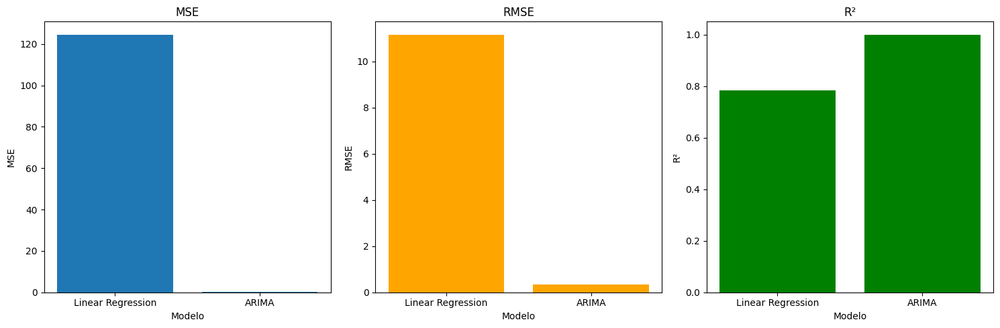

In [ ]:
# Resultados
results = {
    'Model': ['Linear Regression', 'ARIMA'],
    'MSE': [mse_linear, mse_arima],
    'RMSE': [rmse_linear, rmse_arima],
    'R2': [r2_linear, r2_arima]
}
results_df = pd.DataFrame(results)

# Criar gráficos
plt.figure(figsize=(15, 5))

# Gráfico para MSE
plt.subplot(1, 3, 1)
plt.bar(results_df['Model'], results_df['MSE'])
plt.title('MSE')
plt.xlabel('Modelo')
plt.ylabel('MSE')

# Gráfico para RMSE
plt.subplot(1, 3, 2)
plt.bar(results_df['Model'], results_df['RMSE'], color='orange')
plt.title('RMSE')
plt.xlabel('Modelo')
plt.ylabel('RMSE')

# Gráfico para R2
plt.subplot(1, 3, 3)
plt.bar(results_df['Model'], results_df['R2'], color='green')
plt.title('R²')
plt.xlabel('Modelo')
plt.ylabel('R²')

plt.tight_layout()
plt.show()


## 2

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, TimeSeriesSplit, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import statsmodels.api as sm
from keras.models import Sequential
from keras.layers import LSTM, Dense
from sklearn.preprocessing import StandardScaler
from statsmodels.tsa.arima.model import ARIMA

# Carregar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

# Preprocessamento
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d')

# Filtrar dados de Tucuruí
df_tucurui = df[df.id_posto == 275]

# Definir o índice de tempo
df_tucurui.set_index('id_tempo', inplace=True)
df_tucurui = df_tucurui.asfreq('D').sort_index()

# Apenas garantir que não haja NaNs
df_tucurui = df_tucurui.fillna(method='ffill')
df_tucurui = df_tucurui.fillna(method='bfill')

# Função para criar janelas de tempo
def create_windows(data, window_size, forecast_horizon):
    X, y = [], []
    for i in range(len(data) - window_size - forecast_horizon + 1):
        X.append(data[i:(i + window_size)])
        y.append(data[(i + window_size):(i + window_size + forecast_horizon)])
    return np.array(X), np.array(y)

# Parâmetros
window_size = 720
forecast_horizon = 14

features = df_tucurui.drop(columns=['volume_armazenado'])
target = df_tucurui['volume_armazenado']

# Preparar dados
X, y = create_windows(df_tucurui['volume_armazenado'].values, window_size, forecast_horizon)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

Após a escalagem - NaNs em X_train: 0
Após a escalagem - NaNs em X_val: 0
Após a escalagem - NaNs em X_test: 0
NaNs em y_train: 0
NaNs em y_val: 0
NaNs em y_test: 0
Forma de X_train: (546, 720, 1)
Forma de X_val: (234, 720, 1)
Forma de X_test: (334, 720, 1)
Forma de y_train: (546, 30)
Forma de y_val: (234, 30)
Forma de y_test: (334, 30)
Epoch 1/40
69/69 [==============================] - 98s 1s/step - loss: 0.8947 - val_loss: 0.4150
Epoch 2/40
69/69 [==============================] - 92s 1s/step - loss: 0.8700 - val_loss: 0.4244
Epoch 3/40
69/69 [==============================] - 94s 1s/step - loss: 0.8535 - val_loss: 0.4077
Epoch 4/40
69/69 [==============================] - 92s 1s/step - loss: 0.8503 - val_loss: 0.3986
Epoch 5/40
69/69 [==============================] - 92s 1s/step - loss: 0.8509 - val_loss: 0.4078
Epoch 6/40
69/69 [==============================] - 106s 2s/step - loss: 0.8436 - val_loss: 0.3940
Epoch 7/40
69/69 [==============================] - 98s 1s/step - loss: 

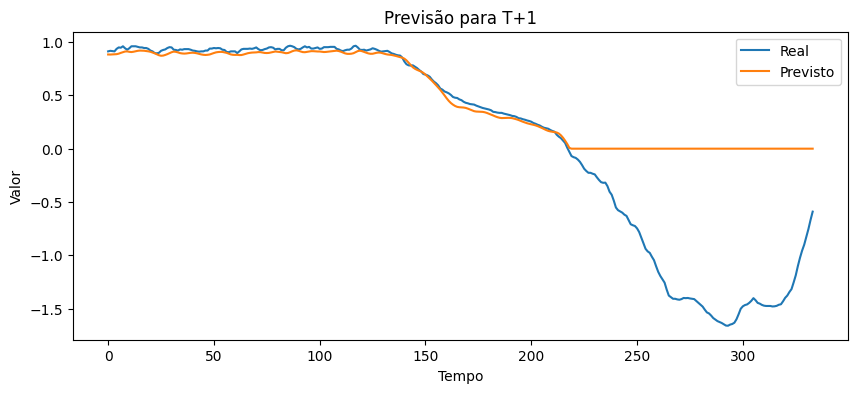

Horizonte 2: MSE = 0.484, RMSE = 0.696, R² = 0.450


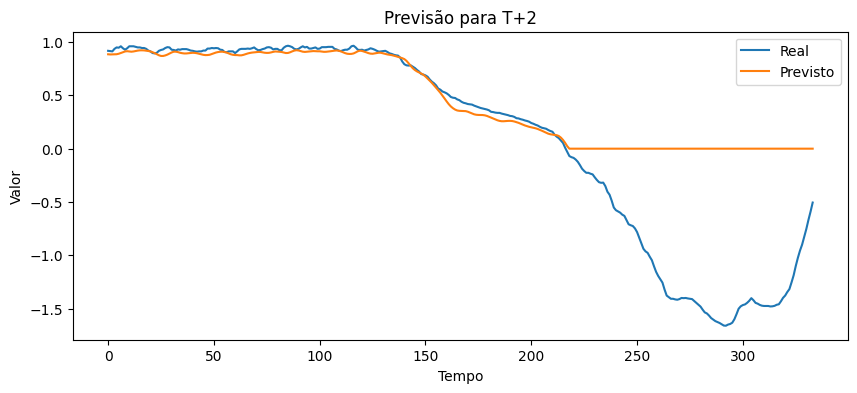

Horizonte 3: MSE = 0.485, RMSE = 0.697, R² = 0.448


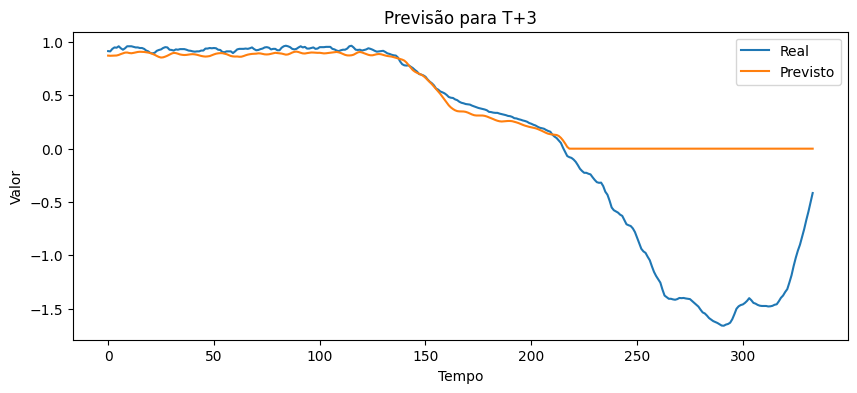

Horizonte 4: MSE = 0.486, RMSE = 0.697, R² = 0.446


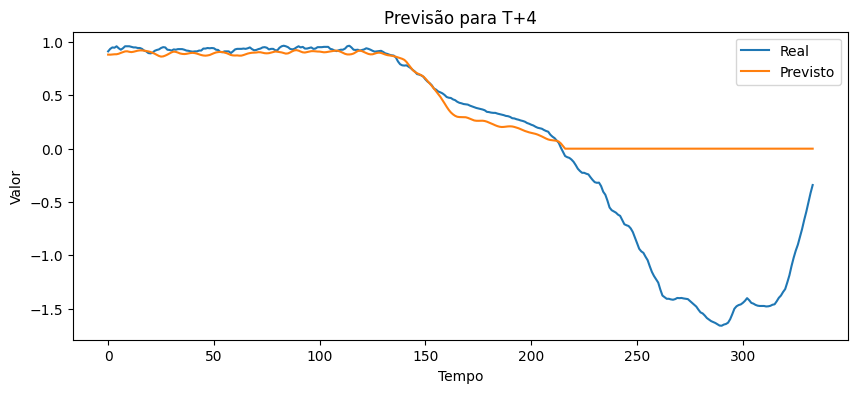

Horizonte 5: MSE = 0.487, RMSE = 0.698, R² = 0.444


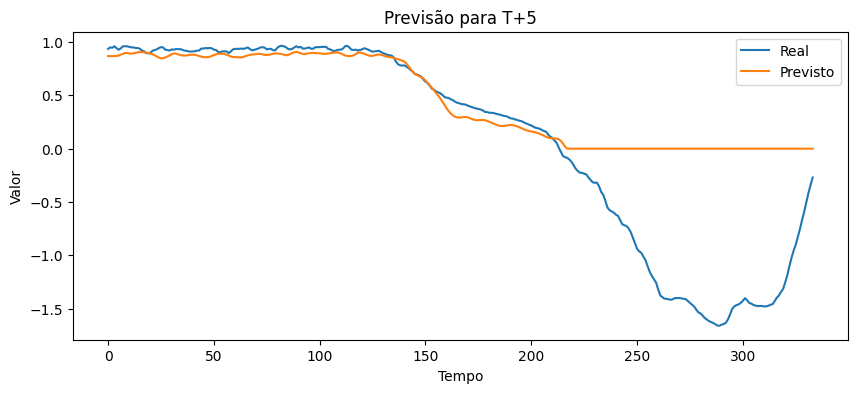

Horizonte 6: MSE = 0.488, RMSE = 0.699, R² = 0.442


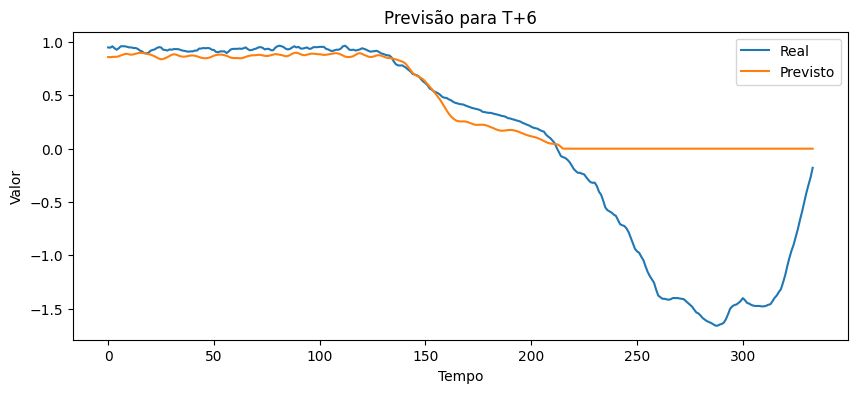

Horizonte 7: MSE = 0.489, RMSE = 0.699, R² = 0.439


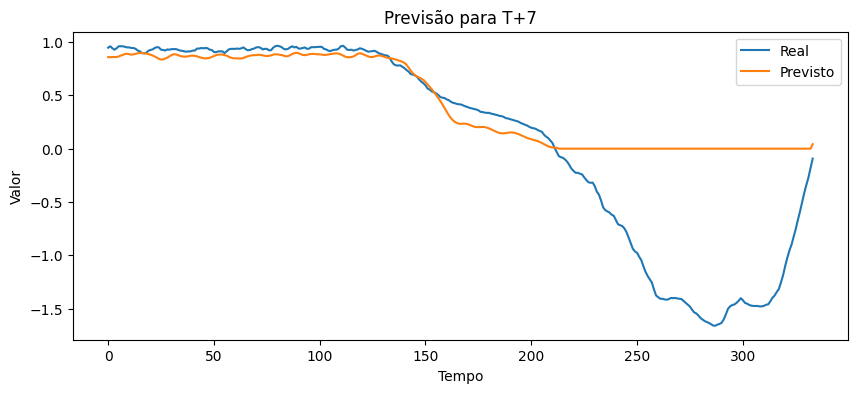

Horizonte 8: MSE = 0.489, RMSE = 0.699, R² = 0.439


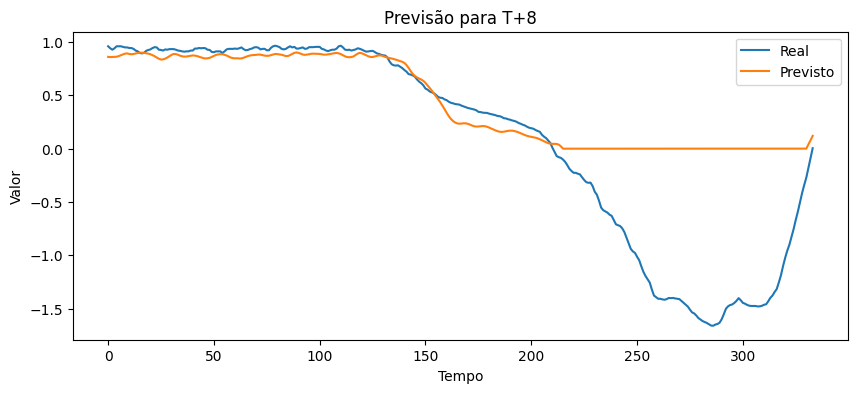

Horizonte 9: MSE = 0.494, RMSE = 0.703, R² = 0.431


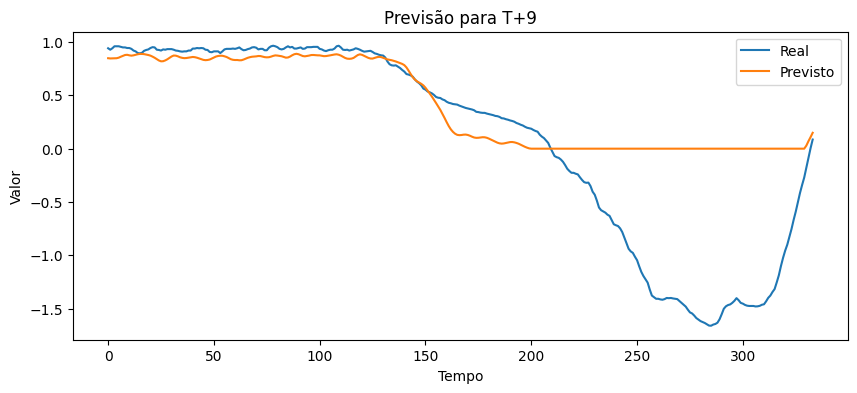

Horizonte 10: MSE = 0.496, RMSE = 0.704, R² = 0.427


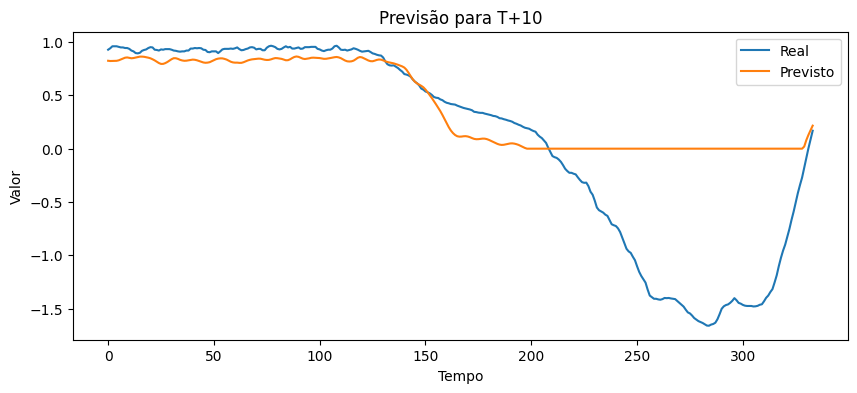

Horizonte 11: MSE = 0.493, RMSE = 0.702, R² = 0.430


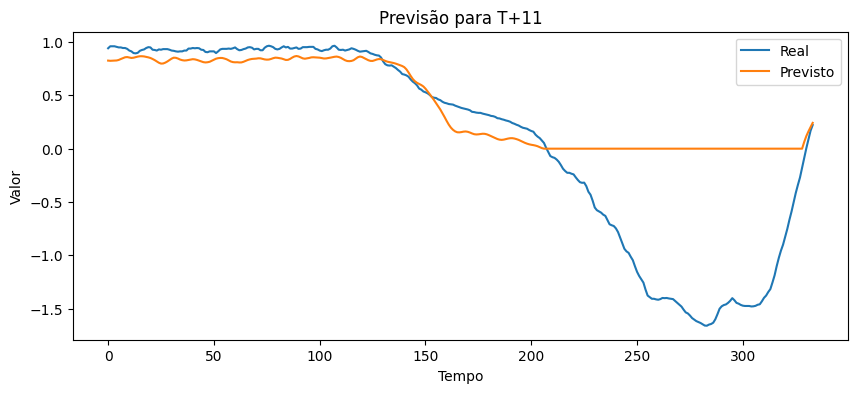

Horizonte 12: MSE = 0.498, RMSE = 0.705, R² = 0.422


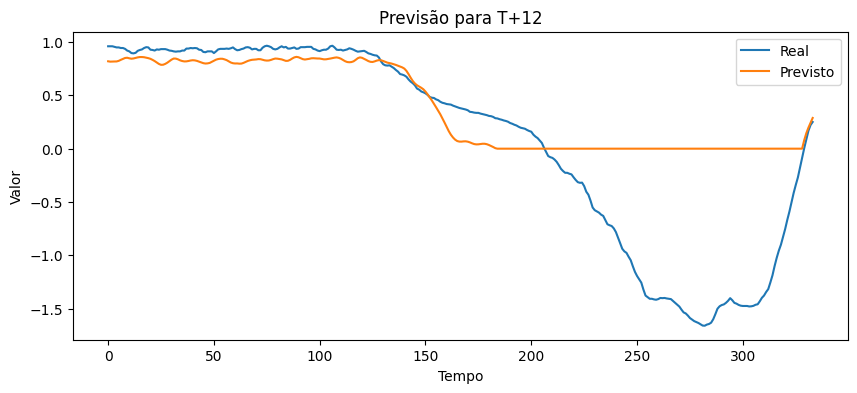

Horizonte 13: MSE = 0.497, RMSE = 0.705, R² = 0.422


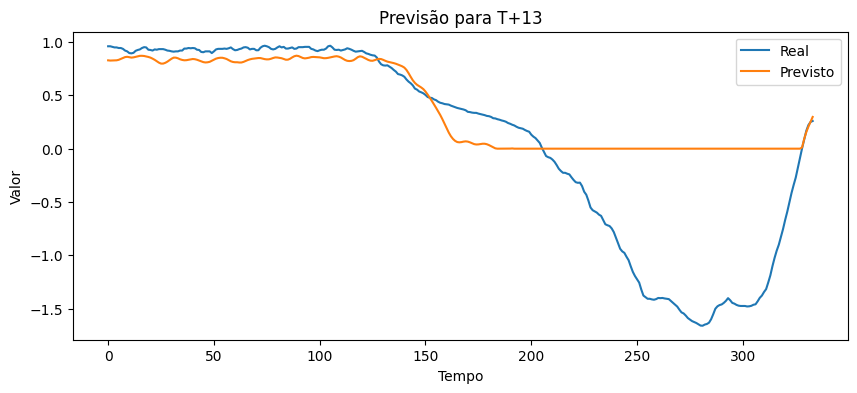

Horizonte 14: MSE = 0.496, RMSE = 0.704, R² = 0.422


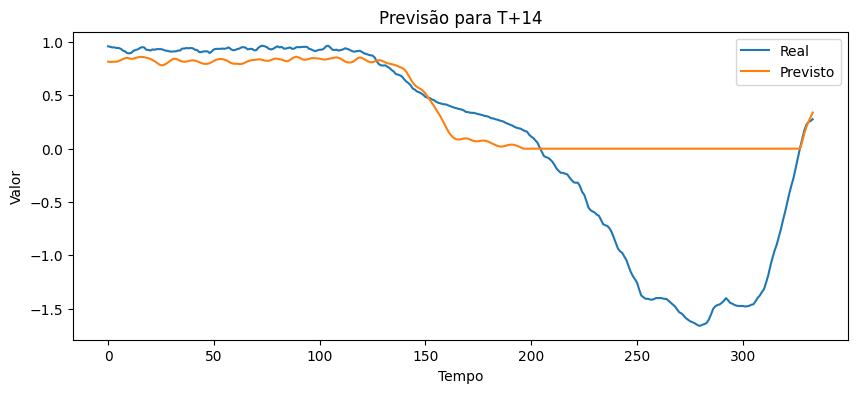

Horizonte 15: MSE = 0.500, RMSE = 0.707, R² = 0.416


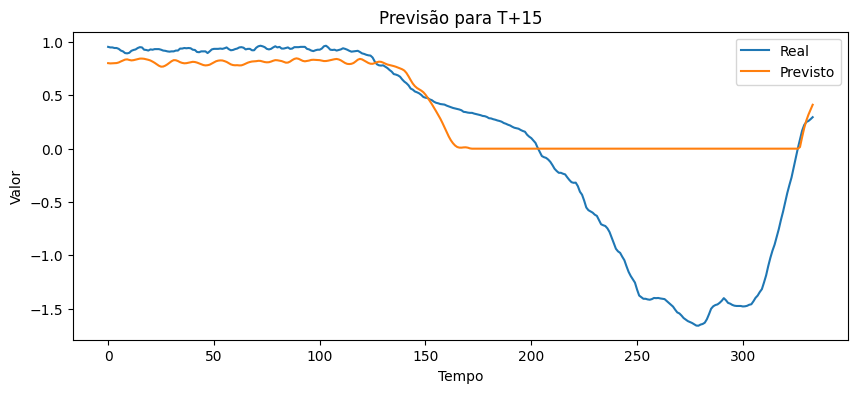

Horizonte 16: MSE = 0.499, RMSE = 0.706, R² = 0.415


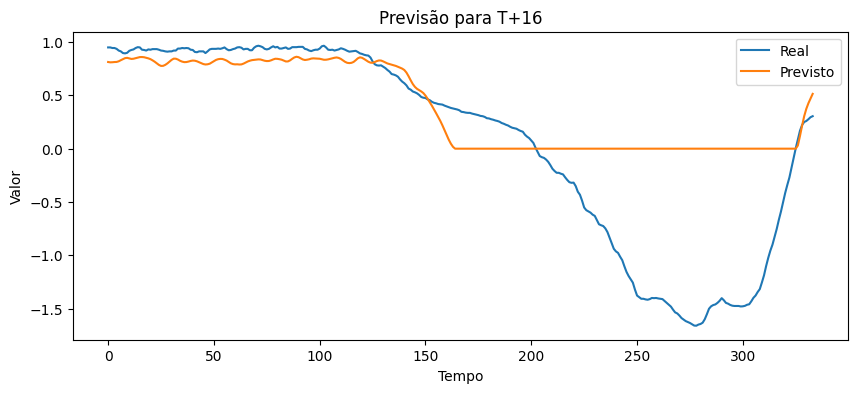

Horizonte 17: MSE = 0.500, RMSE = 0.707, R² = 0.412


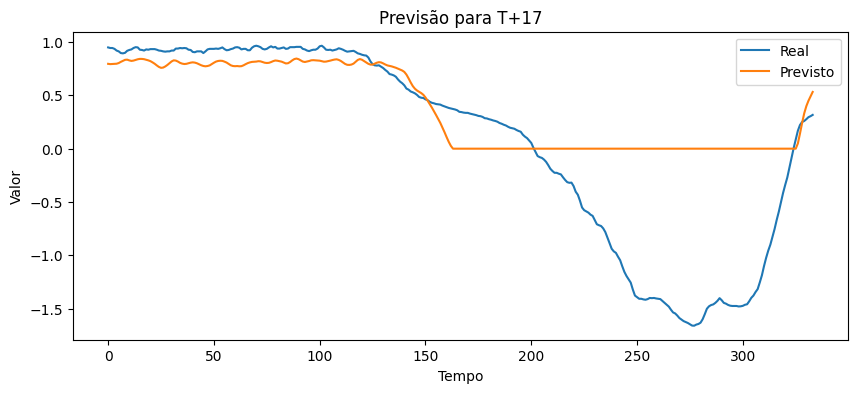

Horizonte 18: MSE = 0.500, RMSE = 0.707, R² = 0.410


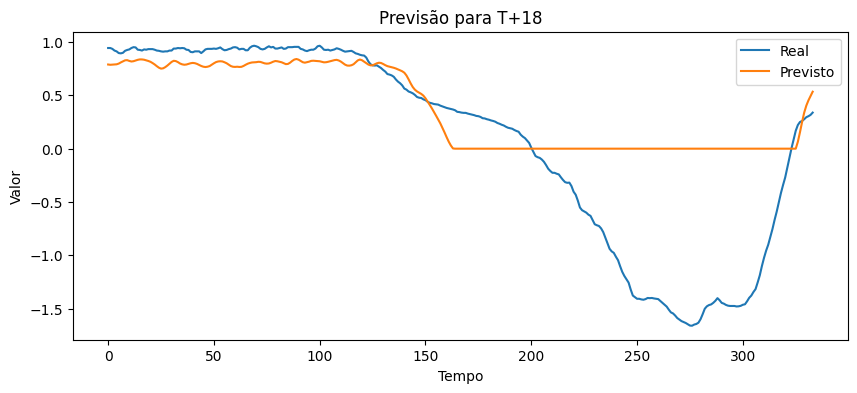

Horizonte 19: MSE = 0.501, RMSE = 0.708, R² = 0.408


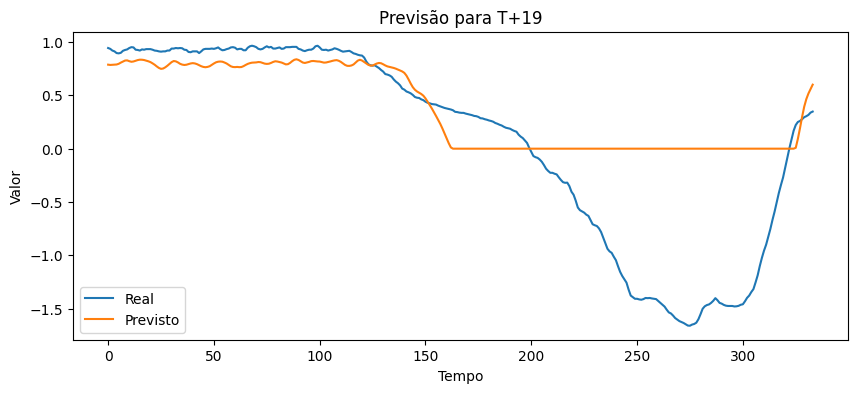

Horizonte 20: MSE = 0.502, RMSE = 0.708, R² = 0.406


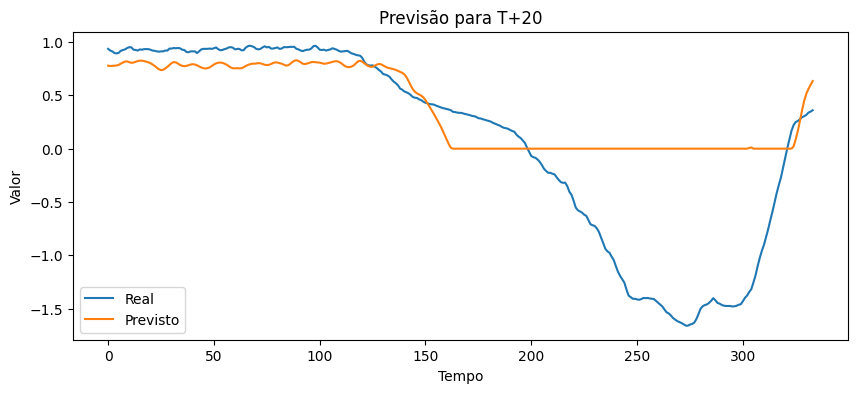

Horizonte 21: MSE = 0.505, RMSE = 0.711, R² = 0.400


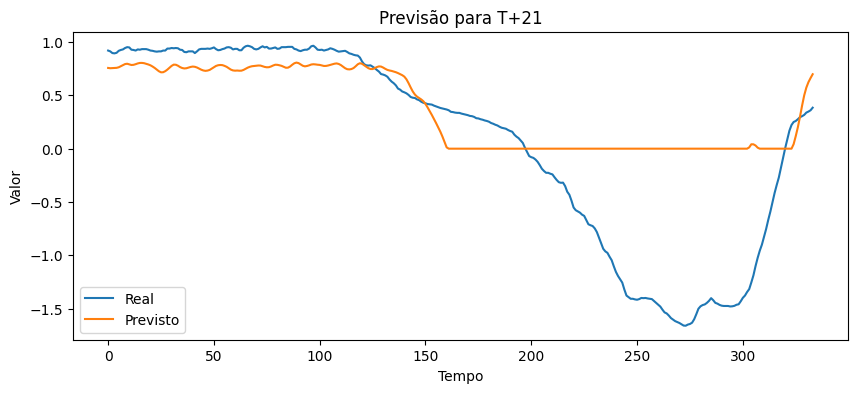

Horizonte 22: MSE = 0.505, RMSE = 0.710, R² = 0.400


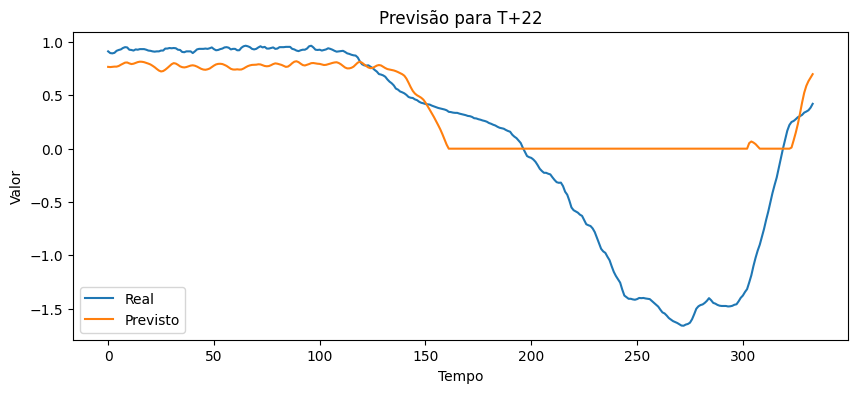

Horizonte 23: MSE = 0.504, RMSE = 0.710, R² = 0.400


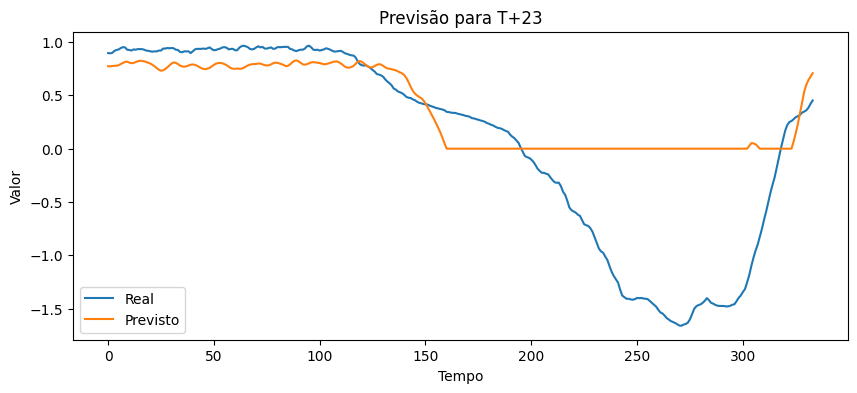

Horizonte 24: MSE = 0.505, RMSE = 0.711, R² = 0.397


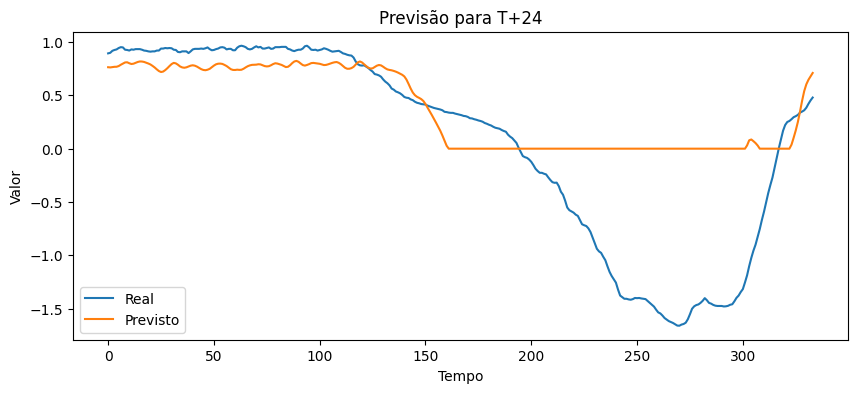

Horizonte 25: MSE = 0.513, RMSE = 0.716, R² = 0.386


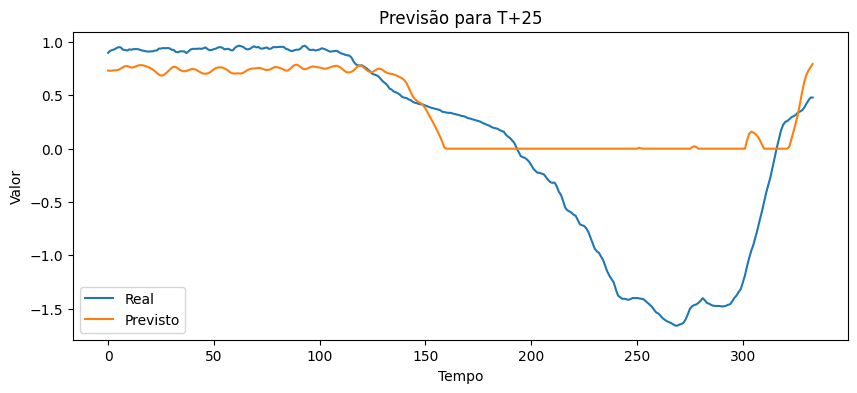

Horizonte 26: MSE = 0.509, RMSE = 0.714, R² = 0.390


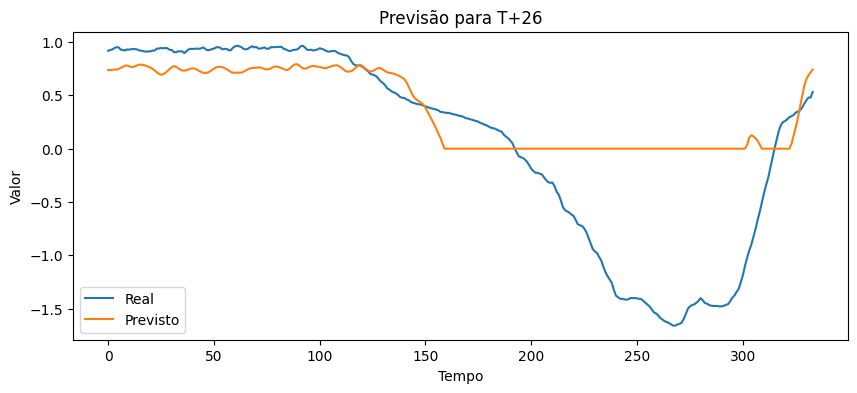

Horizonte 27: MSE = 0.510, RMSE = 0.714, R² = 0.387


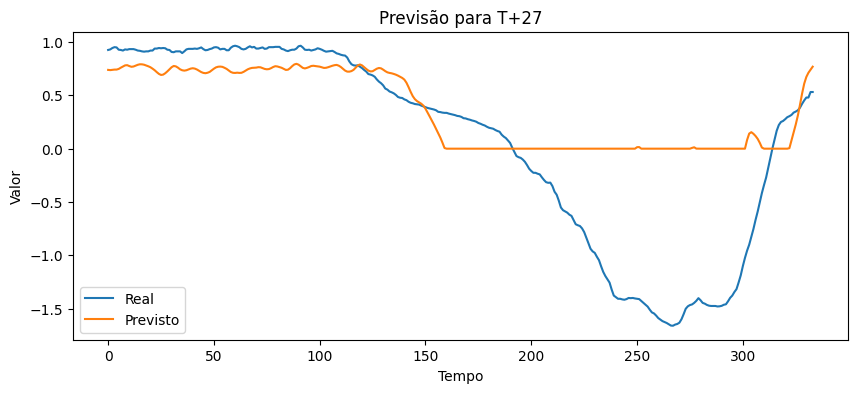

Horizonte 28: MSE = 0.518, RMSE = 0.720, R² = 0.376


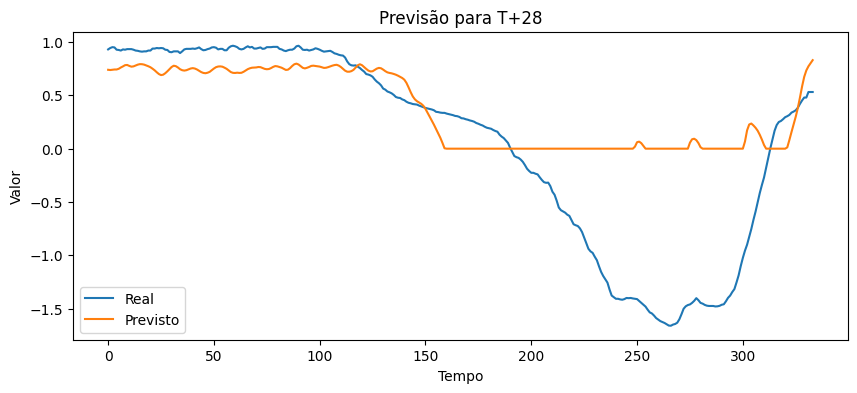

Horizonte 29: MSE = 0.508, RMSE = 0.713, R² = 0.387


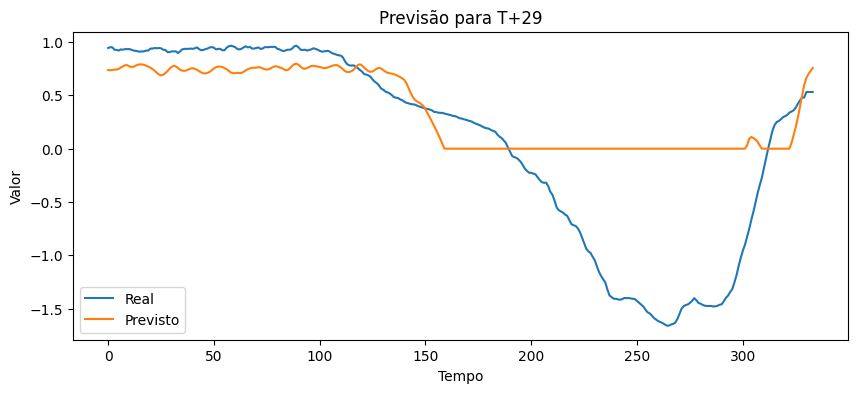

Horizonte 30: MSE = 0.508, RMSE = 0.713, R² = 0.387


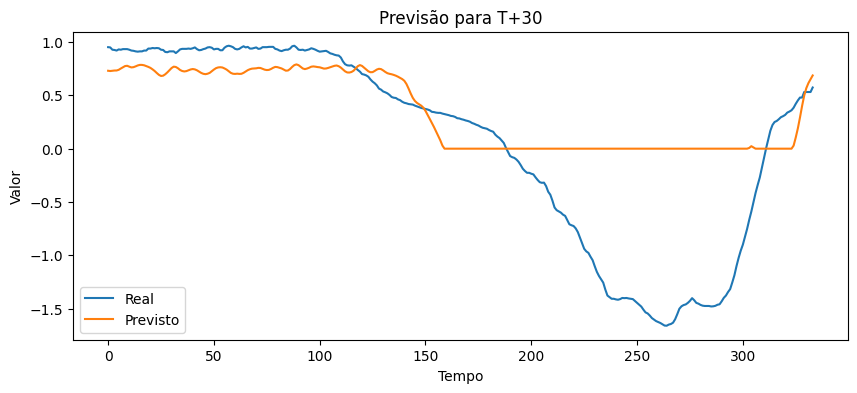

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense, GRU
from sklearn.metrics import mean_squared_error, r2_score
from keras.callbacks import EarlyStopping
from math import sqrt
from sklearn.preprocessing import StandardScaler

# Função modificada para criar dados
def create_data(df, max_future, n_past, train_test_split_percentage, validation_split_percentage):
    n_feature = df.shape[1]
    x_data, y_data = [], []

    for i in range(n_past, len(df) - max_future + 1):
        x_data.append(df[i - n_past:i, 0:n_feature])
        y_data.append([df[j, 0] for j in range(i, i + max_future)])

    split_training_test_starting_point = int(round(train_test_split_percentage * len(x_data)))
    split_train_validation_starting_point = int(round(split_training_test_starting_point * (1 - validation_split_percentage)))

    x_train = x_data[:split_train_validation_starting_point]
    y_train = y_data[:split_train_validation_starting_point]

    x_val = x_data[split_train_validation_starting_point:split_training_test_starting_point]
    y_val = y_data[split_train_validation_starting_point:split_training_test_starting_point]

    x_test = x_data[split_training_test_starting_point:]
    y_test = y_data[split_training_test_starting_point:]

    return np.array(x_train), np.array(x_test), np.array(x_val), np.array(y_train), np.array(y_test), np.array(y_val)

# Parâmetros
n_future = 30  # Número de dias que você deseja prever no futuro
n_past = 720   # Número de dias passados que você deseja usar para prever o futuro

# Supondo que 'features_scaled' é seu DataFrame pré-processado
df_tucurui_values = df_tucurui[['volume_armazenado']].values
scaler = StandardScaler()
features_scaled = scaler.fit_transform(df_tucurui_values)

X, y = [], []
for i in range(len(df_tucurui)-1):
    X.append(features_scaled[i:i+1])
    y.append(df_tucurui_values[i+1])

X = np.array(X)
y = np.array(y)

# Separar dados para validação
X_val = X[-60:]
y_val = y[-60:]

# Reduzir X e y excluindo os dados de validação
X = X[:-60]
y = y[:-60]


X_train, X_test, X_val, y_train, y_test, y_val = create_data(features_scaled, n_future, n_past, 0.7, 0.3)

# Verificar NaNs após a escalagem
print("Após a escalagem - NaNs em X_train:", np.isnan(X_train).sum())
print("Após a escalagem - NaNs em X_val:", np.isnan(X_val).sum())
print("Após a escalagem - NaNs em X_test:", np.isnan(X_test).sum())
print("NaNs em y_train:", np.isnan(y_train).sum())
print("NaNs em y_val:", np.isnan(y_val).sum())
print("NaNs em y_test:", np.isnan(y_test).sum())

# Verificar formas dos dados
print("Forma de X_train:", X_train.shape)
print("Forma de X_val:", X_val.shape)
print("Forma de X_test:", X_test.shape)
print("Forma de y_train:", y_train.shape)
print("Forma de y_val:", y_val.shape)
print("Forma de y_test:", y_test.shape)

# Modelo LSTM
regressor = Sequential()
regressor.add(LSTM(units=256, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
regressor.add(GRU(units=256, return_sequences=False))
regressor.add(Dropout(0.2))
regressor.add(Dense(units=n_future, activation='relu'))
regressor.compile(optimizer='adam', loss='mse')

# Callbacks
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=5, restore_best_weights=True)

# Treinamento
history = regressor.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=40, batch_size=8, callbacks=[es])

# Previsões
y_pred = regressor.predict(X_test)

# Avaliação e Visualização
for i in range(n_future):
    y_true = y_test[:, i]
    y_pred_i = y_pred[:, i]

    mse = mean_squared_error(y_true, y_pred_i)
    rmse = sqrt(mse)
    r2 = r2_score(y_true, y_pred_i)

    print(f'Horizonte {i+1}: MSE = {mse:.3f}, RMSE = {rmse:.3f}, R² = {r2:.3f}')

    plt.figure(figsize=(10, 4))
    plt.plot(y_true, label='Real')
    plt.plot(y_pred_i, label='Previsto')
    plt.title(f'Previsão para T+{i+1}')
    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()


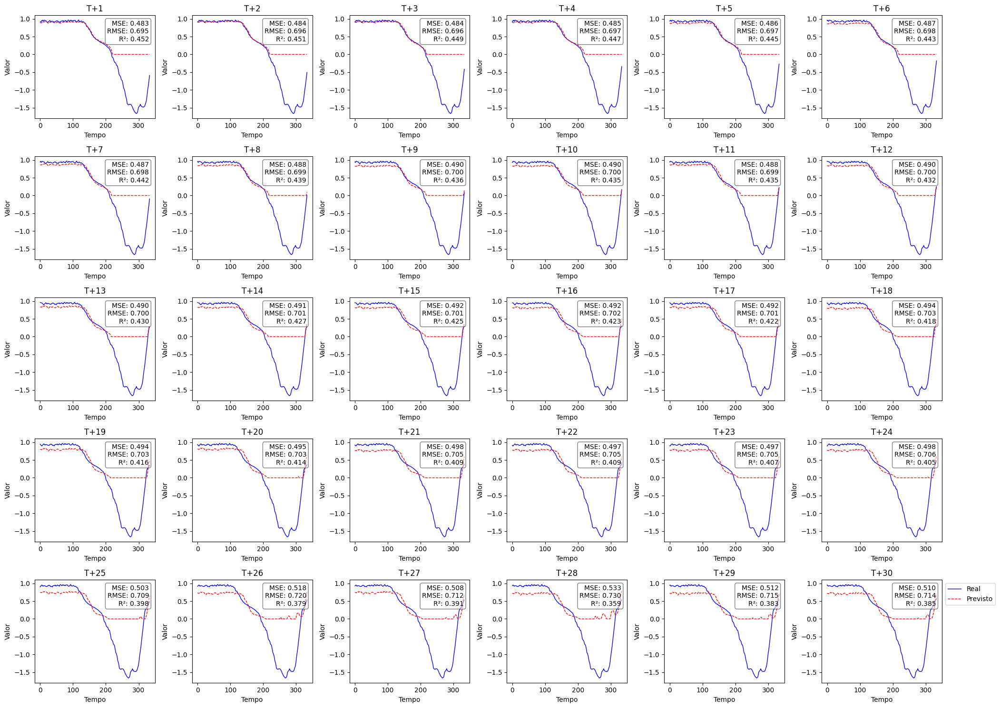

In [ ]:
# Número de linhas e colunas para os subplots
n_rows = 5
n_cols = 6
n_future = 30  # Número total de dias que você está prevendo

# Cria uma figura grande para acomodar todos os subplots
plt.figure(figsize=(20, 15))

# Itera sobre cada horizonte de tempo e cria um subplot para cada um
for i in range(n_future):
    ax = plt.subplot(n_rows, n_cols, i+1)
    plt.plot(y_test[:, i], label='Real', color='blue', linewidth=1)
    plt.plot(y_pred[:, i], label='Previsto', color='red', linestyle='dashed', linewidth=1)
    plt.title(f'T+{i+1}')

    # Calcula as métricas para cada horizonte de tempo
    mse = mean_squared_error(y_test[:, i], y_pred[:, i])
    rmse = sqrt(mse)
    r2 = r2_score(y_test[:, i], y_pred[:, i])

    # Adiciona as métricas como texto no gráfico
    ax.text(0.95, 0.95, f'MSE: {mse:.3f}\nRMSE: {rmse:.3f}\nR²: {r2:.3f}',
            transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.tight_layout()

plt.legend(loc='upper left', bbox_to_anchor=(1,1))
plt.show()

Regressão Linear - Horizonte 1: MSE = 0.029, RMSE = 0.171, R² = 0.594


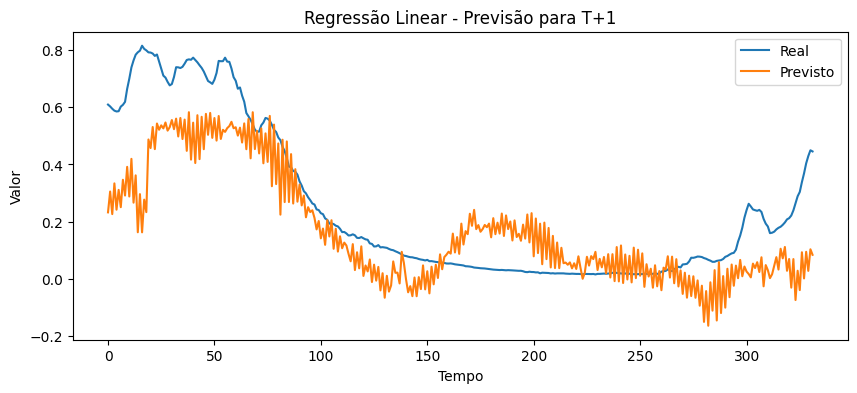

Regressão Linear - Horizonte 2: MSE = 0.031, RMSE = 0.177, R² = 0.567


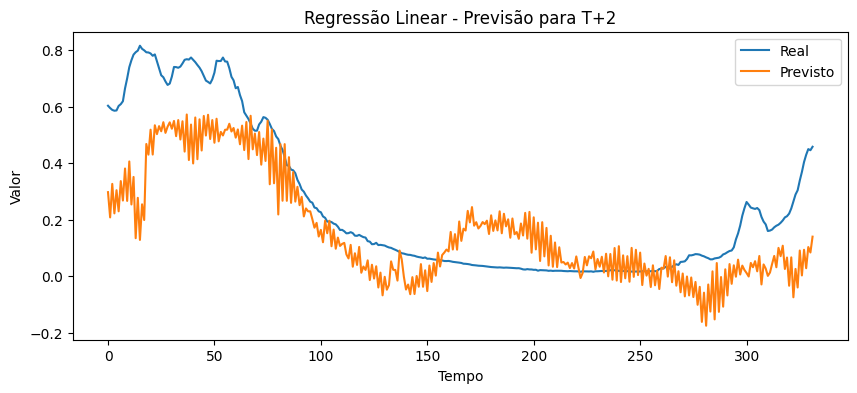

Regressão Linear - Horizonte 3: MSE = 0.037, RMSE = 0.192, R² = 0.486


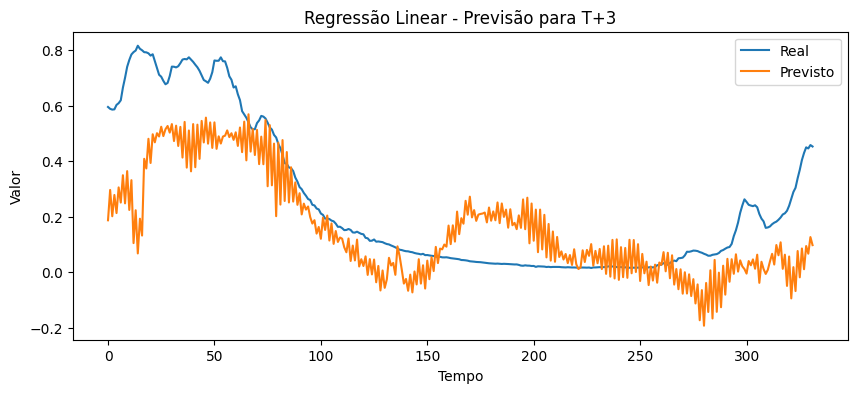

Regressão Linear - Horizonte 4: MSE = 0.032, RMSE = 0.178, R² = 0.554


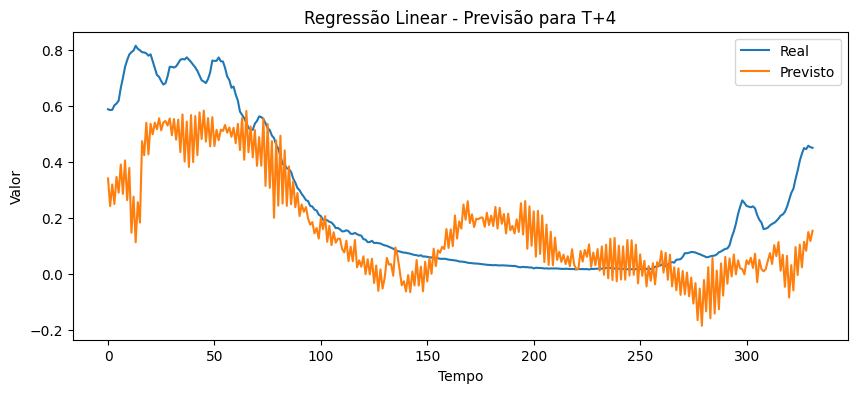

Regressão Linear - Horizonte 5: MSE = 0.039, RMSE = 0.196, R² = 0.458


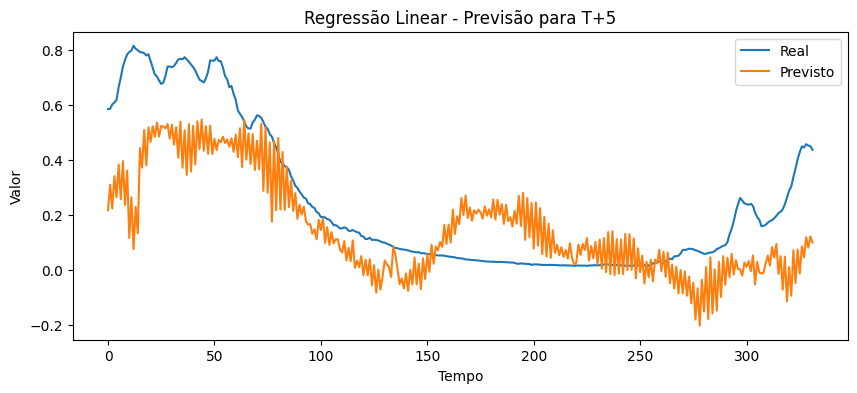

Regressão Linear - Horizonte 6: MSE = 0.038, RMSE = 0.195, R² = 0.465


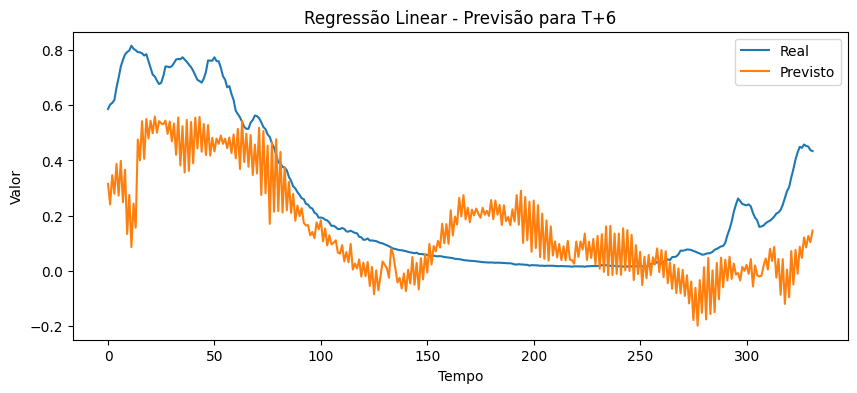

Regressão Linear - Horizonte 7: MSE = 0.037, RMSE = 0.193, R² = 0.474


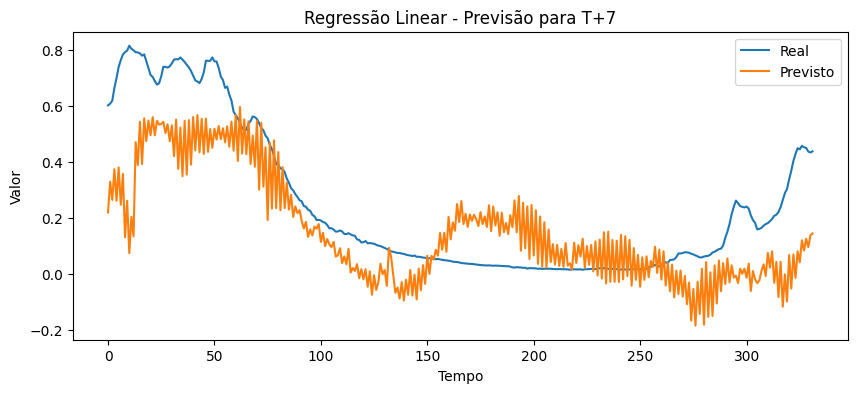

Regressão Linear - Horizonte 8: MSE = 0.037, RMSE = 0.192, R² = 0.478


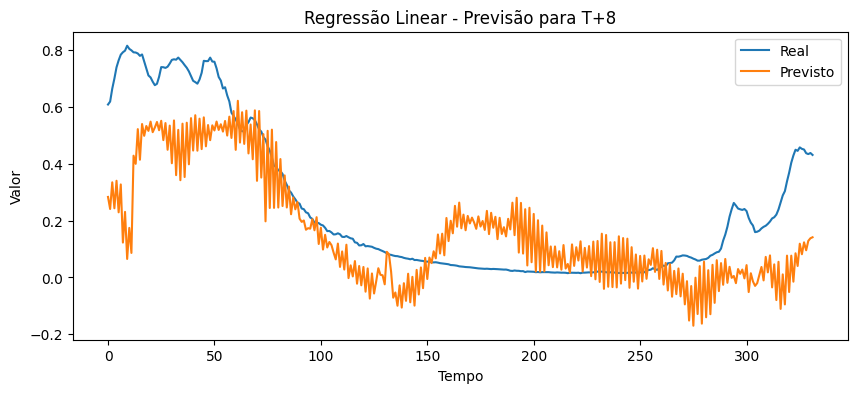

Regressão Linear - Horizonte 9: MSE = 0.040, RMSE = 0.199, R² = 0.434


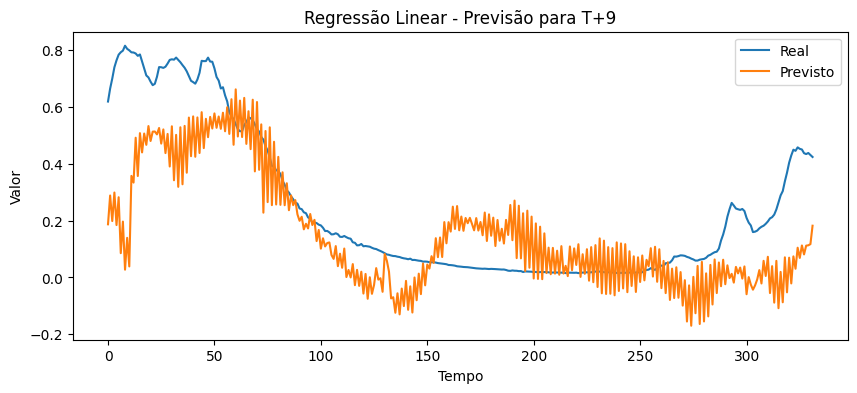

Regressão Linear - Horizonte 10: MSE = 0.047, RMSE = 0.216, R² = 0.331


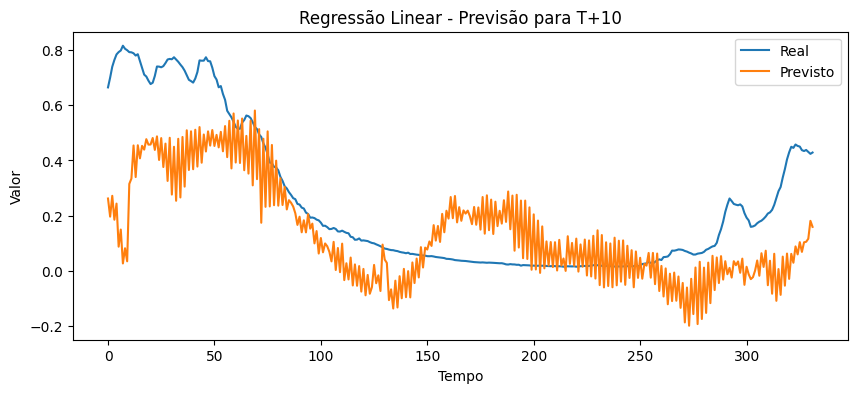

Regressão Linear - Horizonte 11: MSE = 0.047, RMSE = 0.216, R² = 0.326


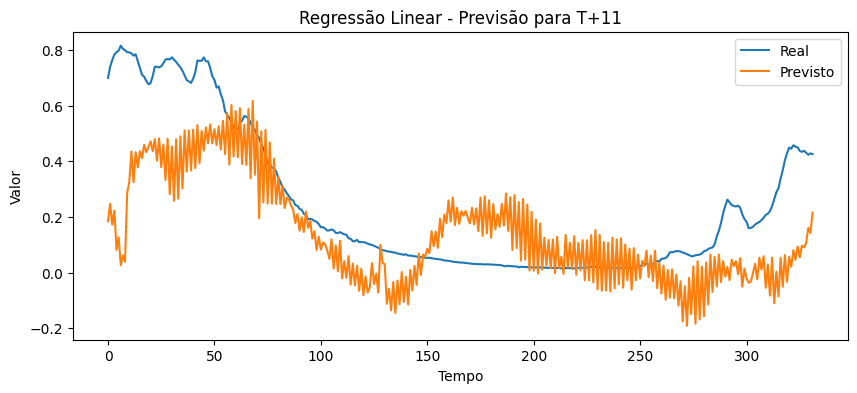

Regressão Linear - Horizonte 12: MSE = 0.044, RMSE = 0.210, R² = 0.359


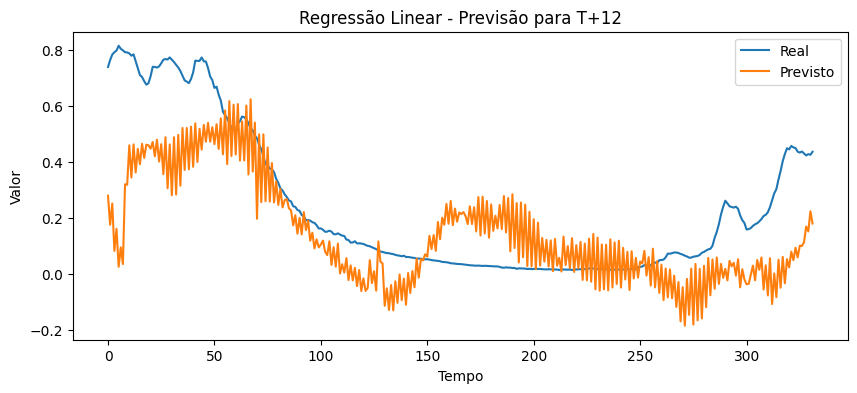

Regressão Linear - Horizonte 13: MSE = 0.043, RMSE = 0.208, R² = 0.368


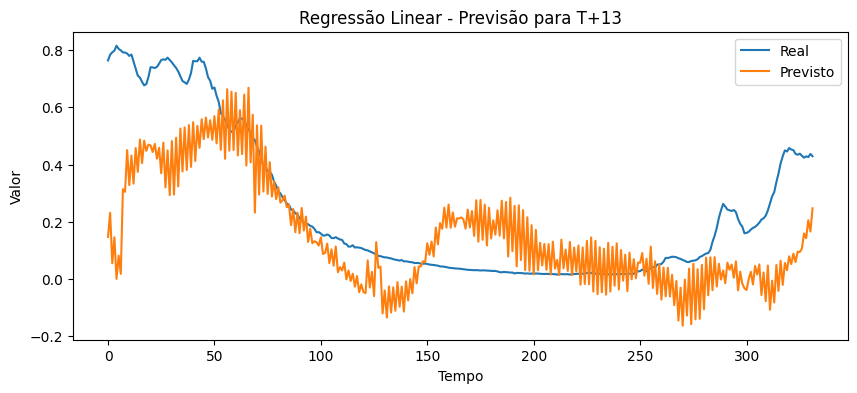

Regressão Linear - Horizonte 14: MSE = 0.043, RMSE = 0.208, R² = 0.361


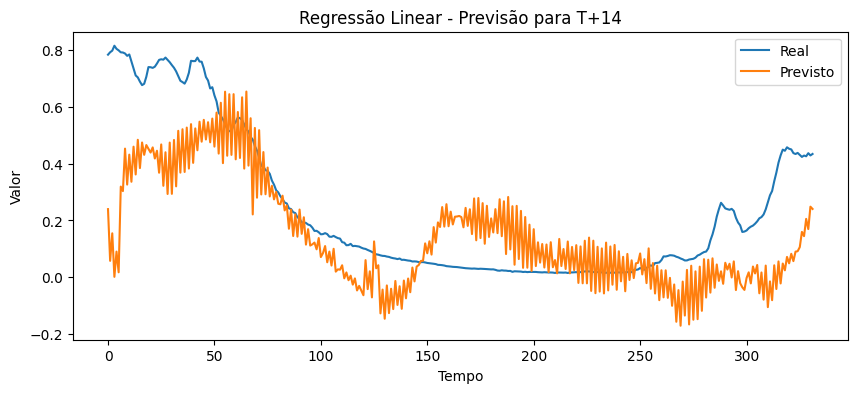

Regressão Linear - Horizonte 15: MSE = 0.044, RMSE = 0.209, R² = 0.343


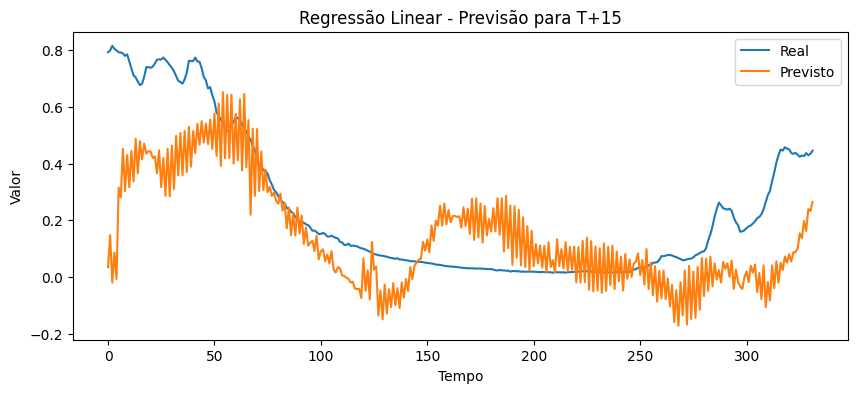

Regressão Linear - Horizonte 16: MSE = 0.041, RMSE = 0.203, R² = 0.373


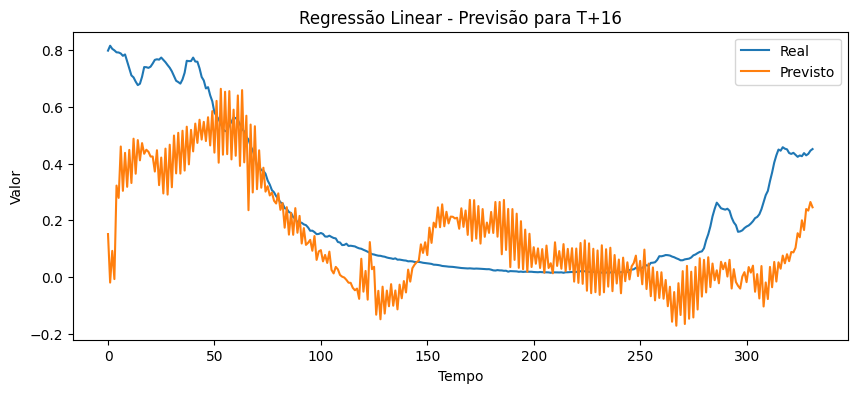

Regressão Linear - Horizonte 17: MSE = 0.040, RMSE = 0.199, R² = 0.390


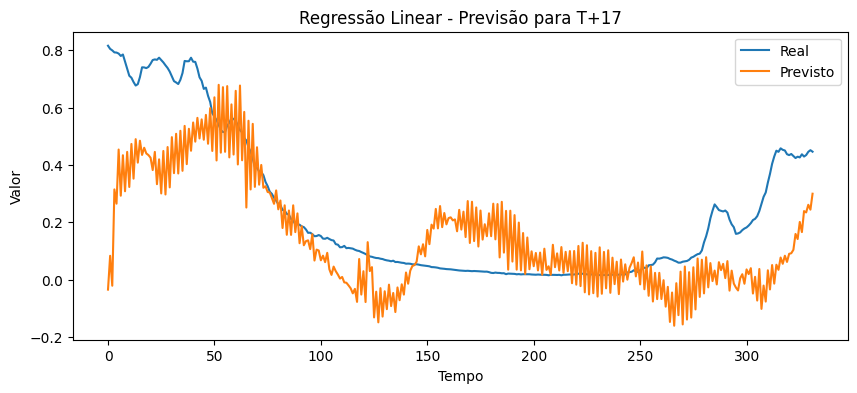

Regressão Linear - Horizonte 18: MSE = 0.038, RMSE = 0.195, R² = 0.409


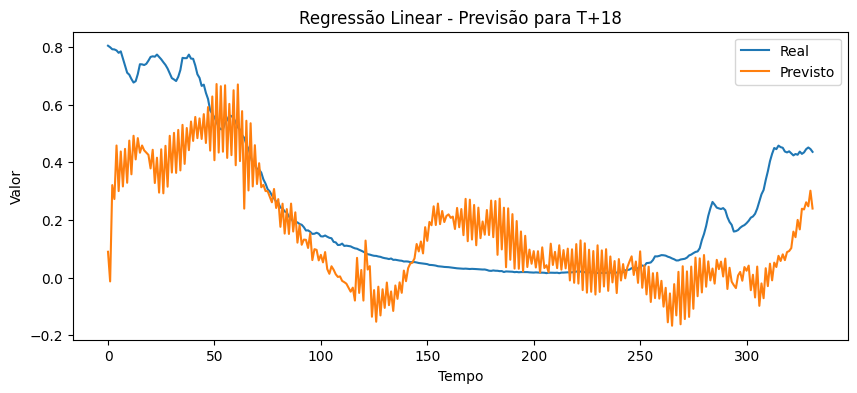

Regressão Linear - Horizonte 19: MSE = 0.034, RMSE = 0.184, R² = 0.466


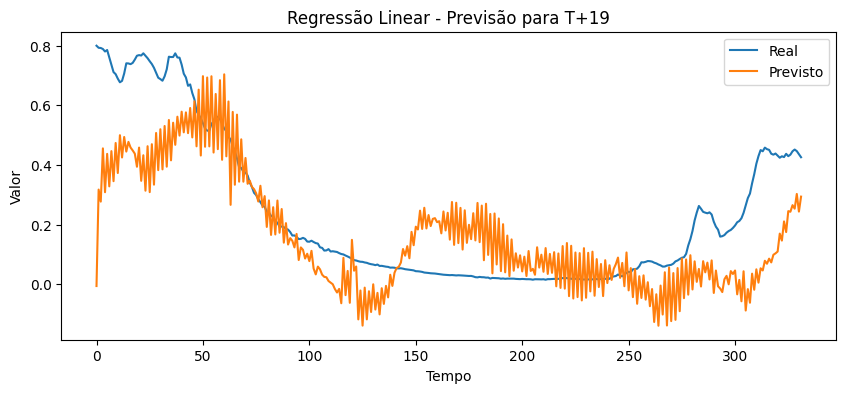

Regressão Linear - Horizonte 20: MSE = 0.033, RMSE = 0.181, R² = 0.479


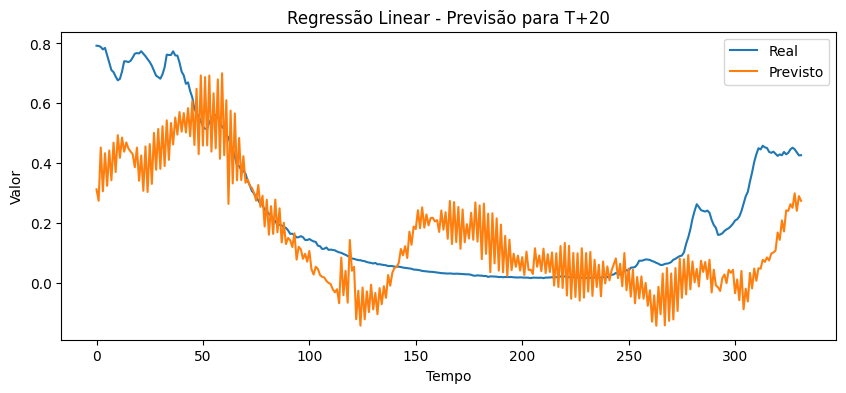

Regressão Linear - Horizonte 21: MSE = 0.030, RMSE = 0.173, R² = 0.514


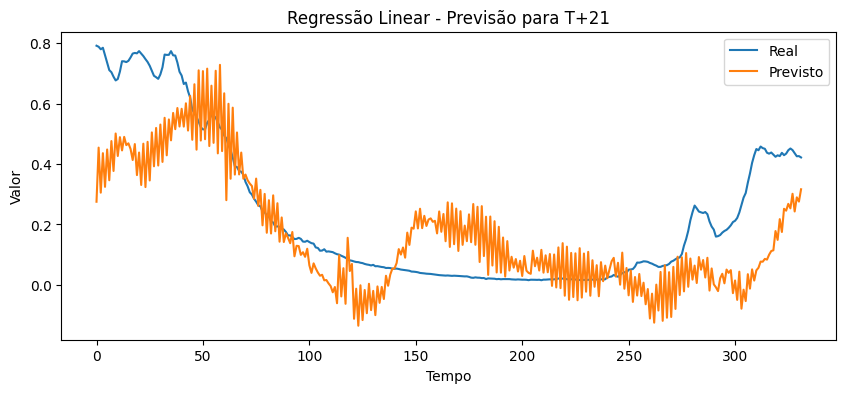

Regressão Linear - Horizonte 22: MSE = 0.030, RMSE = 0.174, R² = 0.504


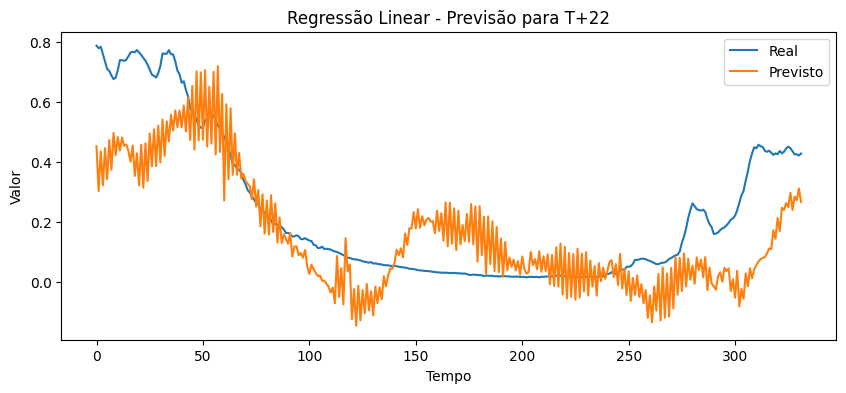

Regressão Linear - Horizonte 23: MSE = 0.029, RMSE = 0.170, R² = 0.521


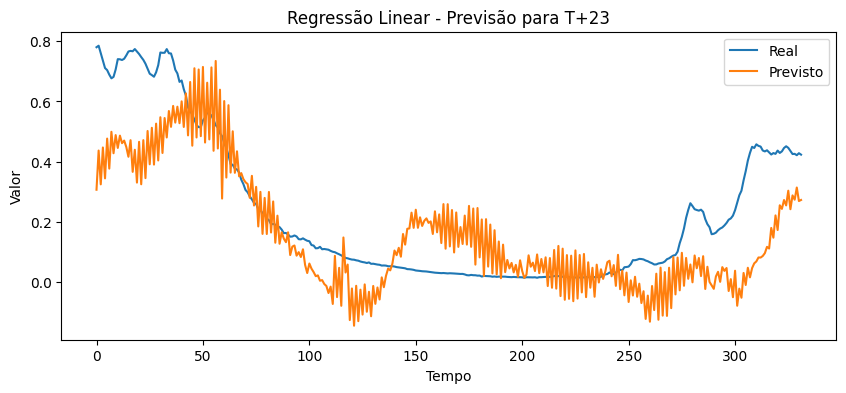

Regressão Linear - Horizonte 24: MSE = 0.028, RMSE = 0.169, R² = 0.519


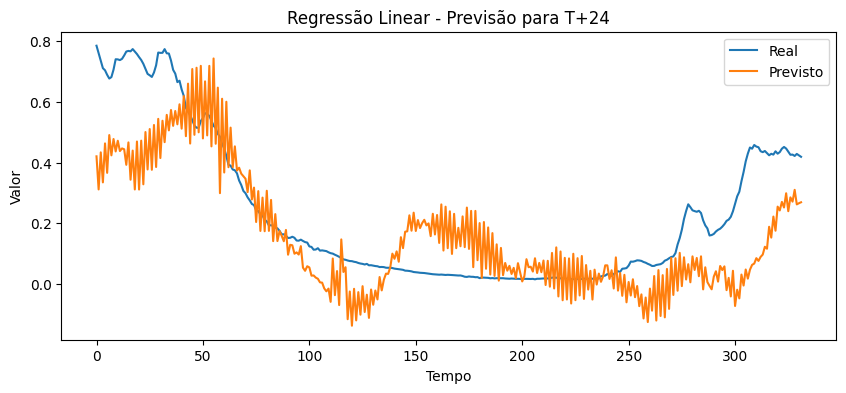

Regressão Linear - Horizonte 25: MSE = 0.026, RMSE = 0.162, R² = 0.552


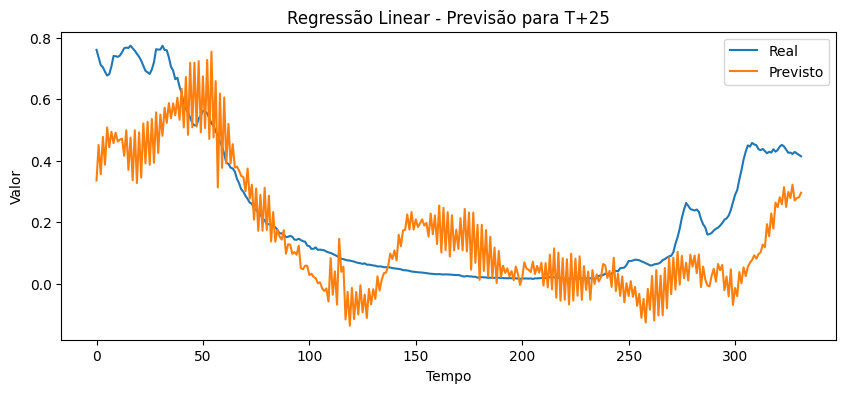

Regressão Linear - Horizonte 26: MSE = 0.025, RMSE = 0.158, R² = 0.567


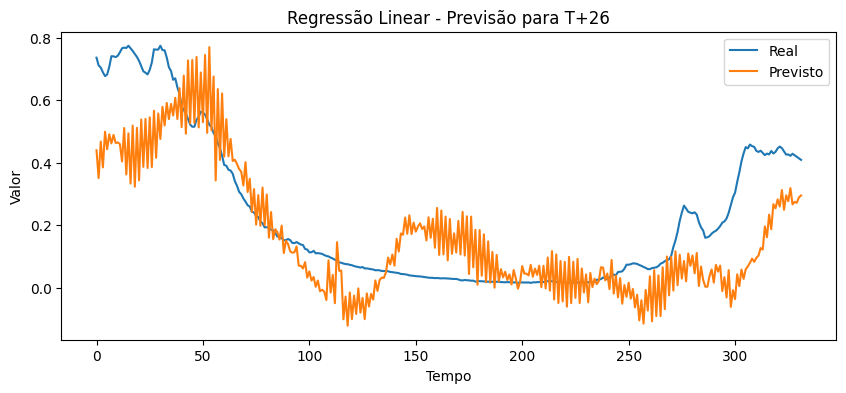

Regressão Linear - Horizonte 27: MSE = 0.023, RMSE = 0.153, R² = 0.588


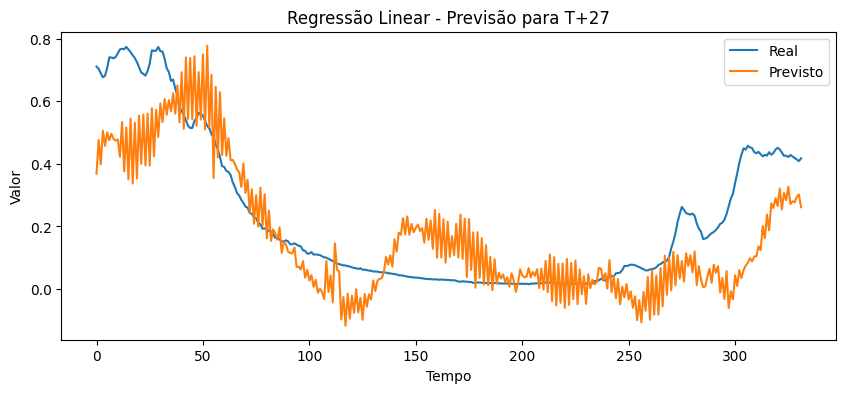

Regressão Linear - Horizonte 28: MSE = 0.023, RMSE = 0.152, R² = 0.591


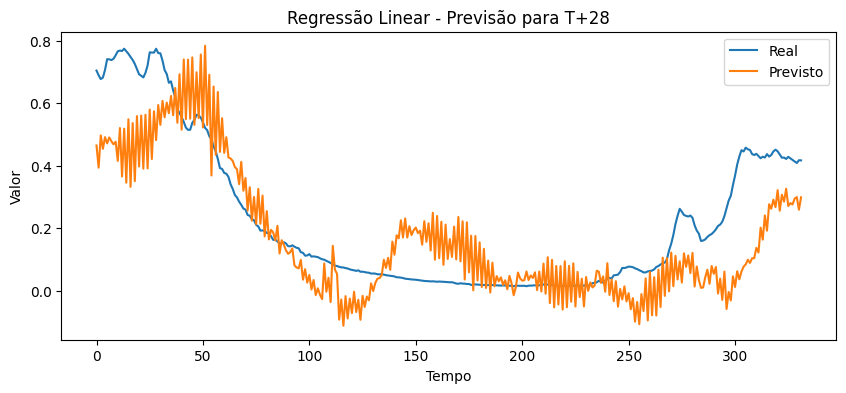

Regressão Linear - Horizonte 29: MSE = 0.023, RMSE = 0.150, R² = 0.595


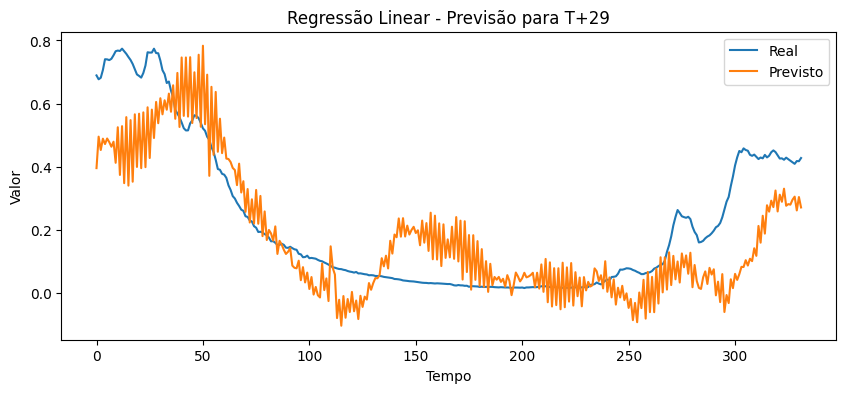

Regressão Linear - Horizonte 30: MSE = 0.023, RMSE = 0.151, R² = 0.588


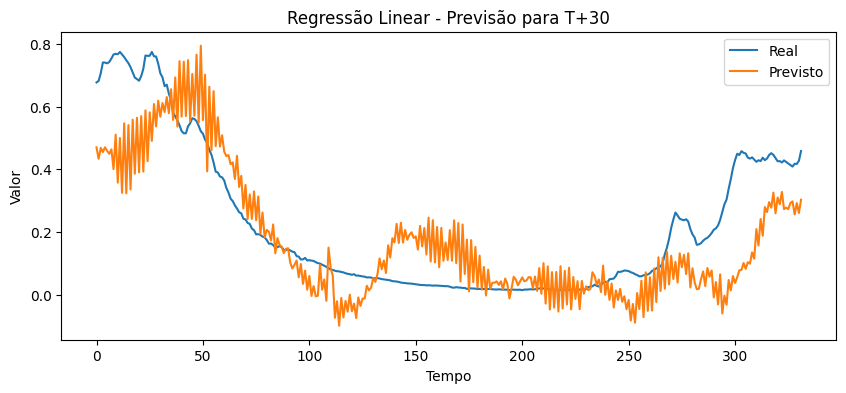

In [ ]:
from sklearn.linear_model import LinearRegression

# Preparar os dados para regressão linear (não precisam ser 3D)
X_train_flat = X_train.reshape(X_train.shape[0], -1)
X_val_flat = X_val.reshape(X_val.shape[0], -1)
X_test_flat = X_test.reshape(X_test.shape[0], -1)

# Modelo de Regressão Linear
linear_model = LinearRegression()

# Treinar o modelo
linear_model.fit(X_train_flat, y_train)

# Previsões
y_pred_linear = linear_model.predict(X_test_flat)

# Avaliação e Visualização
for i in range(n_future):
    y_true = y_test[:, i]
    y_pred_i = y_pred_linear[:, i]

    mse = mean_squared_error(y_true, y_pred_i)
    rmse = sqrt(mse)
    r2 = r2_score(y_true, y_pred_i)

    print(f'Regressão Linear - Horizonte {i+1}: MSE = {mse:.3f}, RMSE = {rmse:.3f}, R² = {r2:.3f}')

    plt.figure(figsize=(10, 4))
    plt.plot(y_true, label='Real')
    plt.plot(y_pred_i, label='Previsto')
    plt.title(f'Regressão Linear - Previsão para T+{i+1}')
    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()


ARIMA - MSE: 0.149, RMSE: 0.386, R²: 1.000


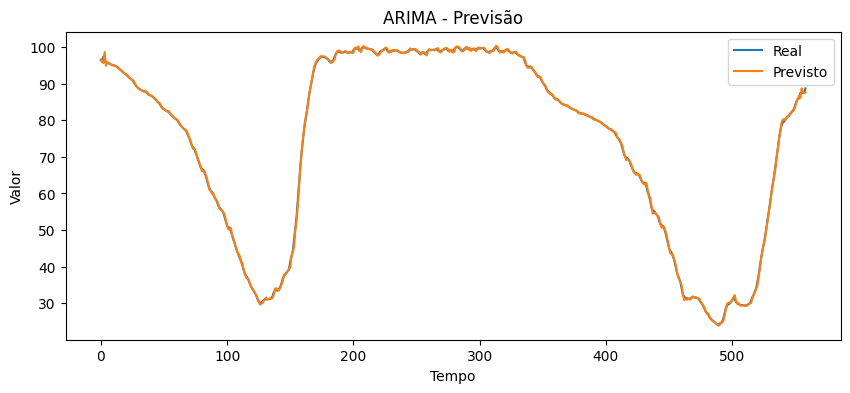

In [ ]:
import statsmodels.api as sm
from statsmodels.tsa.arima.model import ARIMA

# Preparar os dados para ARIMA (usar apenas a série temporal)
train_size = int(0.7 * len(df_tucurui_values))
train, test = df_tucurui_values[:train_size], df_tucurui_values[train_size:]

history = [x for x in train]
predictions = []

# Modelo ARIMA
for t in range(len(test)):
    model = ARIMA(history, order=(5, 1, 0))
    model_fit = model.fit()
    output = model_fit.forecast()
    yhat = output[0]
    predictions.append(yhat)
    history.append(test[t])

# Calcular métricas
y_test_flat = test.flatten()
y_pred_arima = np.array(predictions)

mse_arima = mean_squared_error(y_test_flat, y_pred_arima)
rmse_arima = sqrt(mse_arima)
r2_arima = r2_score(y_test_flat, y_pred_arima)

print(f'ARIMA - MSE: {mse_arima:.3f}, RMSE: {rmse_arima:.3f}, R²: {r2_arima:.3f}')

# Visualização
plt.figure(figsize=(10, 4))
plt.plot(y_test_flat, label='Real')
plt.plot(y_pred_arima, label='Previsto')
plt.title('ARIMA - Previsão')
plt.xlabel('Tempo')
plt.ylabel('Valor')
plt.legend()
plt.show()


# 3

In [ ]:
import os
import warnings
import sys

import pandas as pd
from matplotlib import pyplot as plt
import datetime
import pylab as pl
import numpy as np
from sklearn import linear_model
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split
from math import sqrt
from urllib.parse import urlparse
from sqlalchemy import create_engine
import logging

from pandas import read_csv
from keras.models import Sequential
from keras.layers import *
from sklearn.preprocessing import MinMaxScaler
import math

from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import GradientBoostingRegressor
from scipy.stats import uniform as sp_randFloat
from scipy.stats import randint as sp_randInt

import tensorflow as tf
tf.config.experimental.set_memory_growth(tf.config.list_physical_devices('GPU')[0], True)

logging.basicConfig(level=logging.WARN)
logger = logging.getLogger(__name__)

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')
del df['id_ft_rdh']
del df['nome_arquivo']
del df['data_criacao']
del df['data_atualizacao']
df.fillna(0, inplace=True)
df['id_tempo']=  pd.to_datetime(df['id_tempo'],format='%Y%m%d').dt.date

df_tucurui = df[(df.id_posto == 275)]

df_furnas = df[(df.id_posto == 6)]

df_sobradinho = df[(df.id_posto == 169)]
df_tucurui

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score
from keras.models import Sequential
from keras.callbacks import EarlyStopping
from math import sqrt
from keras.optimizers import Adam

df = df_tucurui
# df_t = df_furnas

del df['id_tempo']
del df['id_posto']
df.reset_index(drop=True, inplace=True)

features = df.drop(columns=['volume_armazenado'])
target = df['volume_armazenado']

scaler = MinMaxScaler()
features_scaled = scaler.fit_transform(features)
df

In [ ]:
X, y = [], []
for i in range(len(df)-1):
    X.append(features_scaled[i:i+1])
    y.append(target[i+1])

X = np.array(X)
y = np.array(y)

# Separar dados para validação
X_val = X[-60:]
y_val = y[-60:]

# Reduzir X e y excluindo os dados de validação
X = X[:-60]
y = y[:-60]

# Dividir os dados restantes em treino e teste (70/30)
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense
from sklearn.metrics import mean_squared_error, r2_score
from keras.callbacks import EarlyStopping
from math import sqrt

# Função modificada para criar dados
def create_data(df, max_future, n_past, train_test_split_percentage, validation_split_percentage):
    n_feature = df.shape[1]
    x_data, y_data = [], []

    for i in range(n_past, len(df) - max_future + 1):
        x_data.append(df[i - n_past:i, 0:n_feature])
        y_data.append([df[j, 0] for j in range(i, i + max_future)])

    split_training_test_starting_point = int(round(train_test_split_percentage * len(x_data)))
    split_train_validation_starting_point = int(round(split_training_test_starting_point * (1 - validation_split_percentage)))

    x_train = x_data[:split_train_validation_starting_point]
    y_train = y_data[:split_train_validation_starting_point]

    x_val = x_data[split_train_validation_starting_point:split_training_test_starting_point]
    y_val = y_data[split_train_validation_starting_point:split_training_test_starting_point]

    x_test = x_data[split_training_test_starting_point:]
    y_test = y_data[split_training_test_starting_point:]

    return np.array(x_train), np.array(x_test), np.array(x_val), np.array(y_train), np.array(y_test), np.array(y_val)

# Parâmetros
n_future = 30  # Número de dias que você deseja prever no futuro
n_past = 720   # Número de dias passados que você deseja usar para prever o futuro

# Supondo que 'features_scaled' é seu DataFrame pré-processado
X_train, X_test, X_val, y_train, y_test, y_val = create_data(features_scaled, n_future, n_past, 0.7, 0.3)

# Modelo LSTM
regressor = Sequential()
regressor.add(LSTM(units=256, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
# regressor.add(LSTM(units=256, return_sequences=True))
# regressor.add(Dropout(0.2))
regressor.add(GRU(units=256, return_sequences=False))
regressor.add(Dropout(0.2))
# regressor.add(LSTM(units=64, return_sequences=False))
# regressor.add(Dropout(0.2))
regressor.add(Dense(units=n_future, activation='relu'))
# regressor.add(Dense(units=n_future, activation='linear'))
regressor.compile(optimizer='adam', loss='mse')

# Callbacks
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=5)

# Treinamento
history = regressor.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=40, batch_size=8, callbacks=[es])

# Avaliação e Visualização
y_pred = regressor.predict(X_test)

for i in range(n_future):
    y_true = y_test[:, i]
    y_pred_i = y_pred[:, i]

    mse = mean_squared_error(y_true, y_pred_i)
    rmse = sqrt(mse)
    r2 = r2_score(y_true, y_pred_i)

    print(f'Horizonte {i+1}: MSE = {mse:.3f}, RMSE = {rmse:.3f}, R² = {r2:.3f}')

    plt.figure(figsize=(10, 4))
    plt.plot(y_true, label='Real')
    plt.plot(y_pred_i, label='Previsto')
    plt.title(f'Previsão para T+{i+1}')
    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()


In [ ]:
# Número de linhas e colunas para os subplots
n_rows = 5
n_cols = 6
n_future = 30  # Número total de dias que você está prevendo

# Cria uma figura grande para acomodar todos os subplots
plt.figure(figsize=(20, 15))

# Itera sobre cada horizonte de tempo e cria um subplot para cada um
for i in range(n_future):
    ax = plt.subplot(n_rows, n_cols, i+1)
    plt.plot(y_test[:, i], label='Real', color='blue', linewidth=1)
    plt.plot(y_pred[:, i], label='Previsto', color='red', linestyle='dashed', linewidth=1)
    plt.title(f'T+{i+1}')

    # Calcula as métricas para cada horizonte de tempo
    mse = mean_squared_error(y_test[:, i], y_pred[:, i])
    rmse = sqrt(mse)
    r2 = r2_score(y_test[:, i], y_pred[:, i])

    # Adiciona as métricas como texto no gráfico
    ax.text(0.95, 0.95, f'MSE: {mse:.3f}\nRMSE: {rmse:.3f}\nR²: {r2:.3f}',
            transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.tight_layout()

plt.legend(loc='upper left', bbox_to_anchor=(1,1))
plt.show()

# 4

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, r2_score
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense, GRU
from keras.callbacks import EarlyStopping
from math import sqrt
from sklearn.linear_model import LinearRegression
from statsmodels.tsa.arima.model import ARIMA

# Carregar e preprocessar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d').dt.date

# Selecionar os dados de Tucuruí
df_tucurui = df[df.id_posto == 275]
df_tucurui = df_tucurui.drop(['id_tempo', 'id_posto'], axis=1).reset_index(drop=True)

# Normalizar os dados
features = df_tucurui.drop(columns=['volume_armazenado'])
target = df_tucurui['volume_armazenado']

scaler = MinMaxScaler()
features_scaled = scaler.fit_transform(features)

# Função para criar dados para o horizonte de previsão
def create_data(df, max_future, n_past, train_test_split_percentage, validation_split_percentage):
    n_feature = df.shape[1]
    x_data, y_data = [], []

    for i in range(n_past, len(df) - max_future + 1):
        x_data.append(df[i - n_past:i, 0:n_feature])
        y_data.append([df[j, 0] for j in range(i, i + max_future)])

    split_training_test_starting_point = int(round(train_test_split_percentage * len(x_data)))
    split_train_validation_starting_point = int(round(split_training_test_starting_point * (1 - validation_split_percentage)))

    x_train = x_data[:split_train_validation_starting_point]
    y_train = y_data[:split_train_validation_starting_point]

    x_val = x_data[split_train_validation_starting_point:split_training_test_starting_point]
    y_val = y_data[split_train_validation_starting_point:split_training_test_starting_point]

    x_test = x_data[split_training_test_starting_point:]
    y_test = y_data[split_training_test_starting_point:]

    return np.array(x_train), np.array(x_test), np.array(x_val), np.array(y_train), np.array(y_test), np.array(y_val)

# Parâmetros
n_future = 30  # Número de dias que você deseja prever no futuro
n_past = 720   # Número de dias passados que você deseja usar para prever o futuro

# Preparar os dados
X_train, X_test, X_val, y_train, y_test, y_val = create_data(features_scaled, n_future, n_past, 0.7, 0.3)

# Verificar NaNs após a escalagem
print("Após a escalagem - NaNs em X_train:", np.isnan(X_train).sum())
print("Após a escalagem - NaNs em X_val:", np.isnan(X_val).sum())
print("Após a escalagem - NaNs em X_test:", np.isnan(X_test).sum())
print("NaNs em y_train:", np.isnan(y_train).sum())
print("NaNs em y_val:", np.isnan(y_val).sum())
print("NaNs em y_test:", np.isnan(y_test).sum())

# Verificar formas dos dados
print("Forma de X_train:", X_train.shape)
print("Forma de X_val:", X_val.shape)
print("Forma de X_test:", X_test.shape)
print("Forma de y_train:", y_train.shape)
print("Forma de y_val:", y_val.shape)
print("Forma de y_test:", y_test.shape)


Após a escalagem - NaNs em X_train: 0
Após a escalagem - NaNs em X_val: 0
Após a escalagem - NaNs em X_test: 0
NaNs em y_train: 0
NaNs em y_val: 0
NaNs em y_test: 0
Forma de X_train: (543, 720, 8)
Forma de X_val: (233, 720, 8)
Forma de X_test: (332, 720, 8)
Forma de y_train: (543, 30)
Forma de y_val: (233, 30)
Forma de y_test: (332, 30)


Epoch 1/40
68/68 [==============================] - 101s 1s/step - loss: 0.0345 - val_loss: 0.0297
Epoch 2/40
68/68 [==============================] - 98s 1s/step - loss: 0.0215 - val_loss: 0.0267
Epoch 3/40
68/68 [==============================] - 95s 1s/step - loss: 0.0194 - val_loss: 0.0288
Epoch 4/40
68/68 [==============================] - 100s 1s/step - loss: 0.0195 - val_loss: 0.0251
Epoch 5/40
68/68 [==============================] - 95s 1s/step - loss: 0.0209 - val_loss: 0.0335
Epoch 6/40
68/68 [==============================] - 95s 1s/step - loss: 0.0181 - val_loss: 0.0324
Epoch 7/40
68/68 [==============================] - 102s 2s/step - loss: 0.0173 - val_loss: 0.0278
Epoch 8/40
68/68 [==============================] - 94s 1s/step - loss: 0.0177 - val_loss: 0.0309
Epoch 9/40
68/68 [==============================] - 91s 1s/step - loss: 0.0173 - val_loss: 0.0273
Epoch 9: early stopping
11/11 [==============================] - 7s 620ms/step
Horizonte 1: MSE = 0.013, RMSE = 0.1

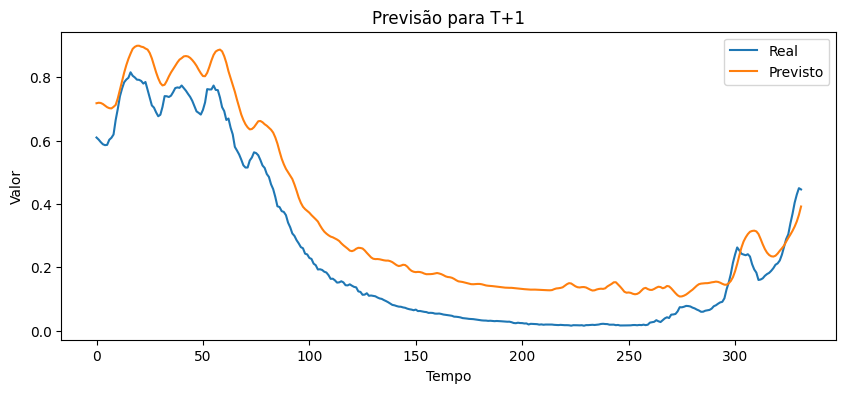

Horizonte 2: MSE = 0.010, RMSE = 0.101, R² = 0.859


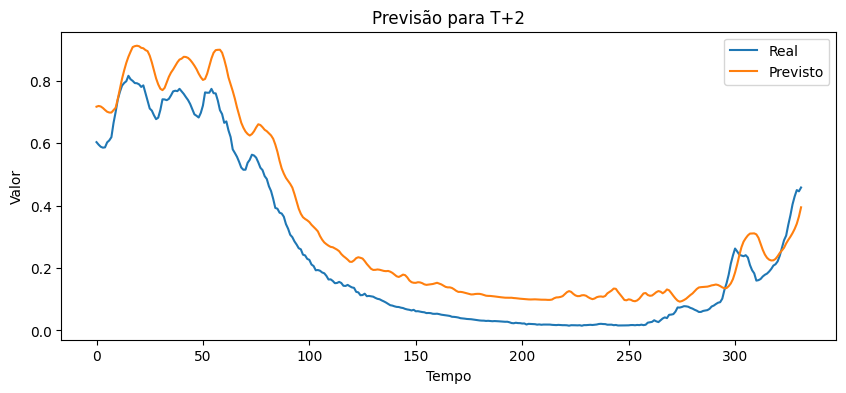

Horizonte 3: MSE = 0.013, RMSE = 0.114, R² = 0.819


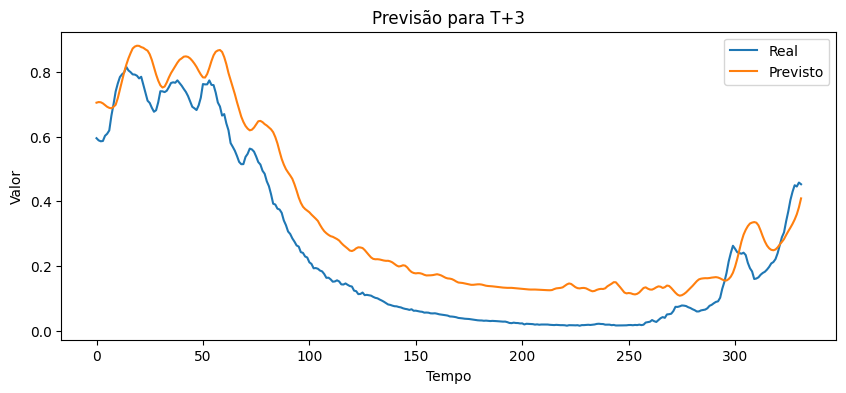

Horizonte 4: MSE = 0.010, RMSE = 0.100, R² = 0.859


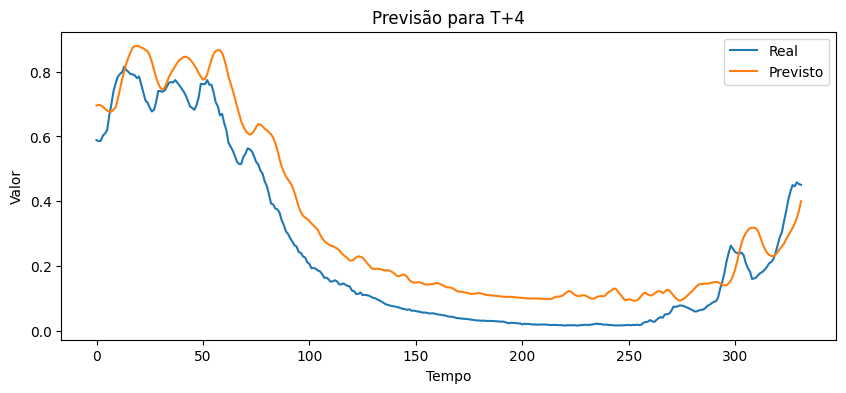

Horizonte 5: MSE = 0.010, RMSE = 0.101, R² = 0.857


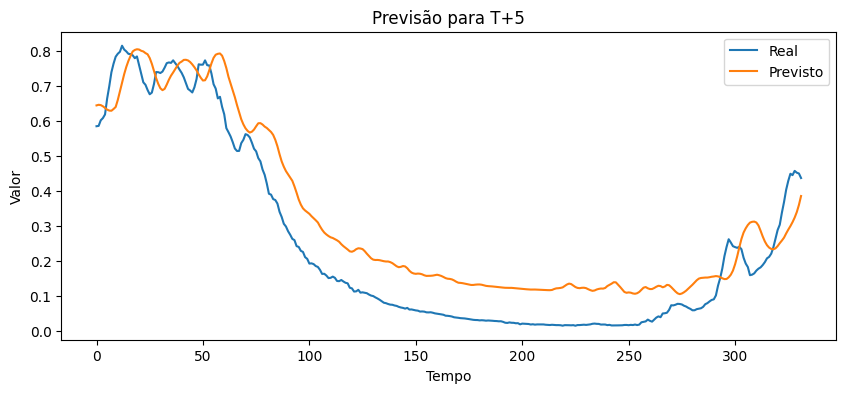

Horizonte 6: MSE = 0.013, RMSE = 0.115, R² = 0.813


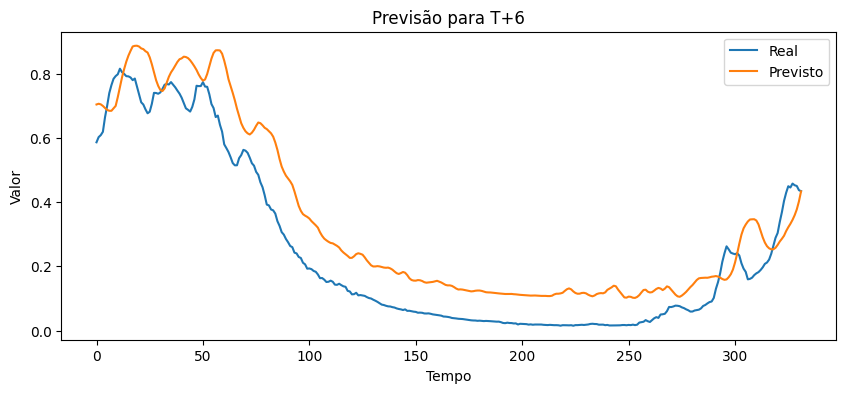

Horizonte 7: MSE = 0.012, RMSE = 0.111, R² = 0.824


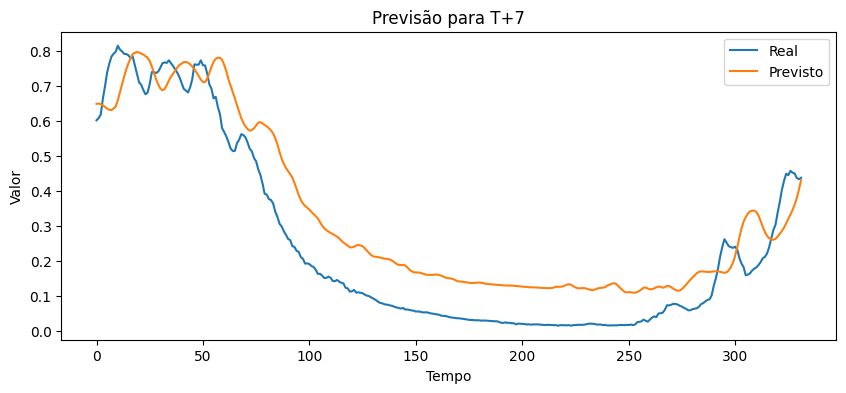

Horizonte 8: MSE = 0.015, RMSE = 0.121, R² = 0.792


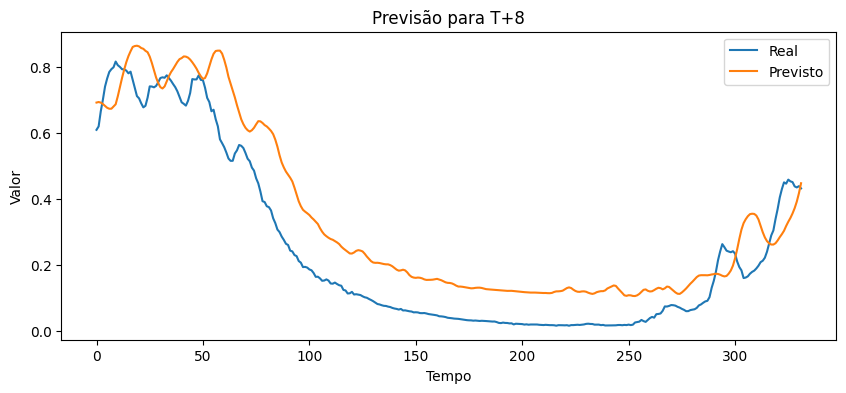

Horizonte 9: MSE = 0.011, RMSE = 0.104, R² = 0.845


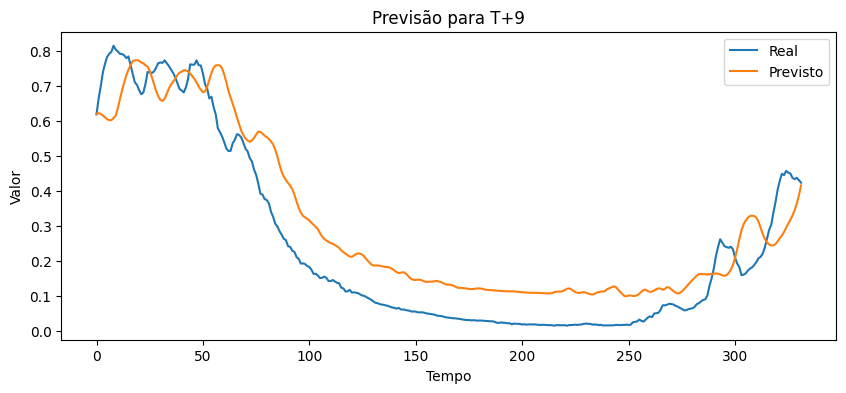

Horizonte 10: MSE = 0.015, RMSE = 0.122, R² = 0.787


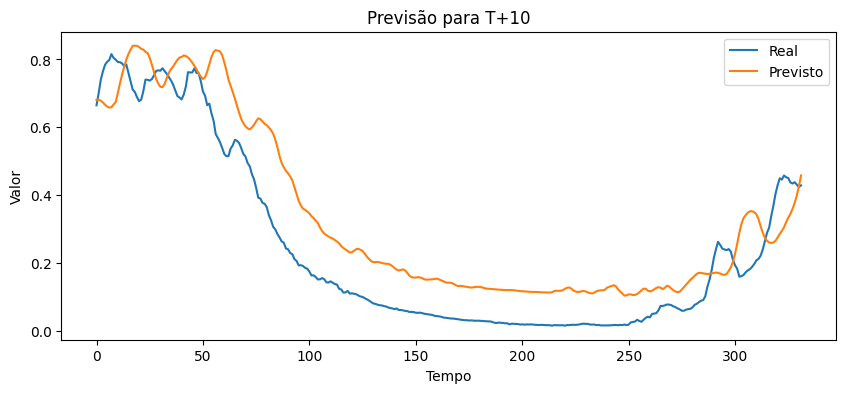

Horizonte 11: MSE = 0.011, RMSE = 0.107, R² = 0.835


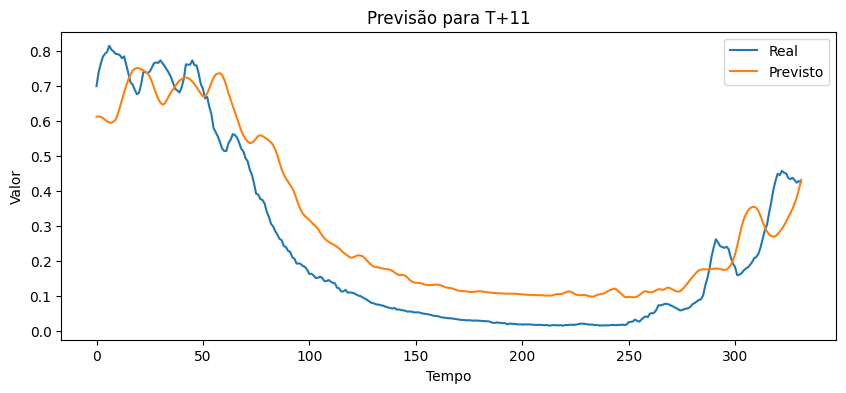

Horizonte 12: MSE = 0.016, RMSE = 0.125, R² = 0.774


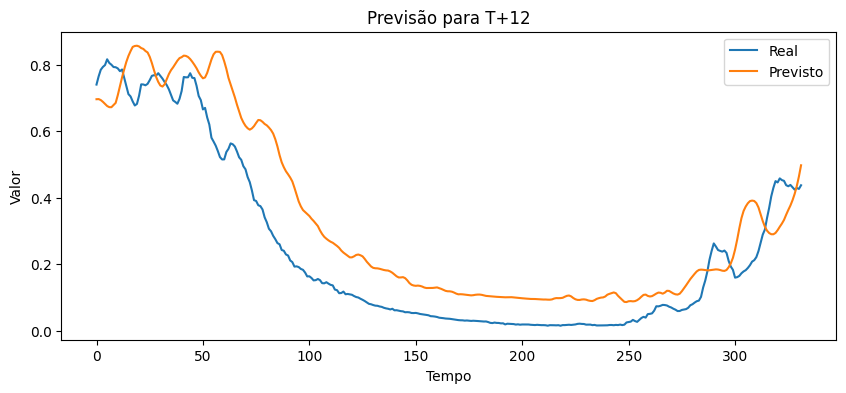

Horizonte 13: MSE = 0.012, RMSE = 0.109, R² = 0.825


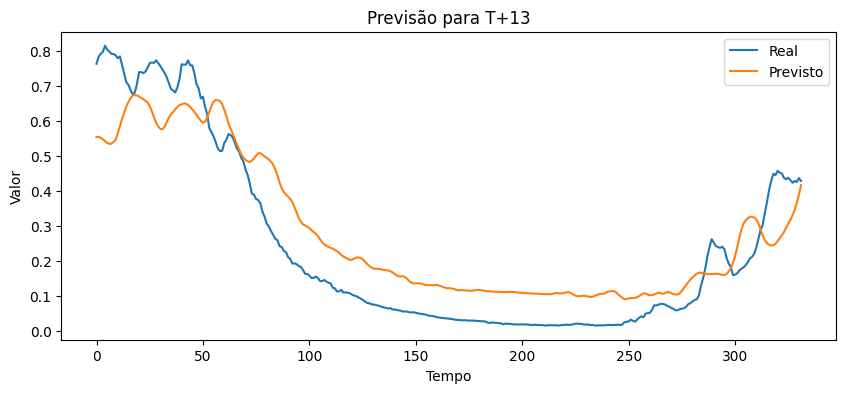

Horizonte 14: MSE = 0.017, RMSE = 0.131, R² = 0.746


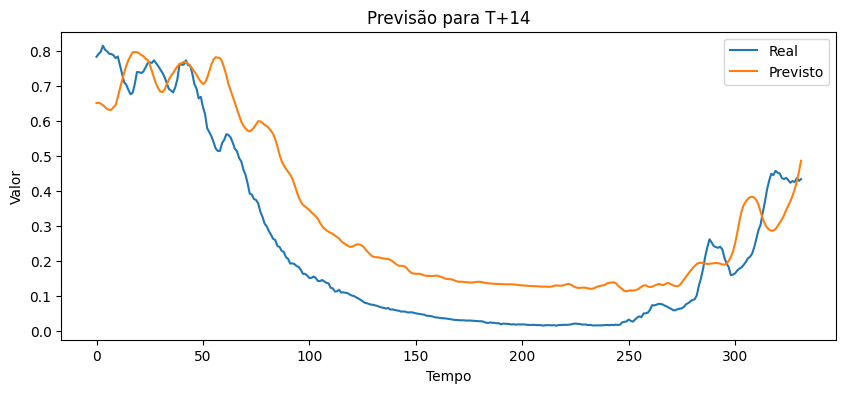

Horizonte 15: MSE = 0.012, RMSE = 0.109, R² = 0.820


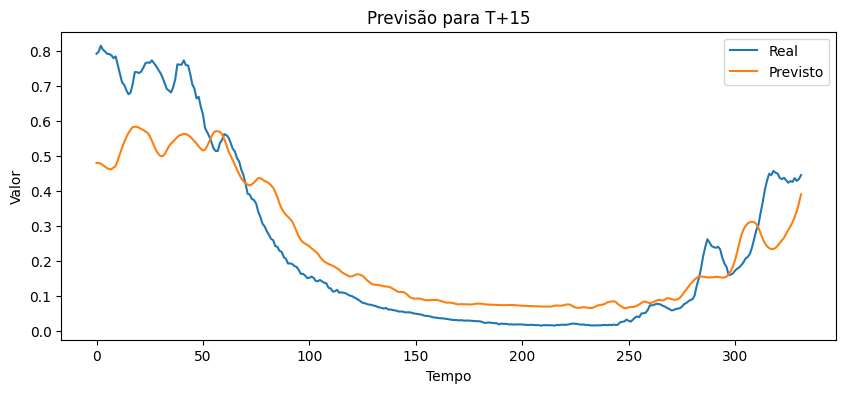

Horizonte 16: MSE = 0.015, RMSE = 0.122, R² = 0.773


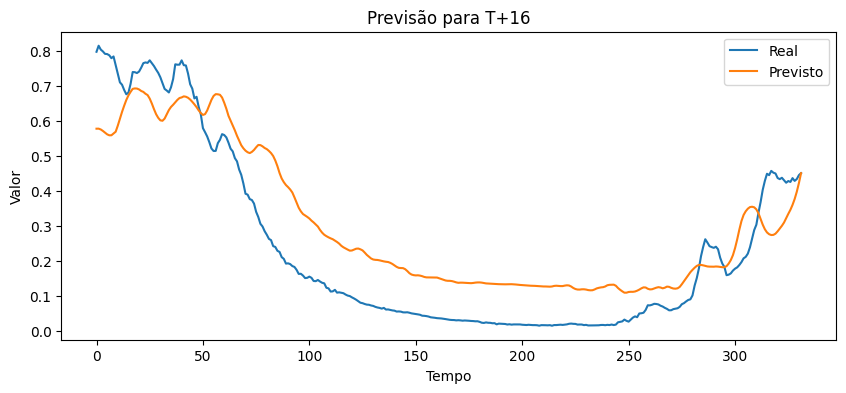

Horizonte 17: MSE = 0.010, RMSE = 0.102, R² = 0.841


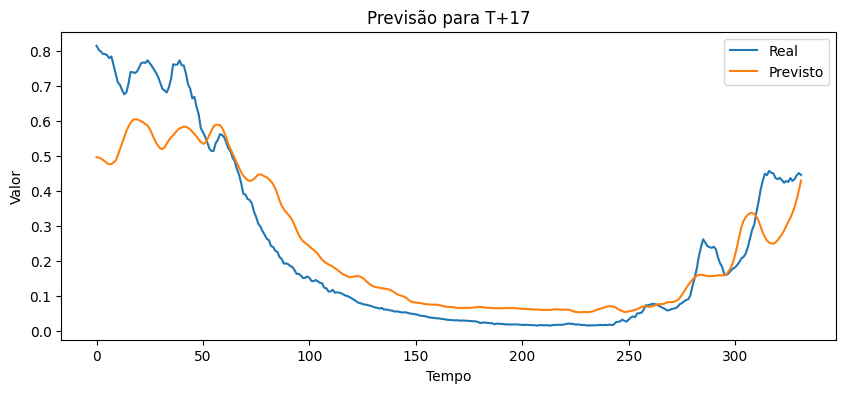

Horizonte 18: MSE = 0.013, RMSE = 0.113, R² = 0.802


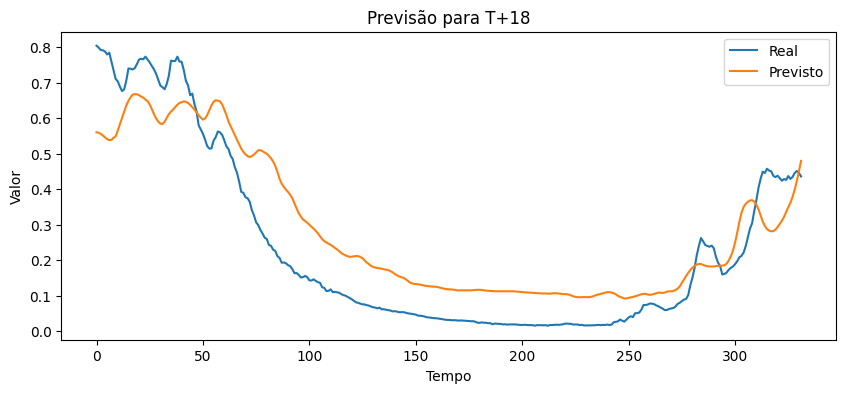

Horizonte 19: MSE = 0.014, RMSE = 0.117, R² = 0.783


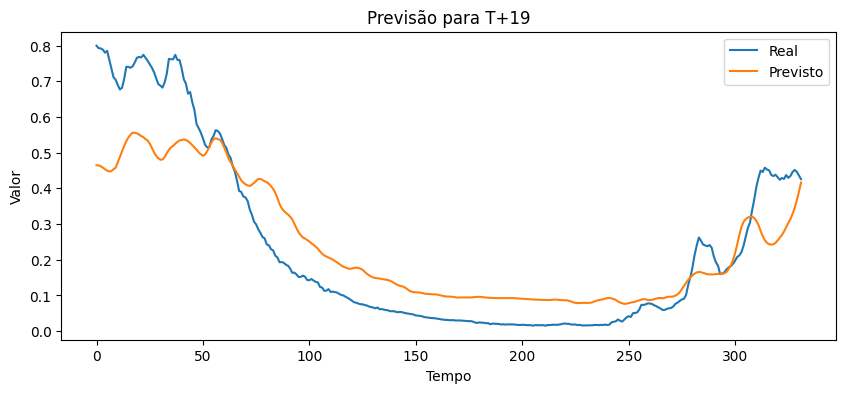

Horizonte 20: MSE = 0.012, RMSE = 0.108, R² = 0.812


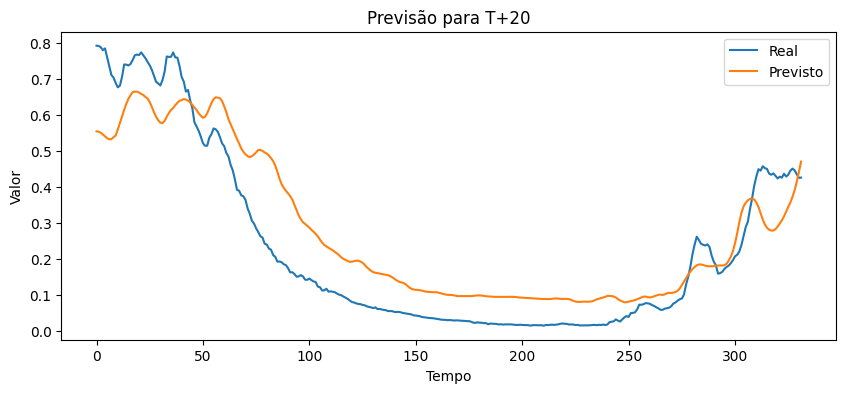

Horizonte 21: MSE = 0.011, RMSE = 0.104, R² = 0.824


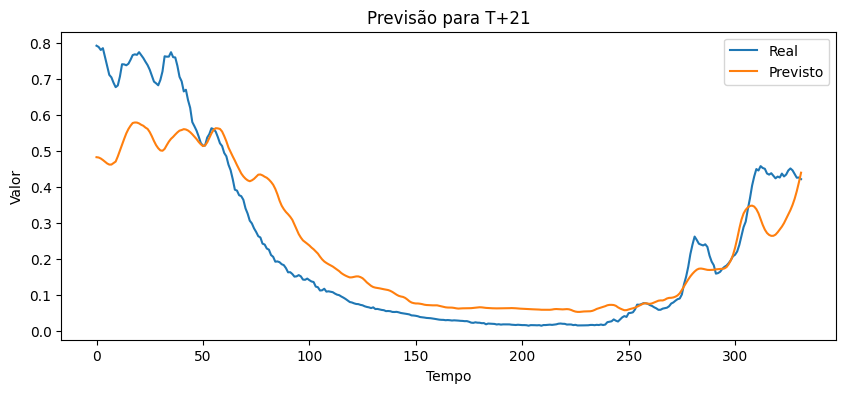

Horizonte 22: MSE = 0.015, RMSE = 0.123, R² = 0.751


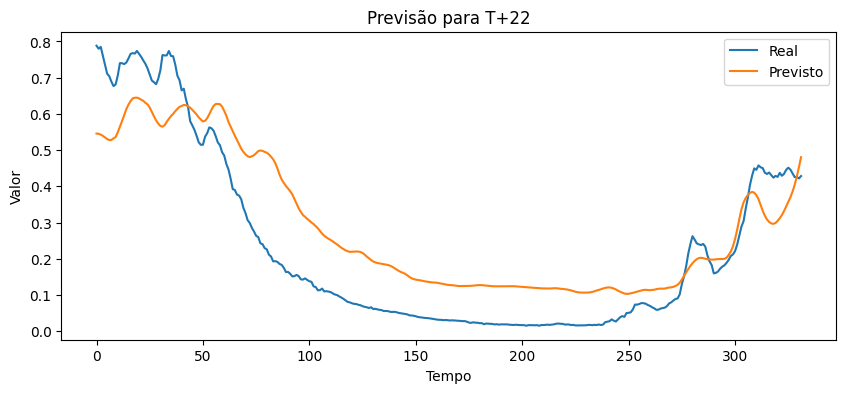

Horizonte 23: MSE = 0.014, RMSE = 0.118, R² = 0.768


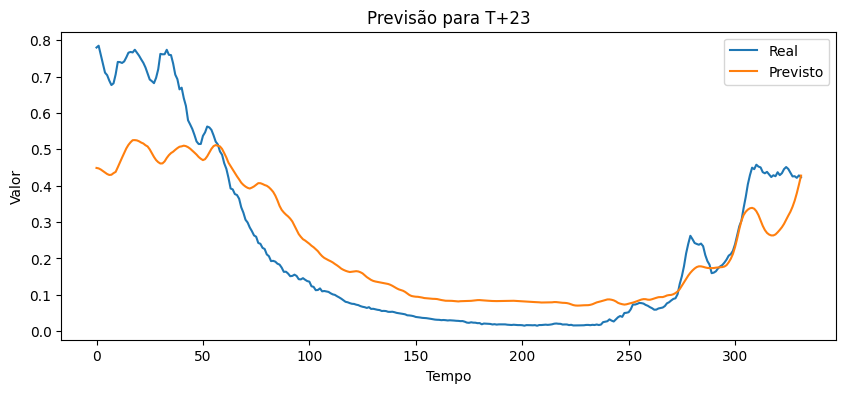

Horizonte 24: MSE = 0.014, RMSE = 0.119, R² = 0.762


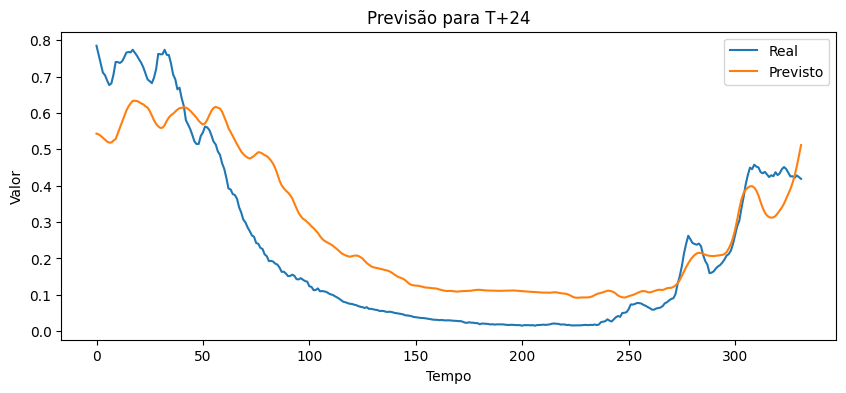

Horizonte 25: MSE = 0.011, RMSE = 0.107, R² = 0.805


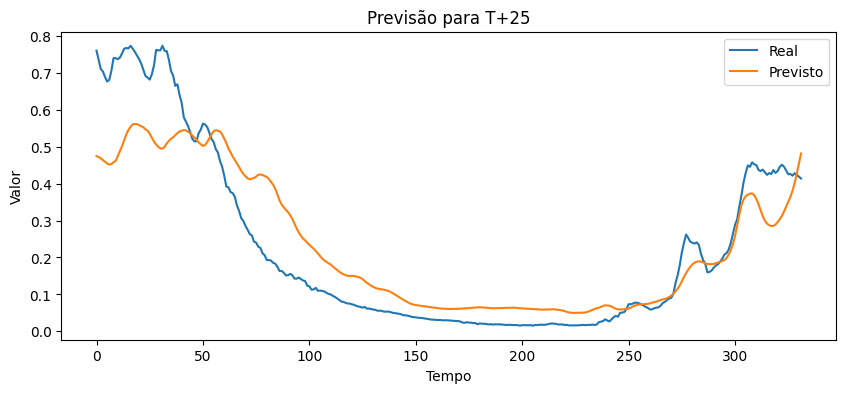

Horizonte 26: MSE = 0.014, RMSE = 0.120, R² = 0.752


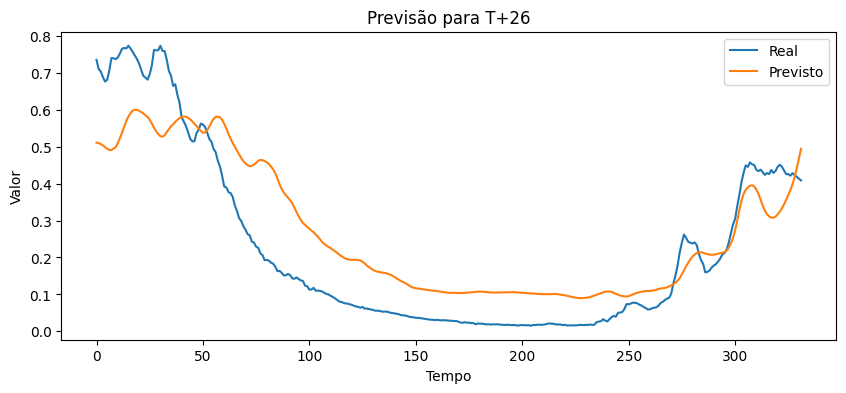

Horizonte 27: MSE = 0.014, RMSE = 0.117, R² = 0.759


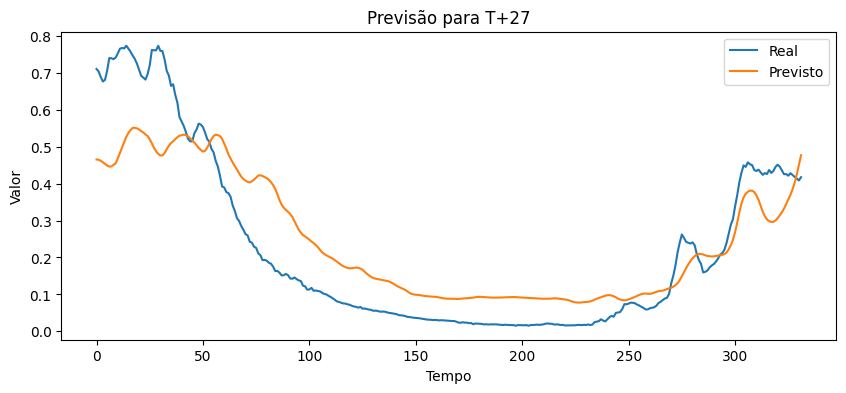

Horizonte 28: MSE = 0.015, RMSE = 0.123, R² = 0.733


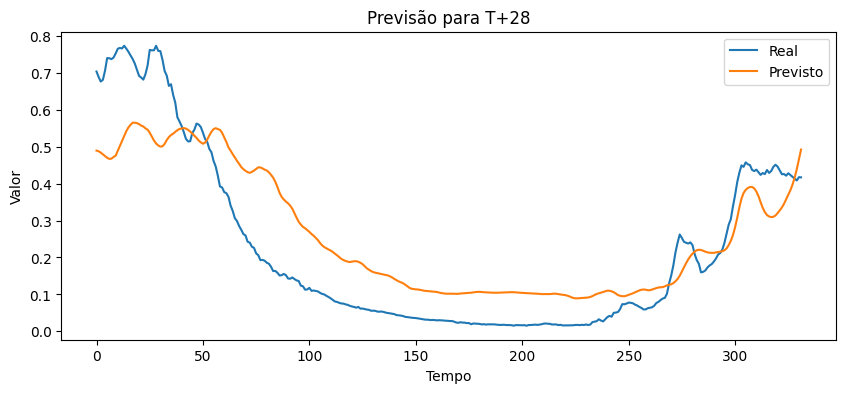

Horizonte 29: MSE = 0.014, RMSE = 0.116, R² = 0.757


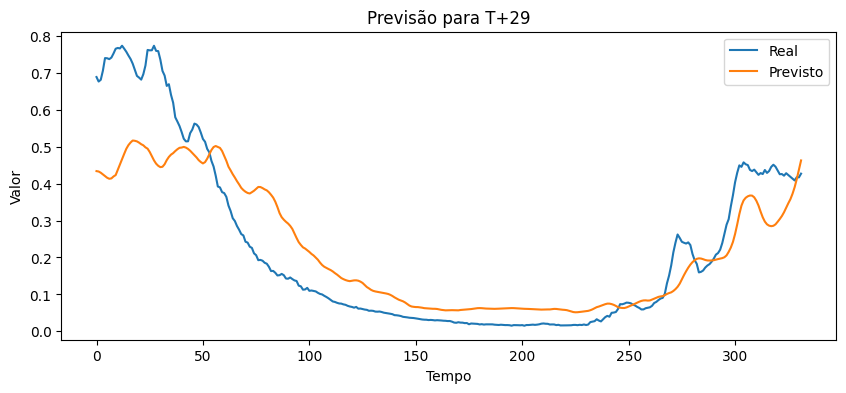

Horizonte 30: MSE = 0.013, RMSE = 0.116, R² = 0.757


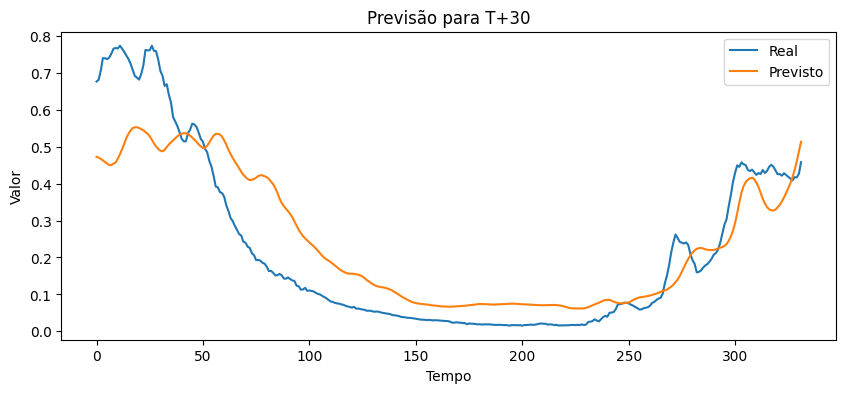

In [ ]:
# Modelo LSTM
regressor = Sequential()
regressor.add(LSTM(units=256, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
regressor.add(GRU(units=256, return_sequences=False))
regressor.add(Dropout(0.2))
regressor.add(Dense(units=n_future, activation='relu'))
regressor.compile(optimizer='adam', loss='mse')

# Callbacks
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=5, restore_best_weights=True)

# Treinamento
history = regressor.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=40, batch_size=8, callbacks=[es])

# Avaliação e Visualização
y_pred = regressor.predict(X_test)

for i in range(n_future):
    y_true = y_test[:, i]
    y_pred_i = y_pred[:, i]

    mse = mean_squared_error(y_true, y_pred_i)
    rmse = sqrt(mse)
    r2 = r2_score(y_true, y_pred_i)

    print(f'Horizonte {i+1}: MSE = {mse:.3f}, RMSE = {rmse:.3f}, R² = {r2:.3f}')

    plt.figure(figsize=(10, 4))
    plt.plot(y_true, label='Real')
    plt.plot(y_pred_i, label='Previsto')
    plt.title(f'Previsão para T+{i+1}')
    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()


Regressão Linear - Horizonte 1: MSE = 0.029, RMSE = 0.171, R² = 0.594


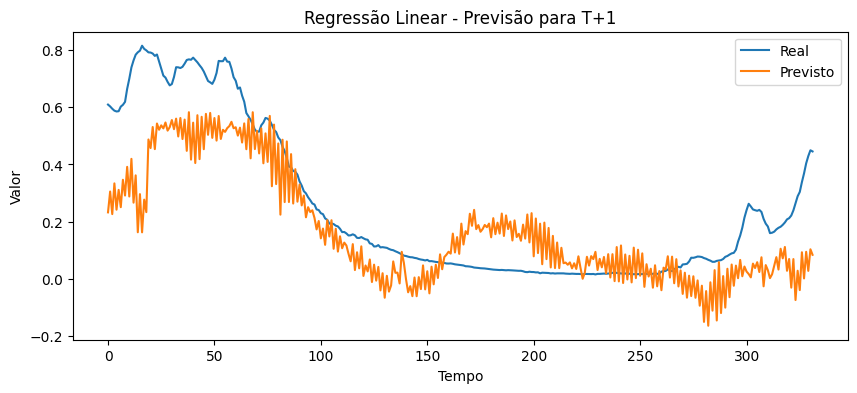

Regressão Linear - Horizonte 2: MSE = 0.031, RMSE = 0.177, R² = 0.567


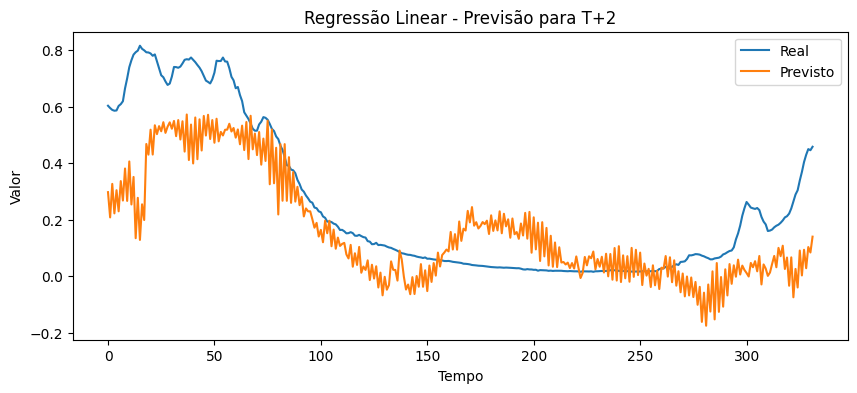

Regressão Linear - Horizonte 3: MSE = 0.037, RMSE = 0.192, R² = 0.486


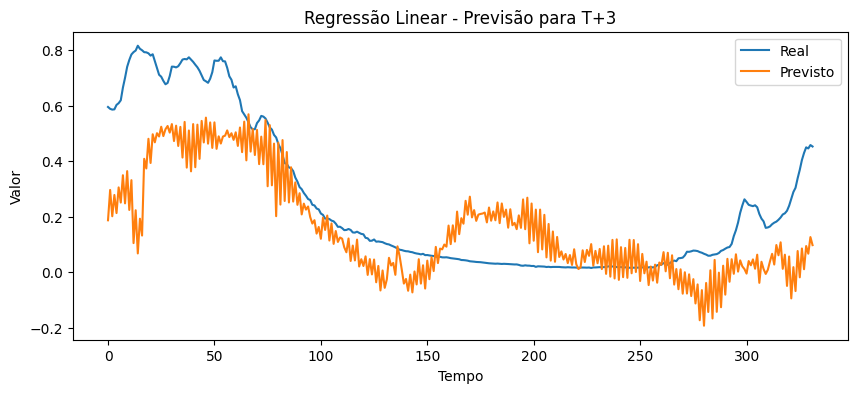

Regressão Linear - Horizonte 4: MSE = 0.032, RMSE = 0.178, R² = 0.554


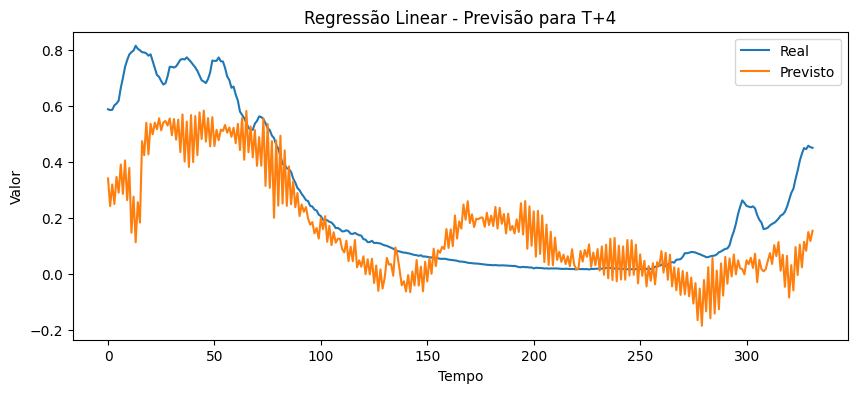

Regressão Linear - Horizonte 5: MSE = 0.039, RMSE = 0.196, R² = 0.458


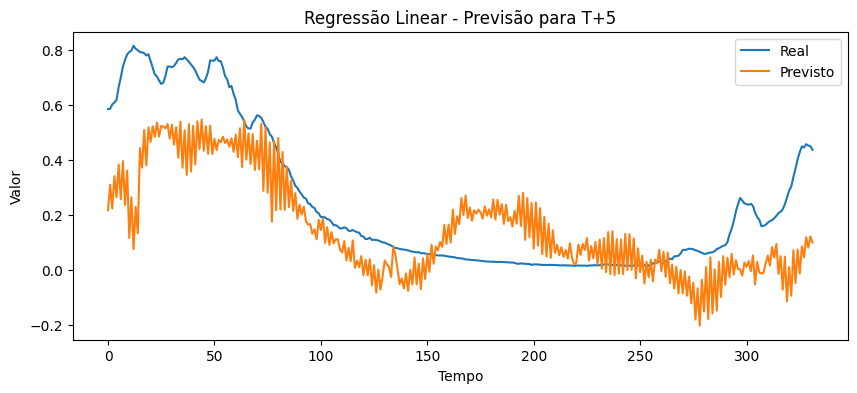

Regressão Linear - Horizonte 6: MSE = 0.038, RMSE = 0.195, R² = 0.465


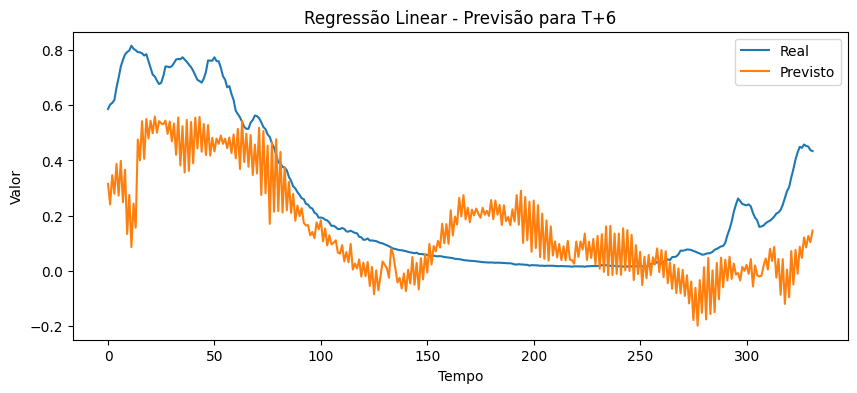

Regressão Linear - Horizonte 7: MSE = 0.037, RMSE = 0.193, R² = 0.474


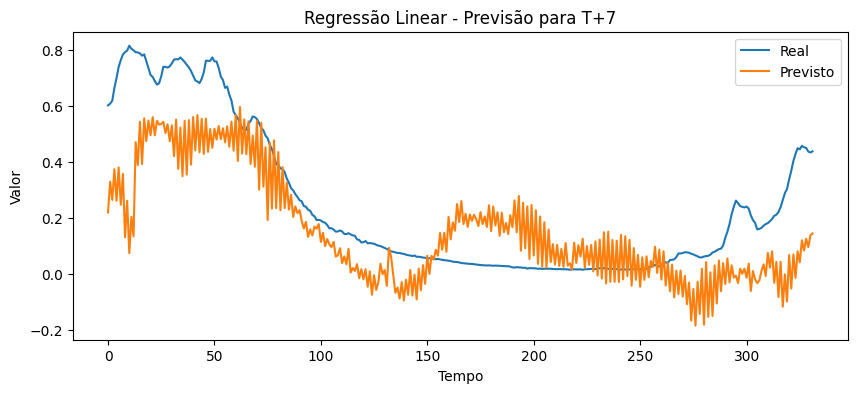

Regressão Linear - Horizonte 8: MSE = 0.037, RMSE = 0.192, R² = 0.478


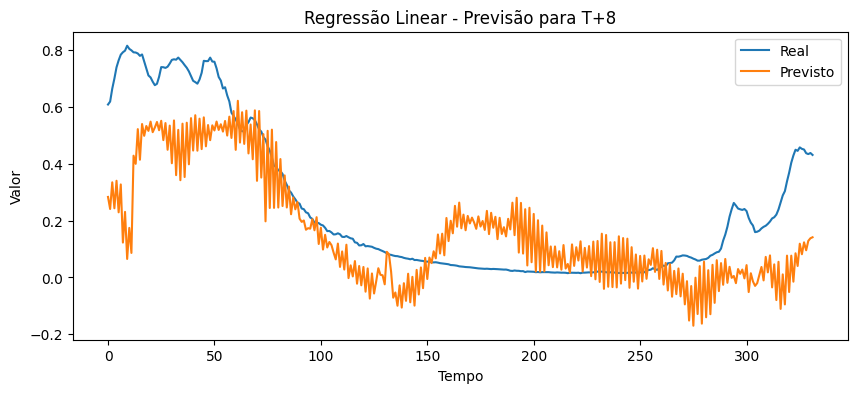

Regressão Linear - Horizonte 9: MSE = 0.040, RMSE = 0.199, R² = 0.434


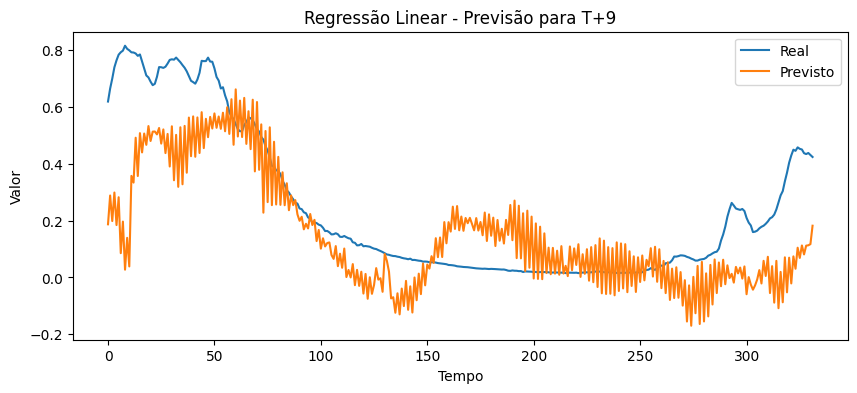

Regressão Linear - Horizonte 10: MSE = 0.047, RMSE = 0.216, R² = 0.331


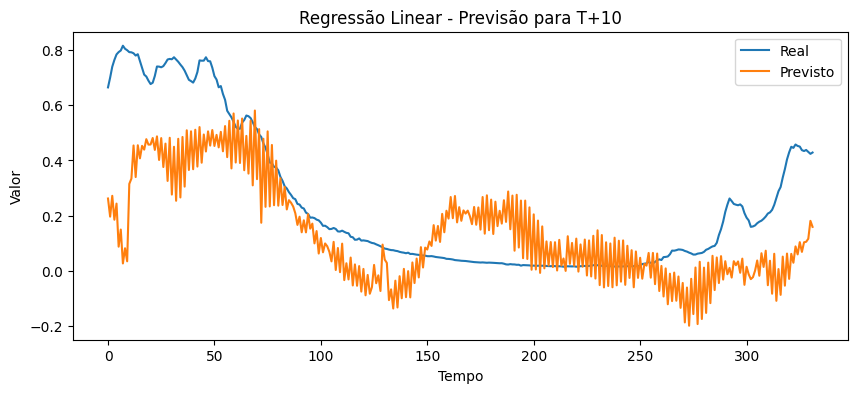

Regressão Linear - Horizonte 11: MSE = 0.047, RMSE = 0.216, R² = 0.326


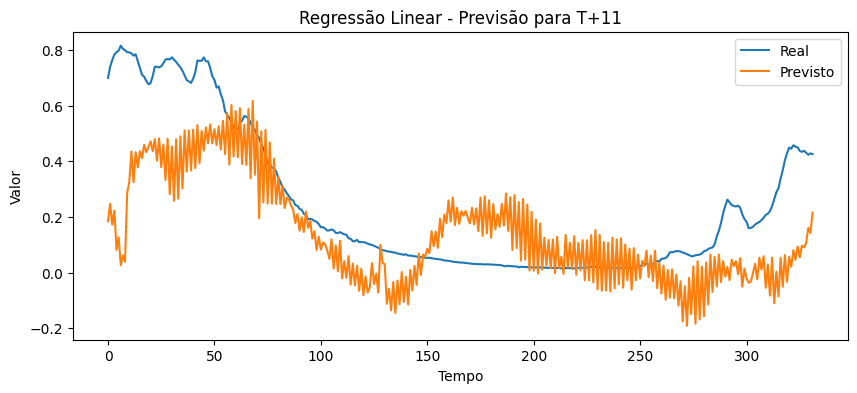

Regressão Linear - Horizonte 12: MSE = 0.044, RMSE = 0.210, R² = 0.359


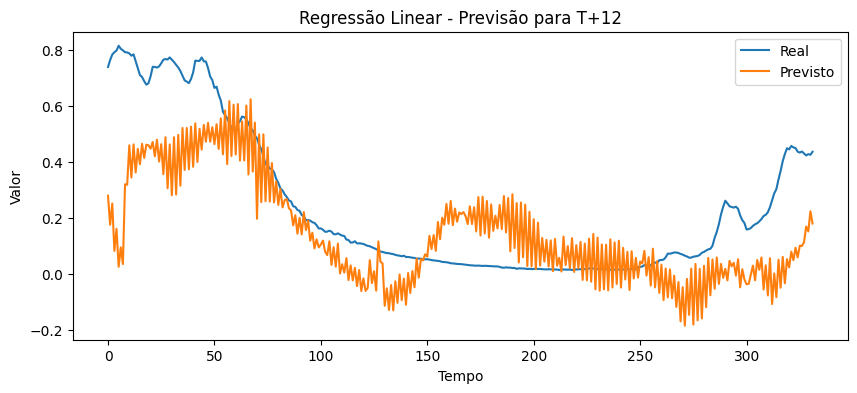

Regressão Linear - Horizonte 13: MSE = 0.043, RMSE = 0.208, R² = 0.368


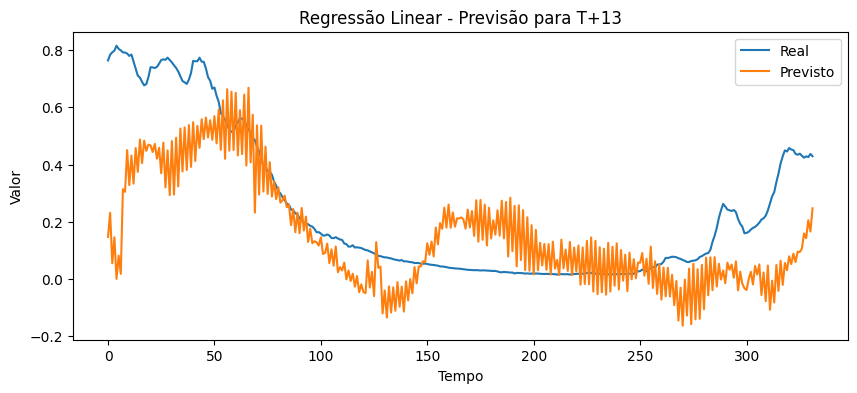

Regressão Linear - Horizonte 14: MSE = 0.043, RMSE = 0.208, R² = 0.361


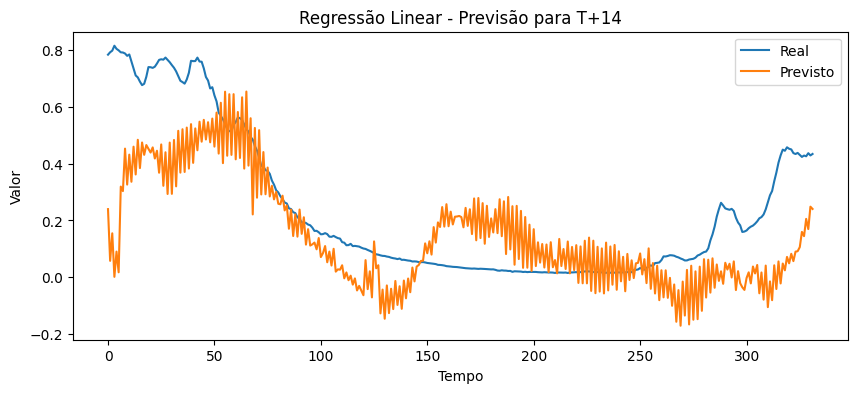

Regressão Linear - Horizonte 15: MSE = 0.044, RMSE = 0.209, R² = 0.343


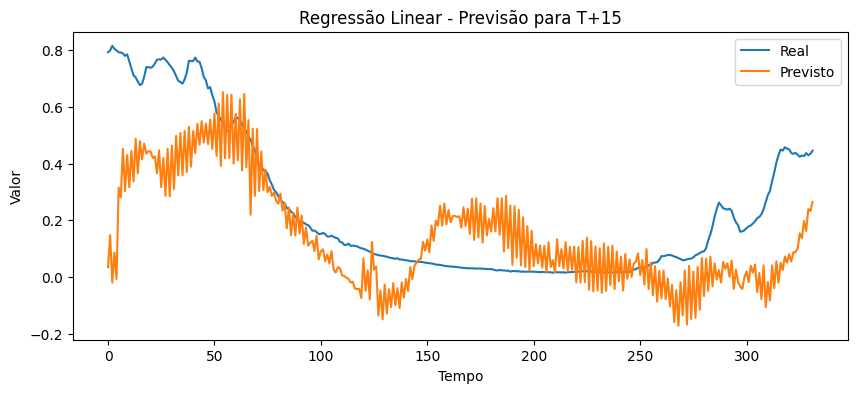

Regressão Linear - Horizonte 16: MSE = 0.041, RMSE = 0.203, R² = 0.373


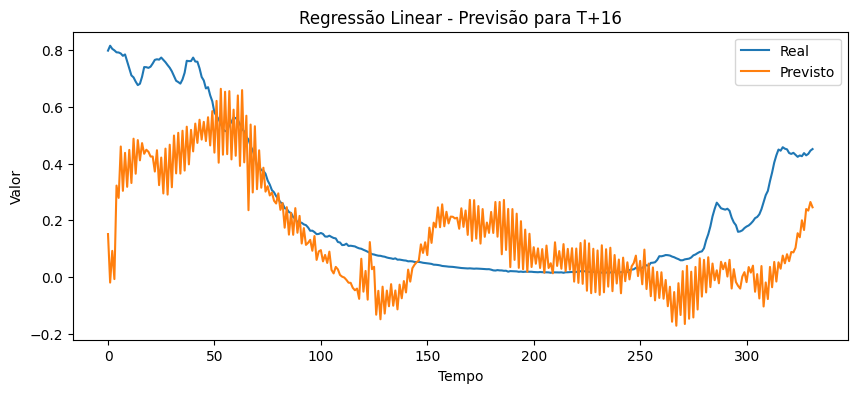

Regressão Linear - Horizonte 17: MSE = 0.040, RMSE = 0.199, R² = 0.390


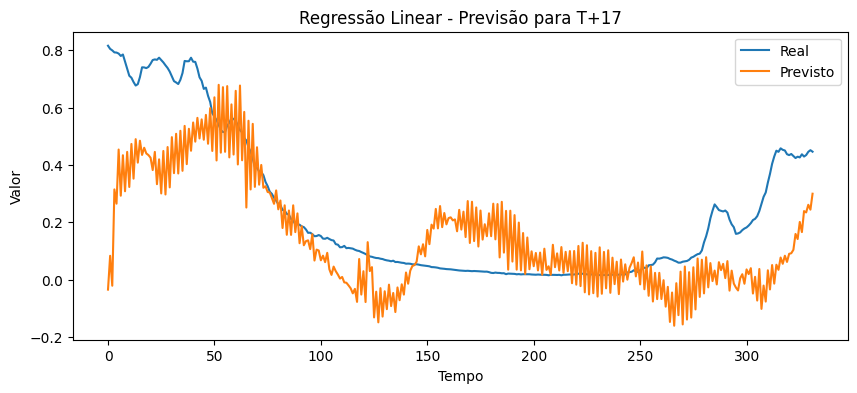

Regressão Linear - Horizonte 18: MSE = 0.038, RMSE = 0.195, R² = 0.409


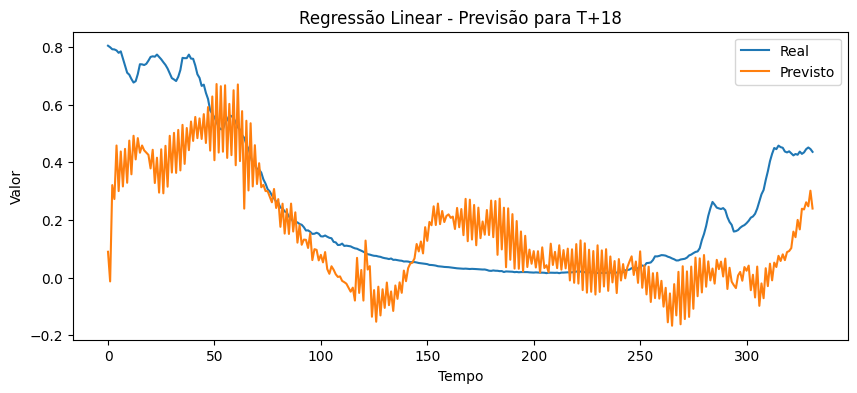

Regressão Linear - Horizonte 19: MSE = 0.034, RMSE = 0.184, R² = 0.466


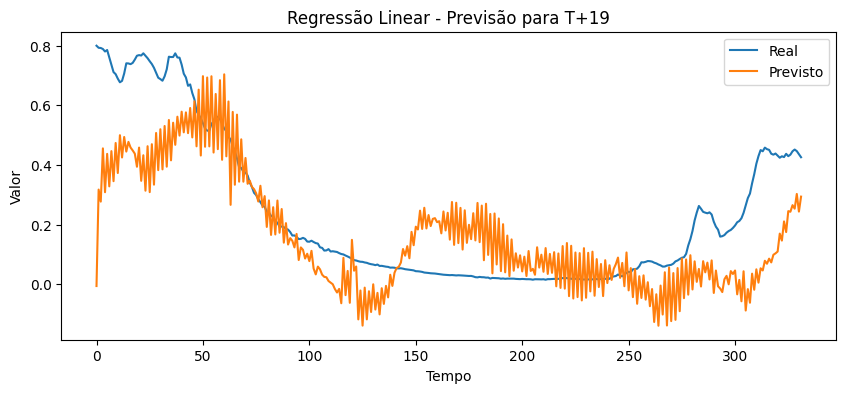

Regressão Linear - Horizonte 20: MSE = 0.033, RMSE = 0.181, R² = 0.479


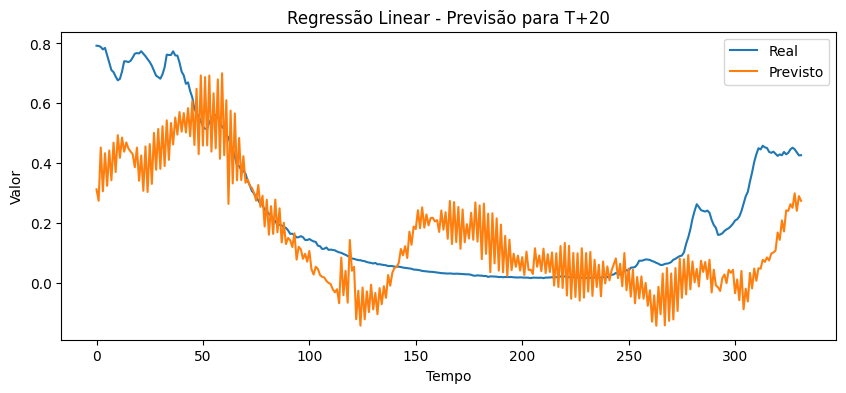

Regressão Linear - Horizonte 21: MSE = 0.030, RMSE = 0.173, R² = 0.514


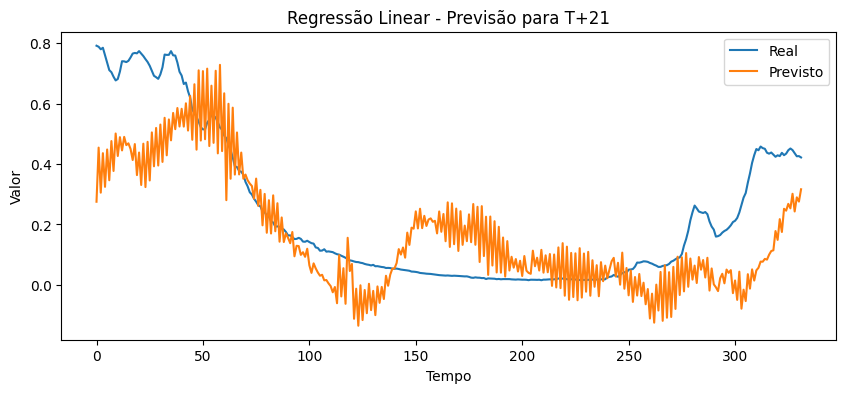

Regressão Linear - Horizonte 22: MSE = 0.030, RMSE = 0.174, R² = 0.504


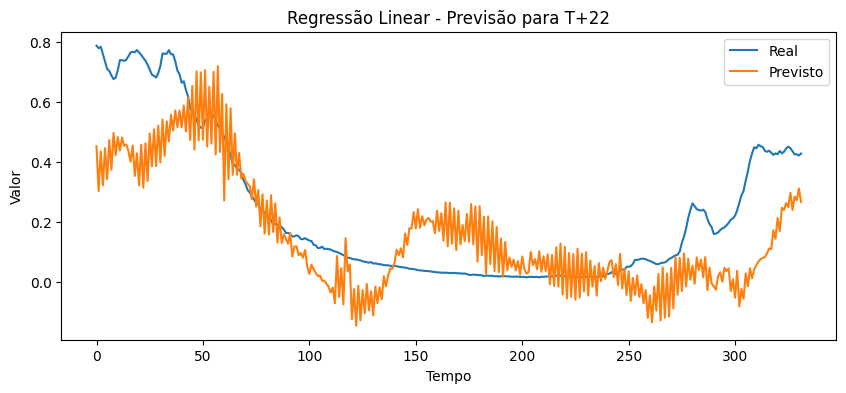

Regressão Linear - Horizonte 23: MSE = 0.029, RMSE = 0.170, R² = 0.521


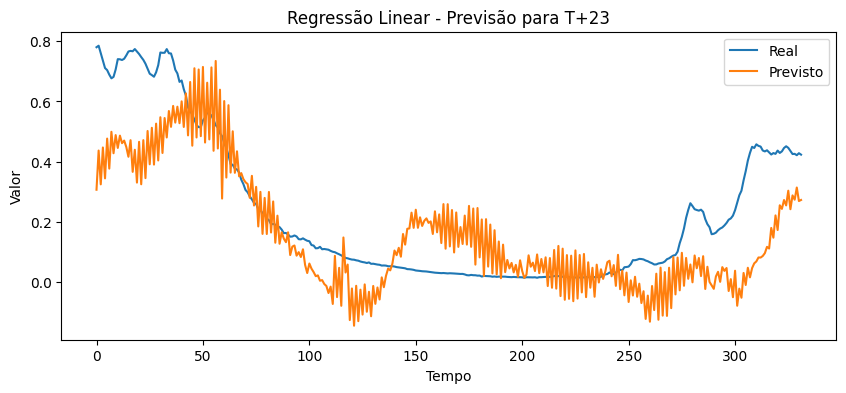

Regressão Linear - Horizonte 24: MSE = 0.028, RMSE = 0.169, R² = 0.519


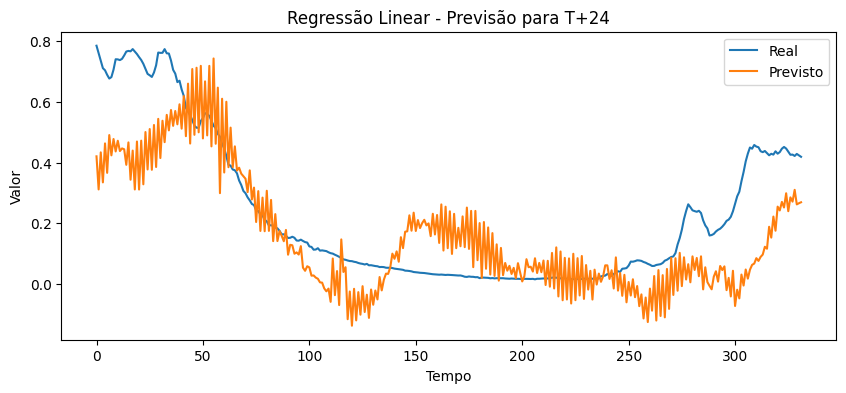

Regressão Linear - Horizonte 25: MSE = 0.026, RMSE = 0.162, R² = 0.552


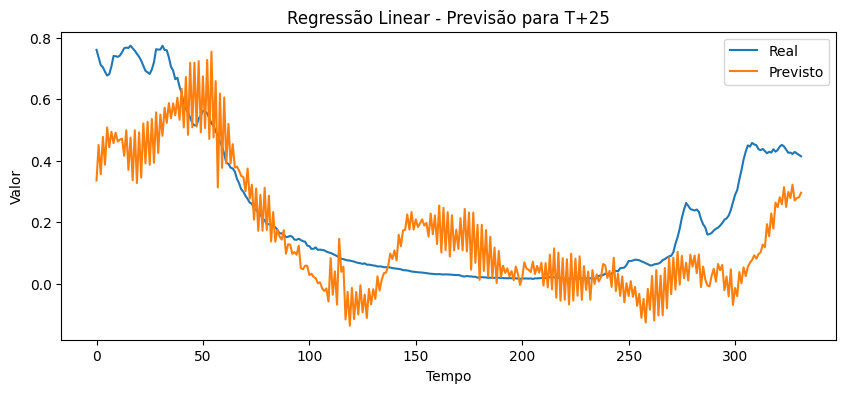

Regressão Linear - Horizonte 26: MSE = 0.025, RMSE = 0.158, R² = 0.567


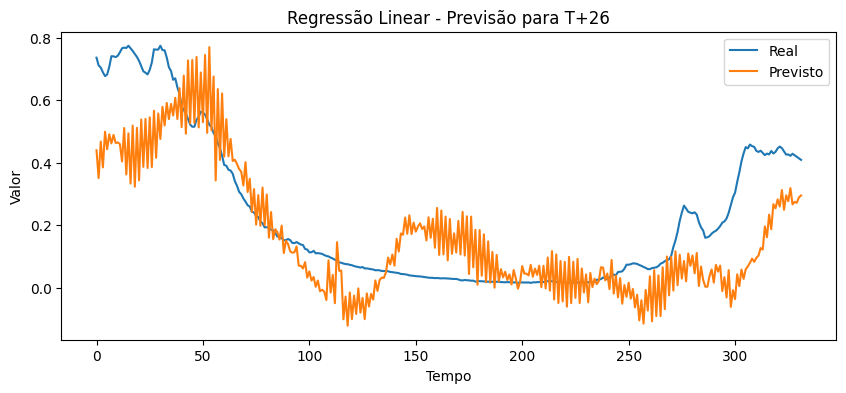

Regressão Linear - Horizonte 27: MSE = 0.023, RMSE = 0.153, R² = 0.588


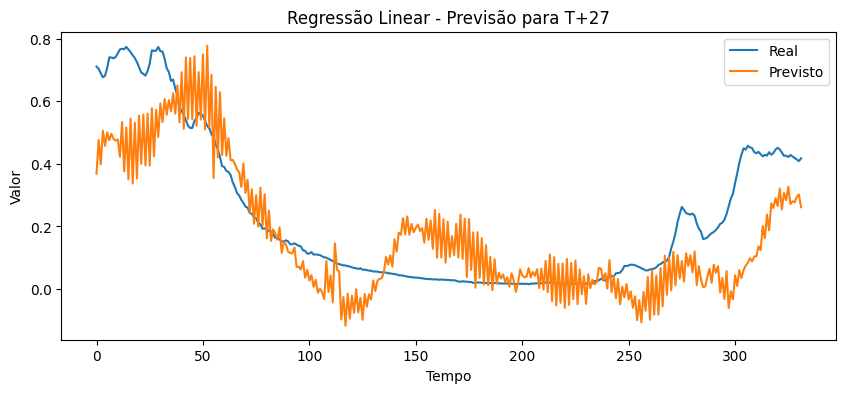

Regressão Linear - Horizonte 28: MSE = 0.023, RMSE = 0.152, R² = 0.591


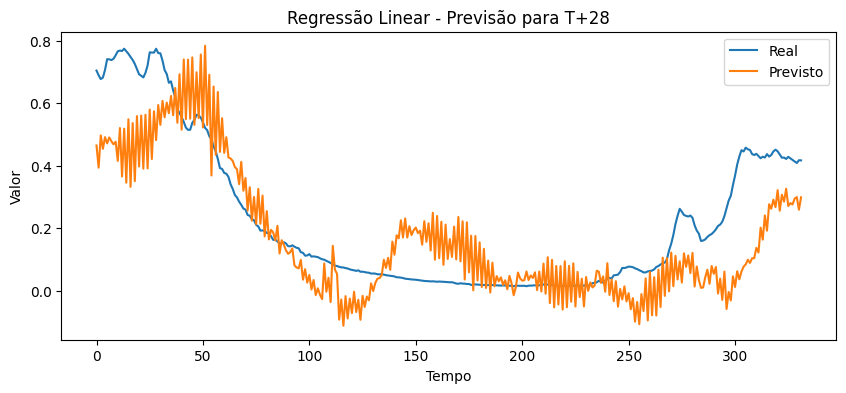

Regressão Linear - Horizonte 29: MSE = 0.023, RMSE = 0.150, R² = 0.595


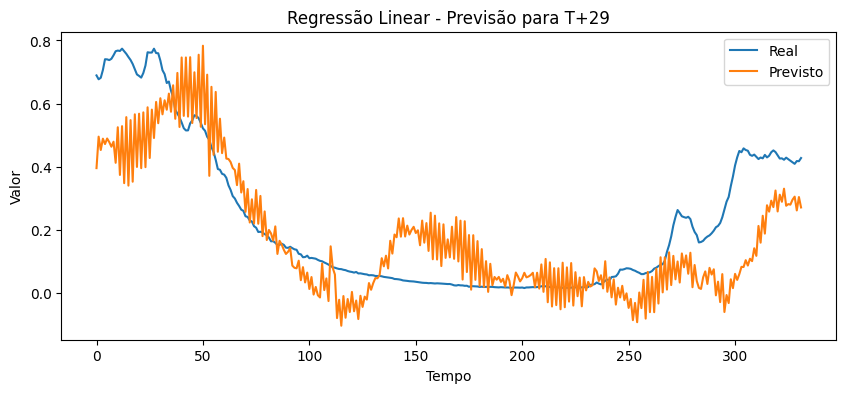

Regressão Linear - Horizonte 30: MSE = 0.023, RMSE = 0.151, R² = 0.588


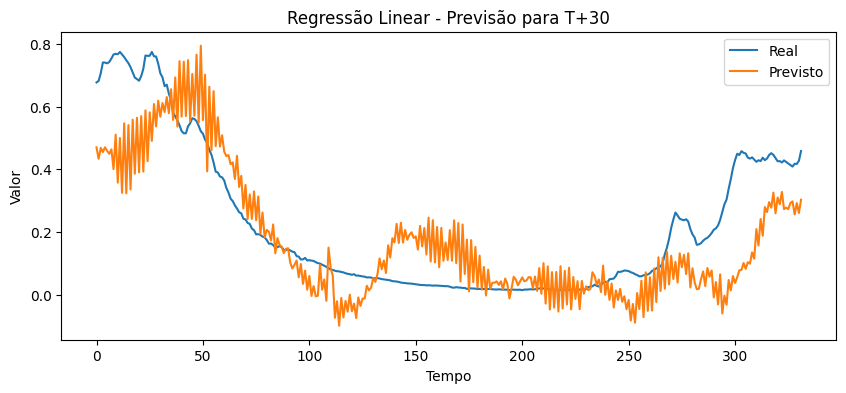

In [ ]:
# Preparar os dados para regressão linear (não precisam ser 3D)
X_train_flat = X_train.reshape(X_train.shape[0], -1)
X_val_flat = X_val.reshape(X_val.shape[0], -1)
X_test_flat = X_test.reshape(X_test.shape[0], -1)

# Modelo de Regressão Linear
linear_model = LinearRegression()

# Treinar o modelo
linear_model.fit(X_train_flat, y_train)

# Previsões
y_pred_linear = linear_model.predict(X_test_flat)

# Avaliação e Visualização
for i in range(n_future):
    y_true = y_test[:, i]
    y_pred_i = y_pred_linear[:, i]

    mse = mean_squared_error(y_true, y_pred_i)
    rmse = sqrt(mse)
    r2 = r2_score(y_true, y_pred_i)

    print(f'Regressão Linear - Horizonte {i+1}: MSE = {mse:.3f}, RMSE = {rmse:.3f}, R² = {r2:.3f}')

    plt.figure(figsize=(10, 4))
    plt.plot(y_true, label='Real')
    plt.plot(y_pred_i, label='Previsto')
    plt.title(f'Regressão Linear - Previsão para T+{i+1}')
    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()


ARIMA - MSE: 12.854, RMSE: 3.585, R²: 0.980


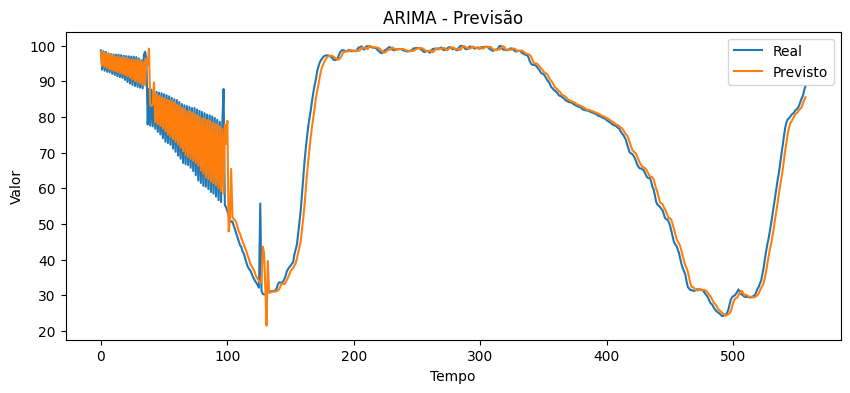

In [ ]:
# Preparar os dados para ARIMA (usar apenas a série temporal)
train_size = int(0.7 * len(df_tucurui))
train, test = df_tucurui['volume_armazenado'][:train_size], df_tucurui['volume_armazenado'][train_size:]

history = [x for x in train]
predictions = []

# Modelo ARIMA
for t in range(len(test)):
    model = ARIMA(history, order=(5, 1, 0))
    model_fit = model.fit()
    output = model_fit.forecast()
    yhat = output[0]
    predictions.append(yhat)
    history.append(test.iloc[t])

# Calcular métricas
y_test_flat = test.values
y_pred_arima = np.array(predictions)

mse_arima = mean_squared_error(y_test_flat, y_pred_arima)
rmse_arima = sqrt(mse_arima)
r2_arima = r2_score(y_test_flat, y_pred_arima)

print(f'ARIMA - MSE: {mse_arima:.3f}, RMSE: {rmse_arima:.3f}, R²: {r2_arima:.3f}')

# Visualização
plt.figure(figsize=(10, 4))
plt.plot(y_test_flat, label='Real')
plt.plot(y_pred_arima, label='Previsto')
plt.title('ARIMA - Previsão')
plt.xlabel('Tempo')
plt.ylabel('Valor')
plt.legend()
plt.show()


ARIMA - MSE: 186.556, RMSE: 13.659, R²: 0.721


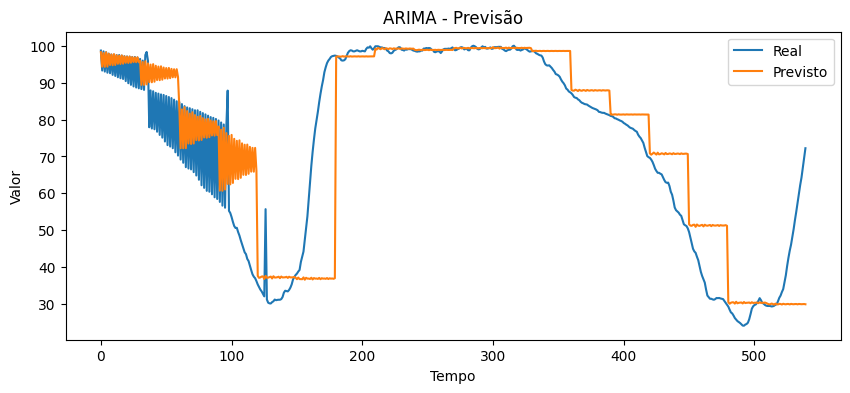

In [ ]:
from statsmodels.tsa.arima.model import ARIMA

# Preparar os dados para ARIMA (usar apenas a série temporal)
train_size = int(0.7 * len(df_tucurui))
train, test = df_tucurui['volume_armazenado'][:train_size], df_tucurui['volume_armazenado'][train_size:]

history = [x for x in train]
predictions = []

# Modelo ARIMA para prever 30 dias à frente
for i in range(0, len(test) - n_future + 1, n_future):
    model = ARIMA(history, order=(5, 1, 0))
    model_fit = model.fit()
    output = model_fit.forecast(steps=n_future)
    yhat = output.tolist()
    predictions.extend(yhat)
    history.extend(test.iloc[i:i + n_future])

# Calcular métricas
y_test_flat = test.values[:len(predictions)]
y_pred_arima = np.array(predictions)

mse_arima = mean_squared_error(y_test_flat, y_pred_arima)
rmse_arima = sqrt(mse_arima)
r2_arima = r2_score(y_test_flat, y_pred_arima)

print(f'ARIMA - MSE: {mse_arima:.3f}, RMSE: {rmse_arima:.3f}, R²: {r2_arima:.3f}')

# Visualização
plt.figure(figsize=(10, 4))
plt.plot(y_test_flat, label='Real')
plt.plot(y_pred_arima, label='Previsto')
plt.title('ARIMA - Previsão')
plt.xlabel('Tempo')
plt.ylabel('Valor')
plt.legend()
plt.show()


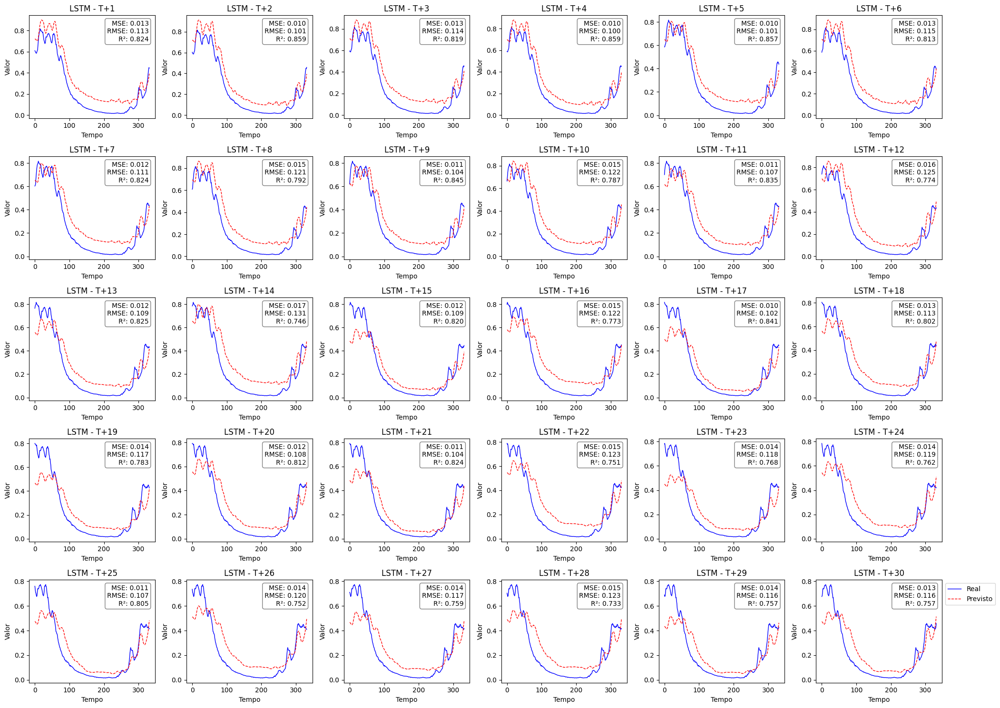

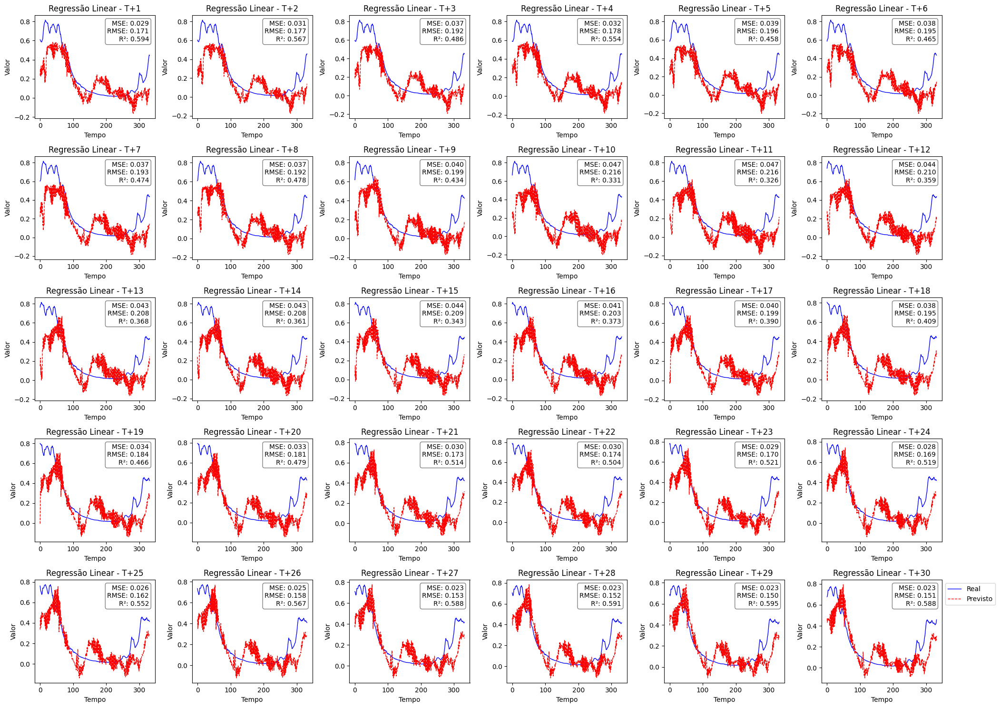

IndexError: index 1 is out of bounds for axis 1 with size 1

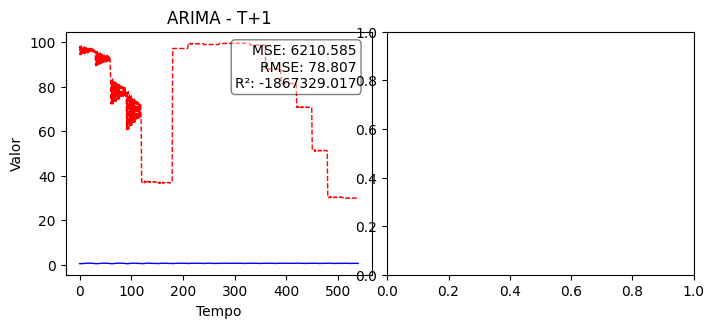

In [ ]:
import matplotlib.pyplot as plt
from math import sqrt
from sklearn.metrics import mean_squared_error, r2_score

# Função para plotar os resultados
def plot_results(y_test, y_pred, model_name):
    n_rows = 5
    n_cols = 6
    n_future = 30  # Número total de dias que você está prevendo

    # Cria uma figura grande para acomodar todos os subplots
    plt.figure(figsize=(20, 15))

    # Itera sobre cada horizonte de tempo e cria um subplot para cada um
    for i in range(n_future):
        ax = plt.subplot(n_rows, n_cols, i+1)
        plt.plot(y_test[:, i], label='Real', color='blue', linewidth=1)
        plt.plot(y_pred[:, i], label='Previsto', color='red', linestyle='dashed', linewidth=1)
        plt.title(f'{model_name} - T+{i+1}')

        # Calcula as métricas para cada horizonte de tempo
        mse = mean_squared_error(y_test[:, i], y_pred[:, i])
        rmse = sqrt(mse)
        r2 = r2_score(y_test[:, i], y_pred[:, i])

        # Adiciona as métricas como texto no gráfico
        ax.text(0.95, 0.95, f'MSE: {mse:.3f}\nRMSE: {rmse:.3f}\nR²: {r2:.3f}',
                transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

        plt.xlabel('Tempo')
        plt.ylabel('Valor')
        plt.tight_layout()

    plt.legend(loc='upper left', bbox_to_anchor=(1,1))
    plt.show()

# Resultados para LSTM
plot_results(y_test, y_pred, 'LSTM')

# Resultados para Regressão Linear
plot_results(y_test, y_pred_linear, 'Regressão Linear')

# Previsões ARIMA - Tratamento especial porque ARIMA não prevê múltiplos horizontes de uma vez
# Repreparando os dados de teste para ARIMA
y_test_arima = y_test.flatten()[:len(y_pred_arima)]
plot_results(y_test_arima.reshape(-1, 1), y_pred_arima.reshape(-1, 1), 'ARIMA')


# 5

In [ ]:
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, r2_score
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense, GRU
from keras.callbacks import EarlyStopping
from math import sqrt
from sklearn.linear_model import LinearRegression
from statsmodels.tsa.arima.model import ARIMA

# Verificar se GPU está disponível
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

# Carregar e preprocessar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d').dt.date

# Selecionar os dados de Tucuruí
df_tucurui = df[df.id_posto == 275]
df_tucurui = df_tucurui.drop(['id_tempo', 'id_posto'], axis=1).reset_index(drop=True)

# Normalizar os dados
features = df_tucurui.drop(columns=['volume_armazenado'])
target = df_tucurui['volume_armazenado']

scaler = MinMaxScaler()
features_scaled = scaler.fit_transform(features)

# Função para criar dados para o horizonte de previsão
def create_data(df, max_future, n_past, train_test_split_percentage, validation_split_percentage):
    n_feature = df.shape[1]
    x_data, y_data = [], []

    for i in range(n_past, len(df) - max_future + 1):
        x_data.append(df[i - n_past:i, 0:n_feature])
        y_data.append([df[j, 0] for j in range(i, i + max_future)])

    split_training_test_starting_point = int(round(train_test_split_percentage * len(x_data)))
    split_train_validation_starting_point = int(round(split_training_test_starting_point * (1 - validation_split_percentage)))

    x_train = x_data[:split_train_validation_starting_point]
    y_train = y_data[:split_train_validation_starting_point]

    x_val = x_data[split_train_validation_starting_point:split_training_test_starting_point]
    y_val = y_data[split_train_validation_starting_point:split_training_test_starting_point]

    x_test = x_data[split_training_test_starting_point:]
    y_test = y_data[split_training_test_starting_point:]

    return np.array(x_train), np.array(x_test), np.array(x_val), np.array(y_train), np.array(y_test), np.array(y_val)

# Parâmetros
n_future = 30  # Número de dias que você deseja prever no futuro
n_past = 720   # Número de dias passados que você deseja usar para prever o futuro

# Preparar os dados
X_train, X_test, X_val, y_train, y_test, y_val = create_data(features_scaled, n_future, n_past, 0.7, 0.3)

# Verificar NaNs após a escalagem
print("Após a escalagem - NaNs em X_train:", np.isnan(X_train).sum())
print("Após a escalagem - NaNs em X_val:", np.isnan(X_val).sum())
print("Após a escalagem - NaNs em X_test:", np.isnan(X_test).sum())
print("NaNs em y_train:", np.isnan(y_train).sum())
print("NaNs em y_val:", np.isnan(y_val).sum())
print("NaNs em y_test:", np.isnan(y_test).sum())

# Verificar formas dos dados
print("Forma de X_train:", X_train.shape)
print("Forma de X_val:", X_val.shape)
print("Forma de X_test:", X_test.shape)
print("Forma de y_train:", y_train.shape)
print("Forma de y_val:", y_val.shape)
print("Forma de y_test:", y_test.shape)


Num GPUs Available:  1
Após a escalagem - NaNs em X_train: 0
Após a escalagem - NaNs em X_val: 0
Após a escalagem - NaNs em X_test: 0
NaNs em y_train: 0
NaNs em y_val: 0
NaNs em y_test: 0
Forma de X_train: (543, 720, 8)
Forma de X_val: (233, 720, 8)
Forma de X_test: (332, 720, 8)
Forma de y_train: (543, 30)
Forma de y_val: (233, 30)
Forma de y_test: (332, 30)


In [ ]:
# Modelo LSTM
with tf.device('/GPU:0'):
    regressor = Sequential()
    regressor.add(LSTM(units=256, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
    regressor.add(Dropout(0.2))
    regressor.add(GRU(units=256, return_sequences=False))
    regressor.add(Dropout(0.2))
    regressor.add(Dense(units=n_future, activation='relu'))
    regressor.compile(optimizer='adam', loss='mse')

    # Callbacks
    es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=5, restore_best_weights=True)

    # Treinamento
    history = regressor.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=40, batch_size=8, callbacks=[es])

    # Previsões
    y_pred_lstm = regressor.predict(X_test)


Epoch 1/40
68/68 [==============================] - 7s 62ms/step - loss: 0.0407 - val_loss: 0.0341
Epoch 2/40
68/68 [==============================] - 4s 53ms/step - loss: 0.0205 - val_loss: 0.0362
Epoch 3/40
68/68 [==============================] - 4s 54ms/step - loss: 0.0230 - val_loss: 0.0267
Epoch 4/40
68/68 [==============================] - 4s 53ms/step - loss: 0.0208 - val_loss: 0.0347
Epoch 5/40
68/68 [==============================] - 4s 53ms/step - loss: 0.0213 - val_loss: 0.0234
Epoch 6/40
68/68 [==============================] - 4s 53ms/step - loss: 0.0188 - val_loss: 0.0264
Epoch 7/40
68/68 [==============================] - 4s 53ms/step - loss: 0.0184 - val_loss: 0.0374
Epoch 8/40
68/68 [==============================] - 4s 52ms/step - loss: 0.0184 - val_loss: 0.0250
Epoch 9/40
68/68 [==============================] - 4s 52ms/step - loss: 0.0188 - val_loss: 0.0238
Epoch 10/40
68/68 [==============================] - 4s 53ms/step - loss: 0.0196 - val_loss: 0.0260
Epoch 10:

In [ ]:
# Preparar os dados para regressão linear (não precisam ser 3D)
X_train_flat = X_train.reshape(X_train.shape[0], -1)
X_val_flat = X_val.reshape(X_val.shape[0], -1)
X_test_flat = X_test.reshape(X_test.shape[0], -1)

# Modelo de Regressão Linear
linear_model = LinearRegression()

# Treinar o modelo
linear_model.fit(X_train_flat, y_train)

# Previsões
y_pred_linear = linear_model.predict(X_test_flat)


ARIMA - MSE: 186.556, RMSE: 13.659, R²: 0.721


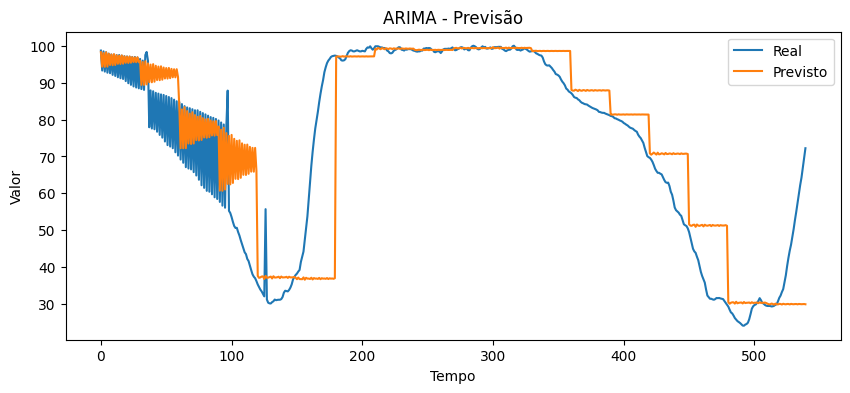

In [ ]:
# Preparar os dados para ARIMA (usar apenas a série temporal)
train_size = int(0.7 * len(df_tucurui))
train, test = df_tucurui['volume_armazenado'][:train_size], df_tucurui['volume_armazenado'][train_size:]

history = [x for x in train]
predictions = []

# Modelo ARIMA para prever 30 dias à frente
for i in range(0, len(test) - n_future + 1, n_future):
    model = ARIMA(history, order=(5, 1, 0))
    model_fit = model.fit()
    output = model_fit.forecast(steps=n_future)
    yhat = output.tolist()
    predictions.extend(yhat)
    history.extend(test.iloc[i:i + n_future])

# Ajustar as previsões para o mesmo tamanho de y_test
predictions = predictions[:len(y_test) * n_future]

# Calcular métricas
y_test_flat = test.values[:len(predictions)]
y_pred_arima = np.array(predictions).reshape(-1, n_future)

mse_arima = mean_squared_error(y_test_flat, y_pred_arima.flatten())
rmse_arima = sqrt(mse_arima)
r2_arima = r2_score(y_test_flat, y_pred_arima.flatten())

print(f'ARIMA - MSE: {mse_arima:.3f}, RMSE: {rmse_arima:.3f}, R²: {r2_arima:.3f}')

# Visualização
plt.figure(figsize=(10, 4))
plt.plot(y_test_flat, label='Real')
plt.plot(y_pred_arima.flatten(), label='Previsto')
plt.title('ARIMA - Previsão')
plt.xlabel('Tempo')
plt.ylabel('Valor')
plt.legend()
plt.show()


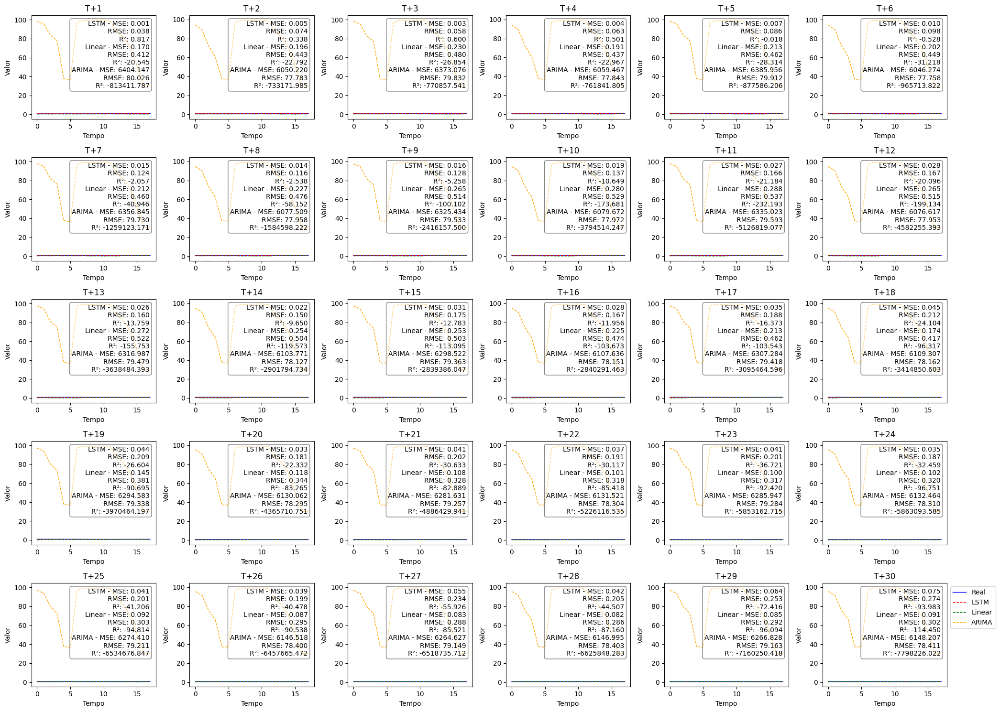

In [ ]:
import matplotlib.pyplot as plt
from math import sqrt
from sklearn.metrics import mean_squared_error, r2_score

# Função para plotar os resultados
def plot_results(y_test, y_pred_lstm, y_pred_linear, y_pred_arima, n_future=30):
    n_rows = 5
    n_cols = 6

    # Ajustar as previsões para o mesmo tamanho de y_test
    min_length = min(len(y_test), len(y_pred_lstm), len(y_pred_linear), len(y_pred_arima))
    y_test = y_test[:min_length]
    y_pred_lstm = y_pred_lstm[:min_length]
    y_pred_linear = y_pred_linear[:min_length]
    y_pred_arima = y_pred_arima[:min_length]

    # Cria uma figura grande para acomodar todos os subplots
    plt.figure(figsize=(20, 15))

    # Itera sobre cada horizonte de tempo e cria um subplot para cada um
    for i in range(n_future):
        ax = plt.subplot(n_rows, n_cols, i + 1)
        plt.plot(y_test[:, i], label='Real', color='blue', linewidth=1)
        plt.plot(y_pred_lstm[:, i], label='LSTM', color='red', linestyle='dashed', linewidth=1)
        plt.plot(y_pred_linear[:, i], label='Linear', color='green', linestyle='dashed', linewidth=1)
        if i < y_pred_arima.shape[1]:  # Garantir que não indexamos além dos limites
            plt.plot(y_pred_arima[:, i], label='ARIMA', color='orange', linestyle='dashed', linewidth=1)

        plt.title(f'T+{i+1}')

        # Calcula as métricas para cada horizonte de tempo
        mse_lstm = mean_squared_error(y_test[:, i], y_pred_lstm[:, i])
        rmse_lstm = sqrt(mse_lstm)
        r2_lstm = r2_score(y_test[:, i], y_pred_lstm[:, i])

        mse_linear = mean_squared_error(y_test[:, i], y_pred_linear[:, i])
        rmse_linear = sqrt(mse_linear)
        r2_linear = r2_score(y_test[:, i], y_pred_linear[:, i])

        mse_arima = mean_squared_error(y_test[:, i], y_pred_arima[:, i]) if i < y_pred_arima.shape[1] else float('nan')
        rmse_arima = sqrt(mse_arima) if i < y_pred_arima.shape[1] else float('nan')
        r2_arima = r2_score(y_test[:, i], y_pred_arima[:, i]) if i < y_pred_arima.shape[1] else float('nan')

        # Adiciona as métricas como texto no gráfico
        ax.text(0.95, 0.95, f'LSTM - MSE: {mse_lstm:.3f}\nRMSE: {rmse_lstm:.3f}\nR²: {r2_lstm:.3f}\n'
                            f'Linear - MSE: {mse_linear:.3f}\nRMSE: {rmse_linear:.3f}\nR²: {r2_linear:.3f}\n'
                            f'ARIMA - MSE: {mse_arima:.3f}\nRMSE: {rmse_arima:.3f}\nR²: {r2_arima:.3f}',
                transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

        plt.xlabel('Tempo')
        plt.ylabel('Valor')
        plt.tight_layout()

    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
    plt.show()

# Resultados combinados
plot_results(y_test, y_pred_lstm, y_pred_linear, y_pred_arima, n_future=30)


Regressão Linear - Horizonte 1: MSE = 0.027, RMSE = 0.163, R² = 0.663


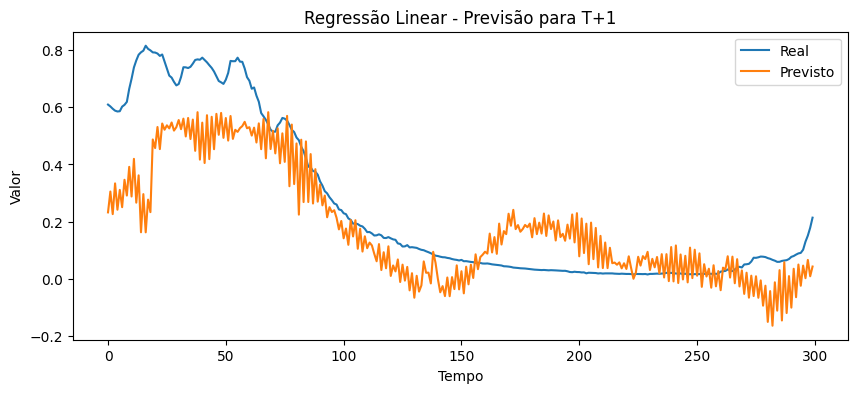

Regressão Linear - Horizonte 2: MSE = 0.029, RMSE = 0.169, R² = 0.638


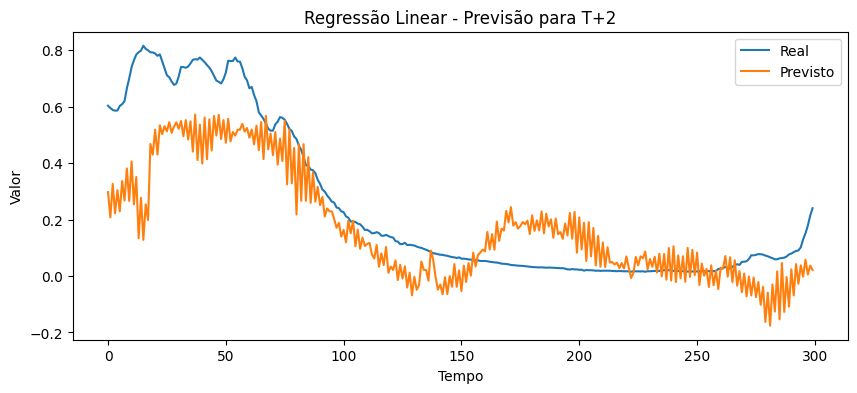

Regressão Linear - Horizonte 3: MSE = 0.034, RMSE = 0.184, R² = 0.566


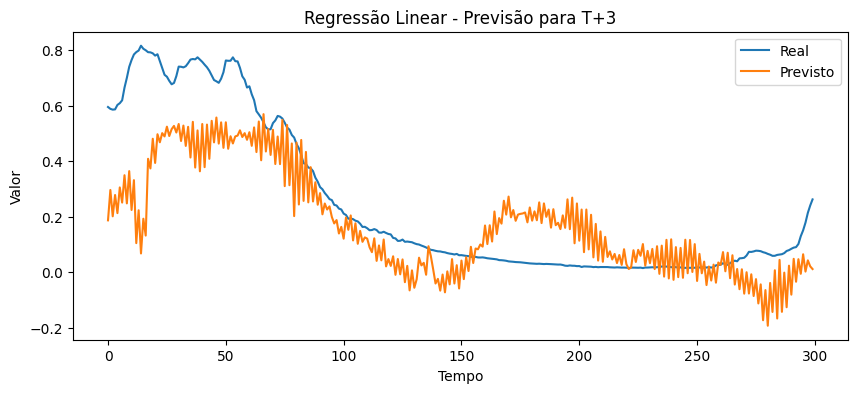

Regressão Linear - Horizonte 4: MSE = 0.029, RMSE = 0.170, R² = 0.628


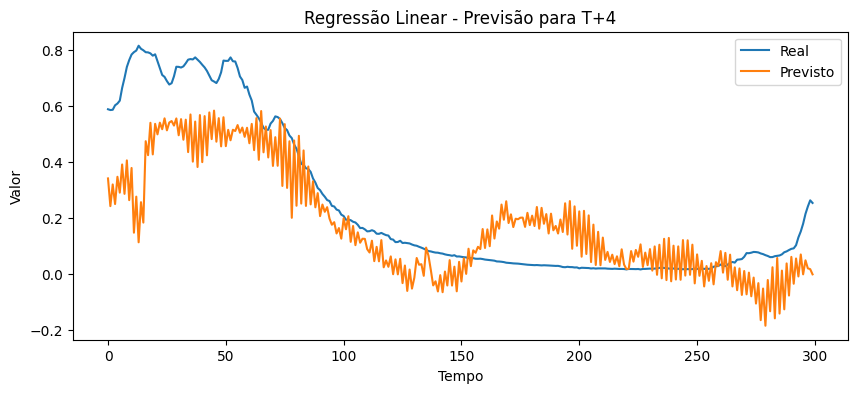

Regressão Linear - Horizonte 5: MSE = 0.035, RMSE = 0.187, R² = 0.550


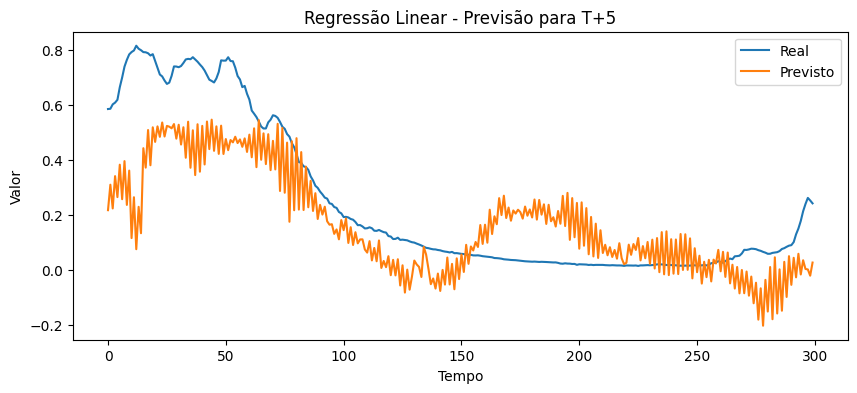

Regressão Linear - Horizonte 6: MSE = 0.034, RMSE = 0.184, R² = 0.559


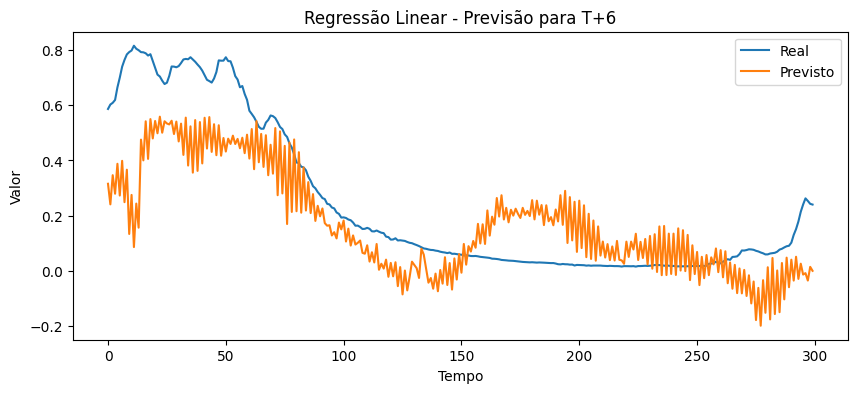

Regressão Linear - Horizonte 7: MSE = 0.033, RMSE = 0.181, R² = 0.574


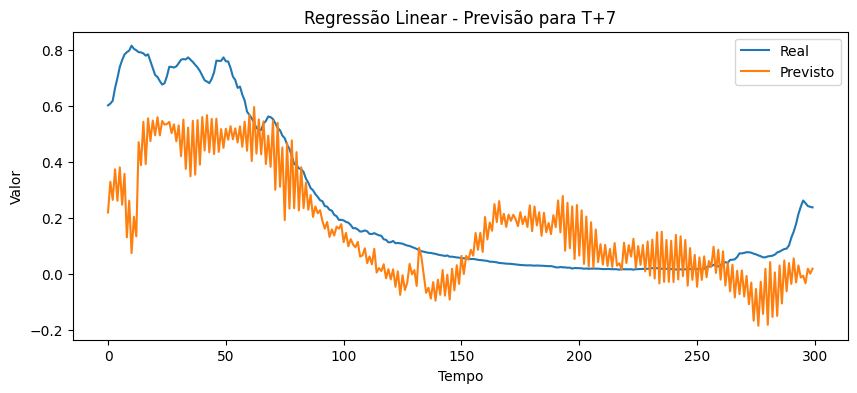

Regressão Linear - Horizonte 8: MSE = 0.032, RMSE = 0.179, R² = 0.578


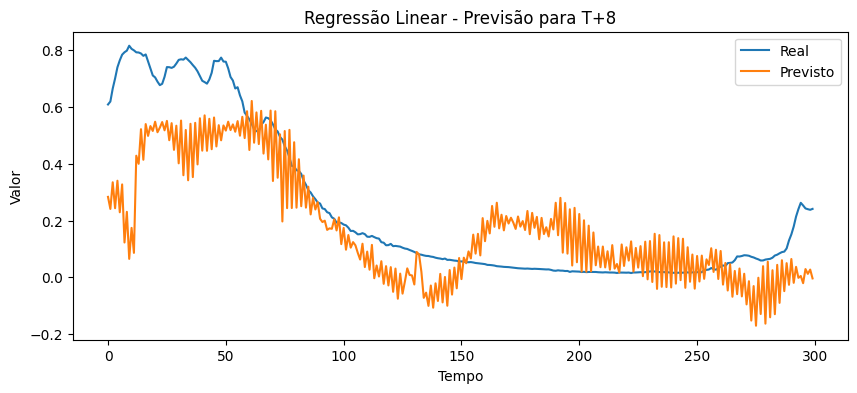

Regressão Linear - Horizonte 9: MSE = 0.035, RMSE = 0.186, R² = 0.541


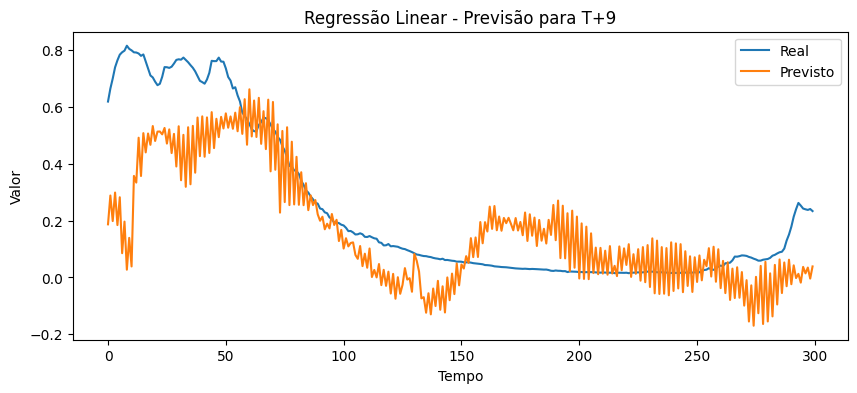

Regressão Linear - Horizonte 10: MSE = 0.042, RMSE = 0.206, R² = 0.437


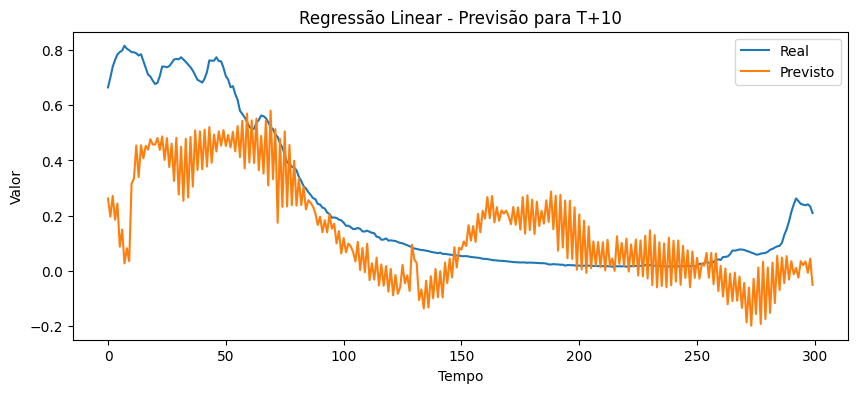

Regressão Linear - Horizonte 11: MSE = 0.042, RMSE = 0.205, R² = 0.439


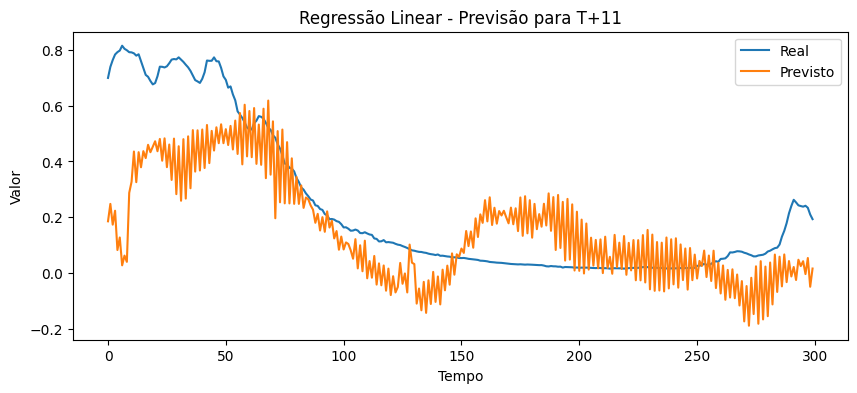

Regressão Linear - Horizonte 12: MSE = 0.039, RMSE = 0.198, R² = 0.469


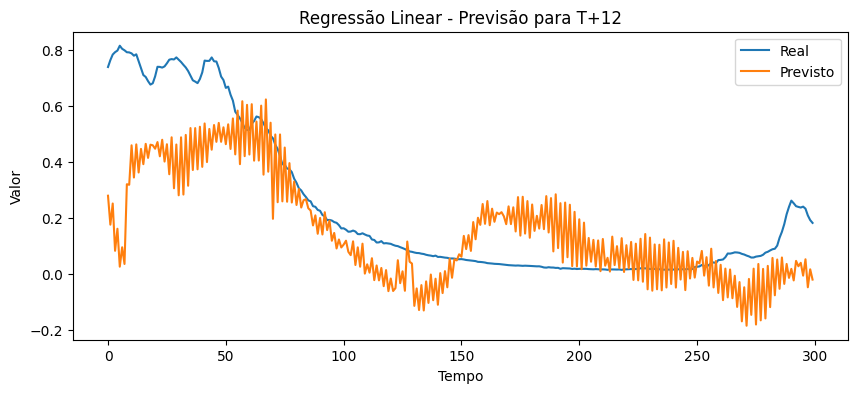

Regressão Linear - Horizonte 13: MSE = 0.038, RMSE = 0.195, R² = 0.482


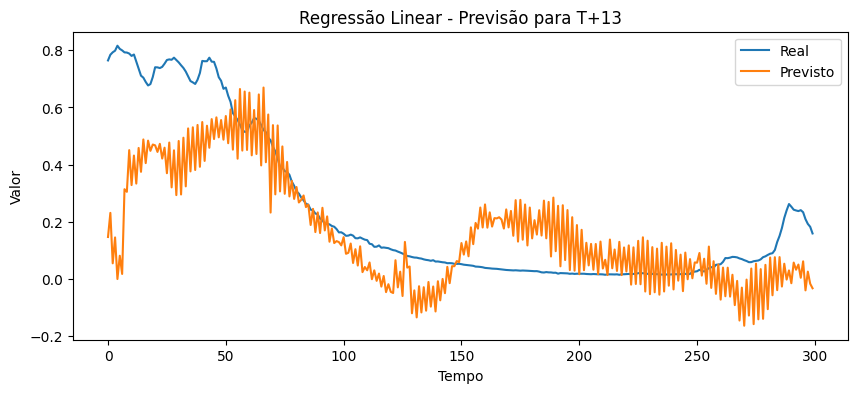

Regressão Linear - Horizonte 14: MSE = 0.038, RMSE = 0.195, R² = 0.476


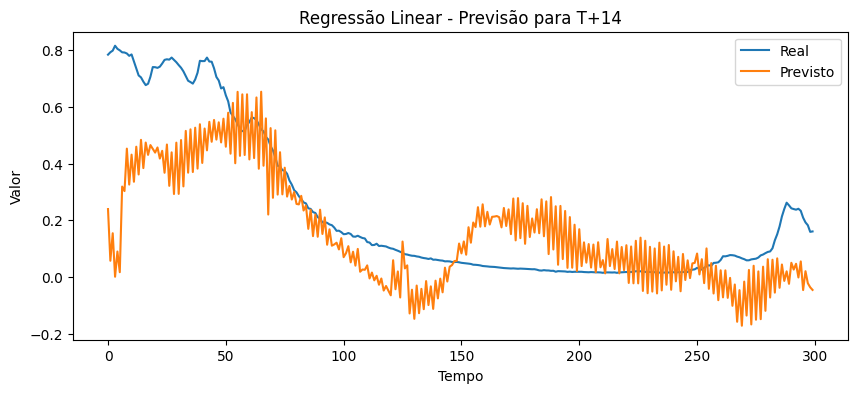

Regressão Linear - Horizonte 15: MSE = 0.038, RMSE = 0.196, R² = 0.460


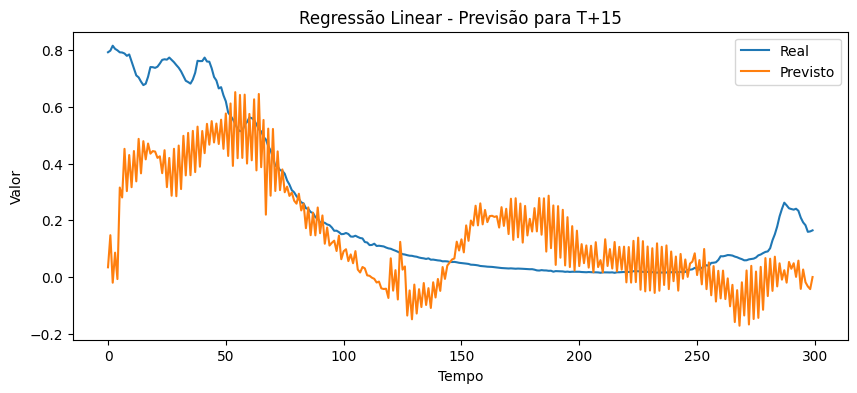

Regressão Linear - Horizonte 16: MSE = 0.036, RMSE = 0.189, R² = 0.489


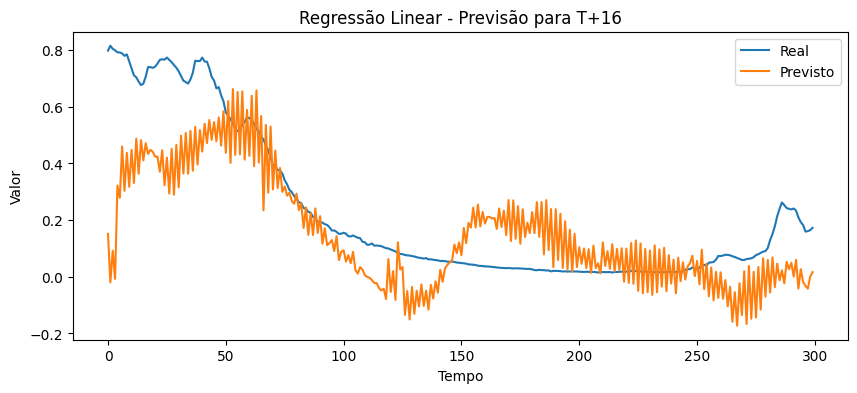

Regressão Linear - Horizonte 17: MSE = 0.034, RMSE = 0.185, R² = 0.506


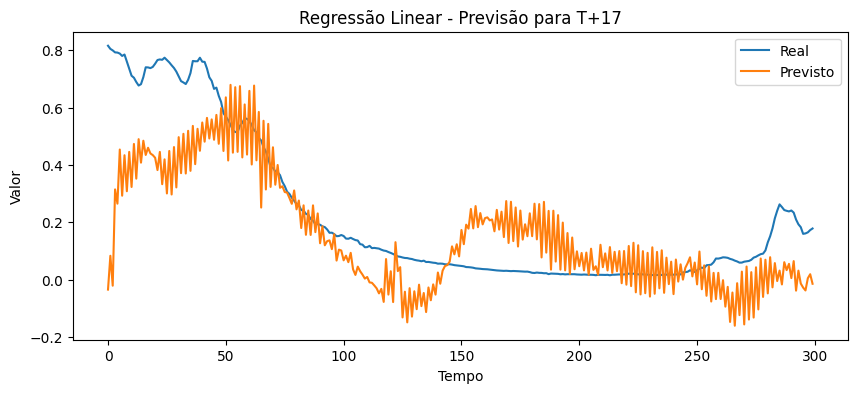

Regressão Linear - Horizonte 18: MSE = 0.032, RMSE = 0.179, R² = 0.526


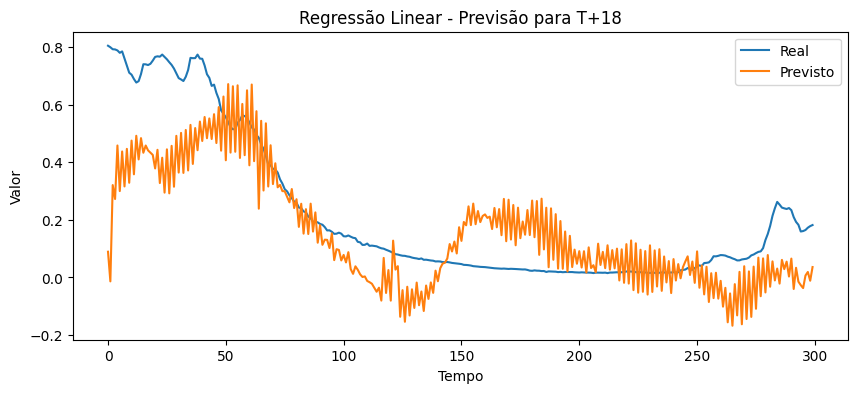

Regressão Linear - Horizonte 19: MSE = 0.028, RMSE = 0.168, R² = 0.579


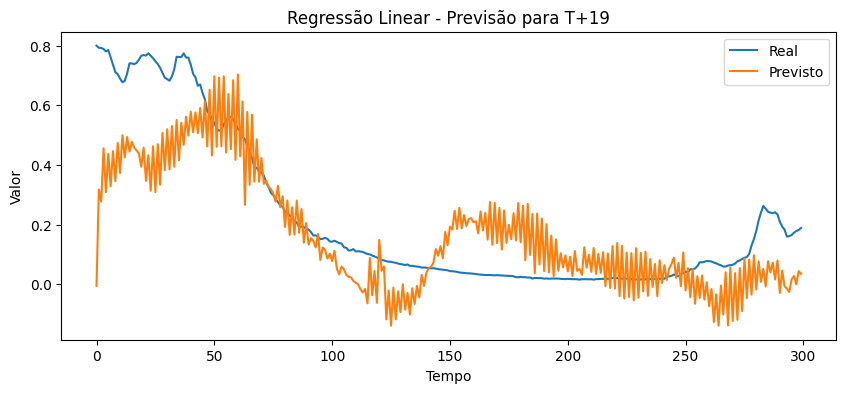

Regressão Linear - Horizonte 20: MSE = 0.027, RMSE = 0.163, R² = 0.595


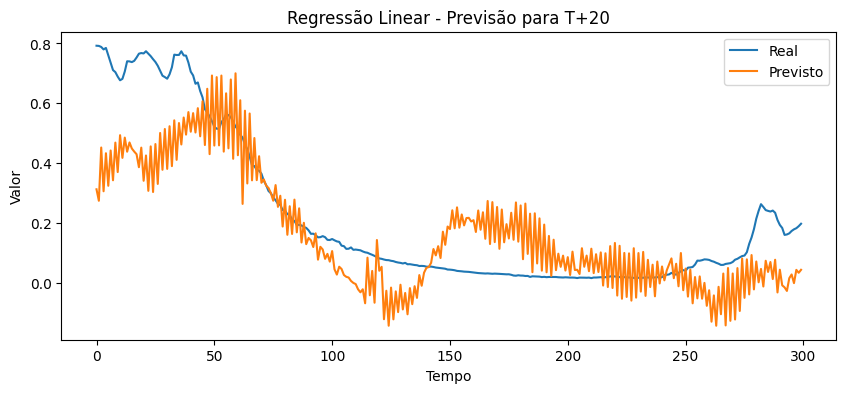

Regressão Linear - Horizonte 21: MSE = 0.024, RMSE = 0.156, R² = 0.625


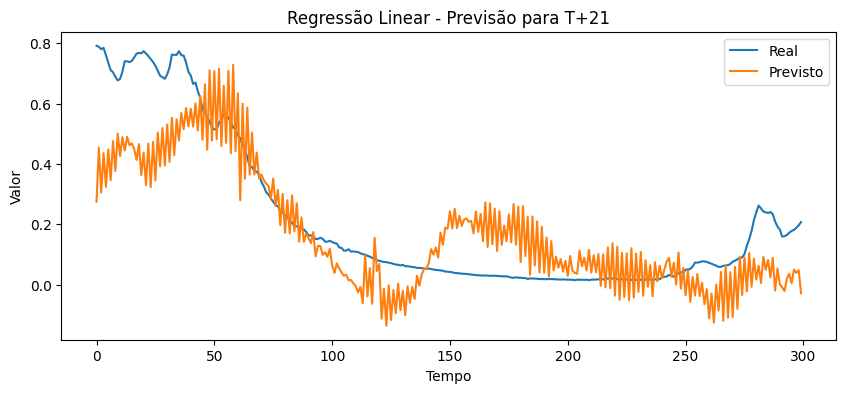

Regressão Linear - Horizonte 22: MSE = 0.024, RMSE = 0.156, R² = 0.618


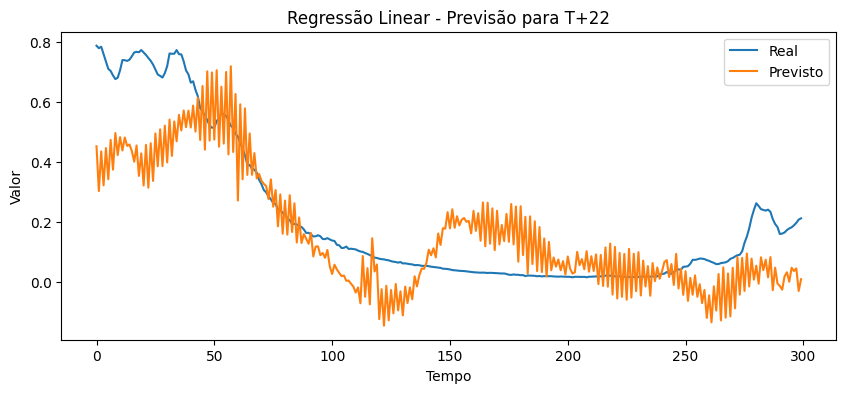

Regressão Linear - Horizonte 23: MSE = 0.023, RMSE = 0.152, R² = 0.630


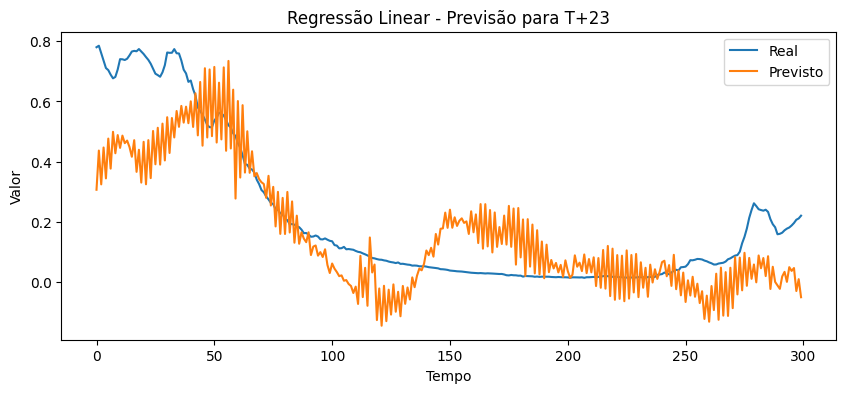

Regressão Linear - Horizonte 24: MSE = 0.023, RMSE = 0.151, R² = 0.628


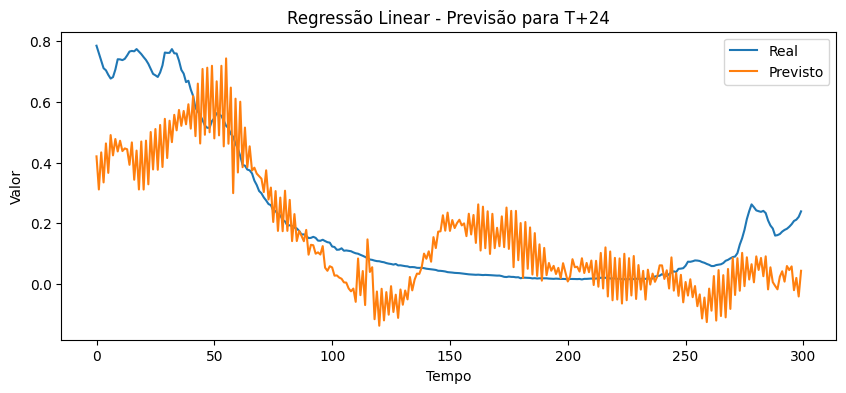

Regressão Linear - Horizonte 25: MSE = 0.021, RMSE = 0.145, R² = 0.652


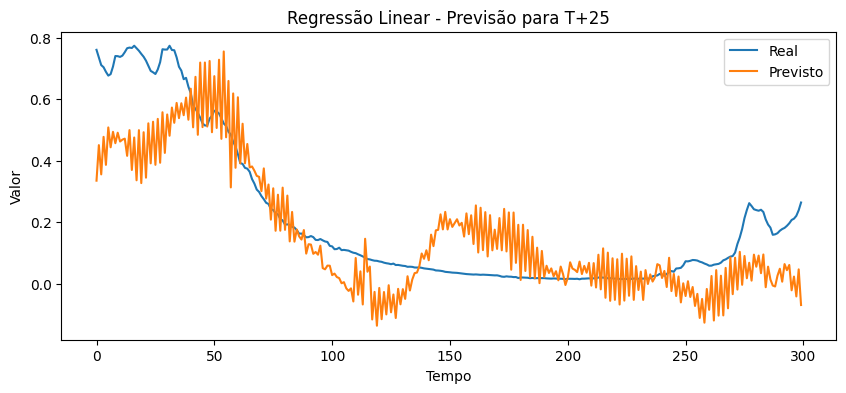

Regressão Linear - Horizonte 26: MSE = 0.020, RMSE = 0.141, R² = 0.661


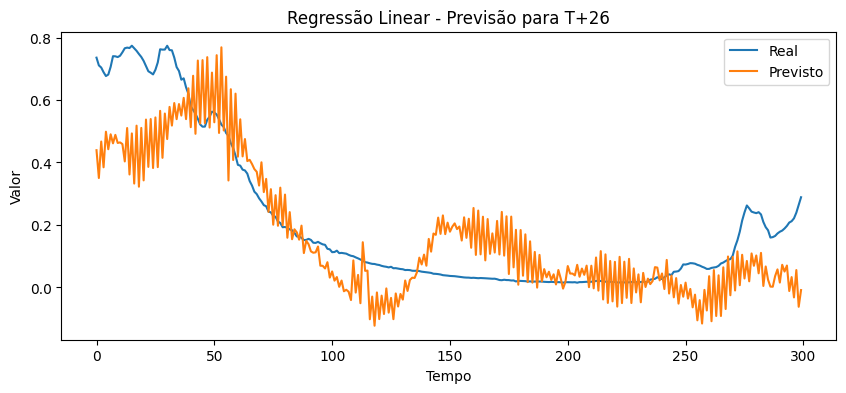

Regressão Linear - Horizonte 27: MSE = 0.019, RMSE = 0.137, R² = 0.676


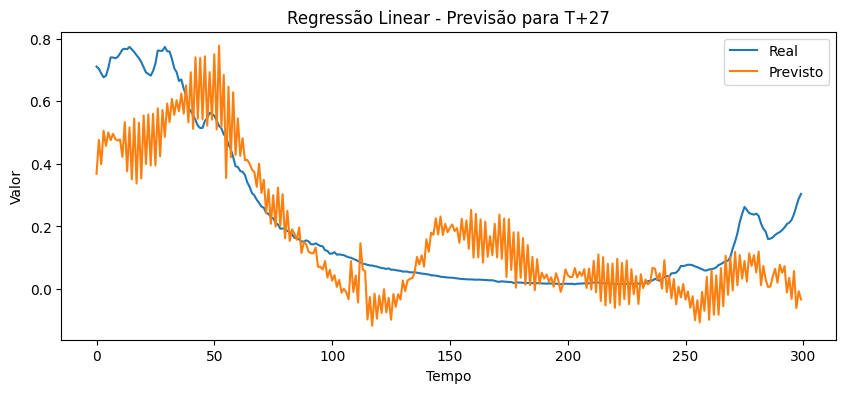

Regressão Linear - Horizonte 28: MSE = 0.019, RMSE = 0.137, R² = 0.673


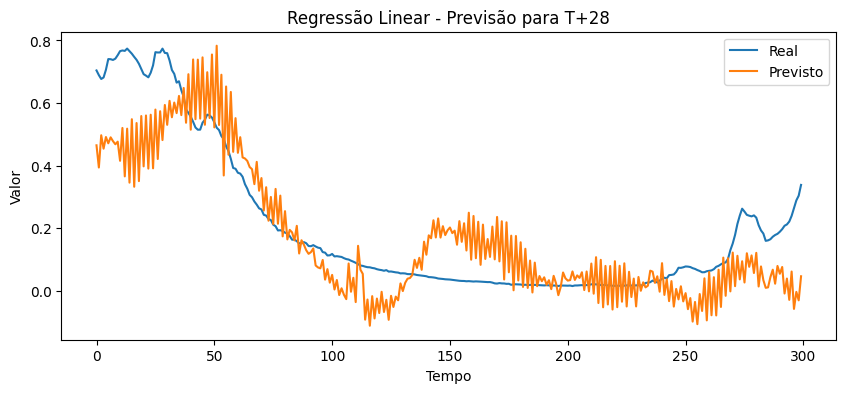

Regressão Linear - Horizonte 29: MSE = 0.019, RMSE = 0.136, R² = 0.672


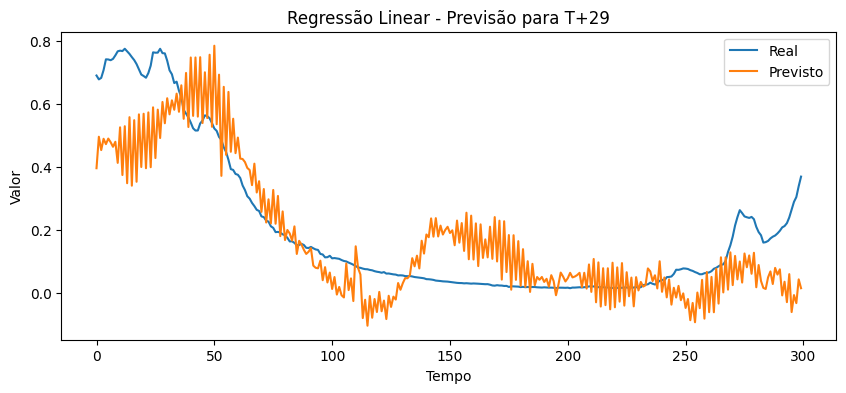

Regressão Linear - Horizonte 30: MSE = 0.019, RMSE = 0.138, R² = 0.660


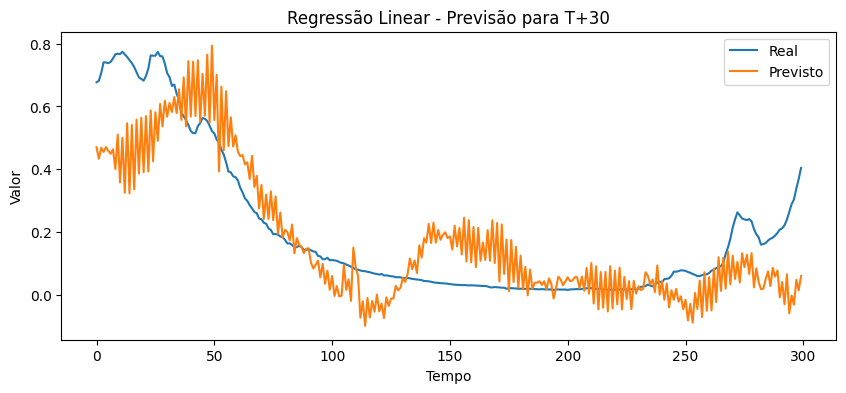

In [ ]:
# Preparar os dados para regressão linear (não precisam ser 3D)
X_train_flat = X_train.reshape(X_train.shape[0], -1)
X_val_flat = X_val.reshape(X_val.shape[0], -1)
X_test_flat = X_test.reshape(X_test.shape[0], -1)

# Modelo de Regressão Linear
linear_model = LinearRegression()

# Treinar o modelo
linear_model.fit(X_train_flat, y_train)

# Previsões
y_pred_linear = linear_model.predict(X_test_flat)

# Ajustar para os 300 dias de previsão
y_test_300 = y_test[:300]
y_pred_linear_300 = y_pred_linear[:300]

# Avaliação e Visualização
for i in range(n_future):
    y_true = y_test_300[:, i]
    y_pred_i = y_pred_linear_300[:, i]

    mse = mean_squared_error(y_true, y_pred_i)
    rmse = sqrt(mse)
    r2 = r2_score(y_true, y_pred_i)

    print(f'Regressão Linear - Horizonte {i+1}: MSE = {mse:.3f}, RMSE = {rmse:.3f}, R² = {r2:.3f}')

    plt.figure(figsize=(10, 4))
    plt.plot(y_true, label='Real')
    plt.plot(y_pred_i, label='Previsto')
    plt.title(f'Regressão Linear - Previsão para T+{i+1}')
    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()


ARIMA - MSE: 186.556, RMSE: 13.659, R²: 0.721


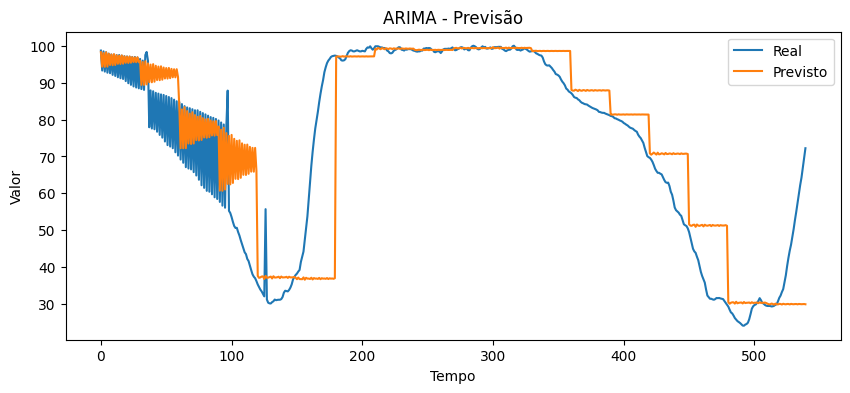

In [ ]:
# Preparar os dados para ARIMA (usar apenas a série temporal)
train_size = int(0.7 * len(df_tucurui))
train, test = df_tucurui['volume_armazenado'][:train_size], df_tucurui['volume_armazenado'][train_size:]

history = [x for x in train]
predictions = []

# Modelo ARIMA para prever 30 dias à frente
for i in range(0, len(test) - n_future + 1, n_future):
    model = ARIMA(history, order=(5, 1, 0))
    model_fit = model.fit()
    output = model_fit.forecast(steps=n_future)
    yhat = output.tolist()
    predictions.extend(yhat)
    history.extend(test.iloc[i:i + n_future])

# Ajustar as previsões para os 300 dias
# predictions = predictions[:300]

# Calcular métricas
y_test_flat = test.values[:len(predictions)]
y_pred_arima = np.array(predictions).reshape(-1, 1)

mse_arima = mean_squared_error(y_test_flat, y_pred_arima.flatten())
rmse_arima = sqrt(mse_arima)
r2_arima = r2_score(y_test_flat, y_pred_arima.flatten())

print(f'ARIMA - MSE: {mse_arima:.3f}, RMSE: {rmse_arima:.3f}, R²: {r2_arima:.3f}')

# Visualização
plt.figure(figsize=(10, 4))
plt.plot(y_test_flat, label='Real')
plt.plot(y_pred_arima.flatten(), label='Previsto')
plt.title('ARIMA - Previsão')
plt.xlabel('Tempo')
plt.ylabel('Valor')
plt.legend()
plt.show()


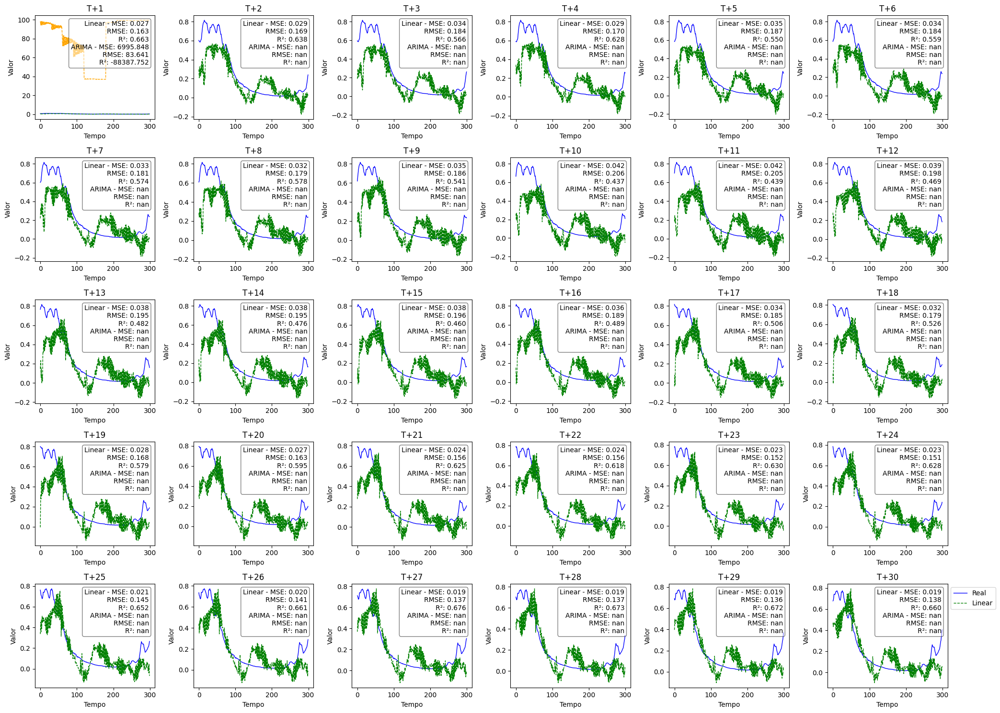

In [ ]:
import matplotlib.pyplot as plt
from math import sqrt
from sklearn.metrics import mean_squared_error, r2_score

# Função para plotar os resultados
def plot_results(y_test, y_pred_linear, y_pred_arima, n_future=30):
    n_rows = 5
    n_cols = 6

    # Ajustar as previsões para o mesmo tamanho de y_test
    min_length = min(len(y_test), len(y_pred_linear), len(y_pred_arima))
    y_test = y_test[:min_length]
    y_pred_linear = y_pred_linear[:min_length]
    y_pred_arima = y_pred_arima[:min_length]

    # Cria uma figura grande para acomodar todos os subplots
    plt.figure(figsize=(20, 15))

    # Itera sobre cada horizonte de tempo e cria um subplot para cada um
    for i in range(n_future):
        ax = plt.subplot(n_rows, n_cols, i + 1)
        plt.plot(y_test[:, i], label='Real', color='blue', linewidth=1)
        plt.plot(y_pred_linear[:, i], label='Linear', color='green', linestyle='dashed', linewidth=1)
        if i < y_pred_arima.shape[1]:  # Garantir que não indexamos além dos limites
            plt.plot(y_pred_arima[:, i], label='ARIMA', color='orange', linestyle='dashed', linewidth=1)

        plt.title(f'T+{i+1}')

        # Calcula as métricas para cada horizonte de tempo
        mse_linear = mean_squared_error(y_test[:, i], y_pred_linear[:, i])
        rmse_linear = sqrt(mse_linear)
        r2_linear = r2_score(y_test[:, i], y_pred_linear[:, i])

        mse_arima = mean_squared_error(y_test[:, i], y_pred_arima[:, i]) if i < y_pred_arima.shape[1] else float('nan')
        rmse_arima = sqrt(mse_arima) if i < y_pred_arima.shape[1] else float('nan')
        r2_arima = r2_score(y_test[:, i], y_pred_arima[:, i]) if i < y_pred_arima.shape[1] else float('nan')

        # Adiciona as métricas como texto no gráfico
        ax.text(0.95, 0.95, f'Linear - MSE: {mse_linear:.3f}\nRMSE: {rmse_linear:.3f}\nR²: {r2_linear:.3f}\n'
                            f'ARIMA - MSE: {mse_arima:.3f}\nRMSE: {rmse_arima:.3f}\nR²: {r2_arima:.3f}',
                transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

        plt.xlabel('Tempo')
        plt.ylabel('Valor')
        plt.tight_layout()

    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
    plt.show()

# Resultados combinados para 300 dias
plot_results(y_test_300, y_pred_linear_300, y_pred_arima[:300], n_future=30)


# 6

Regressão Linear - Horizonte 1: MSE = 0.029, RMSE = 0.171, R² = 0.594


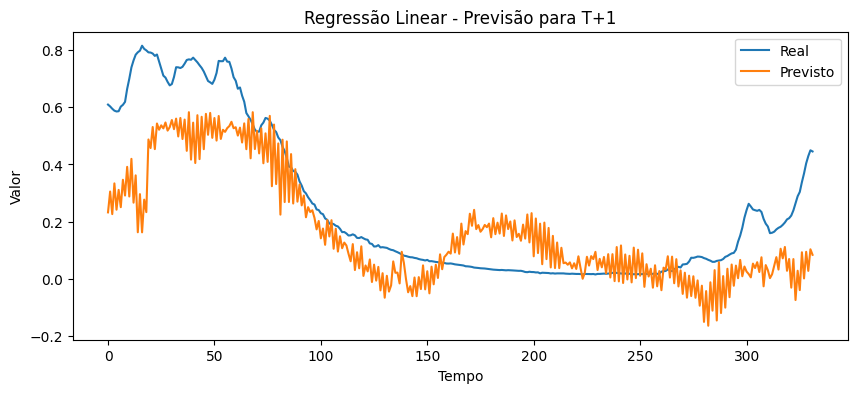

Regressão Linear - Horizonte 2: MSE = 0.031, RMSE = 0.177, R² = 0.566


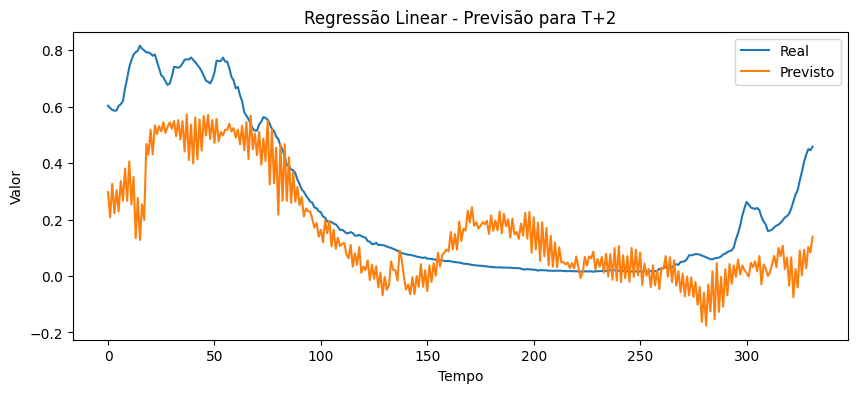

Regressão Linear - Horizonte 3: MSE = 0.037, RMSE = 0.192, R² = 0.487


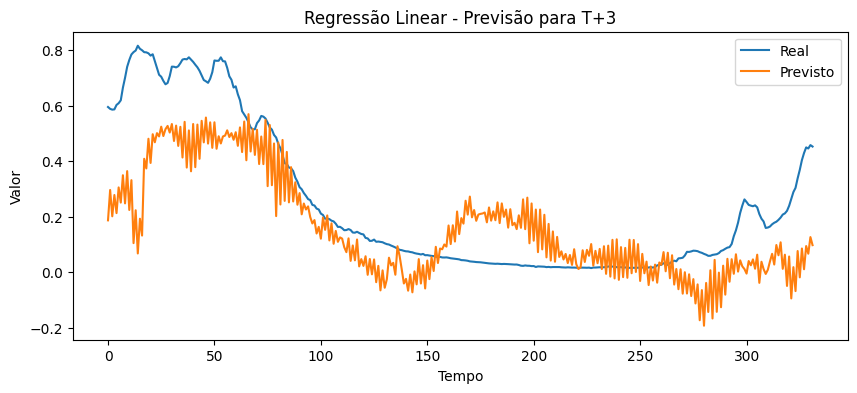

Regressão Linear - Horizonte 4: MSE = 0.032, RMSE = 0.179, R² = 0.554


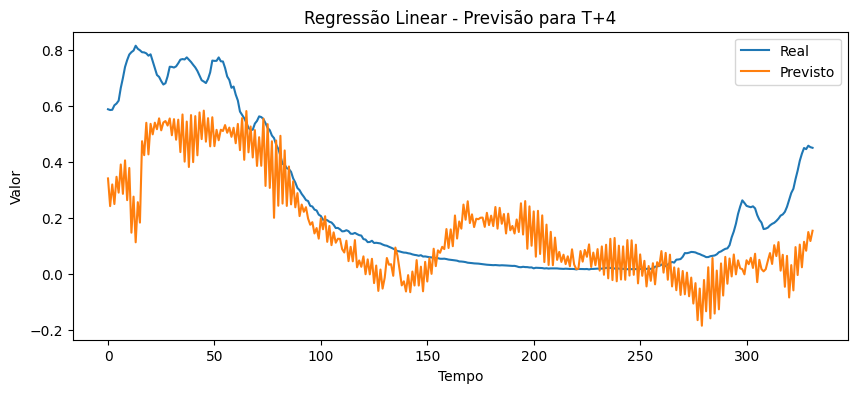

Regressão Linear - Horizonte 5: MSE = 0.039, RMSE = 0.197, R² = 0.457


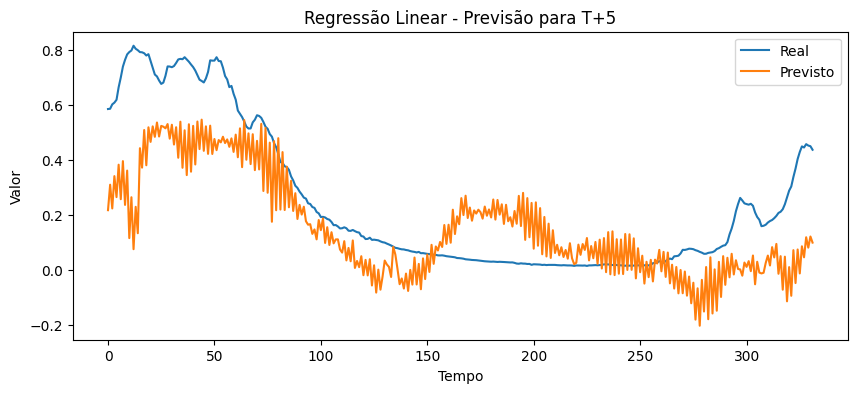

Regressão Linear - Horizonte 6: MSE = 0.038, RMSE = 0.195, R² = 0.463


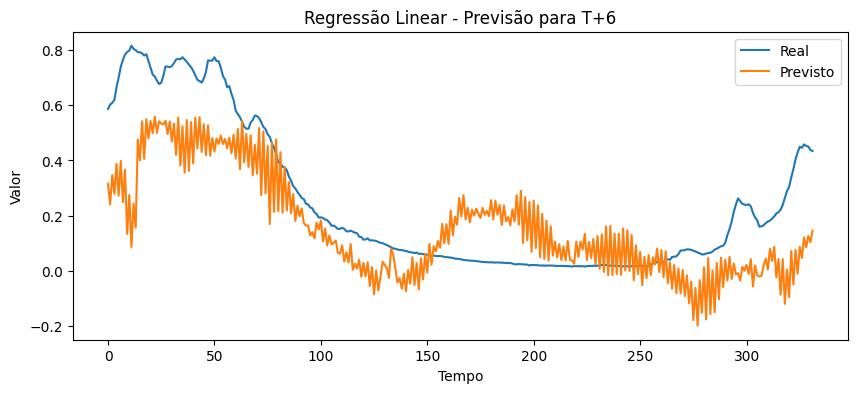

Regressão Linear - Horizonte 7: MSE = 0.037, RMSE = 0.193, R² = 0.474


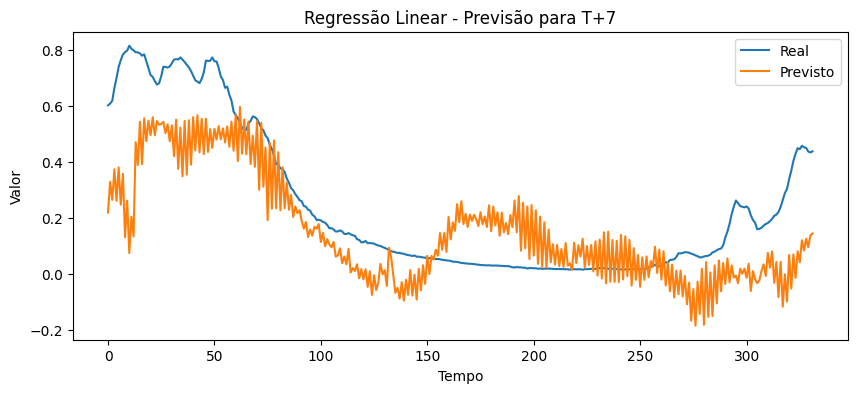

Regressão Linear - Horizonte 8: MSE = 0.037, RMSE = 0.192, R² = 0.477


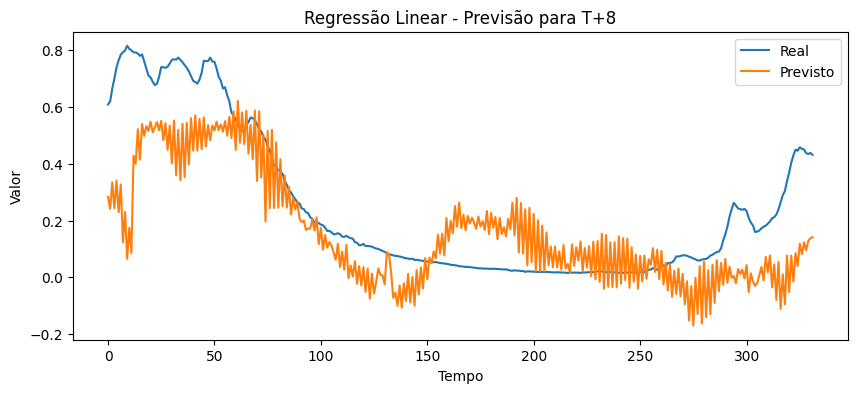

Regressão Linear - Horizonte 9: MSE = 0.040, RMSE = 0.199, R² = 0.435


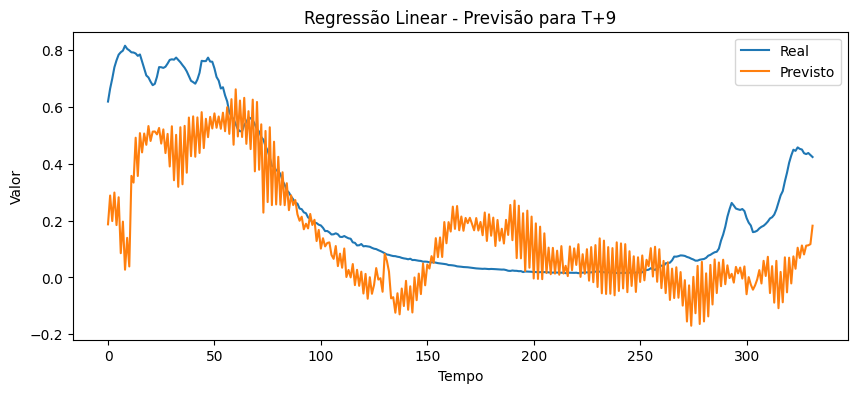

Regressão Linear - Horizonte 10: MSE = 0.047, RMSE = 0.216, R² = 0.331


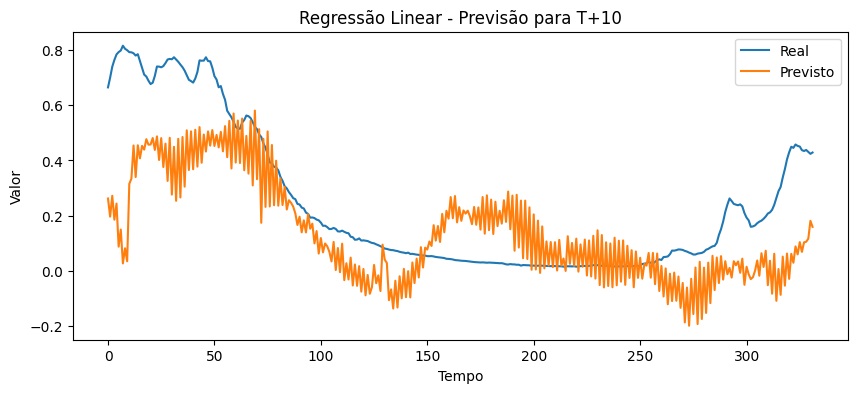

Regressão Linear - Horizonte 11: MSE = 0.047, RMSE = 0.216, R² = 0.328


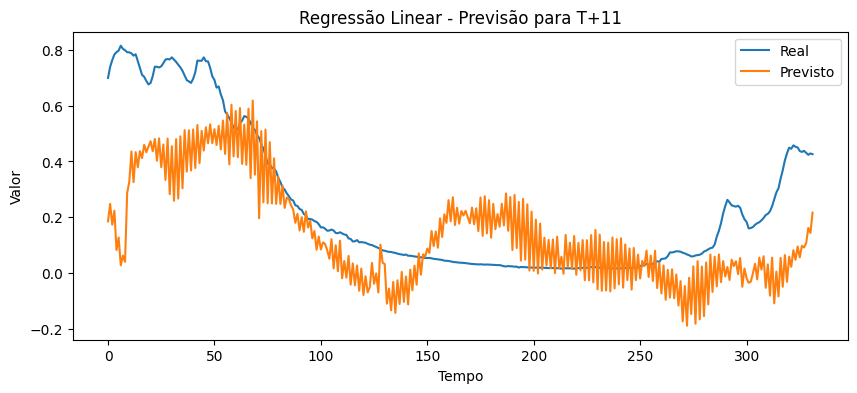

Regressão Linear - Horizonte 12: MSE = 0.044, RMSE = 0.210, R² = 0.358


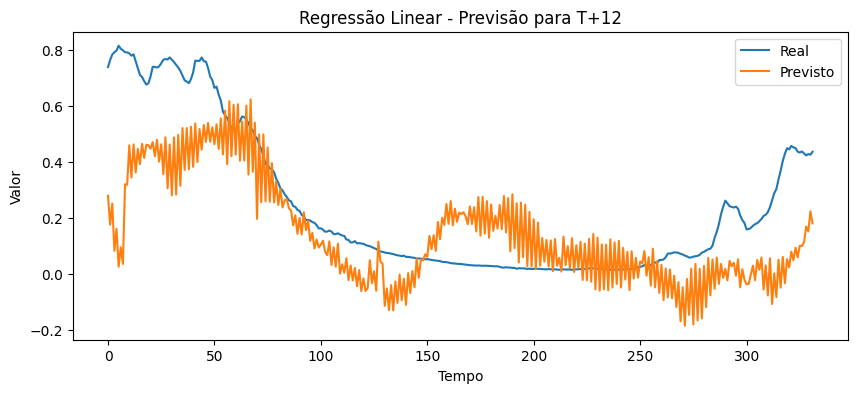

Regressão Linear - Horizonte 13: MSE = 0.043, RMSE = 0.207, R² = 0.369


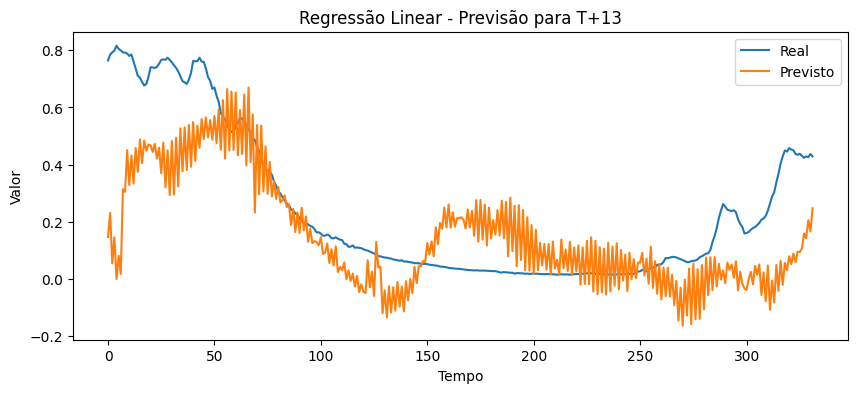

Regressão Linear - Horizonte 14: MSE = 0.043, RMSE = 0.208, R² = 0.360


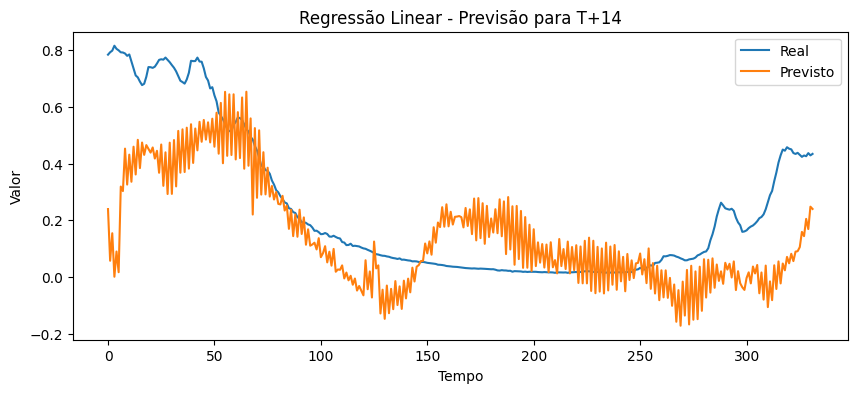

Regressão Linear - Horizonte 15: MSE = 0.044, RMSE = 0.209, R² = 0.344


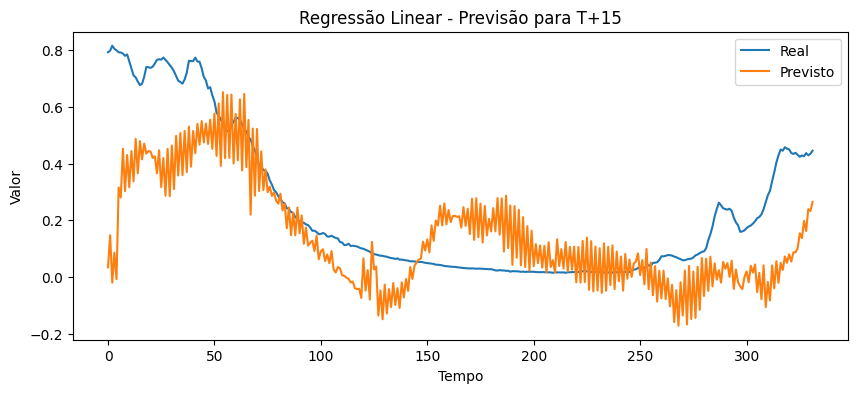

Regressão Linear - Horizonte 16: MSE = 0.042, RMSE = 0.204, R² = 0.371


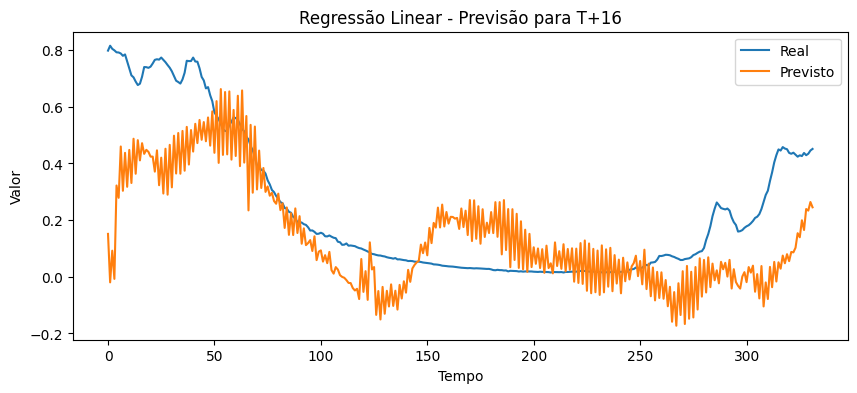

Regressão Linear - Horizonte 17: MSE = 0.040, RMSE = 0.199, R² = 0.389


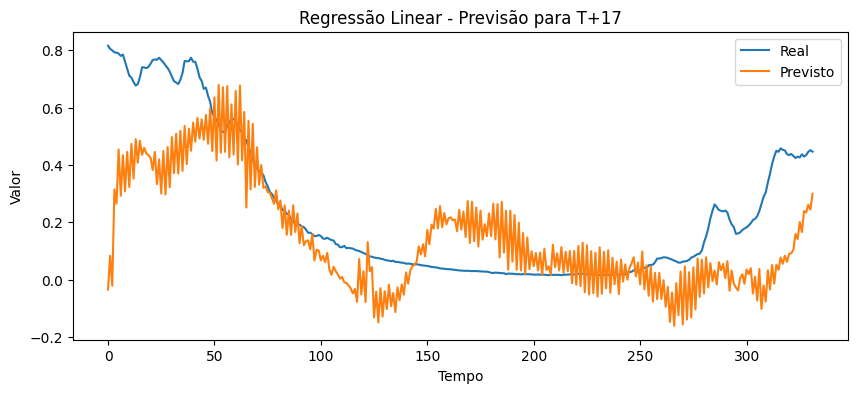

Regressão Linear - Horizonte 18: MSE = 0.038, RMSE = 0.195, R² = 0.408


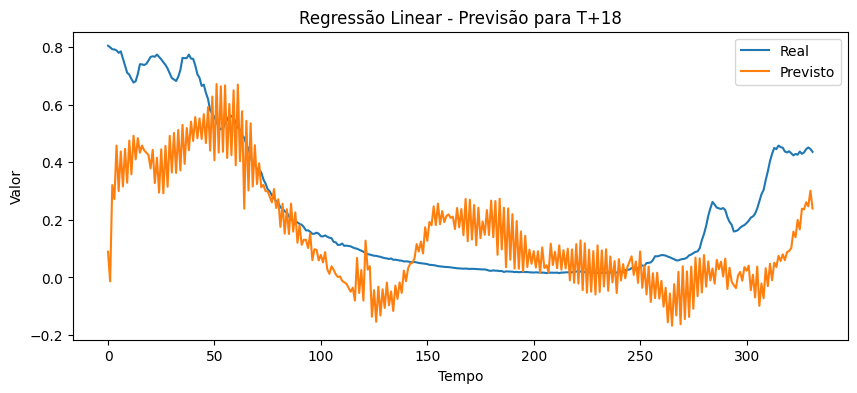

Regressão Linear - Horizonte 19: MSE = 0.034, RMSE = 0.184, R² = 0.465


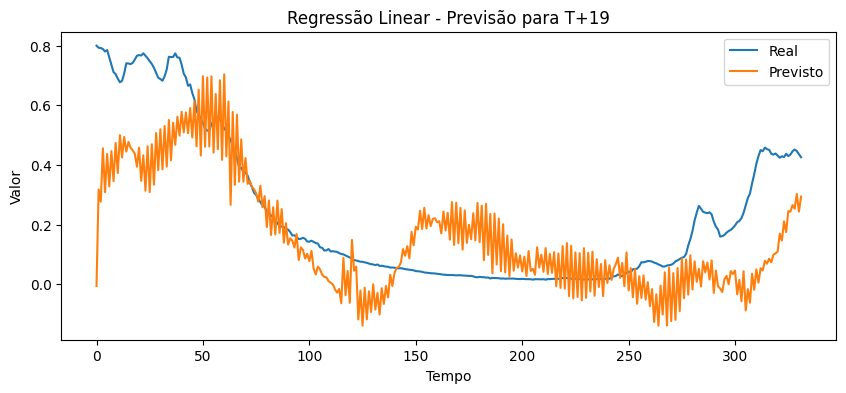

Regressão Linear - Horizonte 20: MSE = 0.033, RMSE = 0.181, R² = 0.479


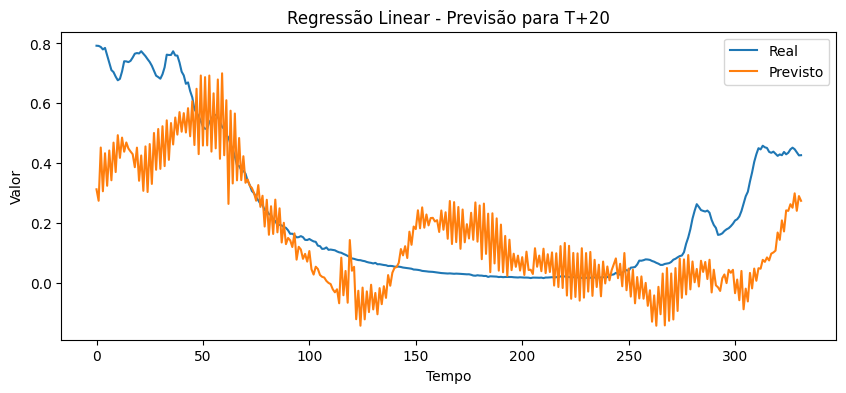

Regressão Linear - Horizonte 21: MSE = 0.030, RMSE = 0.173, R² = 0.514


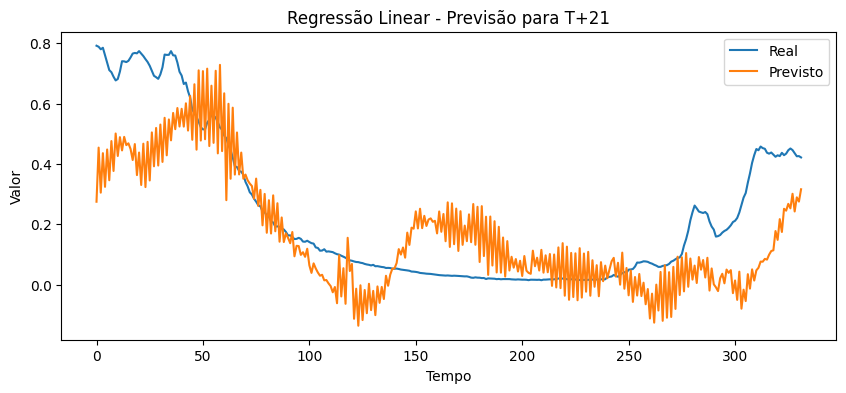

Regressão Linear - Horizonte 22: MSE = 0.030, RMSE = 0.174, R² = 0.504


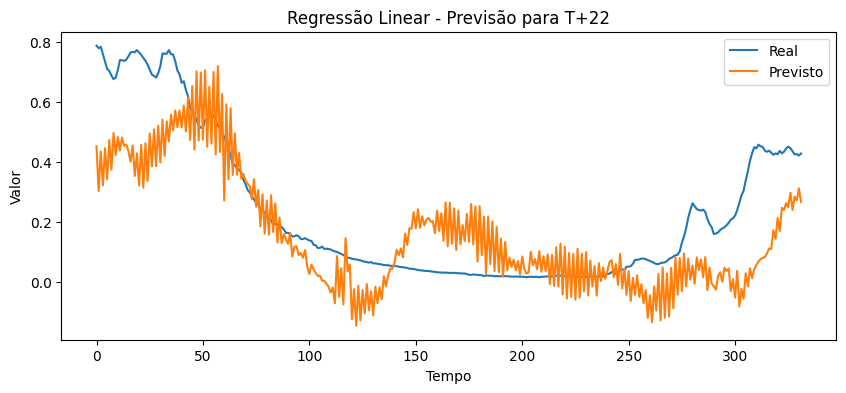

Regressão Linear - Horizonte 23: MSE = 0.029, RMSE = 0.170, R² = 0.521


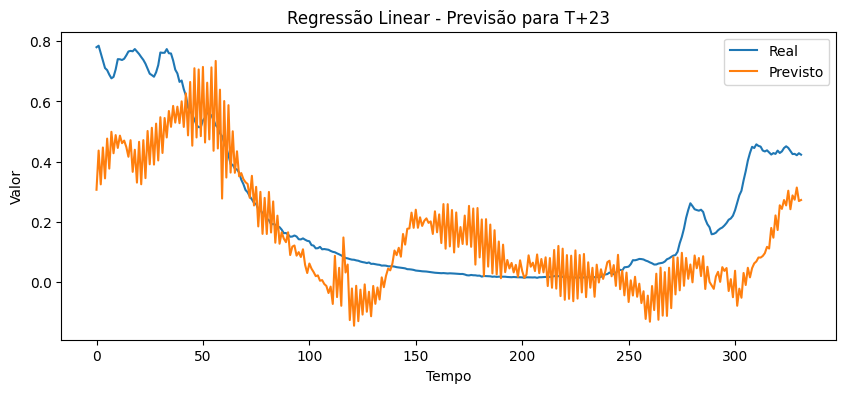

Regressão Linear - Horizonte 24: MSE = 0.028, RMSE = 0.169, R² = 0.520


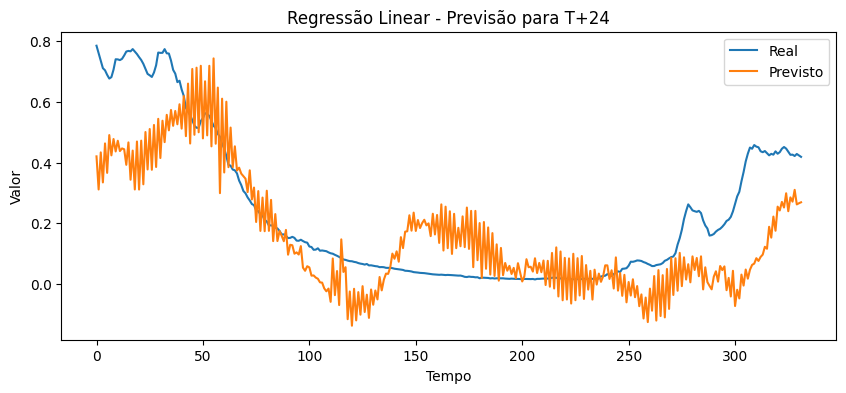

Regressão Linear - Horizonte 25: MSE = 0.026, RMSE = 0.162, R² = 0.553


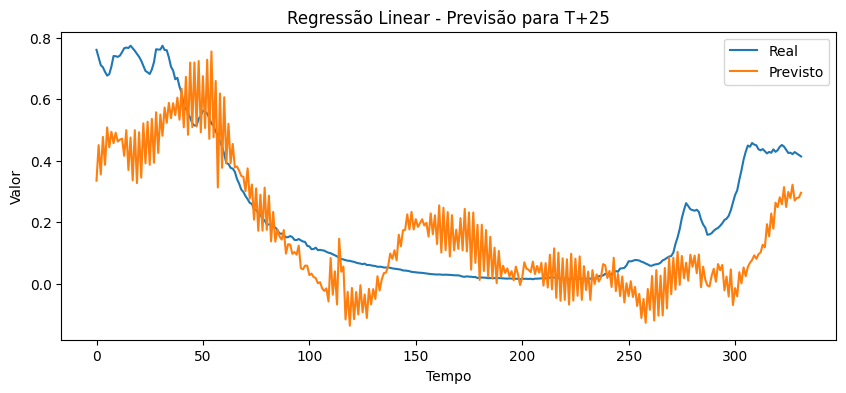

Regressão Linear - Horizonte 26: MSE = 0.025, RMSE = 0.158, R² = 0.566


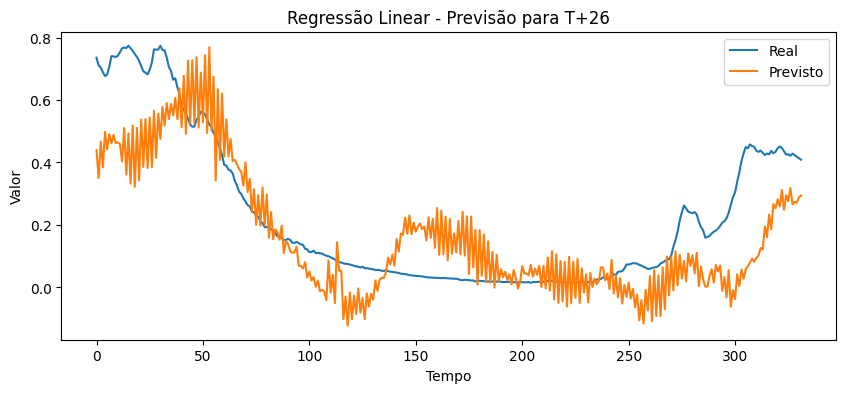

Regressão Linear - Horizonte 27: MSE = 0.023, RMSE = 0.153, R² = 0.588


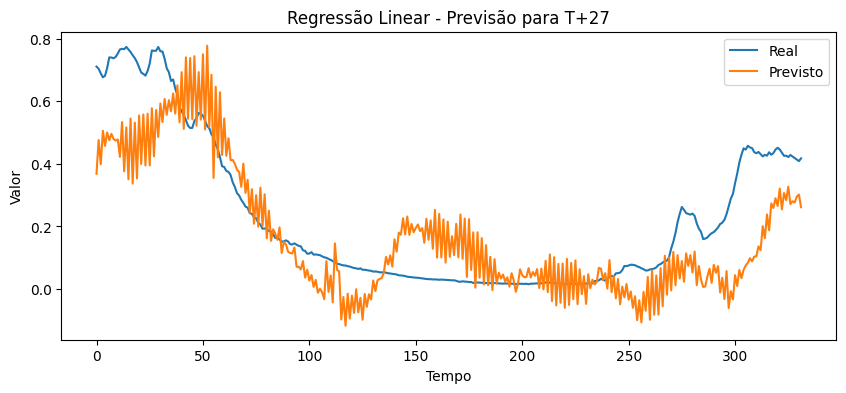

Regressão Linear - Horizonte 28: MSE = 0.023, RMSE = 0.152, R² = 0.591


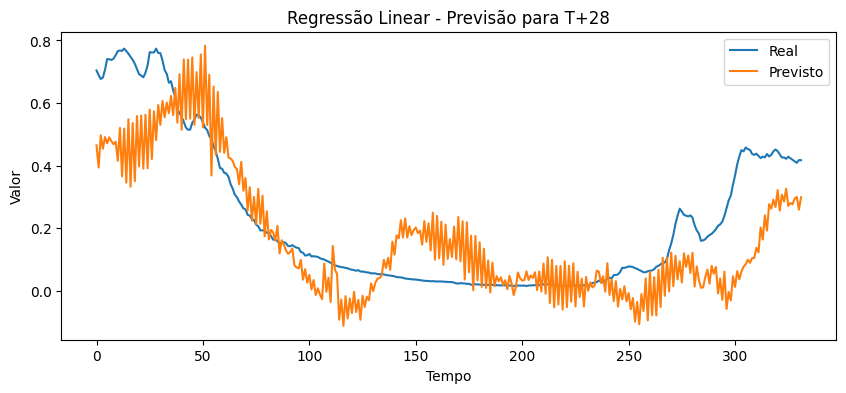

Regressão Linear - Horizonte 29: MSE = 0.023, RMSE = 0.150, R² = 0.596


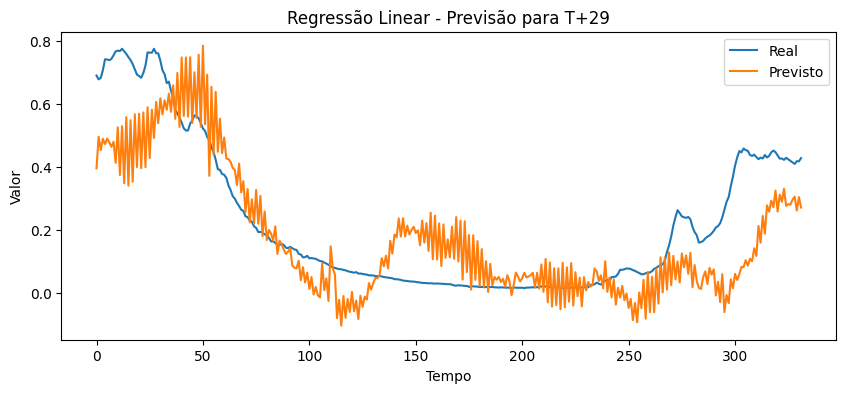

Regressão Linear - Horizonte 30: MSE = 0.023, RMSE = 0.151, R² = 0.588


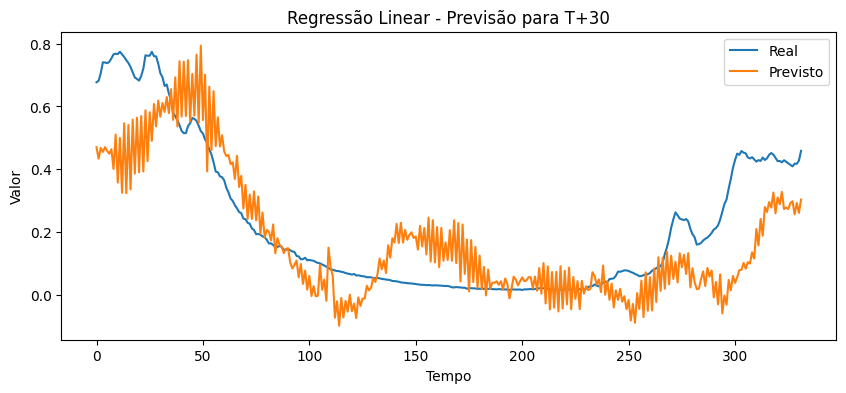

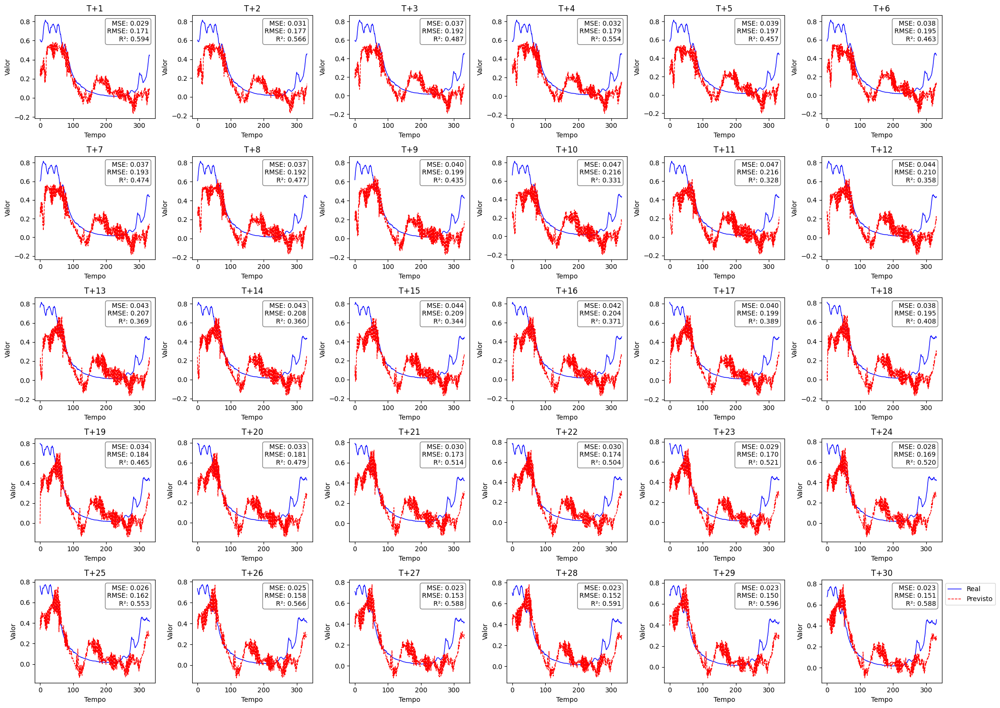

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt
import matplotlib.pyplot as plt

# Função para criar dados com janelas de tempo
def create_data(df, max_future, n_past, train_test_split_percentage, validation_split_percentage):
    n_feature = df.shape[1]
    x_data, y_data = [], []

    for i in range(n_past, len(df) - max_future + 1):
        x_data.append(df[i - n_past:i, 0:n_feature])
        y_data.append([df[j, 0] for j in range(i, i + max_future)])

    split_training_test_starting_point = int(round(train_test_split_percentage * len(x_data)))
    split_train_validation_starting_point = int(round(split_training_test_starting_point * (1 - validation_split_percentage)))

    x_train = x_data[:split_train_validation_starting_point]
    y_train = y_data[:split_train_validation_starting_point]

    x_val = x_data[split_train_validation_starting_point:split_training_test_starting_point]
    y_val = y_data[split_train_validation_starting_point:split_training_test_starting_point]

    x_test = x_data[split_training_test_starting_point:]
    y_test = y_data[split_training_test_starting_point:]

    return np.array(x_train), np.array(x_test), np.array(x_val), np.array(y_train), np.array(y_test), np.array(y_val)

# Carregar e preprocessar os dados
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')
df.drop(['id_ft_rdh', 'nome_arquivo', 'data_criacao', 'data_atualizacao'], axis=1, inplace=True)
df.fillna(0, inplace=True)
df['id_tempo'] = pd.to_datetime(df['id_tempo'], format='%Y%m%d').dt.date

# Selecionar os dados de Tucuruí
df_tucurui = df[df.id_posto == 275]
df_tucurui = df_tucurui.drop(['id_tempo', 'id_posto'], axis=1).reset_index(drop=True)

# Normalizar os dados
features = df_tucurui.drop(columns=['volume_armazenado'])
target = df_tucurui['volume_armazenado']

scaler = MinMaxScaler()
features_scaled = scaler.fit_transform(features)

# Parâmetros
n_future = 30  # Número de dias que você deseja prever no futuro
n_past = 720   # Número de dias passados que você deseja usar para prever o futuro

# Preparar os dados
X_train, X_test, X_val, y_train, y_test, y_val = create_data(features_scaled, n_future, n_past, 0.7, 0.3)

# Modelo de Regressão Linear
X_train_flat = X_train.reshape(X_train.shape[0], -1)
X_test_flat = X_test.reshape(X_test.shape[0], -1)

linear_model = LinearRegression()
linear_model.fit(X_train_flat, y_train)

# Previsões
y_pred_linear = linear_model.predict(X_test_flat)

# Avaliação e Visualização
for i in range(n_future):
    y_true = y_test[:, i]
    y_pred_i = y_pred_linear[:, i]

    mse = mean_squared_error(y_true, y_pred_i)
    rmse = sqrt(mse)
    r2 = r2_score(y_true, y_pred_i)

    print(f'Regressão Linear - Horizonte {i+1}: MSE = {mse:.3f}, RMSE = {rmse:.3f}, R² = {r2:.3f}')

    plt.figure(figsize=(10, 4))
    plt.plot(y_true, label='Real')
    plt.plot(y_pred_i, label='Previsto')
    plt.title(f'Regressão Linear - Previsão para T+{i+1}')
    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()

# Número de linhas e colunas para os subplots
n_rows = 5
n_cols = 6
n_future = 30  # Número total de dias que você está prevendo

# Cria uma figura grande para acomodar todos os subplots
plt.figure(figsize=(20, 15))

# Itera sobre cada horizonte de tempo e cria um subplot para cada um
for i in range(n_future):
    ax = plt.subplot(n_rows, n_cols, i+1)
    plt.plot(y_test[:, i], label='Real', color='blue', linewidth=1)
    plt.plot(y_pred_linear[:, i], label='Previsto', color='red', linestyle='dashed', linewidth=1)
    plt.title(f'T+{i+1}')

    # Calcula as métricas para cada horizonte de tempo
    mse = mean_squared_error(y_test[:, i], y_pred_linear[:, i])
    rmse = sqrt(mse)
    r2 = r2_score(y_test[:, i], y_pred_linear[:, i])

    # Adiciona as métricas como texto no gráfico
    ax.text(0.95, 0.95, f'MSE: {mse:.3f}\nRMSE: {rmse:.3f}\nR²: {r2:.3f}',
            transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.tight_layout()

plt.legend(loc='upper left', bbox_to_anchor=(1,1))
plt.show()


ARIMA - MSE: 247.367, RMSE: 15.728, R²: 0.550


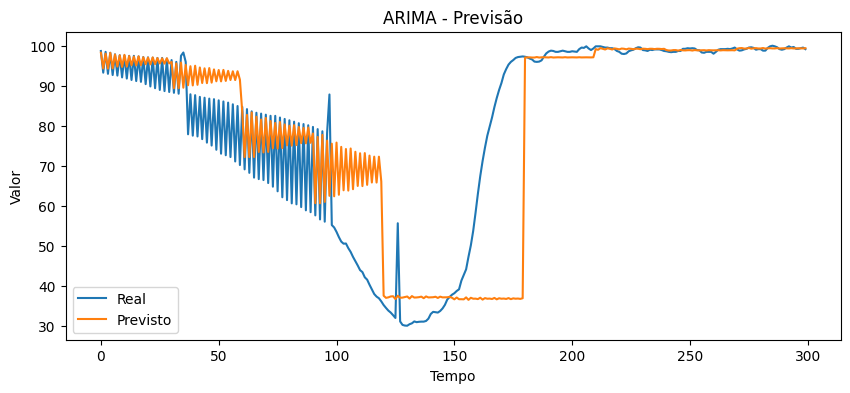

In [ ]:
from statsmodels.tsa.arima.model import ARIMA
import numpy as np

# Preparar os dados para ARIMA (usar apenas a série temporal)
train_size = int(0.7 * len(df_tucurui))
train, test = df_tucurui['volume_armazenado'][:train_size], df_tucurui['volume_armazenado'][train_size:]

history = [x for x in train]
predictions = []

# Modelo ARIMA para prever 30 dias à frente
for i in range(0, len(test) - n_future + 1, n_future):
    model = ARIMA(history, order=(5, 1, 0))
    model_fit = model.fit()
    output = model_fit.forecast(steps=n_future)
    yhat = output.tolist()
    predictions.extend(yhat)
    history.extend(test.iloc[i:i + n_future])

# Ajustar as previsões para os 300 dias
predictions = predictions[:300]

# Calcular métricas
y_test_flat = test.values[:300]
y_pred_arima = np.array(predictions).flatten()

mse_arima = mean_squared_error(y_test_flat, y_pred_arima)
rmse_arima = sqrt(mse_arima)
r2_arima = r2_score(y_test_flat, y_pred_arima)

print(f'ARIMA - MSE: {mse_arima:.3f}, RMSE: {rmse_arima:.3f}, R²: {r2_arima:.3f}')

# Visualização
plt.figure(figsize=(10, 4))
plt.plot(y_test_flat, label='Real')
plt.plot(y_pred_arima, label='Previsto')
plt.title('ARIMA - Previsão')
plt.xlabel('Tempo')
plt.ylabel('Valor')
plt.legend()
plt.show()


ValueError: Found input variables with inconsistent numbers of samples: [300, 10]

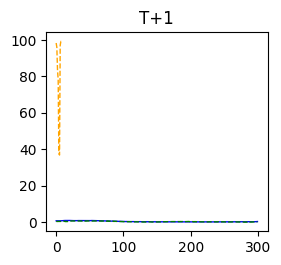

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt

# Função para plotar os resultados
def plot_results(y_test, y_pred_linear, y_pred_arima, n_future=30):
    n_rows = 5
    n_cols = 6

    # Ajustar as previsões para o mesmo tamanho de y_test
    min_length = min(len(y_test), len(y_pred_linear), len(y_pred_arima))
    y_test = y_test[:min_length]
    y_pred_linear = y_pred_linear[:min_length]
    y_pred_arima = y_pred_arima[:min_length].reshape(-1, n_future)

    # Cria uma figura grande para acomodar todos os subplots
    plt.figure(figsize=(20, 15))

    # Itera sobre cada horizonte de tempo e cria um subplot para cada um
    for i in range(n_future):
        ax = plt.subplot(n_rows, n_cols, i + 1)
        plt.plot(y_test[:, i], label='Real', color='blue', linewidth=1)
        plt.plot(y_pred_linear[:, i], label='Linear', color='green', linestyle='dashed', linewidth=1)
        if i < y_pred_arima.shape[1]:  # Garantir que não indexamos além dos limites
            plt.plot(y_pred_arima[:, i], label='ARIMA', color='orange', linestyle='dashed', linewidth=1)

        plt.title(f'T+{i+1}')

        # Calcula as métricas para cada horizonte de tempo
        mse_linear = mean_squared_error(y_test[:, i], y_pred_linear[:, i])
        rmse_linear = sqrt(mse_linear)
        r2_linear = r2_score(y_test[:, i], y_pred_linear[:, i])

        mse_arima = mean_squared_error(y_test[:, i], y_pred_arima[:, i]) if i < y_pred_arima.shape[1] else float('nan')
        rmse_arima = sqrt(mse_arima) if i < y_pred_arima.shape[1] else float('nan')
        r2_arima = r2_score(y_test[:, i], y_pred_arima[:, i]) if i < y_pred_arima.shape[1] else float('nan')

        # Adiciona as métricas como texto no gráfico
        ax.text(0.95, 0.95, f'Linear - MSE: {mse_linear:.3f}\nRMSE: {rmse_linear:.3f}\nR²: {r2_linear:.3f}\n'
                            f'ARIMA - MSE: {mse_arima:.3f}\nRMSE: {rmse_arima:.3f}\nR²: {r2_arima:.3f}',
                transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

        plt.xlabel('Tempo')
        plt.ylabel('Valor')
        plt.tight_layout()

    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
    plt.show()

# Substituir 'y_pred' pelo 'y_pred_lstm' no trecho de código abaixo

# Modelo de Regressão Linear
X_train_flat = X_train.reshape(X_train.shape[0], -1)
X_test_flat = X_test.reshape(X_test.shape[0], -1)

linear_model = LinearRegression()
linear_model.fit(X_train_flat, y_train)

# Previsões
y_pred_linear = linear_model.predict(X_test_flat)

# Modelo ARIMA para prever 30 dias à frente
history = [x for x in train]
predictions = []
for i in range(0, len(test) - n_future + 1, n_future):
    model = ARIMA(history, order=(5, 1, 0))
    model_fit = model.fit()
    output = model_fit.forecast(steps=n_future)
    yhat = output.tolist()
    predictions.extend(yhat)
    history.extend(test.iloc[i:i + n_future])

# Ajustar as previsões para os 300 dias
predictions = predictions[:300]

# Calcular métricas
y_test_flat = test.values[:300]
y_pred_arima = np.array(predictions).flatten()

# Resultados combinados para 300 dias
plot_results(y_test, y_pred_linear, y_pred_arima, n_future=30)


# 7

In [ ]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))


Num GPUs Available:  1


In [ ]:
import tensorflow as tf
print(tf.__version__)


2.15.0


In [ ]:
import tensorflow as tf

gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)


Physical devices cannot be modified after being initialized


In [ ]:
import tensorflow as tf

# Check GPU availability
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        # Set memory growth
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        print("Memory growth set for GPUs")
    except RuntimeError as e:
        print("Error setting memory growth: ", e)
else:
    print("No GPUs found")


Error setting memory growth:  Physical devices cannot be modified after being initialized


In [ ]:
import os
import warnings
import sys

import pandas as pd
from matplotlib import pyplot as plt
import datetime
import pylab as pl
import numpy as np
from sklearn import linear_model
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split
from math import sqrt
from urllib.parse import urlparse
from sqlalchemy import create_engine
import logging

from pandas import read_csv
from keras.models import Sequential
from keras.layers import *
from sklearn.preprocessing import MinMaxScaler
import math

from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import GradientBoostingRegressor
from scipy.stats import uniform as sp_randFloat
from scipy.stats import randint as sp_randInt

import tensorflow as tf
# tf.config.experimental.set_memory_growth(tf.config.list_physical_devices('GPU')[0], True)

logging.basicConfig(level=logging.WARN)
logger = logging.getLogger(__name__)

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

In [ ]:
del df['id_ft_rdh']
del df['nome_arquivo']
del df['data_criacao']
del df['data_atualizacao']
df.fillna(0, inplace=True)
df['id_tempo']=  pd.to_datetime(df['id_tempo'],format='%Y%m%d').dt.date

df_tucurui = df[(df.id_posto == 275)]
df_tucurui

,id_posto,id_tempo,vazao_natural,nivel_reservatorio,volume_armazenado,vazao_defluente,vazao_afluente,vazao_turbinada,vazao_vertida,vazao_restituida,vazao_transferida
144,275,2018-02-01,11305.0,66.61,51.79,7160.0,11490.0,0.0,0.0,0.0,0.0
305,275,2018-01-01,7908.0,63.45,36.09,3861.0,8154.0,0.0,0.0,0.0,0.0
466,275,2018-01-02,8278.0,63.44,36.05,8843.0,8637.0,0.0,0.0,0.0,0.0
627,275,2018-01-03,8293.0,63.32,35.50,10101.0,7438.0,0.0,0.0,0.0,0.0
788,275,2018-01-04,8244.0,63.18,34.87,10492.0,7644.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
303303,275,2023-01-29,16768.0,71.86,84.26,10904.0,15653.0,6794.0,4110.0,0.0,0.0
303469,275,2023-01-30,17112.0,71.99,85.18,11891.0,16032.0,7781.0,4110.0,0.0,0.0
303635,275,2023-01-31,17093.0,72.10,85.96,12046.0,15567.0,7936.0,4110.0,0.0,0.0
303801,275,2023-02-02,17486.0,72.31,87.46,13927.0,16511.0,9069.0,4858.0,0.0,0.0


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score
from keras.models import Sequential
from keras.callbacks import EarlyStopping
from math import sqrt
from keras.optimizers import Adam

df = df_tucurui
# df_t = df_furnas

del df['id_tempo']
del df['id_posto']
df.reset_index(drop=True, inplace=True)

features = df.drop(columns=['volume_armazenado'])
target = df['volume_armazenado']

scaler = MinMaxScaler()
features_scaled = scaler.fit_transform(features)
df

,vazao_natural,nivel_reservatorio,volume_armazenado,vazao_defluente,vazao_afluente,vazao_turbinada,vazao_vertida,vazao_restituida,vazao_transferida
0,11305.0,66.61,51.79,7160.0,11490.0,0.0,0.0,0.0,0.0
1,7908.0,63.45,36.09,3861.0,8154.0,0.0,0.0,0.0,0.0
2,8278.0,63.44,36.05,8843.0,8637.0,0.0,0.0,0.0,0.0
3,8293.0,63.32,35.50,10101.0,7438.0,0.0,0.0,0.0,0.0
4,8244.0,63.18,34.87,10492.0,7644.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...
1852,16768.0,71.86,84.26,10904.0,15653.0,6794.0,4110.0,0.0,0.0
1853,17112.0,71.99,85.18,11891.0,16032.0,7781.0,4110.0,0.0,0.0
1854,17093.0,72.10,85.96,12046.0,15567.0,7936.0,4110.0,0.0,0.0
1855,17486.0,72.31,87.46,13927.0,16511.0,9069.0,4858.0,0.0,0.0


In [ ]:
X, y = [], []
for i in range(len(df)-1):
    X.append(features_scaled[i:i+1])
    y.append(target[i+1])

X = np.array(X)
y = np.array(y)

# Separar dados para validação
X_val = X[-60:]
y_val = y[-60:]

# Reduzir X e y excluindo os dados de validação
X = X[:-60]
y = y[:-60]

# Dividir os dados restantes em treino e teste (70/30)
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)


Epoch 1/40
68/68 [==============================] - 7s 62ms/step - loss: 0.0350 - val_loss: 0.0253
Epoch 2/40
68/68 [==============================] - 3s 51ms/step - loss: 0.0219 - val_loss: 0.0347
Epoch 3/40
68/68 [==============================] - 3s 51ms/step - loss: 0.0190 - val_loss: 0.0339
Epoch 4/40
68/68 [==============================] - 4s 54ms/step - loss: 0.0188 - val_loss: 0.0344
Epoch 5/40
68/68 [==============================] - 3s 51ms/step - loss: 0.0194 - val_loss: 0.0361
Epoch 6/40
68/68 [==============================] - 3s 51ms/step - loss: 0.0183 - val_loss: 0.0237
Epoch 7/40
68/68 [==============================] - 4s 52ms/step - loss: 0.0175 - val_loss: 0.0308
Epoch 8/40
68/68 [==============================] - 3s 51ms/step - loss: 0.0171 - val_loss: 0.0221
Epoch 9/40
68/68 [==============================] - 3s 51ms/step - loss: 0.0166 - val_loss: 0.0357
Epoch 10/40
68/68 [==============================] - 3s 51ms/step - loss: 0.0168 - val_loss: 0.0307
Epoch 11/

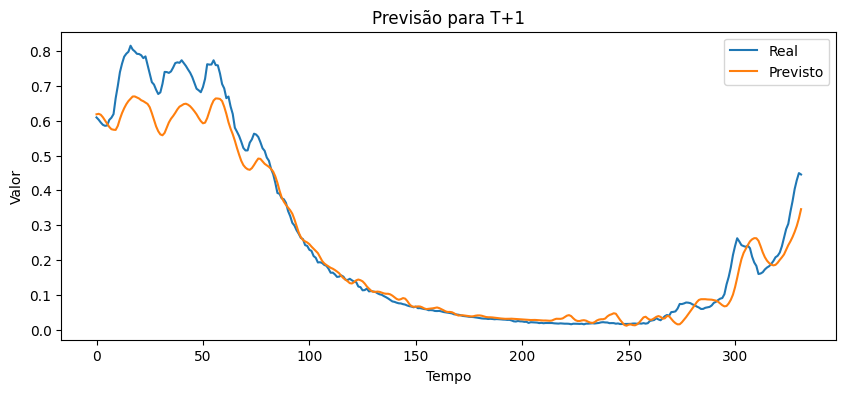

Horizonte 2: MSE = 0.002, RMSE = 0.045, R² = 0.972


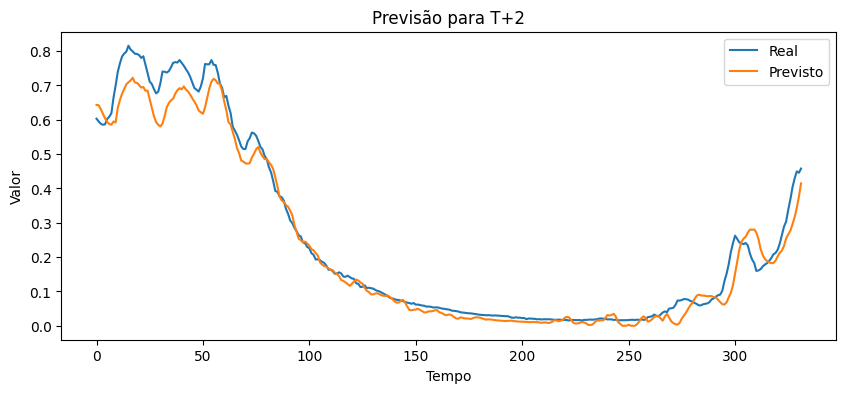

Horizonte 3: MSE = 0.005, RMSE = 0.069, R² = 0.934


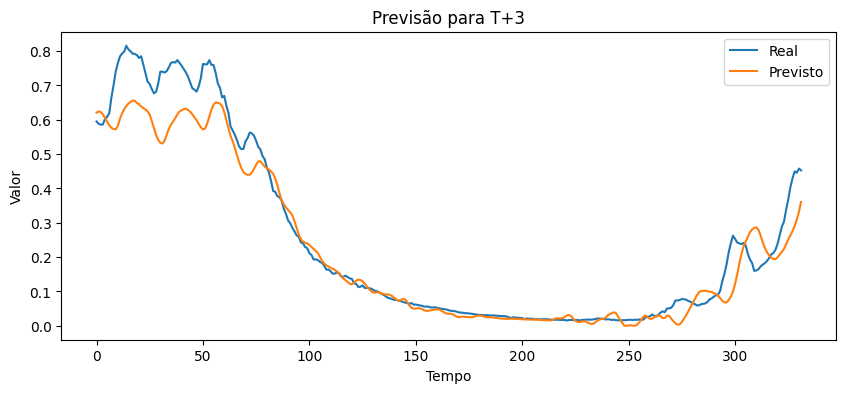

Horizonte 4: MSE = 0.003, RMSE = 0.057, R² = 0.954


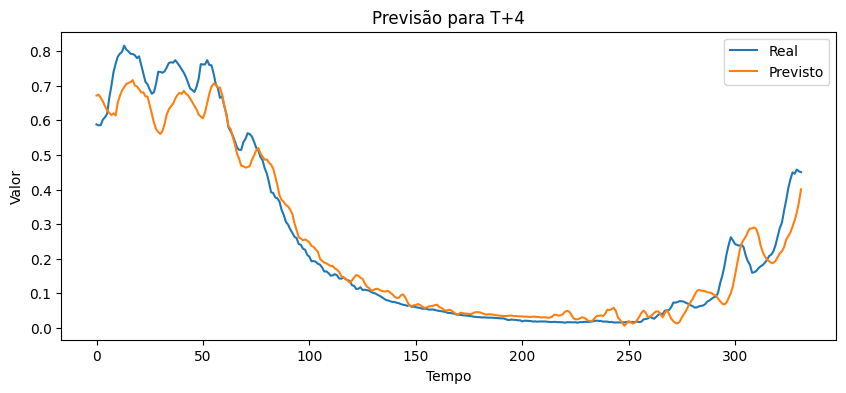

Horizonte 5: MSE = 0.007, RMSE = 0.083, R² = 0.903


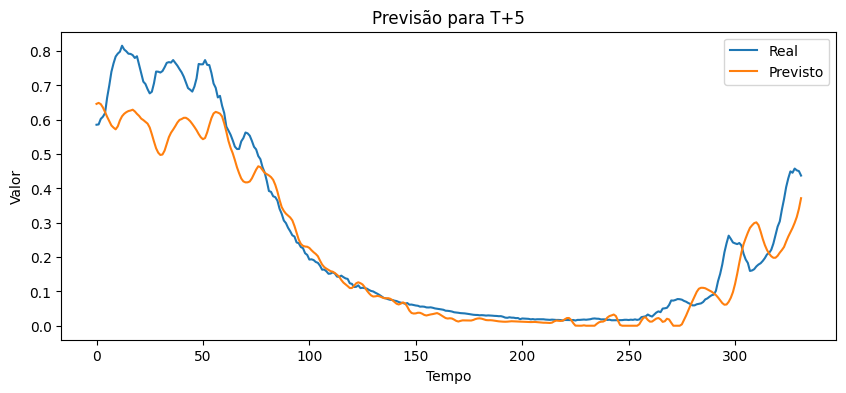

Horizonte 6: MSE = 0.005, RMSE = 0.070, R² = 0.931


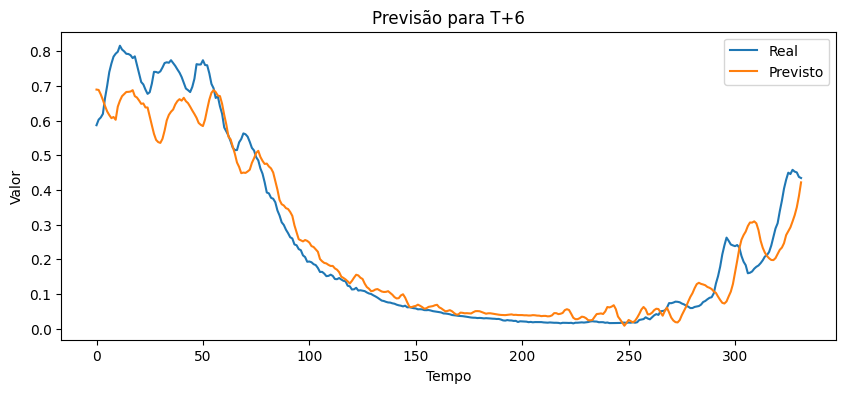

Horizonte 7: MSE = 0.009, RMSE = 0.093, R² = 0.878


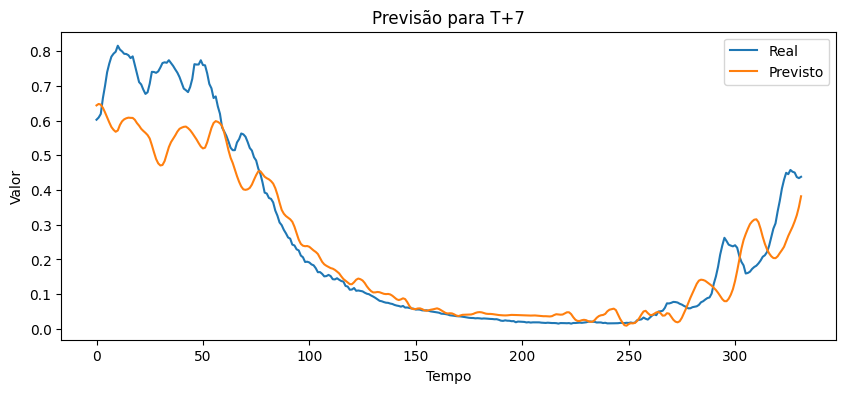

Horizonte 8: MSE = 0.007, RMSE = 0.083, R² = 0.901


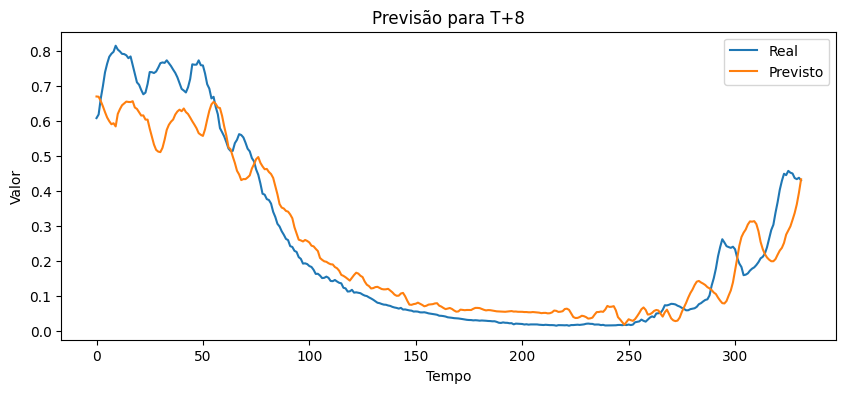

Horizonte 9: MSE = 0.011, RMSE = 0.107, R² = 0.837


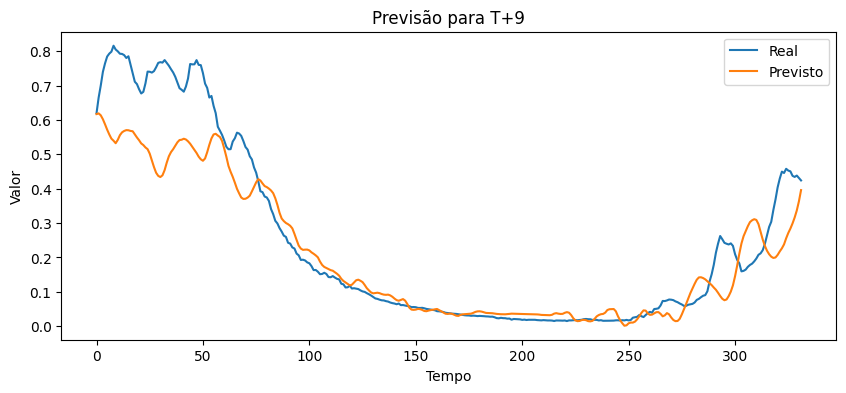

Horizonte 10: MSE = 0.010, RMSE = 0.100, R² = 0.856


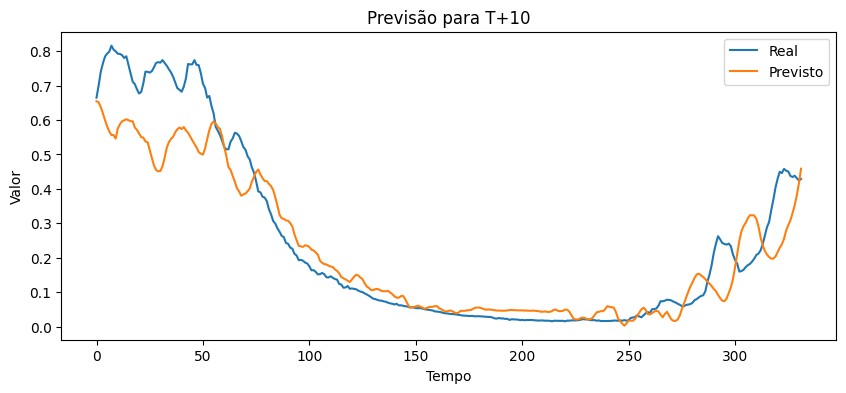

Horizonte 11: MSE = 0.011, RMSE = 0.105, R² = 0.842


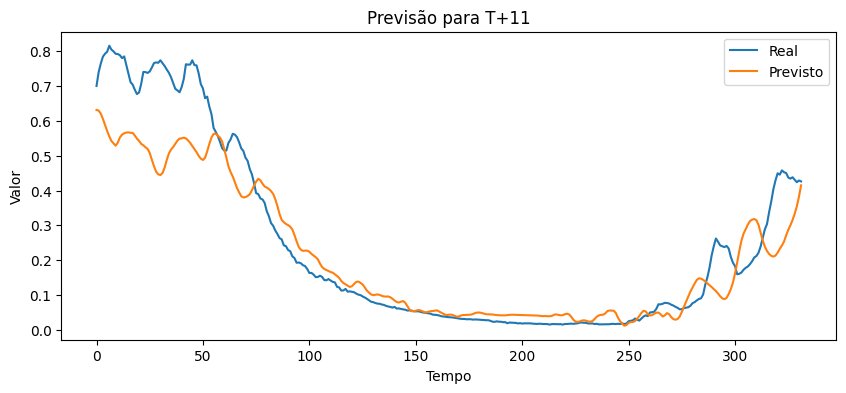

Horizonte 12: MSE = 0.009, RMSE = 0.097, R² = 0.862


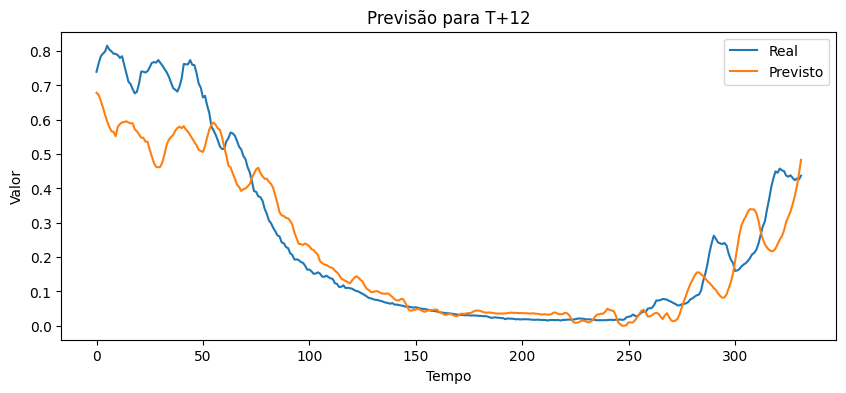

Horizonte 13: MSE = 0.013, RMSE = 0.112, R² = 0.815


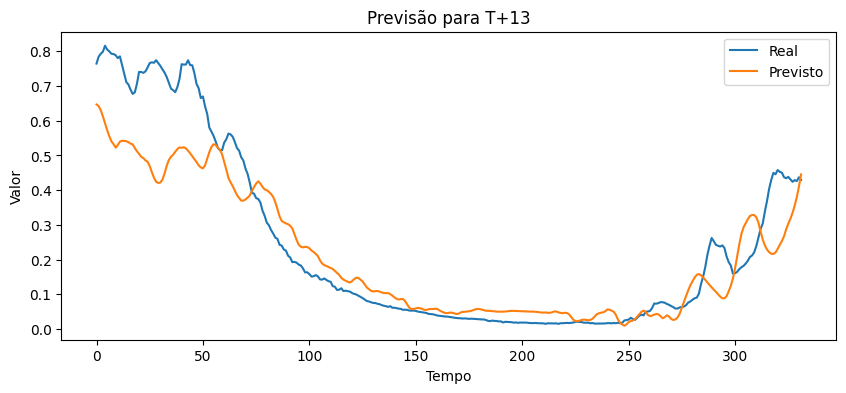

Horizonte 14: MSE = 0.011, RMSE = 0.105, R² = 0.837


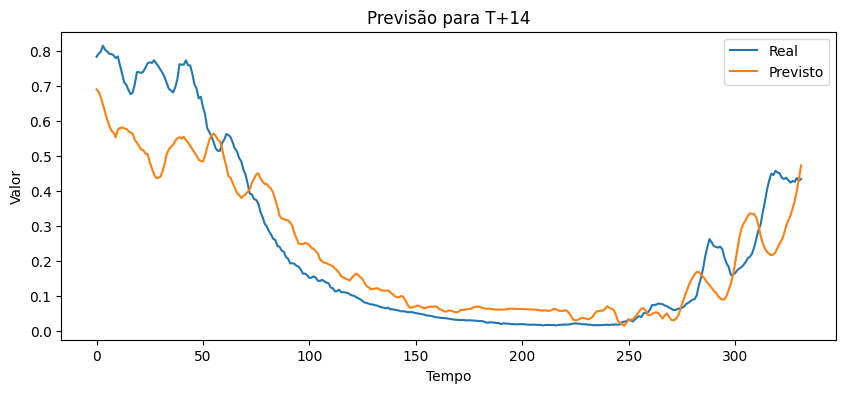

Horizonte 15: MSE = 0.013, RMSE = 0.112, R² = 0.812


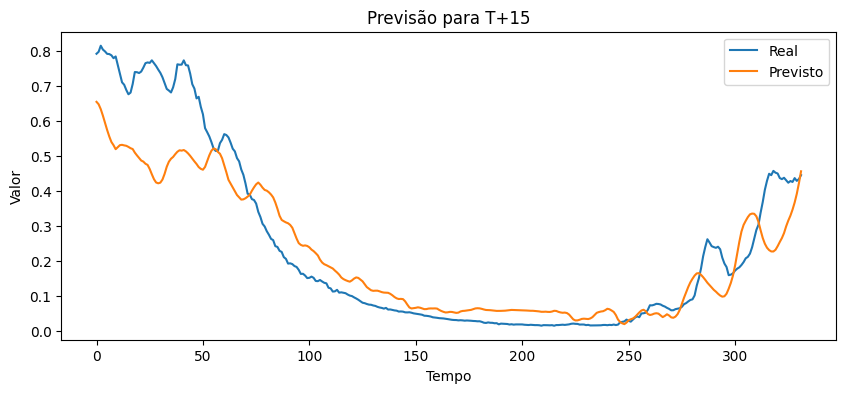

Horizonte 16: MSE = 0.014, RMSE = 0.117, R² = 0.791


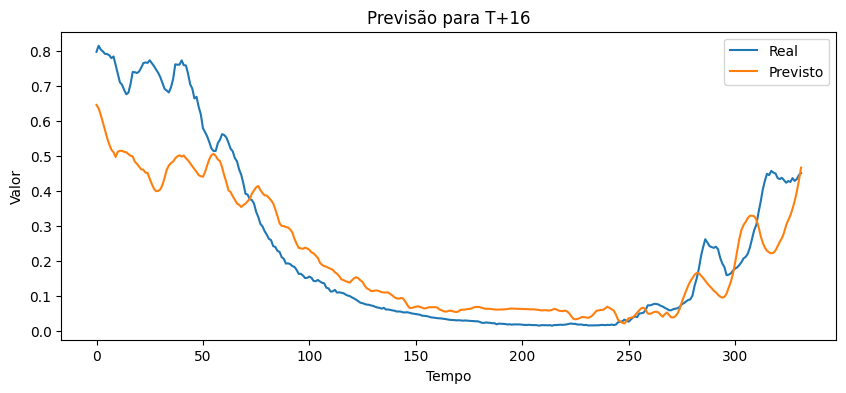

Horizonte 17: MSE = 0.013, RMSE = 0.116, R² = 0.793


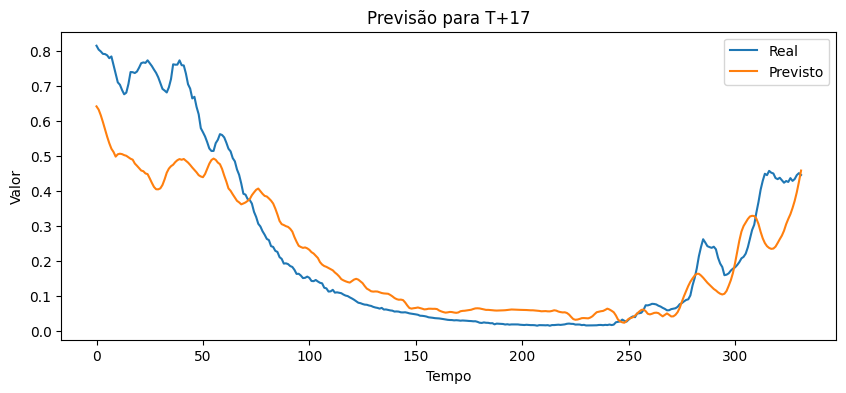

Horizonte 18: MSE = 0.016, RMSE = 0.126, R² = 0.754


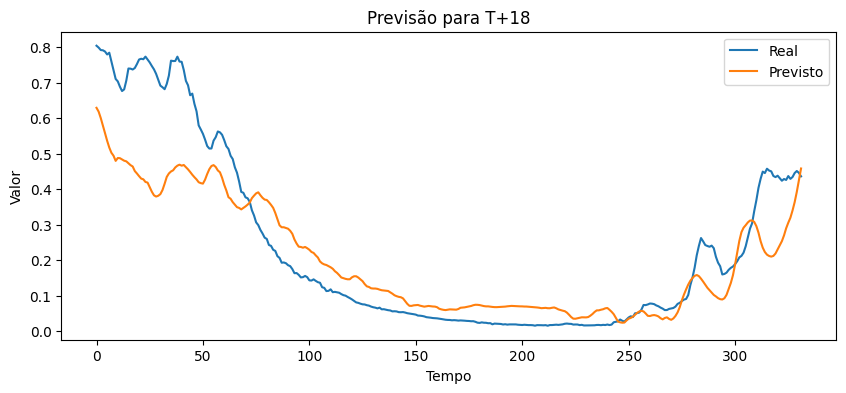

Horizonte 19: MSE = 0.016, RMSE = 0.125, R² = 0.754


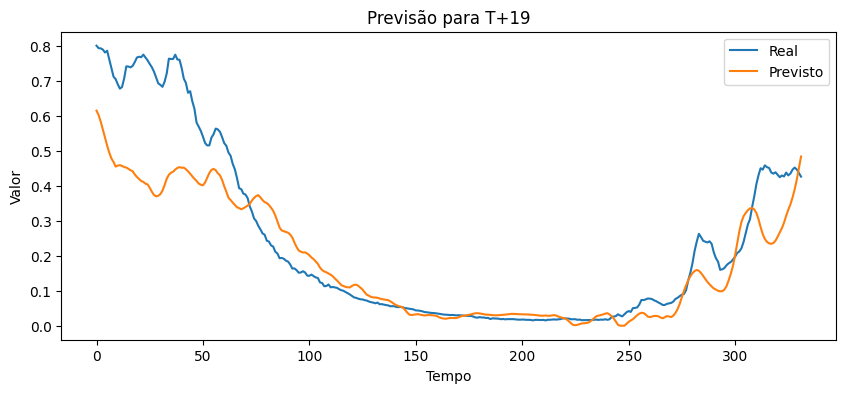

Horizonte 20: MSE = 0.016, RMSE = 0.125, R² = 0.748


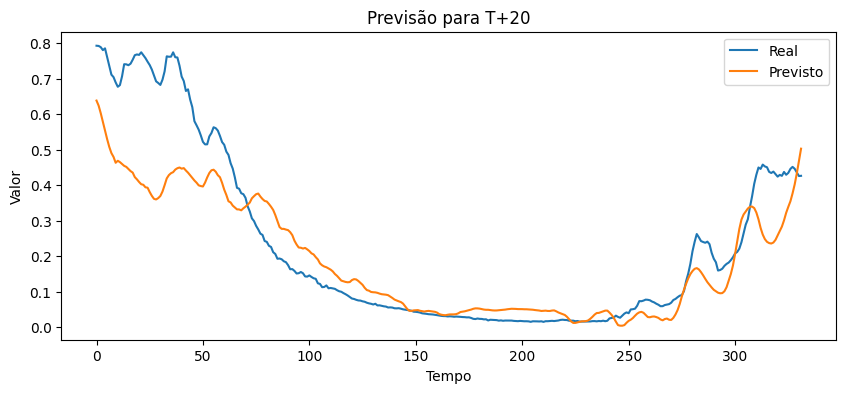

Horizonte 21: MSE = 0.017, RMSE = 0.130, R² = 0.727


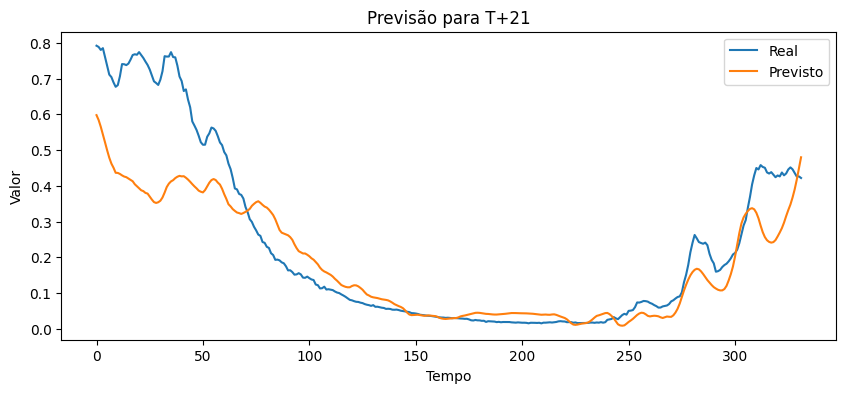

Horizonte 22: MSE = 0.017, RMSE = 0.131, R² = 0.717


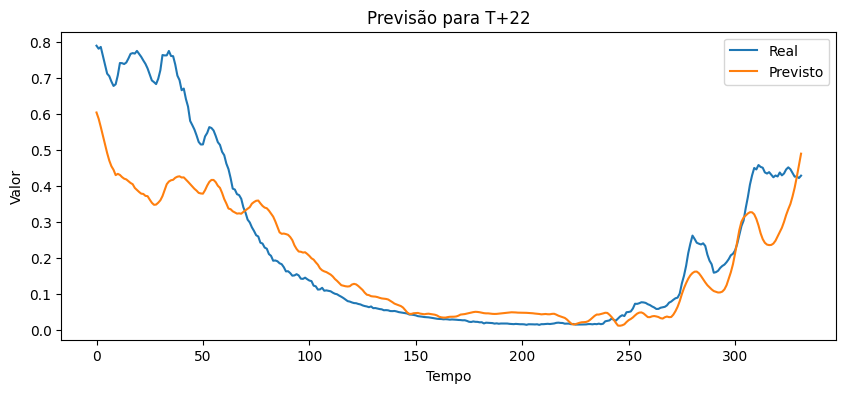

Horizonte 23: MSE = 0.017, RMSE = 0.129, R² = 0.721


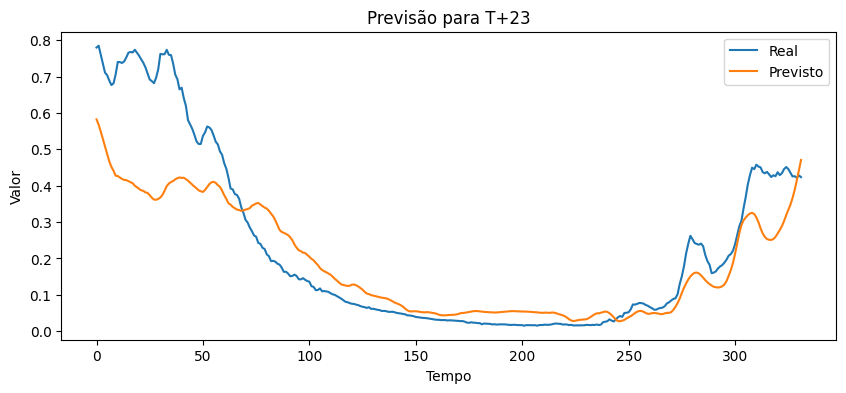

Horizonte 24: MSE = 0.018, RMSE = 0.132, R² = 0.704


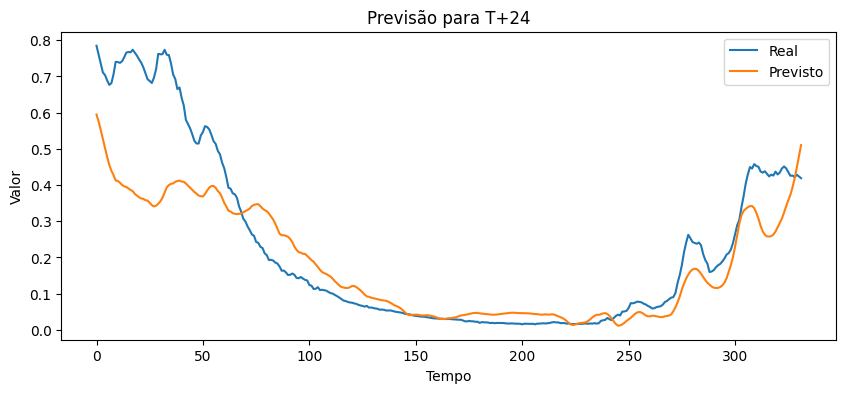

Horizonte 25: MSE = 0.018, RMSE = 0.135, R² = 0.689


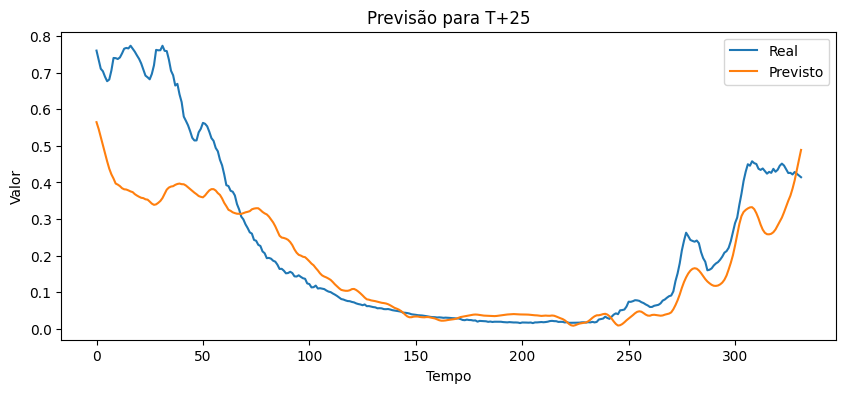

Horizonte 26: MSE = 0.022, RMSE = 0.148, R² = 0.622


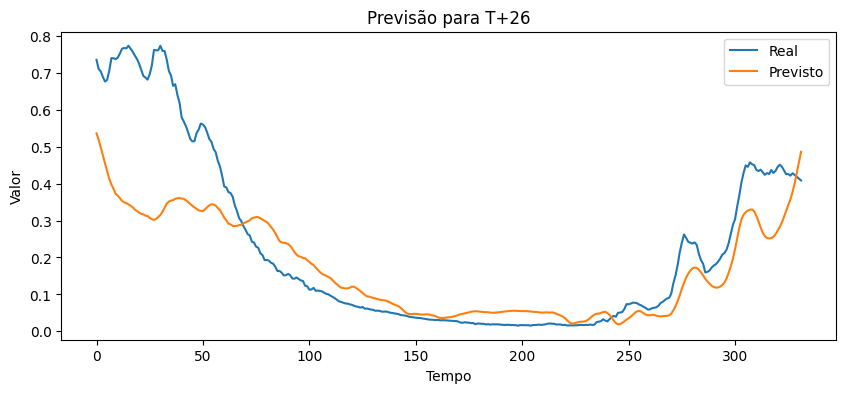

Horizonte 27: MSE = 0.017, RMSE = 0.131, R² = 0.698


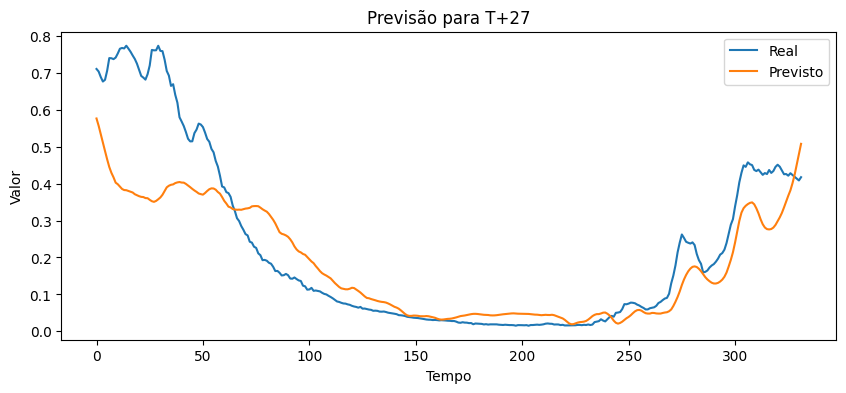

Horizonte 28: MSE = 0.023, RMSE = 0.153, R² = 0.587


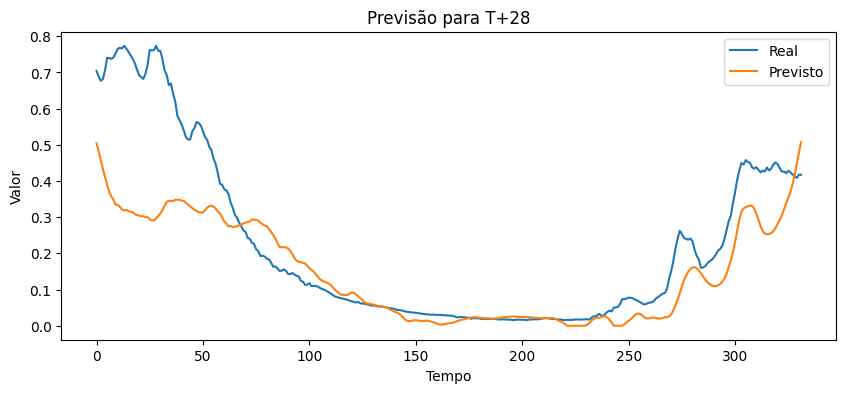

Horizonte 29: MSE = 0.018, RMSE = 0.133, R² = 0.682


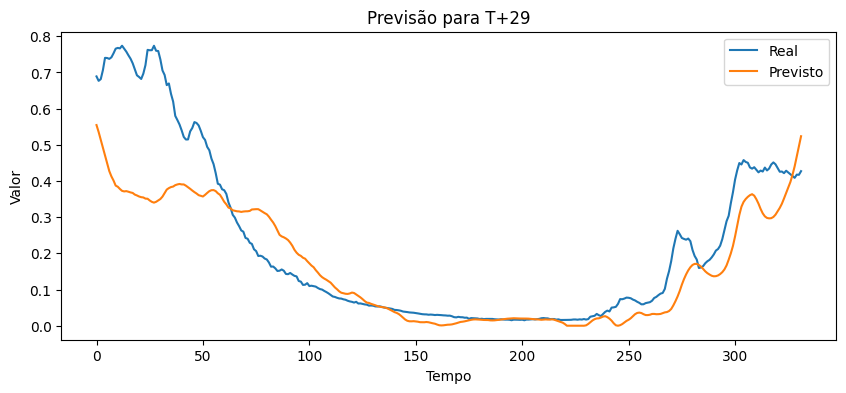

Horizonte 30: MSE = 0.023, RMSE = 0.151, R² = 0.586


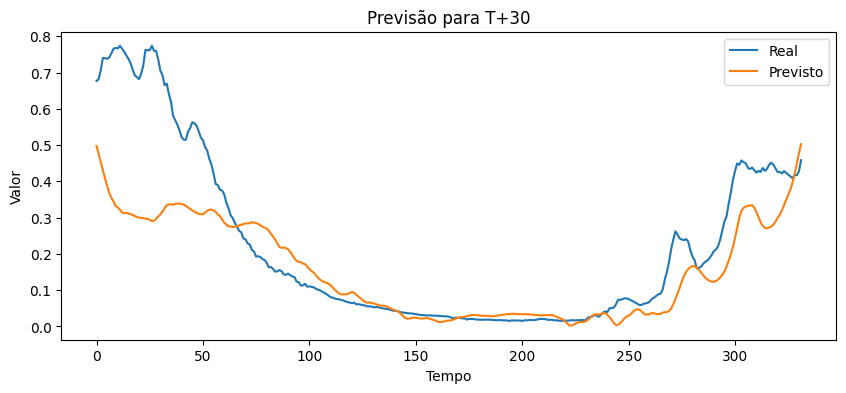

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense
from sklearn.metrics import mean_squared_error, r2_score
from keras.callbacks import EarlyStopping
from math import sqrt

# Função modificada para criar dados
def create_data(df, max_future, n_past, train_test_split_percentage, validation_split_percentage):
    n_feature = df.shape[1]
    x_data, y_data = [], []

    for i in range(n_past, len(df) - max_future + 1):
        x_data.append(df[i - n_past:i, 0:n_feature])
        y_data.append([df[j, 0] for j in range(i, i + max_future)])

    split_training_test_starting_point = int(round(train_test_split_percentage * len(x_data)))
    split_train_validation_starting_point = int(round(split_training_test_starting_point * (1 - validation_split_percentage)))

    x_train = x_data[:split_train_validation_starting_point]
    y_train = y_data[:split_train_validation_starting_point]

    x_val = x_data[split_train_validation_starting_point:split_training_test_starting_point]
    y_val = y_data[split_train_validation_starting_point:split_training_test_starting_point]

    x_test = x_data[split_training_test_starting_point:]
    y_test = y_data[split_training_test_starting_point:]

    return np.array(x_train), np.array(x_test), np.array(x_val), np.array(y_train), np.array(y_test), np.array(y_val)

# Parâmetros
n_future = 30  # Número de dias que você deseja prever no futuro
n_past = 720   # Número de dias passados que você deseja usar para prever o futuro

# Supondo que 'features_scaled' é seu DataFrame pré-processado
X_train, X_test, X_val, y_train, y_test, y_val = create_data(features_scaled, n_future, n_past, 0.7, 0.3)

# Modelo LSTM
regressor = Sequential()
regressor.add(LSTM(units=256, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
# regressor.add(LSTM(units=256, return_sequences=True))
# regressor.add(Dropout(0.2))
regressor.add(GRU(units=256, return_sequences=False))
regressor.add(Dropout(0.2))
# regressor.add(LSTM(units=64, return_sequences=False))
# regressor.add(Dropout(0.2))
regressor.add(Dense(units=n_future, activation='relu'))
# regressor.add(Dense(units=n_future, activation='linear'))
regressor.compile(optimizer='adam', loss='mse')

# Callbacks
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=5)

# Treinamento
history = regressor.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=40, batch_size=8, callbacks=[es])

# Avaliação e Visualização
y_pred = regressor.predict(X_test)

for i in range(n_future):
    y_true = y_test[:, i]
    y_pred_i = y_pred[:, i]

    mse = mean_squared_error(y_true, y_pred_i)
    rmse = sqrt(mse)
    r2 = r2_score(y_true, y_pred_i)

    print(f'Horizonte {i+1}: MSE = {mse:.3f}, RMSE = {rmse:.3f}, R² = {r2:.3f}')

    plt.figure(figsize=(10, 4))
    plt.plot(y_true, label='Real')
    plt.plot(y_pred_i, label='Previsto')
    plt.title(f'Previsão para T+{i+1}')
    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()


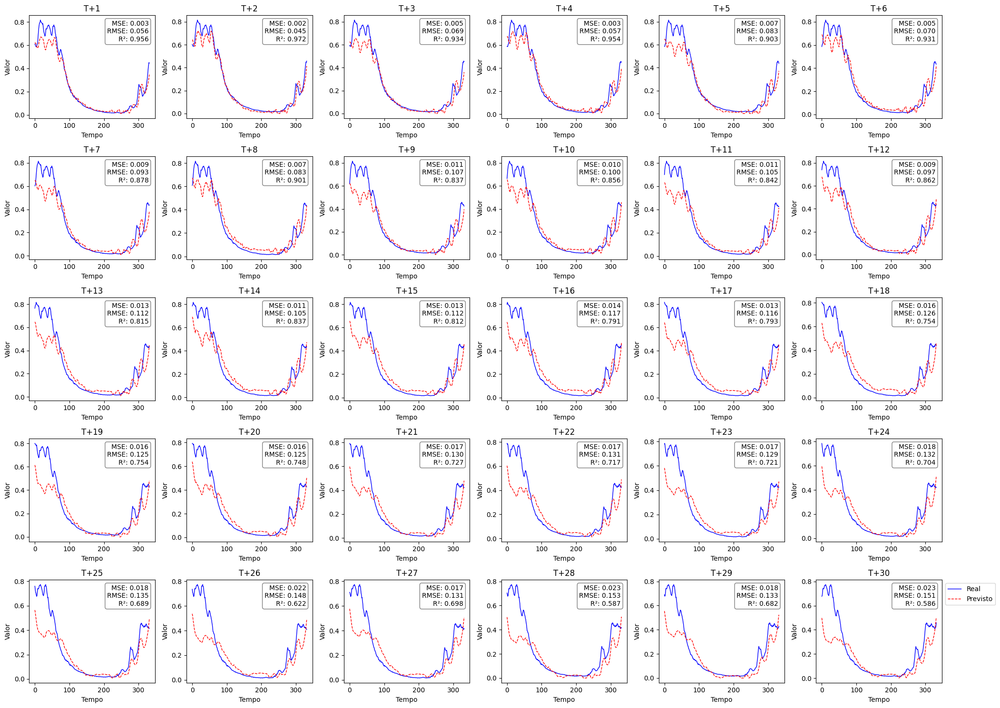

In [ ]:
# Número de linhas e colunas para os subplots
n_rows = 5
n_cols = 6
n_future = 30  # Número total de dias que você está prevendo

# Cria uma figura grande para acomodar todos os subplots
plt.figure(figsize=(20, 15))

# Itera sobre cada horizonte de tempo e cria um subplot para cada um
for i in range(n_future):
    ax = plt.subplot(n_rows, n_cols, i+1)
    plt.plot(y_test[:, i], label='Real', color='blue', linewidth=1)
    plt.plot(y_pred[:, i], label='Previsto', color='red', linestyle='dashed', linewidth=1)
    plt.title(f'T+{i+1}')

    # Calcula as métricas para cada horizonte de tempo
    mse = mean_squared_error(y_test[:, i], y_pred[:, i])
    rmse = sqrt(mse)
    r2 = r2_score(y_test[:, i], y_pred[:, i])

    # Adiciona as métricas como texto no gráfico
    ax.text(0.95, 0.95, f'MSE: {mse:.3f}\nRMSE: {rmse:.3f}\nR²: {r2:.3f}',
            transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.tight_layout()

plt.legend(loc='upper left', bbox_to_anchor=(1,1))
plt.show()

# 8

In [10]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Mon Jun 24 23:30:53 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [11]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 13.6 gigabytes of available RAM

Not using a high-RAM runtime


In [12]:
import os
import warnings
import sys

import pandas as pd
from matplotlib import pyplot as plt
import datetime
import pylab as pl
import numpy as np
from sklearn import linear_model
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge
from math import sqrt
from urllib.parse import urlparse
from sqlalchemy import create_engine
import logging

from pandas import read_csv
from keras.models import Sequential
from keras.layers import *
from sklearn.preprocessing import MinMaxScaler
import math

from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import GradientBoostingRegressor
from scipy.stats import uniform as sp_randFloat
from scipy.stats import randint as sp_randInt

import tensorflow as tf
# tf.config.experimental.set_memory_growth(tf.config.list_physical_devices('GPU')[0], True)

logging.basicConfig(level=logging.WARN)
logger = logging.getLogger(__name__)

df = pd.read_csv('/content/rdh_database_EAR.csv')

del df['id_ft_rdh']
del df['nome_arquivo']
del df['data_criacao']
del df['data_atualizacao']
df.fillna(0, inplace=True)
df['id_tempo']=  pd.to_datetime(df['id_tempo'],format='%Y%m%d').dt.date

df_tucurui = df[(df.id_posto == 275)]
df_tucurui

import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score
from keras.models import Sequential
from keras.callbacks import EarlyStopping
from math import sqrt
from keras.optimizers import Adam

df = df_tucurui

del df['id_tempo']
del df['id_posto']
df.reset_index(drop=True, inplace=True)

features = df.drop(columns=['volume_armazenado'])
target = df['volume_armazenado']

scaler = MinMaxScaler()
features_scaled = scaler.fit_transform(features)
df

X, y = [], []
for i in range(len(df)-1):
    X.append(features_scaled[i:i+1])
    y.append(target[i+1])

X = np.array(X)
y = np.array(y)

# Separar dados para validação
X_val = X[-60:]
y_val = y[-60:]

# Reduzir X e y excluindo os dados de validação
X = X[:-60]
y = y[:-60]

# Dividir os dados restantes em treino e teste (70/30)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Regressão Linear com Regularização Ridge
ridge_regressor = Ridge(alpha=1.0)
ridge_regressor.fit(X_train.reshape(-1, X_train.shape[-1]), y_train)

y_pred_linear = ridge_regressor.predict(X_test.reshape(-1, X_test.shape[-1]))

# Métricas para a Regressão Linear
mse_linear = mean_squared_error(y_test, y_pred_linear)
rmse_linear = sqrt(mse_linear)
r2_linear = r2_score(y_test, y_pred_linear)

print(f'Regressão Linear (Ridge): MSE = {mse_linear:.3f}, RMSE = {rmse_linear:.3f}, R² = {r2_linear:.3f}')


Regressão Linear (Ridge): MSE = 189.388, RMSE = 13.762, R² = 0.768


Epoch 1/40
68/68 [==============================] - 11s 69ms/step - loss: 0.0383 - val_loss: 0.0338
Epoch 2/40
68/68 [==============================] - 4s 66ms/step - loss: 0.0224 - val_loss: 0.0301
Epoch 3/40
68/68 [==============================] - 4s 52ms/step - loss: 0.0215 - val_loss: 0.0279
Epoch 4/40
68/68 [==============================] - 4s 52ms/step - loss: 0.0197 - val_loss: 0.0193
Epoch 5/40
68/68 [==============================] - 4s 60ms/step - loss: 0.0191 - val_loss: 0.0334
Epoch 6/40
68/68 [==============================] - 4s 60ms/step - loss: 0.0196 - val_loss: 0.0222
Epoch 7/40
68/68 [==============================] - 4s 52ms/step - loss: 0.0183 - val_loss: 0.0335
Epoch 8/40
68/68 [==============================] - 4s 52ms/step - loss: 0.0175 - val_loss: 0.0314
Epoch 9/40
68/68 [==============================] - 4s 64ms/step - loss: 0.0180 - val_loss: 0.0286
Epoch 9: early stopping
11/11 [==============================] - 1s 26ms/step
Horizonte 1: MSE = 0.003, RMSE

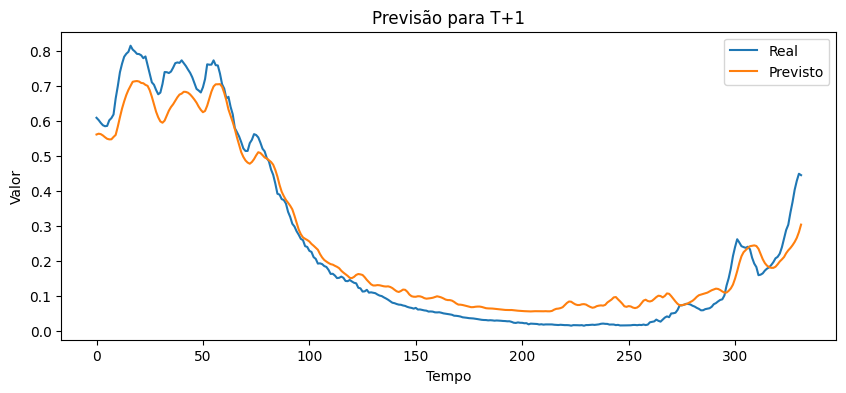

Horizonte 2: MSE = 0.003, RMSE = 0.051, R² = 0.964


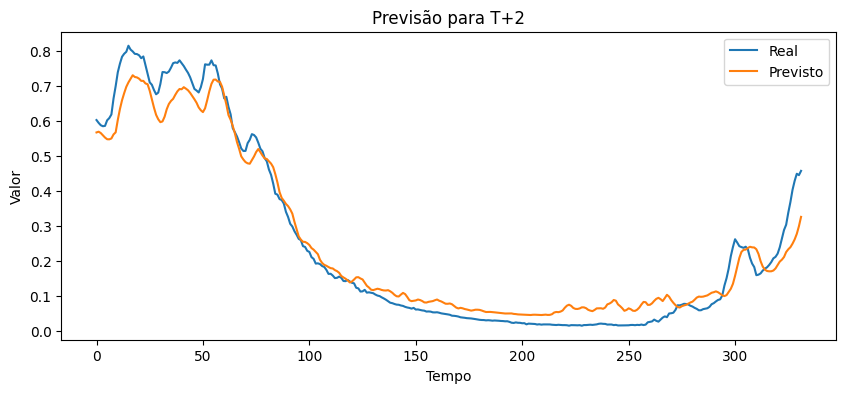

Horizonte 3: MSE = 0.004, RMSE = 0.063, R² = 0.945


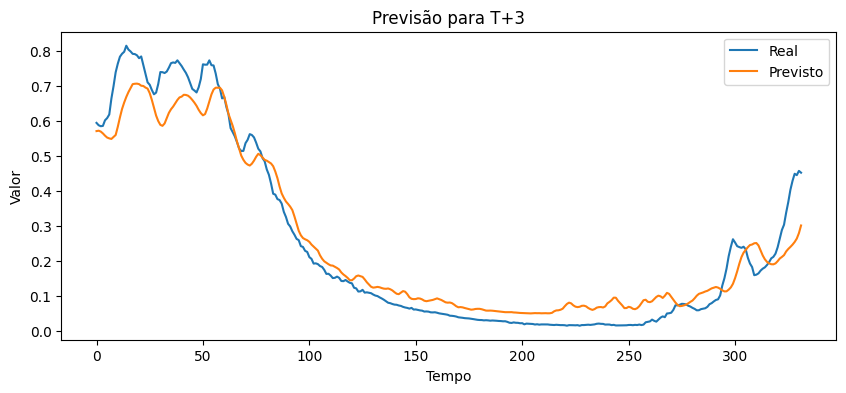

Horizonte 4: MSE = 0.005, RMSE = 0.070, R² = 0.931


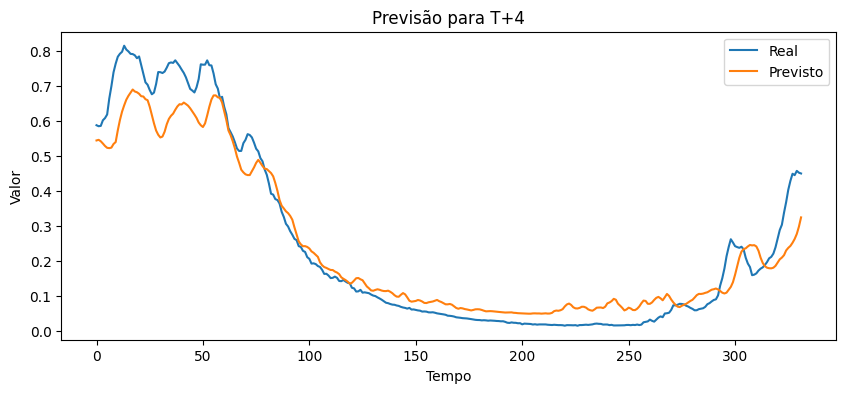

Horizonte 5: MSE = 0.004, RMSE = 0.065, R² = 0.940


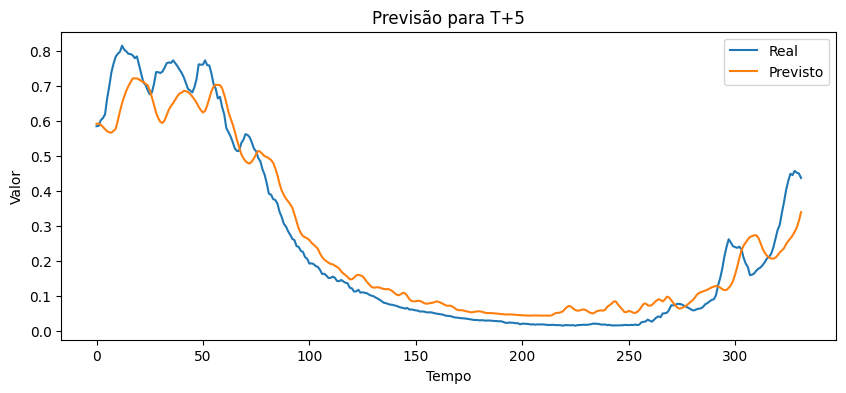

Horizonte 6: MSE = 0.007, RMSE = 0.084, R² = 0.901


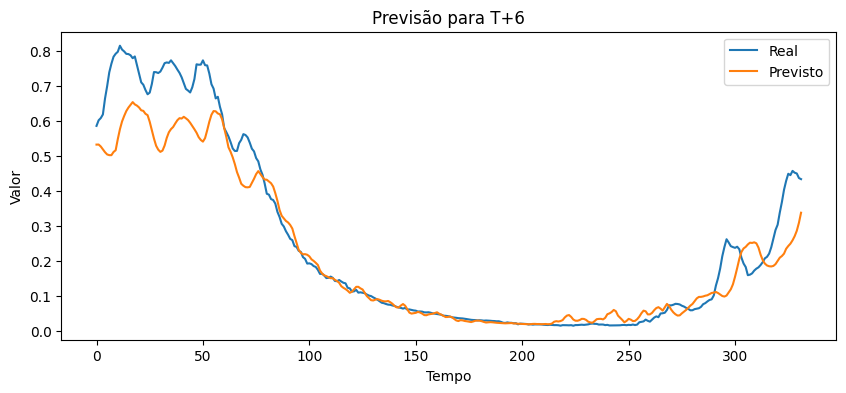

Horizonte 7: MSE = 0.007, RMSE = 0.081, R² = 0.908


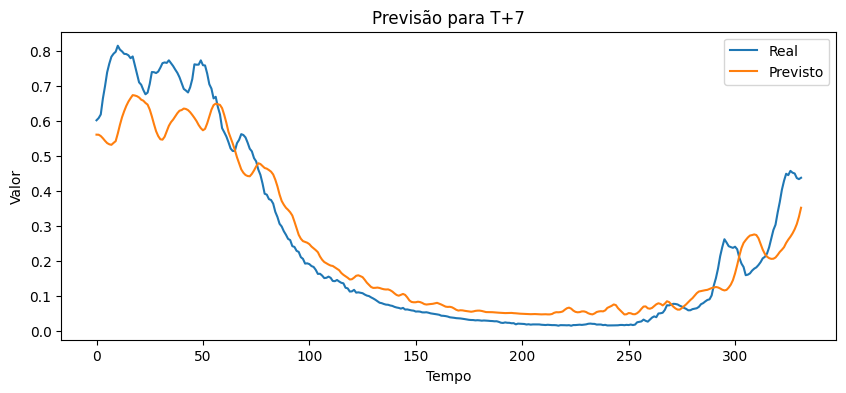

Horizonte 8: MSE = 0.008, RMSE = 0.088, R² = 0.891


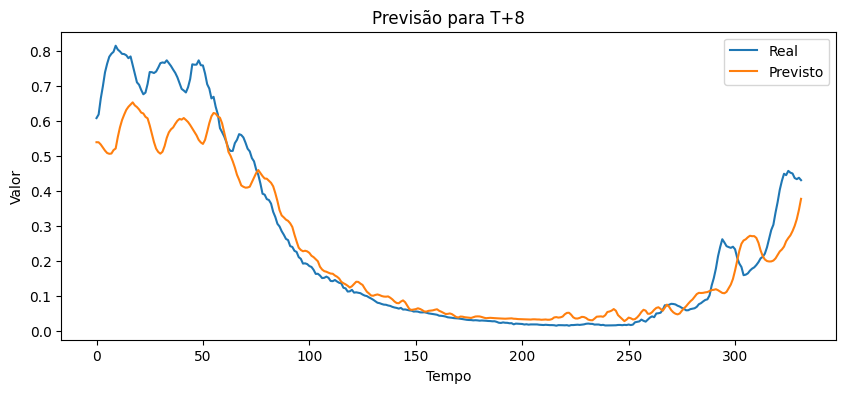

Horizonte 9: MSE = 0.008, RMSE = 0.090, R² = 0.885


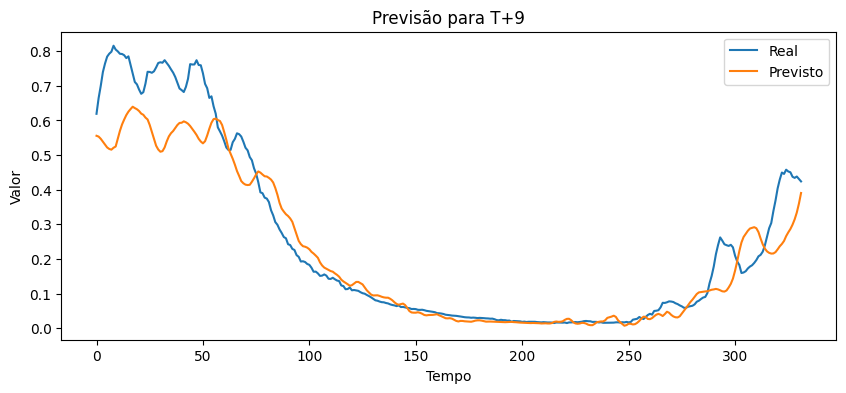

Horizonte 10: MSE = 0.009, RMSE = 0.095, R² = 0.870


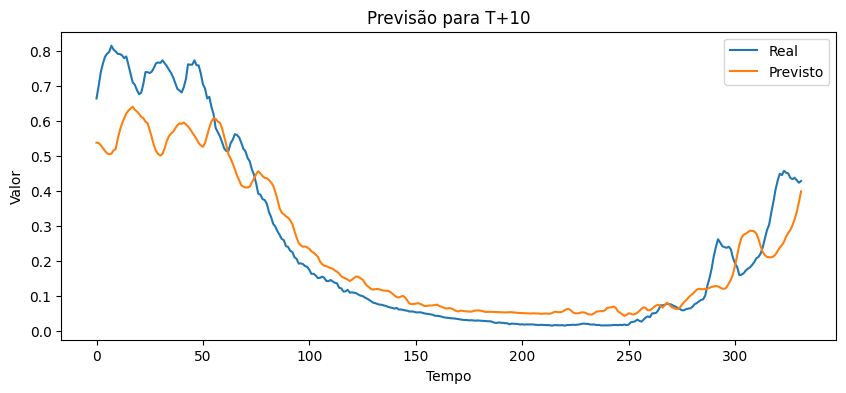

Horizonte 11: MSE = 0.010, RMSE = 0.098, R² = 0.862


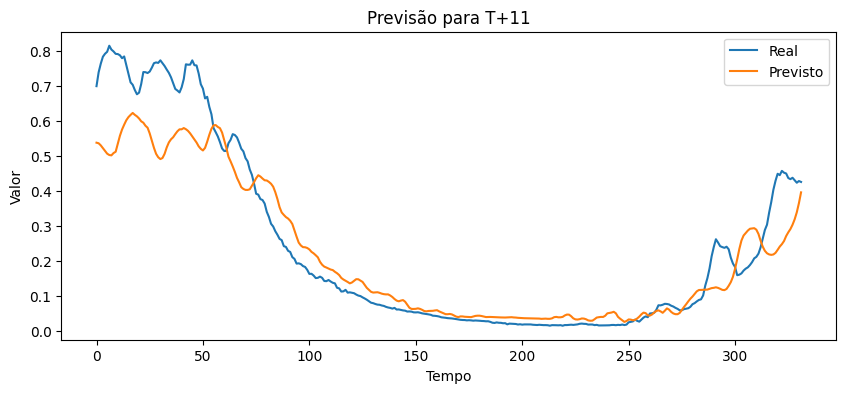

Horizonte 12: MSE = 0.009, RMSE = 0.095, R² = 0.870


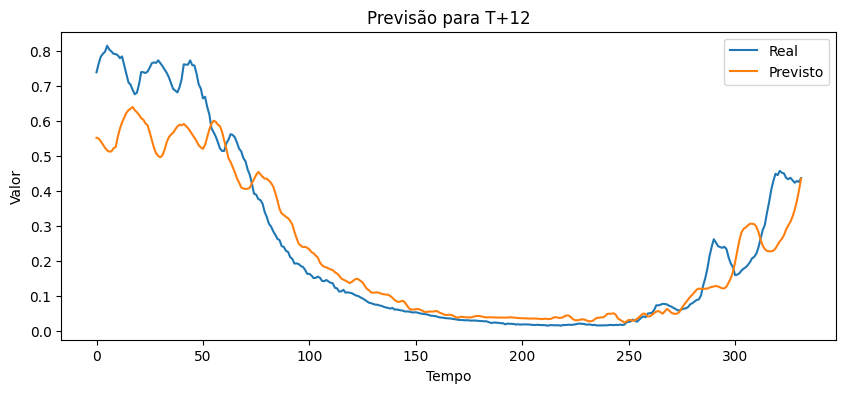

Horizonte 13: MSE = 0.012, RMSE = 0.111, R² = 0.819


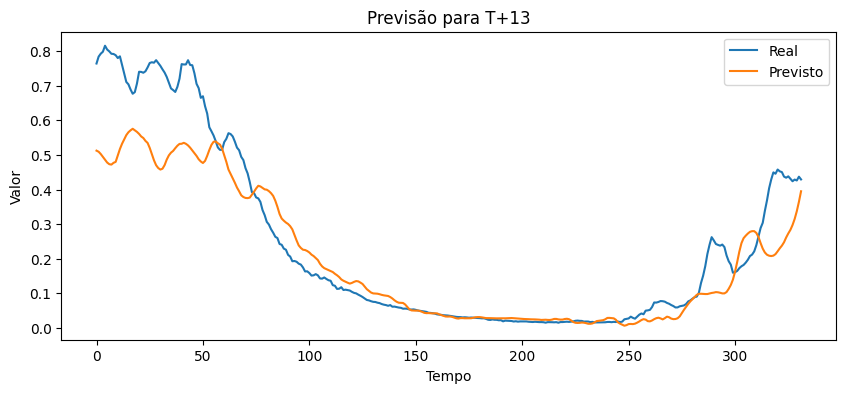

Horizonte 14: MSE = 0.011, RMSE = 0.103, R² = 0.844


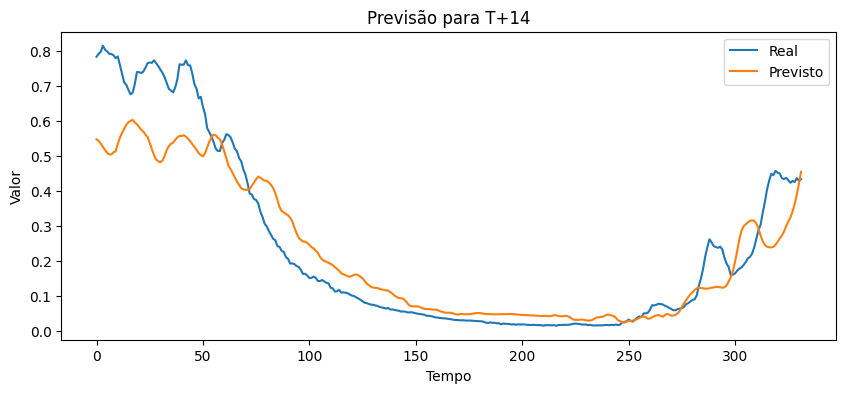

Horizonte 15: MSE = 0.016, RMSE = 0.125, R² = 0.765


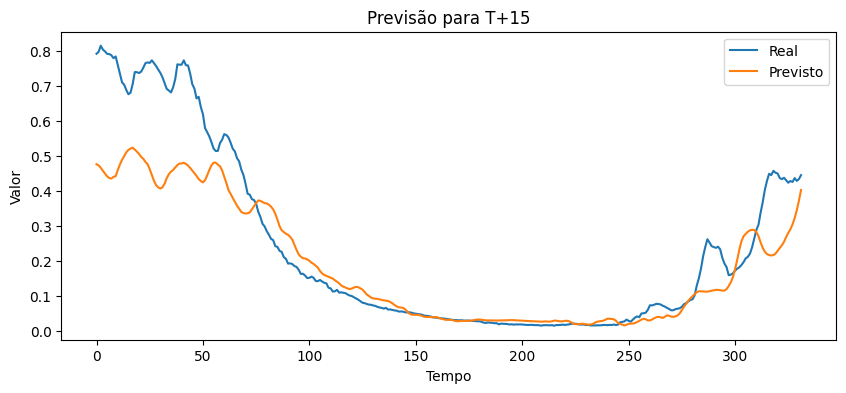

Horizonte 16: MSE = 0.013, RMSE = 0.116, R² = 0.796


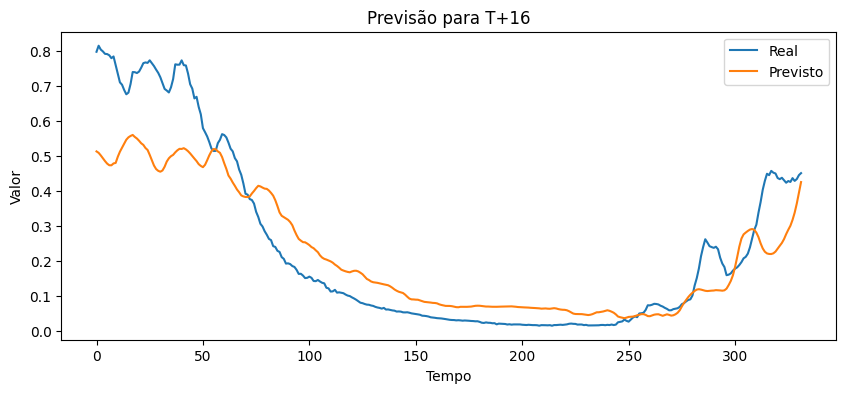

Horizonte 17: MSE = 0.014, RMSE = 0.117, R² = 0.790


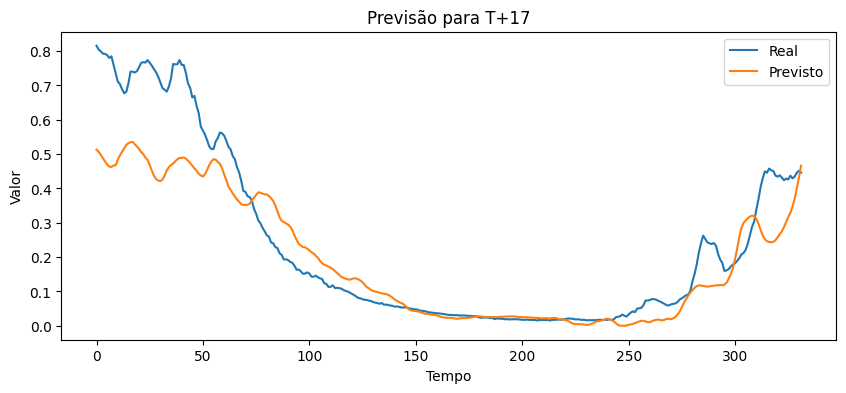

Horizonte 18: MSE = 0.014, RMSE = 0.116, R² = 0.789


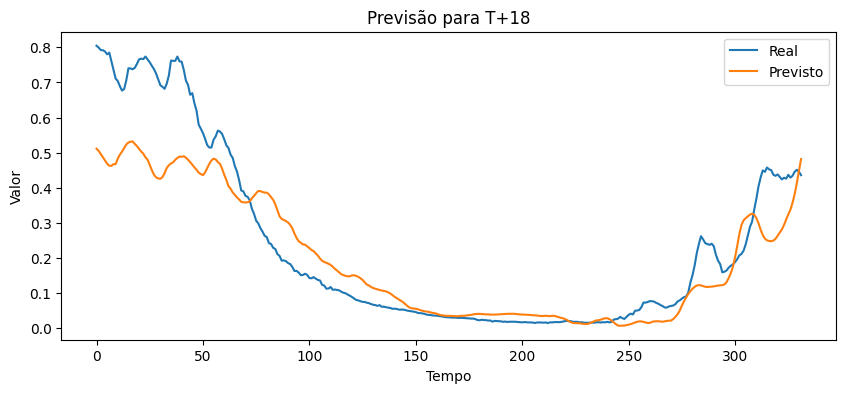

Horizonte 19: MSE = 0.018, RMSE = 0.133, R² = 0.721


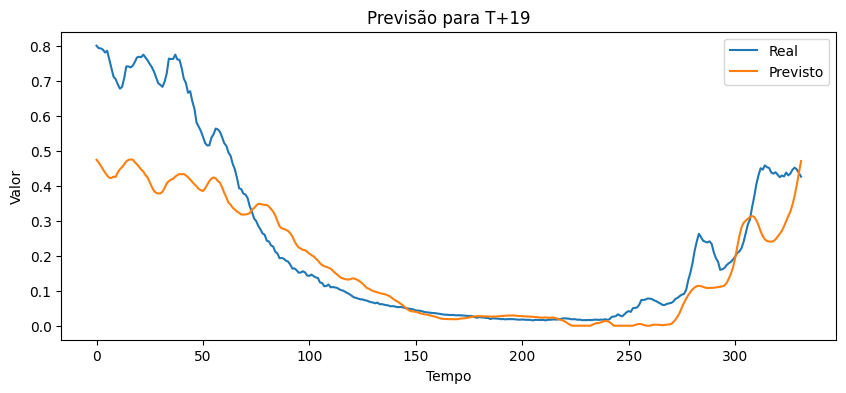

Horizonte 20: MSE = 0.016, RMSE = 0.127, R² = 0.742


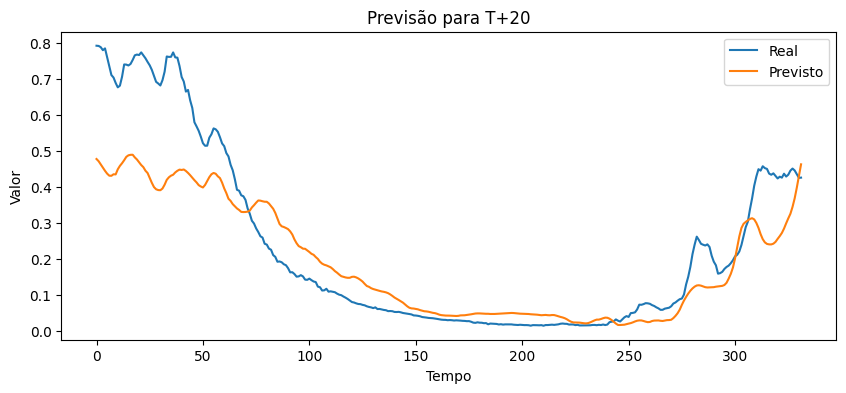

Horizonte 21: MSE = 0.015, RMSE = 0.122, R² = 0.760


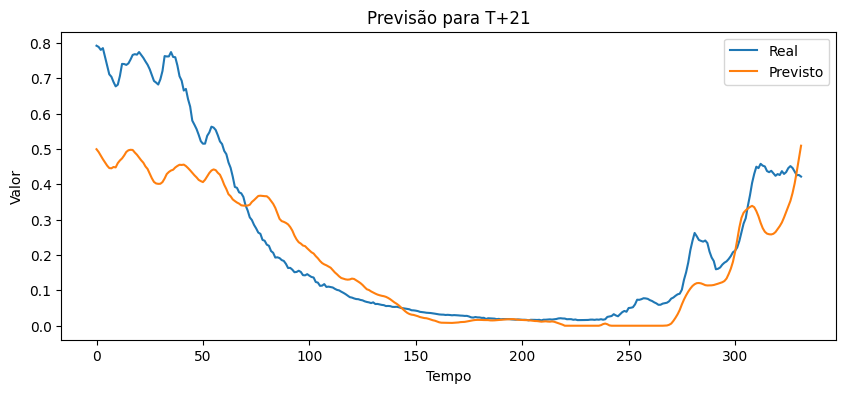

Horizonte 22: MSE = 0.016, RMSE = 0.125, R² = 0.741


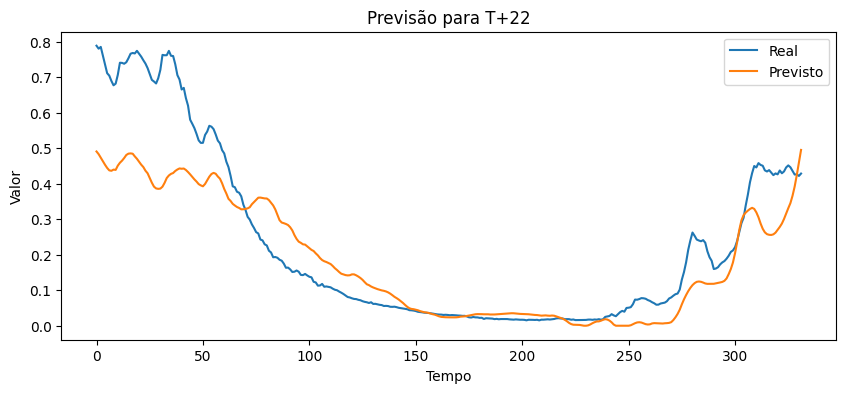

Horizonte 23: MSE = 0.018, RMSE = 0.134, R² = 0.699


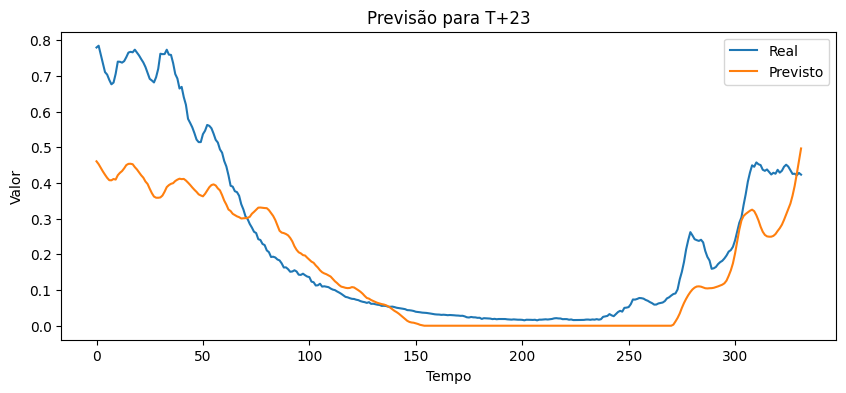

Horizonte 24: MSE = 0.017, RMSE = 0.131, R² = 0.711


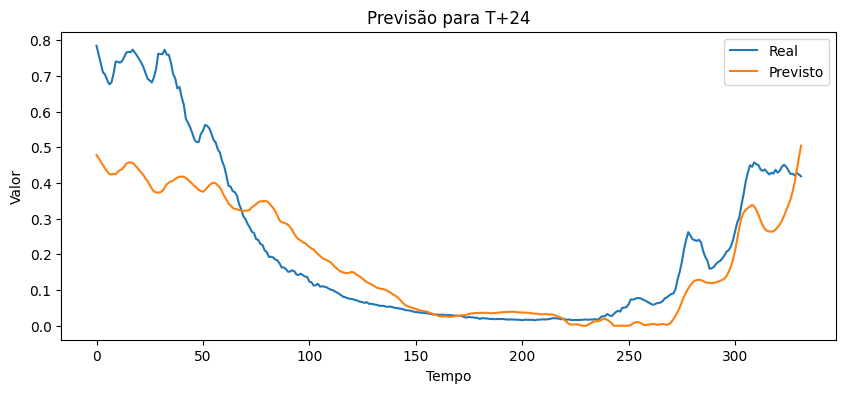

Horizonte 25: MSE = 0.021, RMSE = 0.144, R² = 0.644


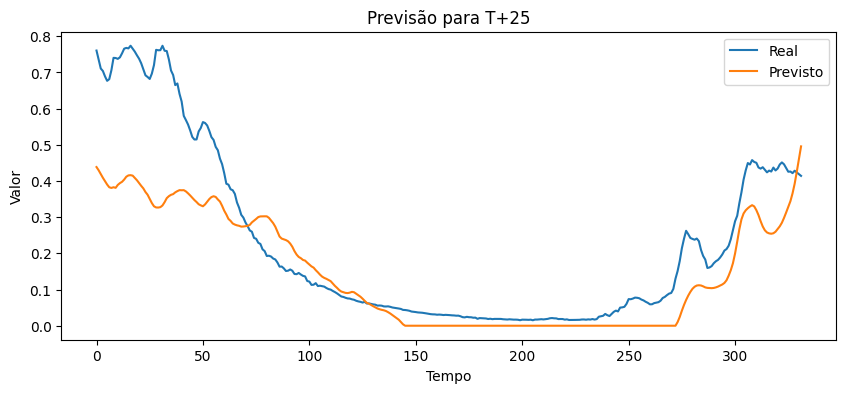

Horizonte 26: MSE = 0.018, RMSE = 0.132, R² = 0.696


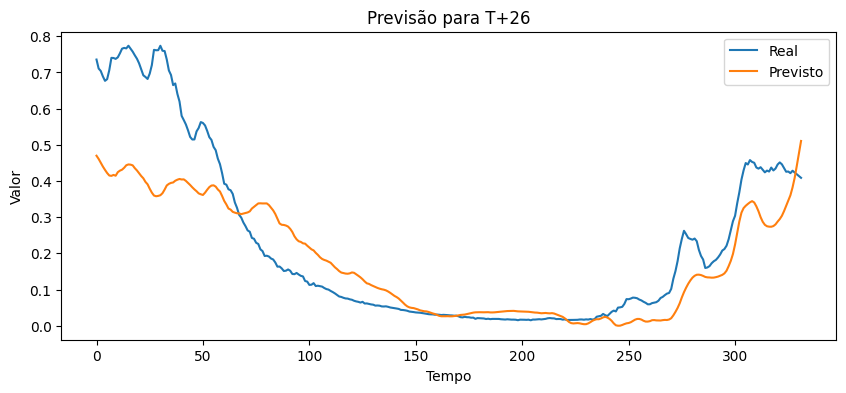

Horizonte 27: MSE = 0.021, RMSE = 0.145, R² = 0.632


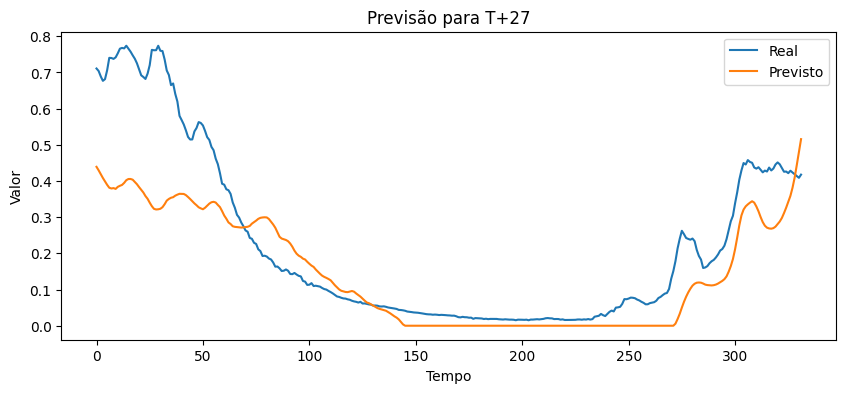

Horizonte 28: MSE = 0.020, RMSE = 0.143, R² = 0.637


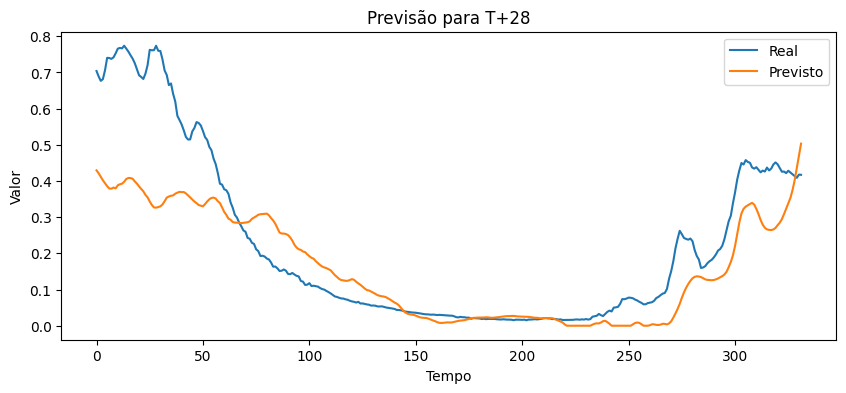

Horizonte 29: MSE = 0.021, RMSE = 0.144, R² = 0.629


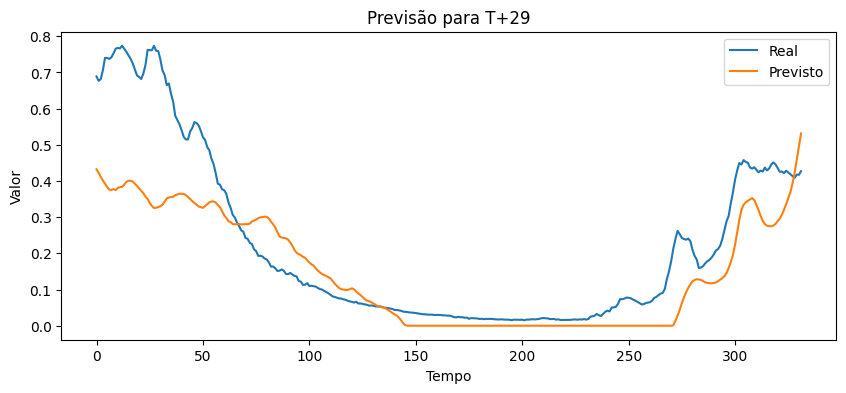

Horizonte 30: MSE = 0.021, RMSE = 0.146, R² = 0.613


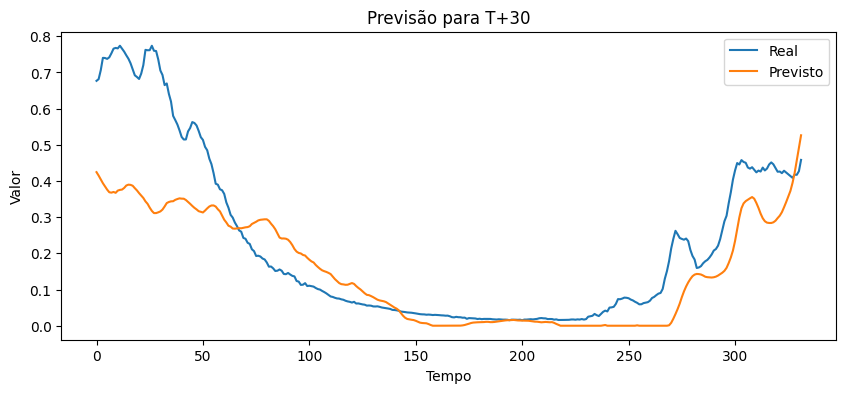

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense
from sklearn.metrics import mean_squared_error, r2_score
from keras.callbacks import EarlyStopping
from math import sqrt

# Função modificada para criar dados
def create_data(df, max_future, n_past, train_test_split_percentage, validation_split_percentage):
    n_feature = df.shape[1]
    x_data, y_data = [], []

    for i in range(n_past, len(df) - max_future + 1):
        x_data.append(df[i - n_past:i, 0:n_feature])
        y_data.append([df[j, 0] for j in range(i, i + max_future)])

    split_training_test_starting_point = int(round(train_test_split_percentage * len(x_data)))
    split_train_validation_starting_point = int(round(split_training_test_starting_point * (1 - validation_split_percentage)))

    x_train = x_data[:split_train_validation_starting_point]
    y_train = y_data[:split_train_validation_starting_point]

    x_val = x_data[split_train_validation_starting_point:split_training_test_starting_point]
    y_val = y_data[split_train_validation_starting_point:split_training_test_starting_point]

    x_test = x_data[split_training_test_starting_point:]
    y_test = y_data[split_training_test_starting_point:]

    return np.array(x_train), np.array(x_test), np.array(x_val), np.array(y_train), np.array(y_test), np.array(y_val)

# Parâmetros
n_future = 30  # Número de dias que você deseja prever no futuro
n_past = 720   # Número de dias passados que você deseja usar para prever o futuro

# Supondo que 'features_scaled' é seu DataFrame pré-processado
X_train, X_test, X_val, y_train, y_test, y_val = create_data(features_scaled, n_future, n_past, 0.7, 0.3)

# Modelo LSTM
regressor = Sequential()
regressor.add(LSTM(units=256, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
# regressor.add(LSTM(units=256, return_sequences=True))
# regressor.add(Dropout(0.2))
regressor.add(GRU(units=256, return_sequences=False))
regressor.add(Dropout(0.2))
# regressor.add(LSTM(units=64, return_sequences=False))
# regressor.add(Dropout(0.2))
regressor.add(Dense(units=n_future, activation='relu'))
# regressor.add(Dense(units=n_future, activation='linear'))
regressor.compile(optimizer='adam', loss='mse')

# Callbacks
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=5)

# Treinamento
history = regressor.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=40, batch_size=8, callbacks=[es])

# Avaliação e Visualização
y_pred = regressor.predict(X_test)

for i in range(n_future):
    y_true = y_test[:, i]
    y_pred_i = y_pred[:, i]

    mse = mean_squared_error(y_true, y_pred_i)
    rmse = sqrt(mse)
    r2 = r2_score(y_true, y_pred_i)

    print(f'Horizonte {i+1}: MSE = {mse:.3f}, RMSE = {rmse:.3f}, R² = {r2:.3f}')

    plt.figure(figsize=(10, 4))
    plt.plot(y_true, label='Real')
    plt.plot(y_pred_i, label='Previsto')
    plt.title(f'Previsão para T+{i+1}')
    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()


In [14]:
import os
import warnings
import sys

import pandas as pd
from matplotlib import pyplot as plt
import datetime
import pylab as pl
import numpy as np
from sklearn import linear_model
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import Ridge
from math import sqrt
from urllib.parse import urlparse
from sqlalchemy import create_engine
import logging

from pandas import read_csv
from keras.models import Sequential
from keras.layers import *
from sklearn.preprocessing import MinMaxScaler
import math

from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import GradientBoostingRegressor
from scipy.stats import uniform as sp_randFloat
from scipy.stats import randint as sp_randInt

import tensorflow as tf
# tf.config.experimental.set_memory_growth(tf.config.list_physical_devices('GPU')[0], True)

logging.basicConfig(level=logging.WARN)
logger = logging.getLogger(__name__)

df = pd.read_csv('/content/rdh_database_EAR.csv')

del df['id_ft_rdh']
del df['nome_arquivo']
del df['data_criacao']
del df['data_atualizacao']
df.fillna(0, inplace=True)
df['id_tempo']=  pd.to_datetime(df['id_tempo'],format='%Y%m%d').dt.date

df_tucurui = df[(df.id_posto == 275)]
df_tucurui

import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score
from keras.models import Sequential
from keras.callbacks import EarlyStopping
from math import sqrt
from keras.optimizers import Adam

df = df_tucurui

del df['id_tempo']
del df['id_posto']
df.reset_index(drop=True, inplace=True)

features = df.drop(columns=['volume_armazenado'])
target = df['volume_armazenado']

scaler = MinMaxScaler()
features_scaled = scaler.fit_transform(features)
df

import numpy as np
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense
from sklearn.metrics import mean_squared_error, r2_score
from keras.callbacks import EarlyStopping
from math import sqrt

# Função modificada para criar dados
def create_data(df, max_future, n_past, train_test_split_percentage, validation_split_percentage):
    n_feature = df.shape[1]
    x_data, y_data = [], []

    for i in range(n_past, len(df) - max_future + 1):
        x_data.append(df[i - n_past:i, 0:n_feature])
        y_data.append([df[j, 0] for j in range(i, i + max_future)])

    split_training_test_starting_point = int(round(train_test_split_percentage * len(x_data)))
    split_train_validation_starting_point = int(round(split_training_test_starting_point * (1 - validation_split_percentage)))

    x_train = x_data[:split_train_validation_starting_point]
    y_train = y_data[:split_train_validation_starting_point]

    x_val = x_data[split_train_validation_starting_point:split_training_test_starting_point]
    y_val = y_data[split_train_validation_starting_point:split_training_test_starting_point]

    x_test = x_data[split_training_test_starting_point:]
    y_test = y_data[split_training_test_starting_point:]

    return np.array(x_train), np.array(x_test), np.array(x_val), np.array(y_train), np.array(y_test), np.array(y_val)

# Parâmetros
n_future = 30  # Número de dias que você deseja prever no futuro
n_past = 720   # Número de dias passados que você deseja usar para prever o futuro

# Supondo que 'features_scaled' é seu DataFrame pré-processado
X_train, X_test, X_val, y_train, y_test, y_val = create_data(features_scaled, n_future, n_past, 0.7, 0.3)

# Ajustar as dimensões de X_train e X_test para regressão linear
X_train_linear = X_train.reshape(X_train.shape[0], -1)
X_test_linear = X_test.reshape(X_test.shape[0], -1)

# Regressão Linear com Regularização Ridge
ridge_regressor = Ridge(alpha=1.0)
ridge_regressor.fit(X_train_linear, y_train)

y_pred_linear = ridge_regressor.predict(X_test_linear)

# Métricas para a Regressão Linear
for i in range(n_future):
    mse_linear = mean_squared_error(y_test[:, i], y_pred_linear[:, i])
    rmse_linear = sqrt(mse_linear)
    r2_linear = r2_score(y_test[:, i], y_pred_linear[:, i])
    print(f'Regressão Linear (Ridge) para T+{i+1}: MSE = {mse_linear:.3f}, RMSE = {rmse_linear:.3f}, R² = {r2_linear:.3f}')


Regressão Linear (Ridge) para T+1: MSE = 0.026, RMSE = 0.161, R² = 0.641
Regressão Linear (Ridge) para T+2: MSE = 0.027, RMSE = 0.164, R² = 0.624
Regressão Linear (Ridge) para T+3: MSE = 0.034, RMSE = 0.185, R² = 0.520
Regressão Linear (Ridge) para T+4: MSE = 0.031, RMSE = 0.175, R² = 0.572
Regressão Linear (Ridge) para T+5: MSE = 0.036, RMSE = 0.190, R² = 0.494
Regressão Linear (Ridge) para T+6: MSE = 0.035, RMSE = 0.187, R² = 0.508
Regressão Linear (Ridge) para T+7: MSE = 0.035, RMSE = 0.186, R² = 0.511
Regressão Linear (Ridge) para T+8: MSE = 0.035, RMSE = 0.186, R² = 0.508
Regressão Linear (Ridge) para T+9: MSE = 0.036, RMSE = 0.191, R² = 0.480
Regressão Linear (Ridge) para T+10: MSE = 0.042, RMSE = 0.206, R² = 0.395
Regressão Linear (Ridge) para T+11: MSE = 0.043, RMSE = 0.207, R² = 0.380
Regressão Linear (Ridge) para T+12: MSE = 0.042, RMSE = 0.204, R² = 0.397
Regressão Linear (Ridge) para T+13: MSE = 0.041, RMSE = 0.202, R² = 0.401
Regressão Linear (Ridge) para T+14: MSE = 0.040

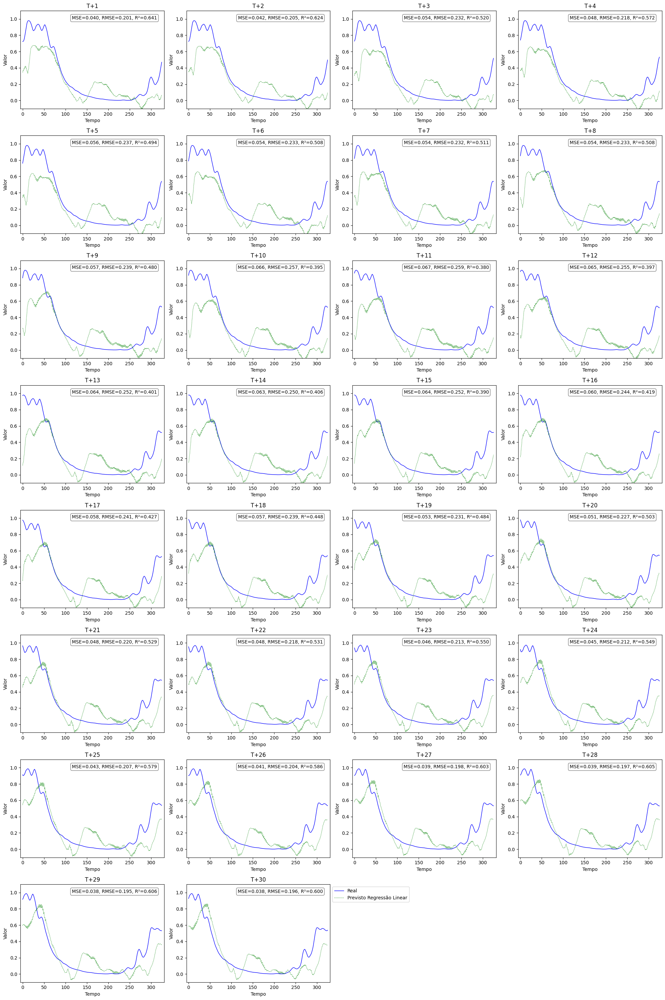

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt
from sklearn.preprocessing import MinMaxScaler

# Função para calcular a média móvel
def moving_average(data, window_size):
    return np.convolve(data, np.ones(window_size), 'valid') / window_size

# Garantir que os dados estejam normalizados corretamente entre 0 e 1
scaler = MinMaxScaler(feature_range=(0, 1))
y_test_scaled = scaler.fit_transform(y_test)
y_pred_linear_scaled = scaler.transform(y_pred_linear)

# Parâmetros da média móvel
window_size = 7  # Ajuste o tamanho da janela conforme necessário

# Número de linhas e colunas para os subplots
n_rows = 8
n_cols = 4
n_future = 30  # Número total de dias que você está prevendo

# Cria uma figura grande para acomodar todos os subplots
plt.figure(figsize=(20, 30))

# Itera sobre cada horizonte de tempo e cria um subplot para cada um
for i in range(n_future):
    ax = plt.subplot(n_rows, n_cols, i+1)

    # Suaviza as previsões usando média móvel
    y_test_smooth = moving_average(y_test_scaled[:, i], window_size)
    y_pred_linear_smooth = moving_average(y_pred_linear_scaled[:, i], window_size)

    # Ajusta os índices das séries suavizadas para se alinharem corretamente no gráfico
    x_vals = range(len(y_test_smooth))

    plt.plot(x_vals, y_test_smooth, label='Real', color='blue', linewidth=1)
    plt.plot(x_vals, y_pred_linear_smooth, label='Previsto Regressão Linear', color='green', linestyle='dotted', linewidth=1)

    plt.ylim(-0.1, 1.1)  # Adiciona margem ao eixo y
    plt.xlim(-5, len(x_vals) + 5)  # Adiciona margem ao eixo x
    plt.title(f'T+{i+1}')

    # Calcula as métricas para cada horizonte de tempo
    mse_linear = mean_squared_error(y_test_scaled[:, i], y_pred_linear_scaled[:, i])
    rmse_linear = sqrt(mse_linear)
    r2_linear = r2_score(y_test_scaled[:, i], y_pred_linear_scaled[:, i])

    # Adiciona as métricas como texto no gráfico
    ax.text(0.95, 0.95, f'MSE={mse_linear:.3f}, RMSE={rmse_linear:.3f}, R²={r2_linear:.3f}',
            transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.tight_layout()

plt.legend(loc='upper left', bbox_to_anchor=(1,1))
plt.show()


In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# for i in range(n_future):
#     y_true = y_test[:, i]
#     y_pred_i = y_pred_linear[:, i]

#     mse = mean_squared_error(y_true, y_pred_i)
#     rmse = sqrt(mse)
#     r2 = r2_score(y_true, y_pred_i)

#     print(f'Horizonte {i+1}: MSE = {mse:.3f}, RMSE = {rmse:.3f}, R² = {r2:.3f}')

#     plt.figure(figsize=(10, 4))
#     plt.plot(y_true, label='Real')
#     plt.plot(y_pred_i, label='Previsto')
#     plt.title(f'Previsão para T+{i+1}')
#     plt.xlabel('Tempo')
#     plt.ylabel('Valor')
#     plt.legend()
#     plt.show()


In [ ]:
# import numpy as np
# import matplotlib.pyplot as plt

# # Função para calcular a média móvel
# def moving_average(data, window_size):
#     return np.convolve(data, np.ones(window_size), 'valid') / window_size

# # Parâmetros da média móvel
# window_size = 7  # Ajuste o tamanho da janela conforme necessário

# # Número de linhas e colunas para os subplots
# n_rows = 6
# n_cols = 5
# n_future = 30  # Número total de dias que você está prevendo

# # Cria uma figura grande para acomodar todos os subplots
# plt.figure(figsize=(20, 15))

# # Itera sobre cada horizonte de tempo e cria um subplot para cada um
# for i in range(n_future):
#     ax = plt.subplot(n_rows, n_cols, i+1)

#     # Suaviza as previsões usando média móvel
#     y_test_smooth = moving_average(y_test[:, i], window_size)
#     y_pred_smooth = moving_average(y_pred[:, i], window_size)
#     y_pred_linear_smooth = moving_average(y_pred_linear[:, i], window_size)

#     # Ajusta os índices das séries suavizadas para se alinharem corretamente no gráfico
#     x_vals = range(len(y_test_smooth))

#     plt.plot(x_vals, y_test_smooth, label='Real', color='blue', linewidth=1)
#     plt.plot(x_vals, y_pred_smooth, label='Previsto LSTM', color='red', linestyle='dashed', linewidth=1)

#     if i < y_pred_linear_smooth.shape[0]:
#         plt.plot(x_vals, y_pred_linear_smooth, label='Previsto Regressão Linear', color='green', linestyle='dotted', linewidth=1)

#     plt.title(f'T+{i+1}')

#     # Calcula as métricas para cada horizonte de tempo
#     mse = mean_squared_error(y_test[:, i], y_pred[:, i])
#     rmse = sqrt(mse)
#     r2 = r2_score(y_test[:, i], y_pred[:, i])

#     # Adiciona as métricas como texto no gráfico
#     ax.text(0.95, 0.95, f'MSE: {mse:.3f}\nRMSE: {rmse:.3f}\nR²: {r2:.3f}',
#             transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
#             bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

#     plt.xlabel('Tempo')
#     plt.ylabel('Valor')
#     plt.tight_layout()

# plt.legend(loc='upper left', bbox_to_anchor=(1,1))
# plt.show()


In [ ]:
!pip install python-math

Epoch 1/40
68/68 [==============================] - 8s 65ms/step - loss: 0.0415 - val_loss: 0.0211
Epoch 2/40
68/68 [==============================] - 4s 56ms/step - loss: 0.0229 - val_loss: 0.0280
Epoch 3/40
68/68 [==============================] - 4s 57ms/step - loss: 0.0217 - val_loss: 0.0367
Epoch 4/40
68/68 [==============================] - 4s 55ms/step - loss: 0.0186 - val_loss: 0.0264
Epoch 5/40
68/68 [==============================] - 4s 55ms/step - loss: 0.0174 - val_loss: 0.0301
Epoch 6/40
68/68 [==============================] - 4s 55ms/step - loss: 0.0192 - val_loss: 0.0269
Epoch 6: early stopping
11/11 [==============================] - 1s 19ms/step
Horizonte 1: MSE = 0.001, RMSE = 0.034, R² = 0.984


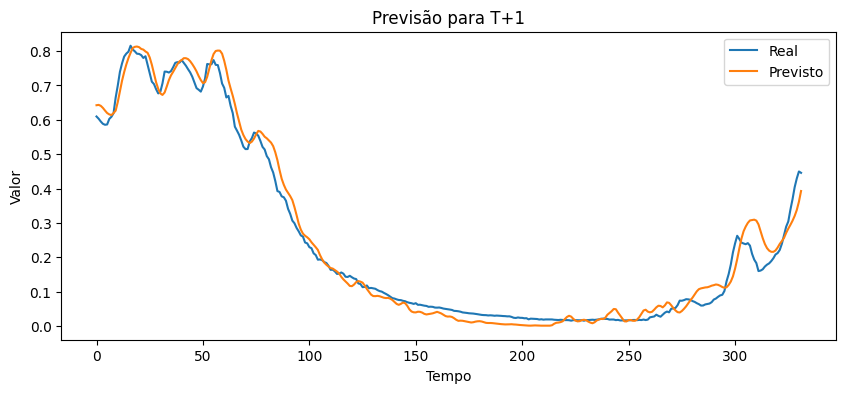

Horizonte 2: MSE = 0.001, RMSE = 0.037, R² = 0.980


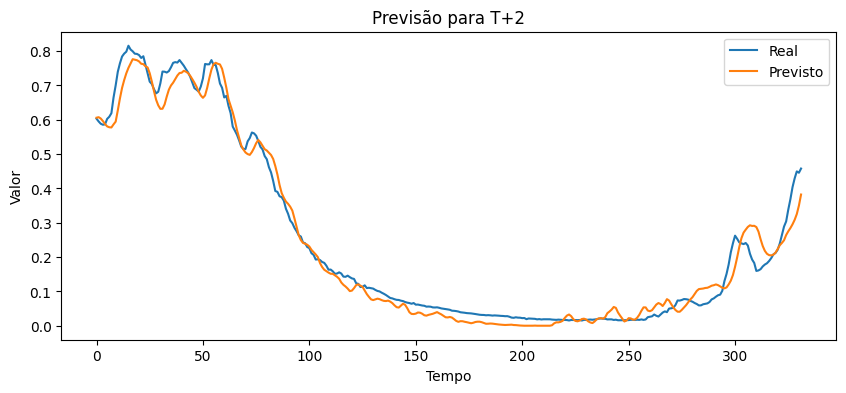

Horizonte 3: MSE = 0.002, RMSE = 0.046, R² = 0.970


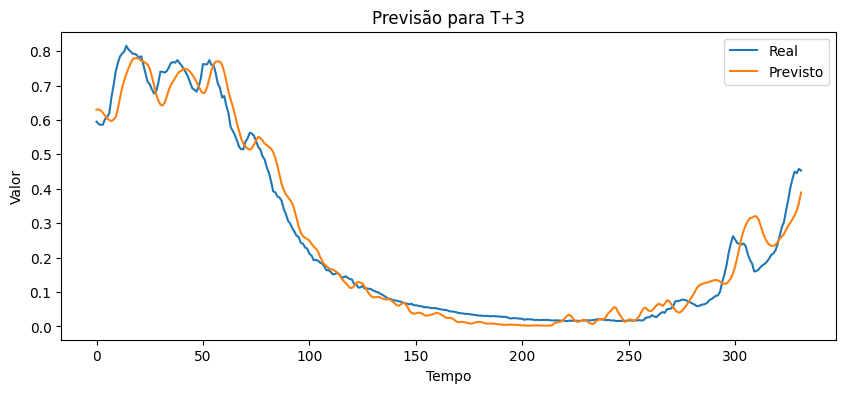

Horizonte 4: MSE = 0.003, RMSE = 0.054, R² = 0.959


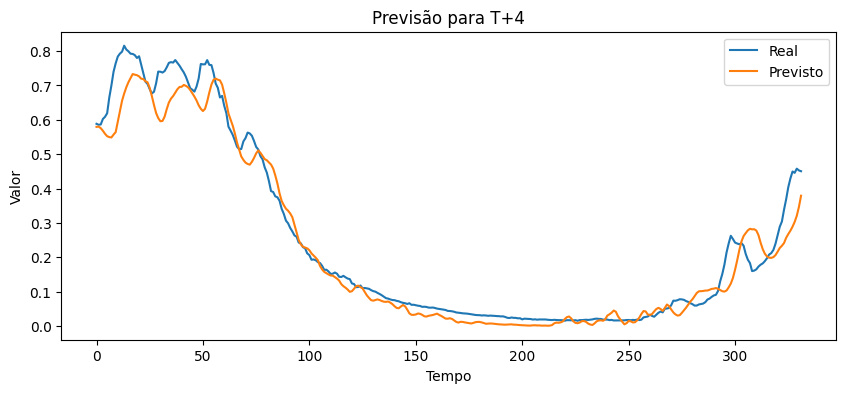

Horizonte 5: MSE = 0.004, RMSE = 0.059, R² = 0.950


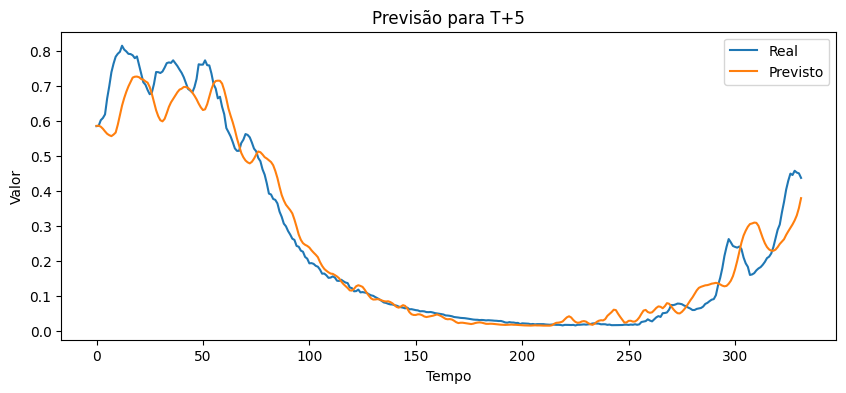

Horizonte 6: MSE = 0.005, RMSE = 0.070, R² = 0.931


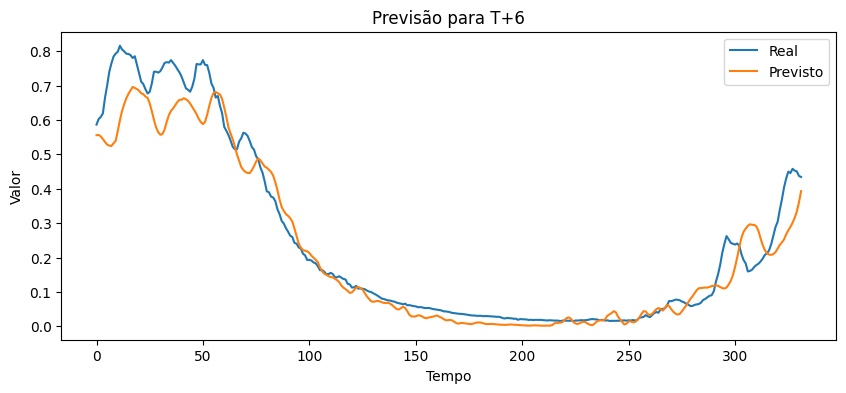

Horizonte 7: MSE = 0.004, RMSE = 0.065, R² = 0.940


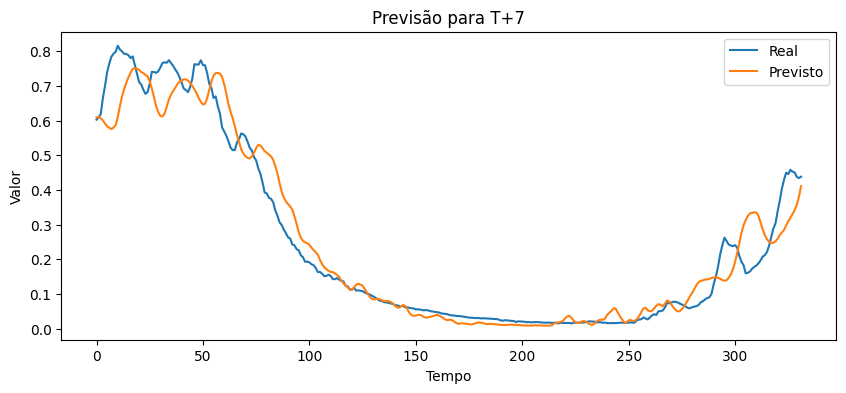

Horizonte 8: MSE = 0.006, RMSE = 0.079, R² = 0.911


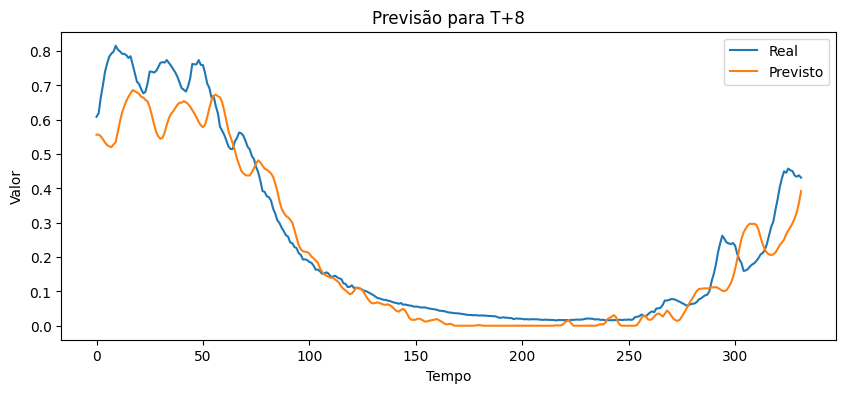

Horizonte 9: MSE = 0.007, RMSE = 0.084, R² = 0.900


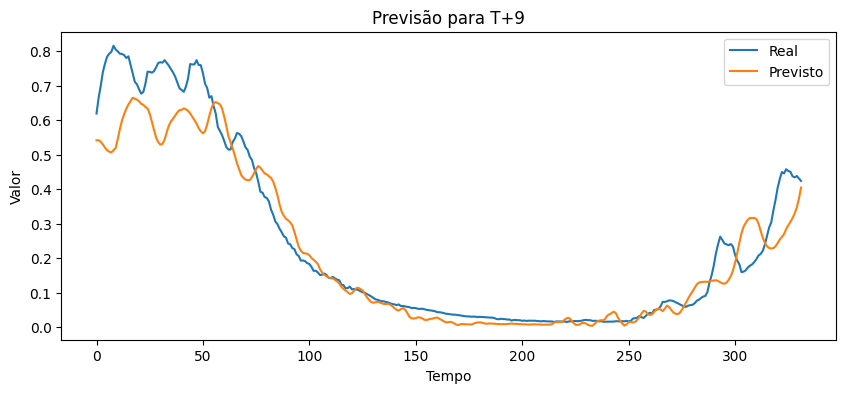

Horizonte 10: MSE = 0.009, RMSE = 0.096, R² = 0.869


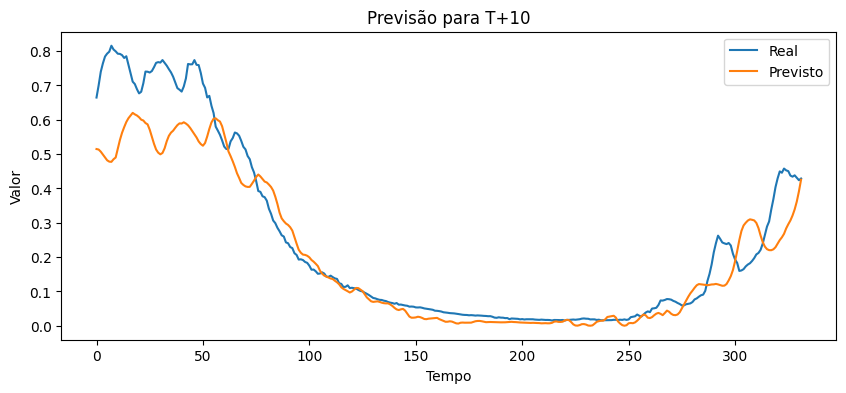

Horizonte 11: MSE = 0.010, RMSE = 0.100, R² = 0.855


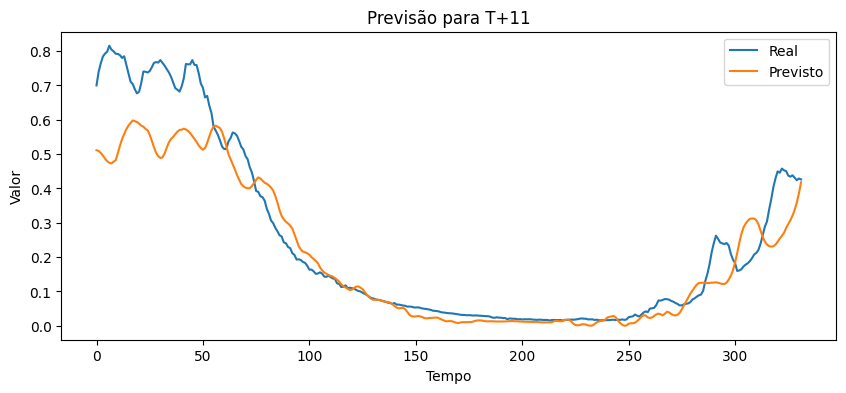

Horizonte 12: MSE = 0.011, RMSE = 0.105, R² = 0.839


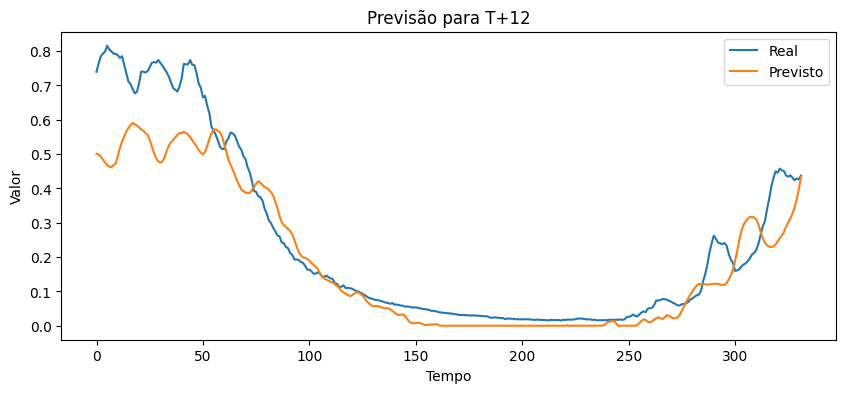

Horizonte 13: MSE = 0.014, RMSE = 0.117, R² = 0.798


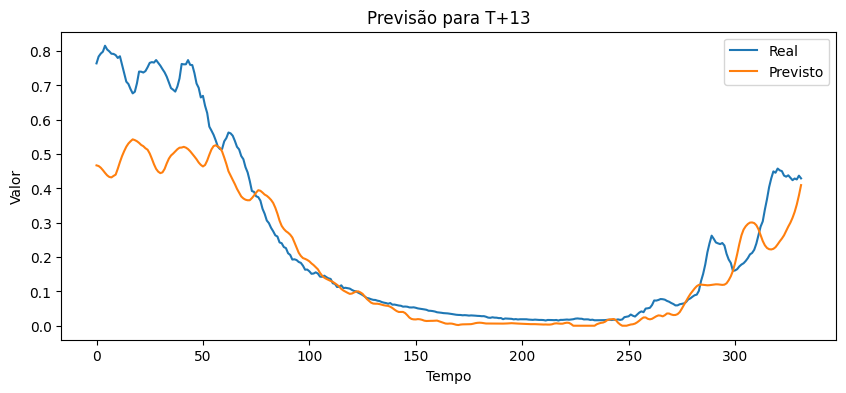

Horizonte 14: MSE = 0.014, RMSE = 0.119, R² = 0.790


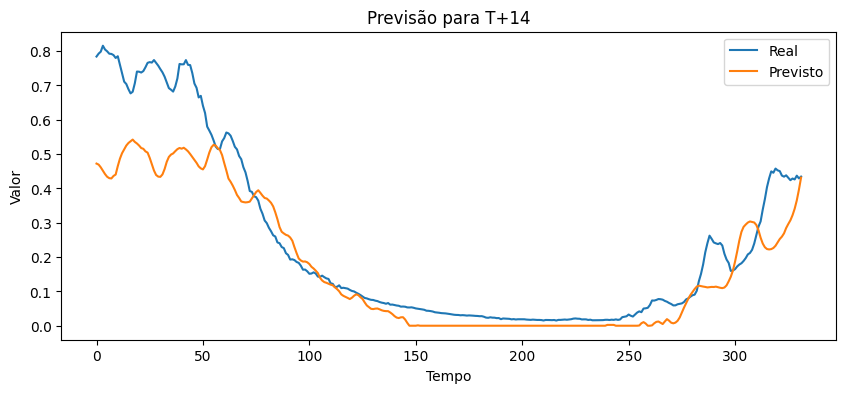

Horizonte 15: MSE = 0.014, RMSE = 0.116, R² = 0.797


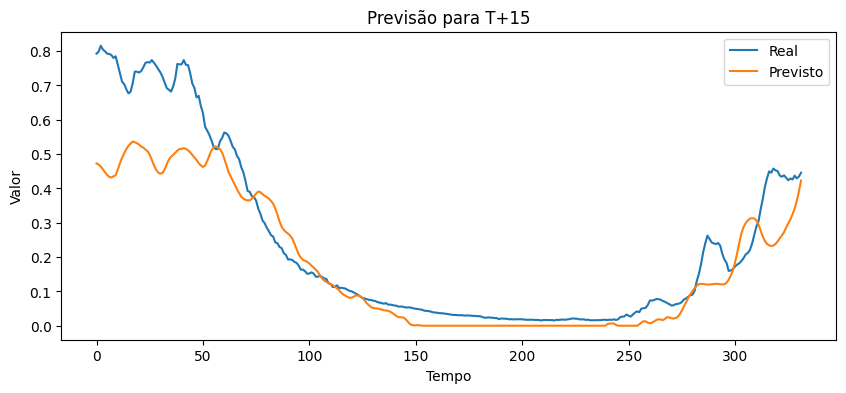

Horizonte 16: MSE = 0.013, RMSE = 0.115, R² = 0.800


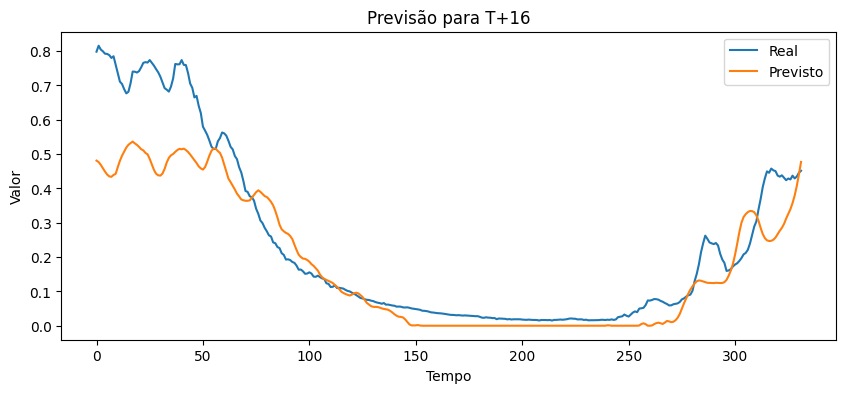

Horizonte 17: MSE = 0.012, RMSE = 0.111, R² = 0.812


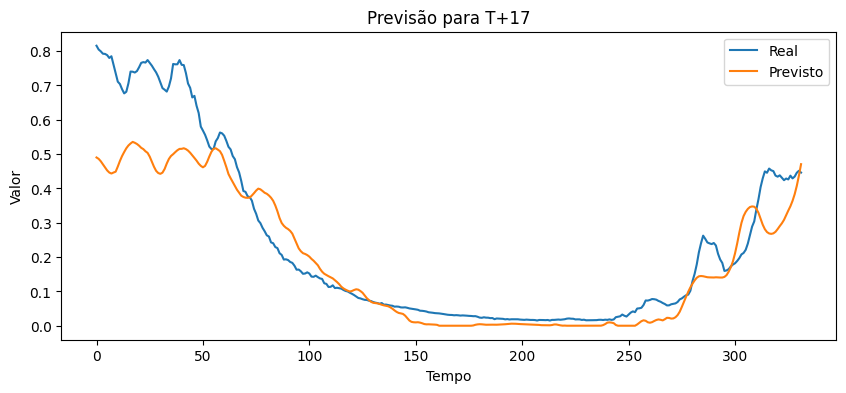

Horizonte 18: MSE = 0.015, RMSE = 0.121, R² = 0.771


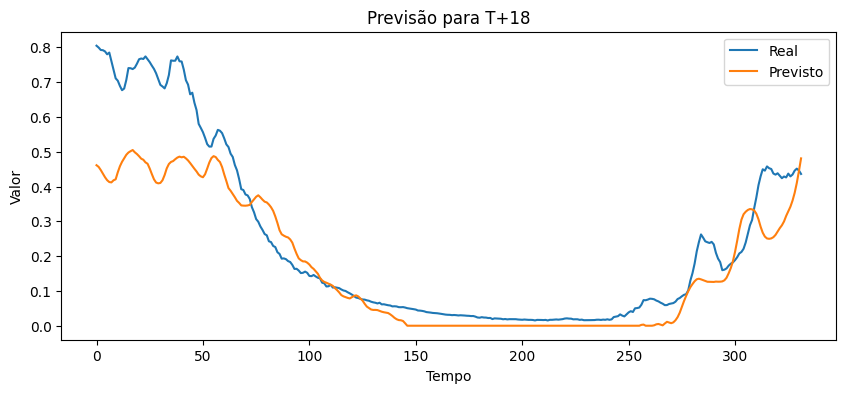

Horizonte 19: MSE = 0.013, RMSE = 0.116, R² = 0.788


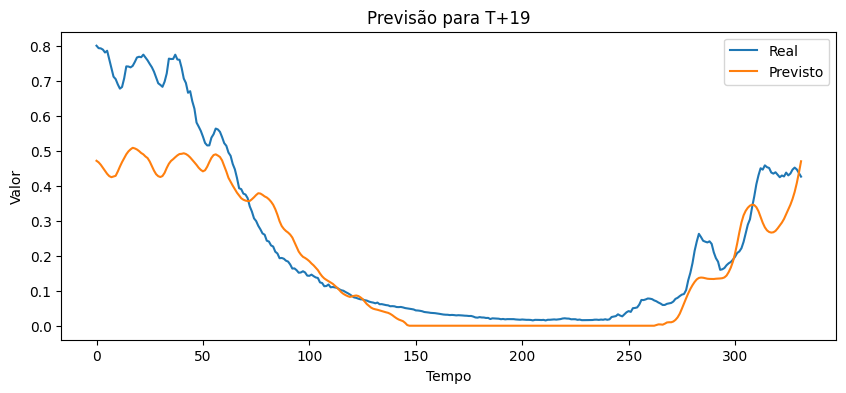

Horizonte 20: MSE = 0.015, RMSE = 0.124, R² = 0.755


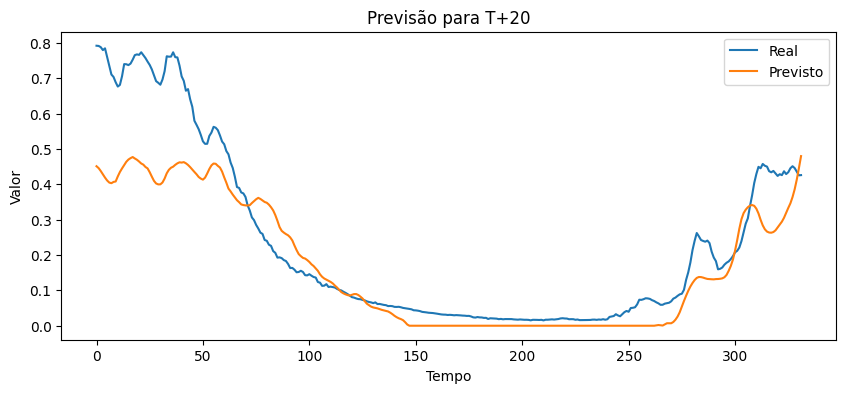

Horizonte 21: MSE = 0.017, RMSE = 0.129, R² = 0.730


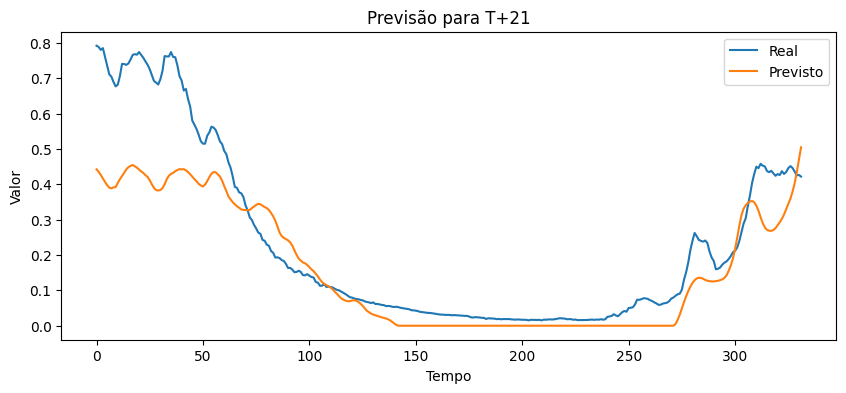

Horizonte 22: MSE = 0.017, RMSE = 0.129, R² = 0.726


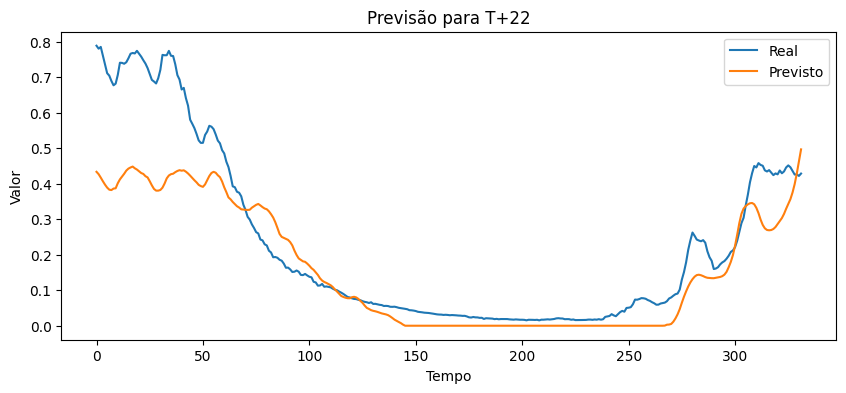

Horizonte 23: MSE = 0.020, RMSE = 0.140, R² = 0.674


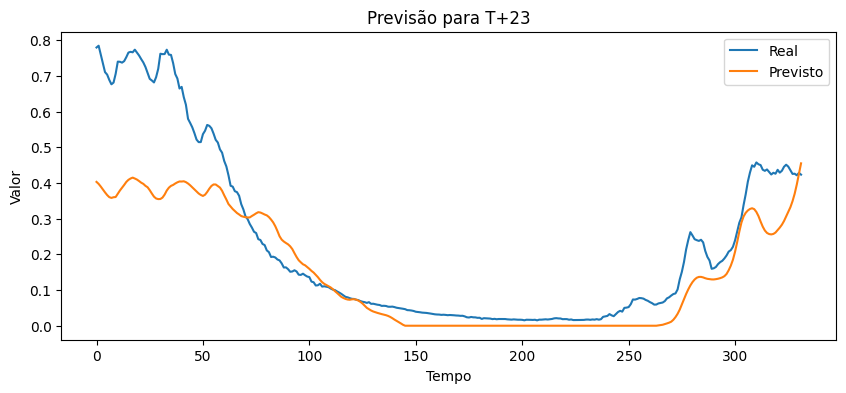

Horizonte 24: MSE = 0.017, RMSE = 0.132, R² = 0.708


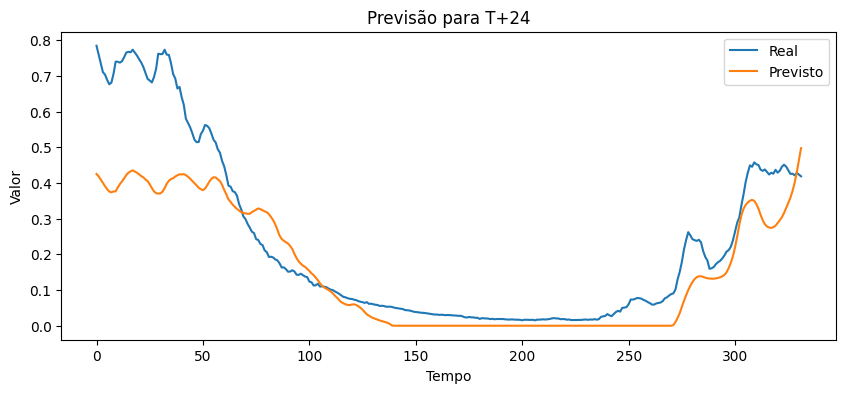

Horizonte 25: MSE = 0.019, RMSE = 0.138, R² = 0.673


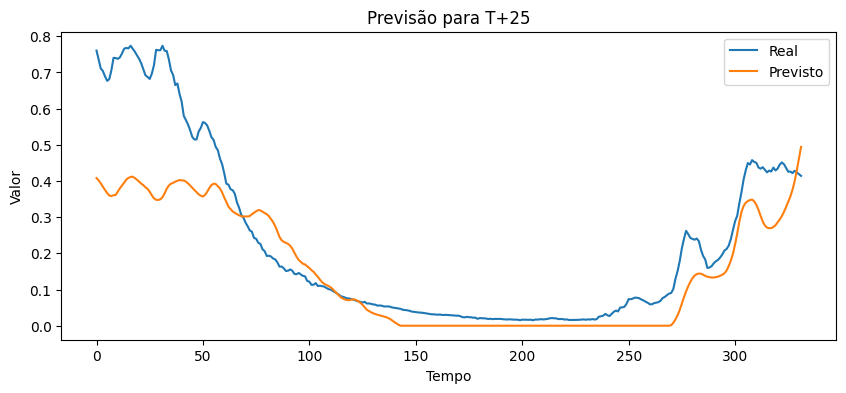

Horizonte 26: MSE = 0.024, RMSE = 0.154, R² = 0.591


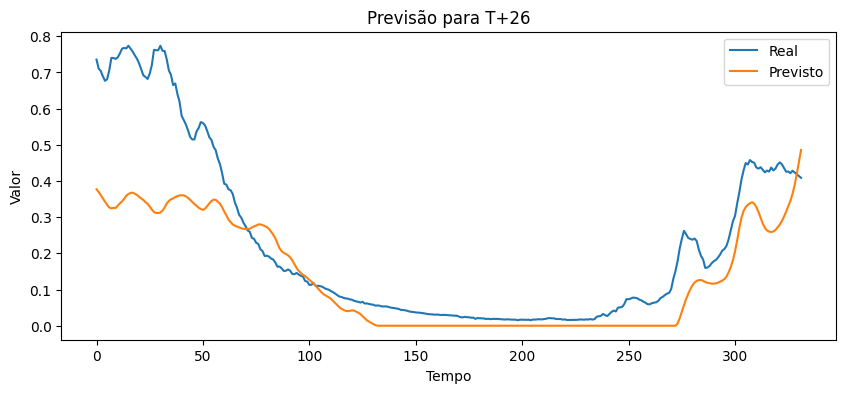

Horizonte 27: MSE = 0.019, RMSE = 0.139, R² = 0.659


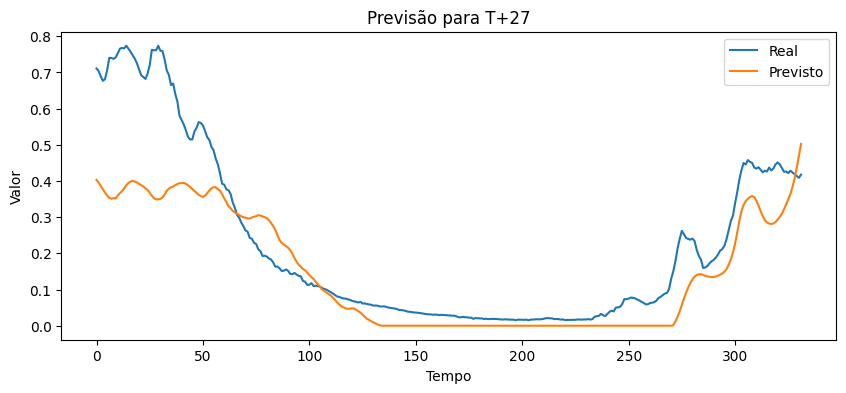

Horizonte 28: MSE = 0.024, RMSE = 0.154, R² = 0.577


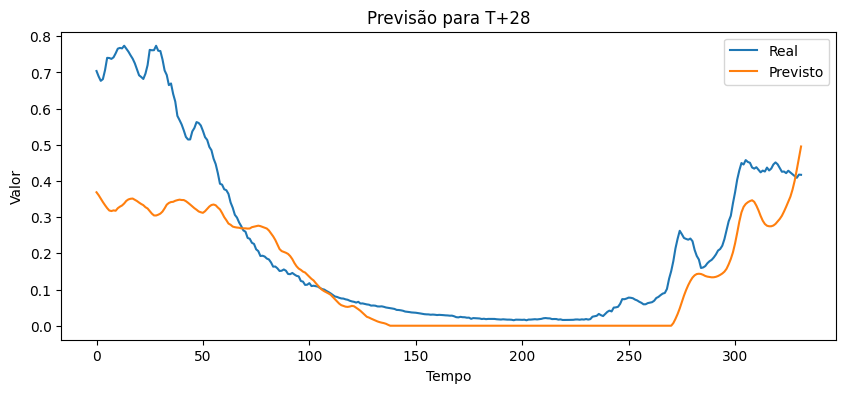

Horizonte 29: MSE = 0.021, RMSE = 0.146, R² = 0.621


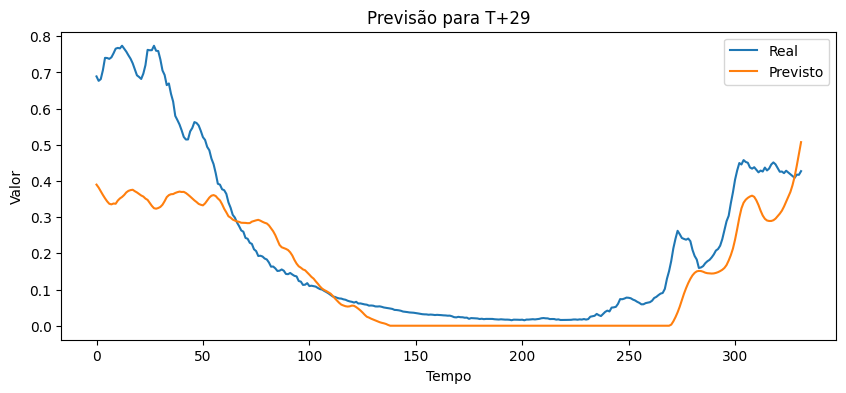

Horizonte 30: MSE = 0.025, RMSE = 0.158, R² = 0.547


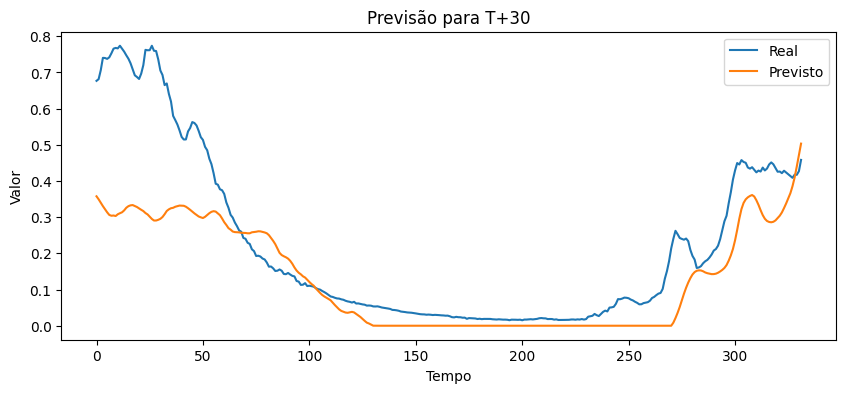

In [ ]:
# Modelo LSTM
regressor = Sequential()
regressor.add(LSTM(units=256, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
# regressor.add(LSTM(units=256, return_sequences=True))
# regressor.add(Dropout(0.2))
regressor.add(GRU(units=256, return_sequences=False))
regressor.add(Dropout(0.2))
# regressor.add(LSTM(units=64, return_sequences=False))
# regressor.add(Dropout(0.2))
regressor.add(Dense(units=n_future, activation='relu'))
# regressor.add(Dense(units=n_future, activation='linear'))
regressor.compile(optimizer='adam', loss='mse')

# Callbacks
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=5)

# Treinamento
history = regressor.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=40, batch_size=8, callbacks=[es])

# Avaliação e Visualização
y_pred = regressor.predict(X_test)

for i in range(n_future):
    y_true = y_test[:, i]
    y_pred_i = y_pred[:, i]

    mse = mean_squared_error(y_true, y_pred_i)
    rmse = sqrt(mse)
    r2 = r2_score(y_true, y_pred_i)

    print(f'Horizonte {i+1}: MSE = {mse:.3f}, RMSE = {rmse:.3f}, R² = {r2:.3f}')

    plt.figure(figsize=(10, 4))
    plt.plot(y_true, label='Real')
    plt.plot(y_pred_i, label='Previsto')
    plt.title(f'Previsão para T+{i+1}')
    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()


In [ ]:
# # Número de linhas e colunas para os subplots
# n_rows = 5
# n_cols = 6
# n_future = 30  # Número total de dias que você está prevendo

# # Cria uma figura grande para acomodar todos os subplots
# plt.figure(figsize=(20, 15))

# # Itera sobre cada horizonte de tempo e cria um subplot para cada um
# for i in range(n_future):
#     ax = plt.subplot(n_rows, n_cols, i+1)
#     plt.plot(y_test[:, i], label='Real', color='blue', linewidth=1)
#     plt.plot(y_pred[:, i], label='Previsto LSTM', color='red', linestyle='dashed', linewidth=1)

#     if i < y_pred_linear.shape[1]:
#         plt.plot(y_pred_linear[:, i], label='Previsto Regressão Linear', color='green', linestyle='dotted', linewidth=1)

#     plt.title(f'T+{i+1}')

#     # Calcula as métricas para cada horizonte de tempo
#     mse = mean_squared_error(y_test[:, i], y_pred[:, i])
#     rmse = sqrt(mse)
#     r2 = r2_score(y_test[:, i], y_pred[:, i])

#     # Adiciona as métricas como texto no gráfico
#     ax.text(0.95, 0.95, f'MSE: {mse:.3f}\nRMSE: {rmse:.3f}\nR²: {r2:.3f}',
#             transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
#             bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

#     plt.xlabel('Tempo')
#     plt.ylabel('Valor')
#     plt.tight_layout()

# plt.legend(loc='upper left', bbox_to_anchor=(1,1))
# plt.show()


In [ ]:
import warnings
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tools.sm_exceptions import ConvergenceWarning

# Ignorar avisos de convergência para evitar saída excessiva
warnings.filterwarnings("ignore", category=ConvergenceWarning)

# Função para treinar e prever usando SARIMAX
def train_and_predict_sarimax(train, test, order):
    history = [x for x in train]
    predictions = list()
    for t in range(len(test)):
        model = SARIMAX(history, order=order)
        model_fit = model.fit(disp=False)
        output = model_fit.forecast()
        yhat = output[0]
        predictions.append(yhat)
        obs = test[t]
        history.append(obs)
    return predictions

# Parâmetros do modelo SARIMAX (ajuste conforme necessário)
sarimax_order = (2, 1, 2)

# Previsões SARIMAX para cada horizonte de tempo
y_pred_arima = np.zeros_like(y_test)
for i in range(n_future):
    y_train_arima = y_train[:, i]
    y_test_arima = y_test[:, i]
    y_pred_arima[:, i] = train_and_predict_sarimax(y_train_arima, y_test_arima, sarimax_order)

# Não é necessário rescalar as previsões de volta à escala original se o SARIMAX está operando na mesma escala
# Métricas para o Modelo SARIMAX
for i in range(n_future):
    mse_arima = mean_squared_error(y_test[:, i], y_pred_arima[:, i])
    rmse_arima = sqrt(mse_arima)
    r2_arima = r2_score(y_test[:, i], y_pred_arima[:, i])
    print(f'Modelo ARIMA (SARIMAX) para T+{i+1}: MSE = {mse_arima:.3f}, RMSE = {rmse_arima:.3f}, R² = {r2_arima:.3f}')


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


Modelo ARIMA (SARIMAX) para T+1: MSE = 0.001, RMSE = 0.039, R² = 0.979
Modelo ARIMA (SARIMAX) para T+2: MSE = 0.001, RMSE = 0.038, R² = 0.980
Modelo ARIMA (SARIMAX) para T+3: MSE = 0.001, RMSE = 0.038, R² = 0.980
Modelo ARIMA (SARIMAX) para T+4: MSE = 0.001, RMSE = 0.038, R² = 0.980
Modelo ARIMA (SARIMAX) para T+5: MSE = 0.001, RMSE = 0.038, R² = 0.980
Modelo ARIMA (SARIMAX) para T+6: MSE = 0.001, RMSE = 0.038, R² = 0.979
Modelo ARIMA (SARIMAX) para T+7: MSE = 0.002, RMSE = 0.039, R² = 0.978
Modelo ARIMA (SARIMAX) para T+8: MSE = 0.002, RMSE = 0.039, R² = 0.978
Modelo ARIMA (SARIMAX) para T+9: MSE = 0.002, RMSE = 0.041, R² = 0.976
Modelo ARIMA (SARIMAX) para T+10: MSE = 0.001, RMSE = 0.030, R² = 0.987
Modelo ARIMA (SARIMAX) para T+11: MSE = 0.001, RMSE = 0.038, R² = 0.980
Modelo ARIMA (SARIMAX) para T+12: MSE = 0.002, RMSE = 0.048, R² = 0.966
Modelo ARIMA (SARIMAX) para T+13: MSE = 0.003, RMSE = 0.051, R² = 0.961
Modelo ARIMA (SARIMAX) para T+14: MSE = 0.003, RMSE = 0.055, R² = 0.955
M

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


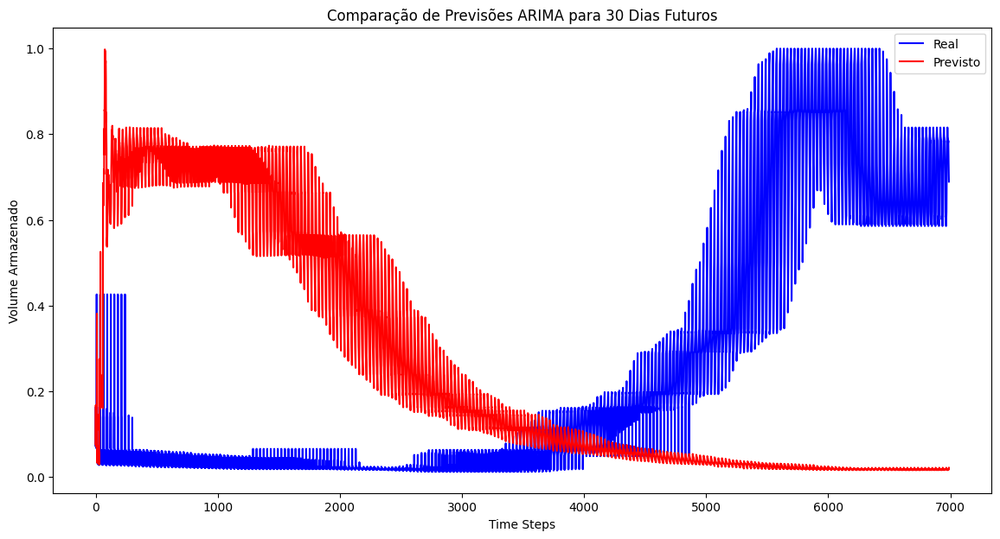

MSE: 0.275
RMSE: 0.524
R²: -1.951
Modelo ARIMA para T+1: MSE = 0.001, RMSE = 0.039, R² = 0.979
Modelo ARIMA para T+2: MSE = 0.001, RMSE = 0.038, R² = 0.980
Modelo ARIMA para T+3: MSE = 0.001, RMSE = 0.038, R² = 0.980
Modelo ARIMA para T+4: MSE = 0.001, RMSE = 0.038, R² = 0.980
Modelo ARIMA para T+5: MSE = 0.001, RMSE = 0.038, R² = 0.980
Modelo ARIMA para T+6: MSE = 0.001, RMSE = 0.038, R² = 0.979
Modelo ARIMA para T+7: MSE = 0.002, RMSE = 0.039, R² = 0.978
Modelo ARIMA para T+8: MSE = 0.002, RMSE = 0.039, R² = 0.978
Modelo ARIMA para T+9: MSE = 0.002, RMSE = 0.041, R² = 0.976
Modelo ARIMA para T+10: MSE = 0.001, RMSE = 0.030, R² = 0.987
Modelo ARIMA para T+11: MSE = 0.001, RMSE = 0.038, R² = 0.980
Modelo ARIMA para T+12: MSE = 0.002, RMSE = 0.048, R² = 0.966
Modelo ARIMA para T+13: MSE = 0.003, RMSE = 0.051, R² = 0.961
Modelo ARIMA para T+14: MSE = 0.003, RMSE = 0.055, R² = 0.955
Modelo ARIMA para T+15: MSE = 0.003, RMSE = 0.055, R² = 0.955
Modelo ARIMA para T+16: MSE = 0.003, RMSE = 0

In [16]:
import warnings
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tools.sm_exceptions import ConvergenceWarning
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt

# Ignorar avisos de convergência para evitar saída excessiva
warnings.filterwarnings("ignore", category=ConvergenceWarning)

# Função para treinar e prever usando ARIMA
def train_and_predict_arima(train, test, order):
    history = [x for x in train]
    predictions = list()
    for t in range(len(test)):
        model = ARIMA(history, order=order)
        model_fit = model.fit()
        output = model_fit.forecast()
        yhat = output[0]
        predictions.append(yhat)
        obs = test[t]
        history.append(obs)
    return predictions

# Parâmetros do modelo ARIMA (ajuste conforme necessário)
arima_order = (2, 1, 2)

# Previsões ARIMA para cada horizonte de tempo
y_pred_arima = np.zeros_like(y_test)
for i in range(n_future):
    y_train_arima = y_train[:, i]
    y_test_arima = y_test[:, i]
    y_pred_arima[:, i] = train_and_predict_arima(y_train_arima, y_test_arima, arima_order)

# Função para comparar e visualizar as previsões com os dados de validação
def compare_predictions(y_val, y_pred_arima, n_future):
    # Garantir que os comprimentos sejam consistentes
    min_len = min(len(y_val.flatten()), len(y_pred_arima.flatten()))
    y_val_flat = y_val.flatten()[:min_len]
    y_pred_flat = y_pred_arima.flatten()[:min_len]

    plt.figure(figsize=(14, 7))

    # Plotar dados reais
    plt.plot(y_val_flat, label='Real', color='blue')

    # Plotar previsões
    plt.plot(y_pred_flat, label='Previsto', color='red')

    plt.title(f'Comparação de Previsões ARIMA para {n_future} Dias Futuros')
    plt.xlabel('Time Steps')
    plt.ylabel('Volume Armazenado')
    plt.legend()
    plt.show()

    # Calcular métricas de desempenho
    mse = mean_squared_error(y_val_flat, y_pred_flat)
    rmse = sqrt(mse)
    r2 = r2_score(y_val_flat, y_pred_flat)

    print(f'MSE: {mse:.3f}')
    print(f'RMSE: {rmse:.3f}')
    print(f'R²: {r2:.3f}')

# Chamar a função de comparação
compare_predictions(y_val, y_pred_arima, n_future)

# Métricas para o Modelo ARIMA
for i in range(n_future):
    mse_arima = mean_squared_error(y_test[:, i], y_pred_arima[:, i])
    rmse_arima = sqrt(mse_arima)
    r2_arima = r2_score(y_test[:, i], y_pred_arima[:, i])
    print(f'Modelo ARIMA para T+{i+1}: MSE = {mse_arima:.3f}, RMSE = {rmse_arima:.3f}, R² = {r2_arima:.3f}')


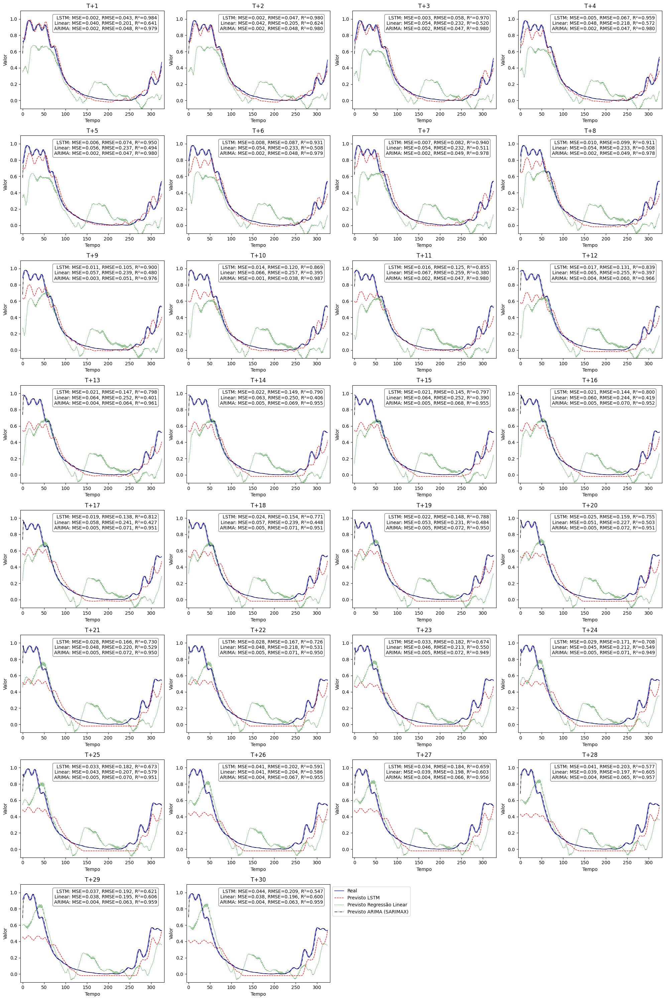

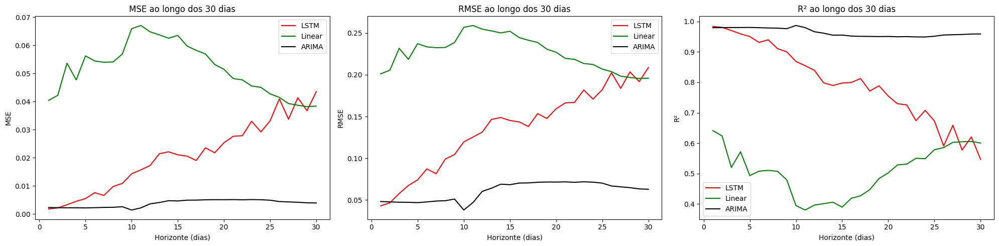

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt
from sklearn.preprocessing import MinMaxScaler

# Função para calcular a média móvel
def moving_average(data, window_size):
    return np.convolve(data, np.ones(window_size), 'valid') / window_size

# Garantir que os dados estejam normalizados corretamente entre 0 e 1
scaler = MinMaxScaler(feature_range=(0, 1))
y_test_scaled = scaler.fit_transform(y_test)
y_pred_scaled = scaler.transform(y_pred)
y_pred_linear_scaled = scaler.transform(y_pred_linear)
y_pred_arima_scaled = scaler.transform(y_pred_arima)

# Parâmetros da média móvel
window_size = 7  # Ajuste o tamanho da janela conforme necessário

# Número de linhas e colunas para os subplots
n_rows = 8
n_cols = 4
n_future = 30  # Número total de dias que você está prevendo

# Cria uma figura grande para acomodar todos os subplots
plt.figure(figsize=(20, 30))

# Itera sobre cada horizonte de tempo e cria um subplot para cada um
for i in range(n_future):
    ax = plt.subplot(n_rows, n_cols, i+1)

    # Suaviza as previsões usando média móvel
    y_test_smooth = moving_average(y_test_scaled[:, i], window_size)
    y_pred_smooth = moving_average(y_pred_scaled[:, i], window_size)
    y_pred_linear_smooth = moving_average(y_pred_linear_scaled[:, i], window_size)
    y_pred_arima_smooth = moving_average(y_pred_arima_scaled[:, i], window_size)

    # Ajusta os índices das séries suavizadas para se alinharem corretamente no gráfico
    x_vals = range(len(y_test_smooth))

    plt.plot(x_vals, y_test_smooth, label='Real', color='blue', linewidth=1)
    plt.plot(x_vals, y_pred_smooth, label='Previsto LSTM', color='red', linestyle='dashed', linewidth=1)
    plt.plot(x_vals, y_pred_linear_smooth, label='Previsto Regressão Linear', color='green', linestyle='dotted', linewidth=1)
    plt.plot(x_vals, y_pred_arima_smooth, label='Previsto ARIMA (SARIMAX)', color='black', linestyle='dashdot', linewidth=1)

    plt.ylim(-0.1, 1.1)  # Adiciona margem ao eixo y
    plt.xlim(-5, len(x_vals) + 5)  # Adiciona margem ao eixo x
    plt.title(f'T+{i+1}')

    # Calcula as métricas para cada horizonte de tempo
    mse_lstm = mean_squared_error(y_test_scaled[:, i], y_pred_scaled[:, i])
    rmse_lstm = sqrt(mse_lstm)
    r2_lstm = r2_score(y_test_scaled[:, i], y_pred_scaled[:, i])

    mse_linear = mean_squared_error(y_test_scaled[:, i], y_pred_linear_scaled[:, i])
    rmse_linear = sqrt(mse_linear)
    r2_linear = r2_score(y_test_scaled[:, i], y_pred_linear_scaled[:, i])

    mse_arima = mean_squared_error(y_test_scaled[:, i], y_pred_arima_scaled[:, i])
    rmse_arima = sqrt(mse_arima)
    r2_arima = r2_score(y_test_scaled[:, i], y_pred_arima_scaled[:, i])

    # Adiciona as métricas como texto no gráfico
    ax.text(0.95, 0.95, f'LSTM: MSE={mse_lstm:.3f}, RMSE={rmse_lstm:.3f}, R²={r2_lstm:.3f}\n'
                        f'Linear: MSE={mse_linear:.3f}, RMSE={rmse_linear:.3f}, R²={r2_linear:.3f}\n'
                        f'ARIMA: MSE={mse_arima:.3f}, RMSE={rmse_arima:.3f}, R²={r2_arima:.3f}',
            transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.tight_layout()

plt.legend(loc='upper left', bbox_to_anchor=(1,1))
plt.show()

# Gráficos das métricas MSE, RMSE e R² para os 30 dias
mse_values = {'LSTM': [], 'Linear': [], 'ARIMA': []}
rmse_values = {'LSTM': [], 'Linear': [], 'ARIMA': []}
r2_values = {'LSTM': [], 'Linear': [], 'ARIMA': []}

for i in range(n_future):
    mse_values['LSTM'].append(mean_squared_error(y_test_scaled[:, i], y_pred_scaled[:, i]))
    rmse_values['LSTM'].append(sqrt(mse_values['LSTM'][-1]))
    r2_values['LSTM'].append(r2_score(y_test_scaled[:, i], y_pred_scaled[:, i]))

    mse_values['Linear'].append(mean_squared_error(y_test_scaled[:, i], y_pred_linear_scaled[:, i]))
    rmse_values['Linear'].append(sqrt(mse_values['Linear'][-1]))
    r2_values['Linear'].append(r2_score(y_test_scaled[:, i], y_pred_linear_scaled[:, i]))

    mse_values['ARIMA'].append(mean_squared_error(y_test_scaled[:, i], y_pred_arima_scaled[:, i]))
    rmse_values['ARIMA'].append(sqrt(mse_values['ARIMA'][-1]))
    r2_values['ARIMA'].append(r2_score(y_test_scaled[:, i], y_pred_arima_scaled[:, i]))

# Plotando os gráficos das métricas
plt.figure(figsize=(20, 5))

plt.subplot(1, 3, 1)
plt.plot(range(1, n_future + 1), mse_values['LSTM'], label='LSTM', color='red')
plt.plot(range(1, n_future + 1), mse_values['Linear'], label='Linear', color='green')
plt.plot(range(1, n_future + 1), mse_values['ARIMA'], label='ARIMA', color='black')
plt.xlabel('Horizonte (dias)')
plt.ylabel('MSE')
plt.title('MSE ao longo dos 30 dias')
plt.legend()

plt.subplot(1, 3, 2)
plt.plot(range(1, n_future + 1), rmse_values['LSTM'], label='LSTM', color='red')
plt.plot(range(1, n_future + 1), rmse_values['Linear'], label='Linear', color='green')
plt.plot(range(1, n_future + 1), rmse_values['ARIMA'], label='ARIMA', color='black')
plt.xlabel('Horizonte (dias)')
plt.ylabel('RMSE')
plt.title('RMSE ao longo dos 30 dias')
plt.legend()

plt.subplot(1, 3, 3)
plt.plot(range(1, n_future + 1), r2_values['LSTM'], label='LSTM', color='red')
plt.plot(range(1, n_future + 1), r2_values['Linear'], label='Linear', color='green')
plt.plot(range(1, n_future + 1), r2_values['ARIMA'], label='ARIMA', color='black')
plt.xlabel('Horizonte (dias)')
plt.ylabel('R²')
plt.title('R² ao longo dos 30 dias')
plt.legend()

plt.tight_layout()
plt.show()


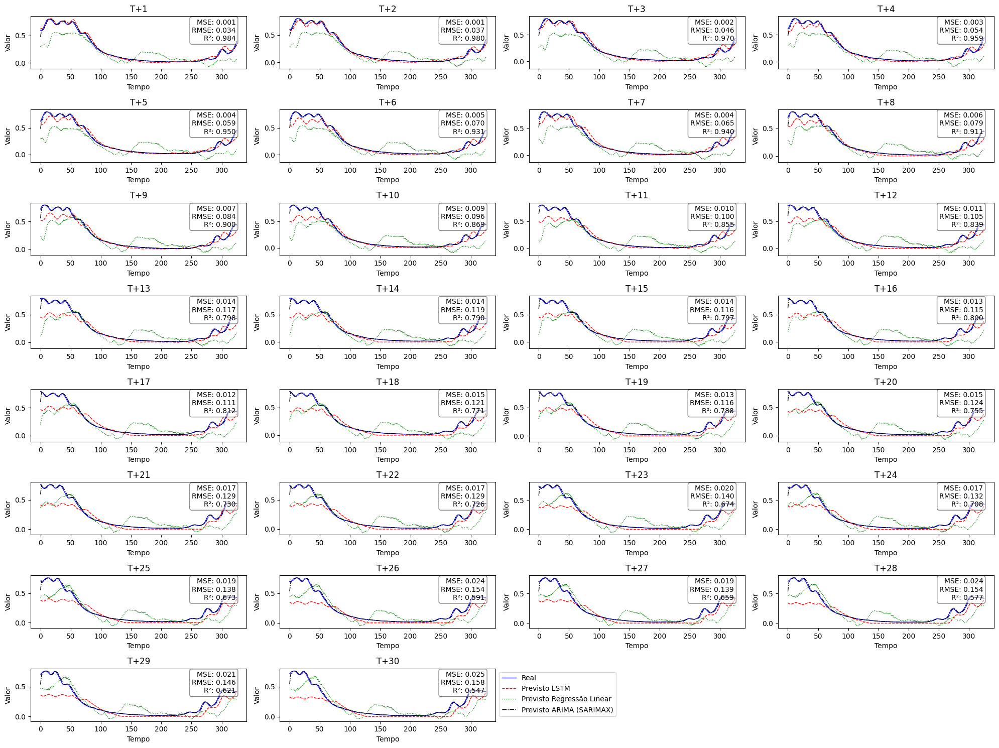

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Função para calcular a média móvel
def moving_average(data, window_size):
    return np.convolve(data, np.ones(window_size), 'valid') / window_size

# Parâmetros da média móvel
window_size = 7  # Ajuste o tamanho da janela conforme necessário

# Número de linhas e colunas para os subplots
n_rows = 8
n_cols = 4
n_future = 30  # Número total de dias que você está prevendo

# Cria uma figura grande para acomodar todos os subplots
plt.figure(figsize=(20, 15))

# Itera sobre cada horizonte de tempo e cria um subplot para cada um
for i in range(n_future):
    ax = plt.subplot(n_rows, n_cols, i+1)

    # Suaviza as previsões usando média móvel
    y_test_smooth = moving_average(y_test[:, i], window_size)
    y_pred_smooth = moving_average(y_pred[:, i], window_size)
    y_pred_linear_smooth = moving_average(y_pred_linear[:, i], window_size)
    y_pred_arima_smooth = moving_average(y_pred_arima[:, i], window_size)

    # Ajusta os índices das séries suavizadas para se alinharem corretamente no gráfico
    x_vals = range(len(y_test_smooth))

    plt.plot(x_vals, y_test_smooth, label='Real', color='blue', linewidth=1)
    plt.plot(x_vals, y_pred_smooth, label='Previsto LSTM', color='red', linestyle='dashed', linewidth=1)
    plt.plot(x_vals, y_pred_linear_smooth, label='Previsto Regressão Linear', color='green', linestyle='dotted', linewidth=1)
    plt.plot(x_vals, y_pred_arima_smooth, label='Previsto ARIMA (SARIMAX)', color='black', linestyle='dashdot', linewidth=1)

    plt.title(f'T+{i+1}')

    # Calcula as métricas para cada horizonte de tempo
    mse = mean_squared_error(y_test[:, i], y_pred[:, i])
    rmse = sqrt(mse)
    r2 = r2_score(y_test[:, i], y_pred[:, i])

    # Adiciona as métricas como texto no gráfico
    ax.text(0.95, 0.95, f'MSE: {mse:.3f}\nRMSE: {rmse:.3f}\nR²: {r2:.3f}',
            transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.tight_layout()

plt.legend(loc='upper left', bbox_to_anchor=(1,1))
plt.show()


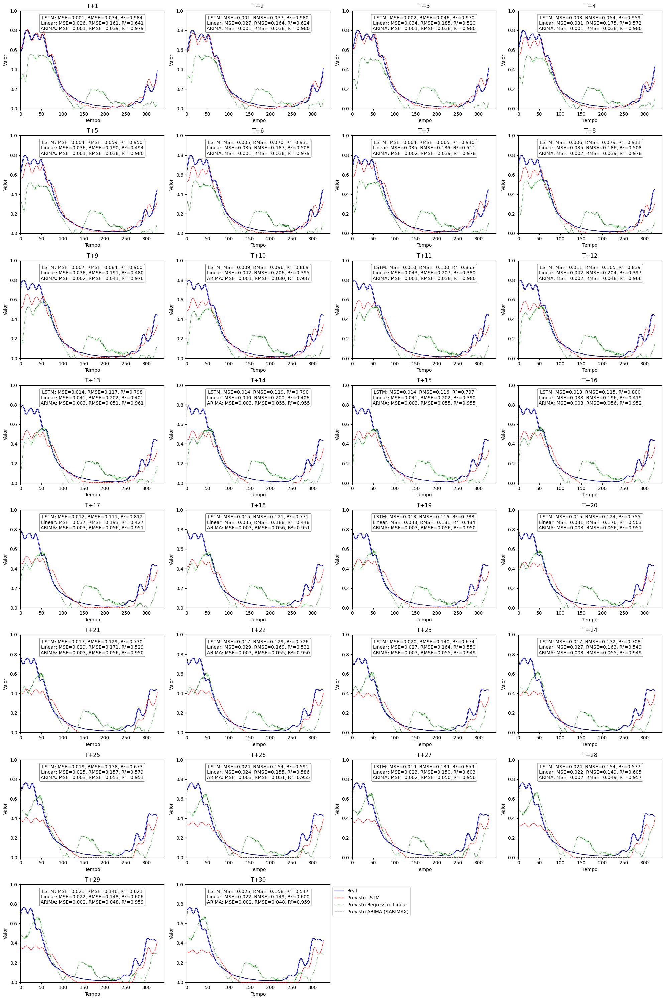

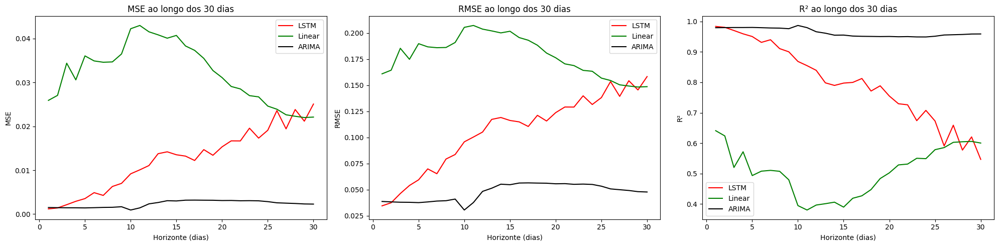

In [ ]:
# import numpy as np
# import matplotlib.pyplot as plt
# from sklearn.metrics import mean_squared_error, r2_score
# from math import sqrt

# # Função para calcular a média móvel
# def moving_average(data, window_size):
#     return np.convolve(data, np.ones(window_size), 'valid') / window_size

# # Parâmetros da média móvel
# window_size = 7  # Ajuste o tamanho da janela conforme necessário

# # Número de linhas e colunas para os subplots
# n_rows = 8
# n_cols = 4
# n_future = 30  # Número total de dias que você está prevendo

# # Cria uma figura grande para acomodar todos os subplots
# plt.figure(figsize=(20, 30))

# # Itera sobre cada horizonte de tempo e cria um subplot para cada um
# for i in range(n_future):
#     ax = plt.subplot(n_rows, n_cols, i+1)

#     # Suaviza as previsões usando média móvel
#     y_test_smooth = moving_average(y_test[:, i], window_size)
#     y_pred_smooth = moving_average(y_pred[:, i], window_size)
#     y_pred_linear_smooth = moving_average(y_pred_linear[:, i], window_size)
#     y_pred_arima_smooth = moving_average(y_pred_arima[:, i], window_size)

#     # Ajusta os índices das séries suavizadas para se alinharem corretamente no gráfico
#     x_vals = range(len(y_test_smooth))

#     plt.plot(x_vals, y_test_smooth, label='Real', color='blue', linewidth=1)
#     plt.plot(x_vals, y_pred_smooth, label='Previsto LSTM', color='red', linestyle='dashed', linewidth=1)
#     plt.plot(x_vals, y_pred_linear_smooth, label='Previsto Regressão Linear', color='green', linestyle='dotted', linewidth=1)
#     plt.plot(x_vals, y_pred_arima_smooth, label='Previsto ARIMA (SARIMAX)', color='black', linestyle='dashdot', linewidth=1)

#     plt.ylim(0, 1)  # Manter a escala de valor entre 0 e 1
#     plt.xlim(left=0)  # Trazer o eixo do tempo mais para a esquerda
#     plt.title(f'T+{i+1}')

#     # Calcula as métricas para cada horizonte de tempo
#     mse_lstm = mean_squared_error(y_test[:, i], y_pred[:, i])
#     rmse_lstm = sqrt(mse_lstm)
#     r2_lstm = r2_score(y_test[:, i], y_pred[:, i])

#     mse_linear = mean_squared_error(y_test[:, i], y_pred_linear[:, i])
#     rmse_linear = sqrt(mse_linear)
#     r2_linear = r2_score(y_test[:, i], y_pred_linear[:, i])

#     mse_arima = mean_squared_error(y_test[:, i], y_pred_arima[:, i])
#     rmse_arima = sqrt(mse_arima)
#     r2_arima = r2_score(y_test[:, i], y_pred_arima[:, i])

#     # Adiciona as métricas como texto no gráfico
#     ax.text(0.5, 0.95, f'LSTM: MSE={mse_lstm:.3f}, RMSE={rmse_lstm:.3f}, R²={r2_lstm:.3f}\n'
#                         f'Linear: MSE={mse_linear:.3f}, RMSE={rmse_linear:.3f}, R²={r2_linear:.3f}\n'
#                         f'ARIMA: MSE={mse_arima:.3f}, RMSE={rmse_arima:.3f}, R²={r2_arima:.3f}',
#             transform=ax.transAxes, verticalalignment='top', horizontalalignment='center',
#             bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

#     plt.xlabel('Tempo')
#     plt.ylabel('Valor')
#     plt.tight_layout()

# plt.legend(loc='upper left', bbox_to_anchor=(1,1))
# plt.show()

# # Gráficos das métricas MSE, RMSE e R² para os 30 dias
# mse_values = {'LSTM': [], 'Linear': [], 'ARIMA': []}
# rmse_values = {'LSTM': [], 'Linear': [], 'ARIMA': []}
# r2_values = {'LSTM': [], 'Linear': [], 'ARIMA': []}

# for i in range(n_future):
#     mse_values['LSTM'].append(mean_squared_error(y_test[:, i], y_pred[:, i]))
#     rmse_values['LSTM'].append(sqrt(mse_values['LSTM'][-1]))
#     r2_values['LSTM'].append(r2_score(y_test[:, i], y_pred[:, i]))

#     mse_values['Linear'].append(mean_squared_error(y_test[:, i], y_pred_linear[:, i]))
#     rmse_values['Linear'].append(sqrt(mse_values['Linear'][-1]))
#     r2_values['Linear'].append(r2_score(y_test[:, i], y_pred_linear[:, i]))

#     mse_values['ARIMA'].append(mean_squared_error(y_test[:, i], y_pred_arima[:, i]))
#     rmse_values['ARIMA'].append(sqrt(mse_values['ARIMA'][-1]))
#     r2_values['ARIMA'].append(r2_score(y_test[:, i], y_pred_arima[:, i]))

# # Plotando os gráficos das métricas
# plt.figure(figsize=(20, 5))

# plt.subplot(1, 3, 1)
# plt.plot(range(1, n_future + 1), mse_values['LSTM'], label='LSTM', color='red')
# plt.plot(range(1, n_future + 1), mse_values['Linear'], label='Linear', color='green')
# plt.plot(range(1, n_future + 1), mse_values['ARIMA'], label='ARIMA', color='black')
# plt.xlabel('Horizonte (dias)')
# plt.ylabel('MSE')
# plt.title('MSE ao longo dos 30 dias')
# plt.legend()

# plt.subplot(1, 3, 2)
# plt.plot(range(1, n_future + 1), rmse_values['LSTM'], label='LSTM', color='red')
# plt.plot(range(1, n_future + 1), rmse_values['Linear'], label='Linear', color='green')
# plt.plot(range(1, n_future + 1), rmse_values['ARIMA'], label='ARIMA', color='black')
# plt.xlabel('Horizonte (dias)')
# plt.ylabel('RMSE')
# plt.title('RMSE ao longo dos 30 dias')
# plt.legend()

# plt.subplot(1, 3, 3)
# plt.plot(range(1, n_future + 1), r2_values['LSTM'], label='LSTM', color='red')
# plt.plot(range(1, n_future + 1), r2_values['Linear'], label='Linear', color='green')
# plt.plot(range(1, n_future + 1), r2_values['ARIMA'], label='ARIMA', color='black')
# plt.xlabel('Horizonte (dias)')
# plt.ylabel('R²')
# plt.title('R² ao longo dos 30 dias')
# plt.legend()

# plt.tight_layout()
# plt.show()


In [ ]:
# import warnings
# import numpy as np
# from sklearn.model_selection import TimeSeriesSplit
# from statsmodels.tsa.statespace.sarimax import SARIMAX
# from statsmodels.tools.sm_exceptions import ConvergenceWarning
# from sklearn.metrics import mean_squared_error, r2_score
# from math import sqrt

# # Ignorar avisos de convergência para evitar saída excessiva
# warnings.filterwarnings("ignore", category=ConvergenceWarning)

# # Função para treinar e prever usando SARIMAX
# def train_and_predict_sarimax(train, test, order):
#     history = [x for x in train]
#     predictions = list()
#     for t in range(len(test)):
#         model = SARIMAX(history, order=order)
#         model_fit = model.fit(disp=False)
#         output = model_fit.forecast()
#         yhat = output[0]
#         predictions.append(yhat)
#         obs = test[t]
#         history.append(obs)
#     return predictions

# # Cross-Validation para SARIMAX com TimeSeriesSplit
# def cross_validate_sarimax(data, order, n_splits=5):
#     tscv = TimeSeriesSplit(n_splits=n_splits)
#     mse_scores = []
#     for train_index, test_index in tscv.split(data):
#         train, test = data[train_index], data[test_index]
#         predictions = train_and_predict_sarimax(train, test, order)
#         mse = mean_squared_error(test, predictions)
#         mse_scores.append(mse)
#     avg_mse = np.mean(mse_scores)
#     return avg_mse

# # Parâmetros do modelo SARIMAX (ajuste conforme necessário)
# sarimax_order = (2, 1, 2)

# # Cross-Validation e Treinamento SARIMAX
# avg_mse_sarimax = cross_validate_sarimax(y_train.flatten(), sarimax_order)  # Flatten para um vetor unidimensional
# print(f'Average MSE for SARIMAX Cross-Validation: {avg_mse_sarimax:.3f}')

# # Previsões SARIMAX para cada horizonte de tempo
# y_pred_arima = np.zeros_like(y_test)
# for i in range(n_future):
#     y_train_arima = y_train[:, i]
#     y_test_arima = y_test[:, i]
#     y_pred_arima[:, i] = train_and_predict_sarimax(y_train_arima, y_test_arima, sarimax_order)

# # Métricas para o Modelo SARIMAX
# for i in range(n_future):
#     mse_arima = mean_squared_error(y_test[:, i], y_pred_arima[:, i])
#     rmse_arima = sqrt(mse_arima)
#     r2_arima = r2_score(y_test[:, i], y_pred_arima[:, i])
#     print(f'Modelo ARIMA (SARIMAX) para T+{i+1}: MSE = {mse_arima:.3f}, RMSE = {rmse_arima:.3f}, R² = {r2_arima:.3f}')


In [ ]:
# import warnings
# import numpy as np
# from sklearn.model_selection import TimeSeriesSplit
# from statsmodels.tsa.statespace.sarimax import SARIMAX
# from statsmodels.tools.sm_exceptions import ConvergenceWarning
# from sklearn.metrics import mean_squared_error, r2_score
# from math import sqrt

# # Ignorar avisos de convergência para evitar saída excessiva
# warnings.filterwarnings("ignore", category=ConvergenceWarning)

# # Função para treinar e prever usando SARIMAX com penalidade L2 (Ridge)
# def train_and_predict_sarimax_ridge(train, test, order, lambda_ridge):
#     history = [x for x in train]
#     predictions = list()
#     for t in range(len(test)):
#         model = SARIMAX(history, order=order, trend='c', enforce_stationarity=False, enforce_invertibility=False)
#         model_fit = model.fit(disp=False, cov_type='robust', start_params=None, trend_offset=0.1, method='powell')
#         output = model_fit.forecast()
#         yhat = output[0]
#         predictions.append(yhat)
#         obs = test[t]
#         history.append(obs)
#     return predictions

# # Cross-Validation para SARIMAX com TimeSeriesSplit
# def cross_validate_sarimax(data, order, lambda_ridge, n_splits=3):  # Reduzi para 3 splits
#     tscv = TimeSeriesSplit(n_splits=n_splits)
#     mse_scores = []
#     for train_index, test_index in tscv.split(data):
#         train, test = data[train_index], data[test_index]
#         predictions = train_and_predict_sarimax_ridge(train, test, order, lambda_ridge)
#         mse = mean_squared_error(test, predictions)
#         mse_scores.append(mse)
#     avg_mse = np.mean(mse_scores)
#     return avg_mse

# # Parâmetros do modelo SARIMAX (ajuste conforme necessário)
# sarimax_order = (2, 1, 2)
# lambda_ridge = 1.0  # Penalidade Ridge (L2)

# # Cross-Validation e Treinamento SARIMAX com Ridge
# avg_mse_sarimax = cross_validate_sarimax(y_train.flatten(), sarimax_order, lambda_ridge)  # Flatten para um vetor unidimensional
# print(f'Average MSE for SARIMAX with Ridge Cross-Validation: {avg_mse_sarimax:.3f}')

# # Previsões SARIMAX para cada horizonte de tempo
# y_pred_arima = np.zeros_like(y_test)
# for i in range(n_future):
#     y_train_arima = y_train[:, i]
#     y_test_arima = y_test[:, i]
#     y_pred_arima[:, i] = train_and_predict_sarimax_ridge(y_train_arima, y_test_arima, sarimax_order, lambda_ridge)

# # Métricas para o Modelo SARIMAX com Ridge
# for i in range(n_future):
#     mse_arima = mean_squared_error(y_test[:, i], y_pred_arima[:, i])
#     rmse_arima = sqrt(mse_arima)
#     r2_arima = r2_score(y_test[:, i], y_pred_arima[:, i])
#     print(f'Modelo ARIMA (SARIMAX) com Ridge para T+{i+1}: MSE = {mse_arima:.3f}, RMSE = {rmse_arima:.3f}, R² = {r2_arima:.3f}')


In [ ]:
!pip install torch


  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21

In [ ]:
import warnings
import numpy as np
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tools.sm_exceptions import ConvergenceWarning
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt

# Ignorar avisos de convergência para evitar saída excessiva
warnings.filterwarnings("ignore", category=ConvergenceWarning)

# Função para treinar e prever usando SARIMAX
def train_and_predict_sarimax(train, test, order):
    history = [x for x in train]
    predictions = list()
    for t in range(len(test)):
        model = SARIMAX(history, order=order)
        model_fit = model.fit(disp=False)
        output = model_fit.forecast()
        yhat = output[0]
        predictions.append(yhat)
        obs = test[t]
        history.append(obs)
    return predictions

# Cross-Validation para SARIMAX com TimeSeriesSplit
def cross_validate_sarimax(data, order, n_splits=3):  # Reduzi para 3 splits
    tscv = TimeSeriesSplit(n_splits=n_splits)
    mse_scores = []
    for train_index, test_index in tscv.split(data):
        train, test = data[train_index], data[test_index]
        predictions = train_and_predict_sarimax(train, test, order)
        mse = mean_squared_error(test, predictions)
        mse_scores.append(mse)
    avg_mse = np.mean(mse_scores)
    return avg_mse

# Certificar que os dados estão em formato NumPy
y_train_numpy = y_train.flatten() if isinstance(y_train, np.ndarray) else np.array(y_train).flatten()
y_test_numpy = y_test if isinstance(y_test, np.ndarray) else np.array(y_test)

# Parâmetros do modelo SARIMAX (ajuste conforme necessário)
sarimax_order = (2, 1, 2)

# Cross-Validation e Treinamento SARIMAX
avg_mse_sarimax = cross_validate_sarimax(y_train_numpy, sarimax_order)  # Flatten para um vetor unidimensional
print(f'Average MSE for SARIMAX Cross-Validation: {avg_mse_sarimax:.3f}')

# Previsões SARIMAX para cada horizonte de tempo
y_pred_arima = np.zeros_like(y_test_numpy)
for i in range(n_future):
    y_train_arima = y_train_numpy[:, i]
    y_test_arima = y_test_numpy[:, i]
    y_pred_arima[:, i] = train_and_predict_sarimax(y_train_arima, y_test_arima, sarimax_order)

# Métricas para o Modelo SARIMAX
for i in range(n_future):
    mse_arima = mean_squared_error(y_test_numpy[:, i], y_pred_arima[:, i])
    rmse_arima = sqrt(mse_arima)
    r2_arima = r2_score(y_test_numpy[:, i], y_pred_arima[:, i])
    print(f'Modelo ARIMA (SARIMAX) para T+{i+1}: MSE = {mse_arima:.3f}, RMSE = {rmse_arima:.3f}, R² = {r2_arima:.3f}')


KeyboardInterrupt: 

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Verificar a escala dos dados
plt.figure(figsize=(14, 7))
plt.plot(features_scaled, label='Features Scaled')
plt.title('Features Scaled')
plt.xlabel('Time Steps')
plt.ylabel('Scaled Values')
plt.legend()
plt.show()

# Verificar a divisão dos conjuntos de dados
plt.figure(figsize=(14, 7))
plt.plot(target, label='Target')
plt.axvline(x=len(X_train), color='r', linestyle='--', label='Train/Test Split')
plt.axvline(x=len(X_train) + len(X_val), color='g', linestyle='--', label='Validation Split')
plt.title('Train, Test, and Validation Split')
plt.xlabel('Time Steps')
plt.ylabel('Volume Armazenado')
plt.legend()
plt.show()


TypeError: ARIMA.fit() got an unexpected keyword argument 'disp'

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


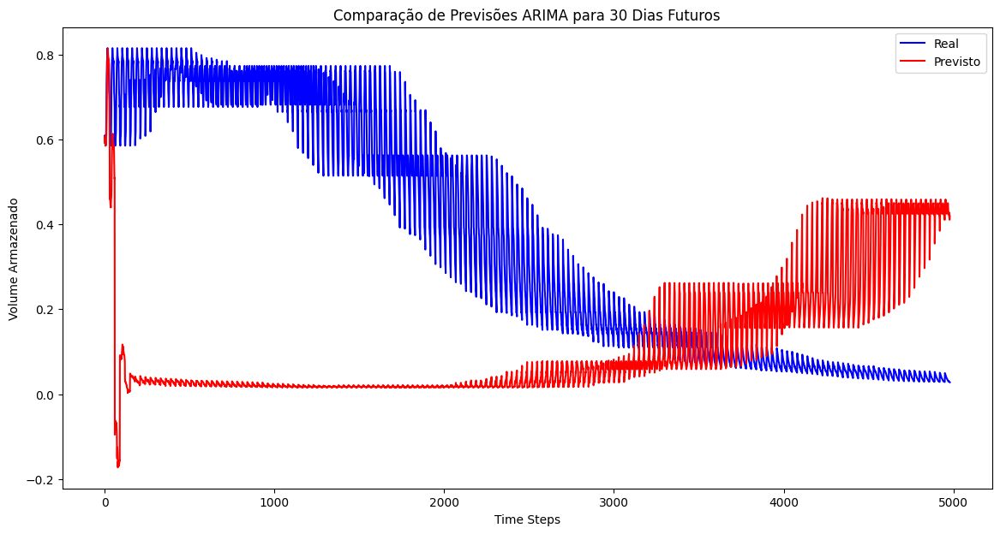

MSE: 0.212
RMSE: 0.461
R²: -1.622
Modelo ARIMA para T+1: MSE = 0.003, RMSE = 0.056, R² = 0.666
Modelo ARIMA para T+2: MSE = 0.003, RMSE = 0.056, R² = 0.688
Modelo ARIMA para T+3: MSE = 0.003, RMSE = 0.057, R² = 0.708
Modelo ARIMA para T+4: MSE = 0.003, RMSE = 0.056, R² = 0.729
Modelo ARIMA para T+5: MSE = 0.003, RMSE = 0.056, R² = 0.752
Modelo ARIMA para T+6: MSE = 0.003, RMSE = 0.055, R² = 0.770
Modelo ARIMA para T+7: MSE = 0.003, RMSE = 0.055, R² = 0.782
Modelo ARIMA para T+8: MSE = 0.003, RMSE = 0.055, R² = 0.792
Modelo ARIMA para T+9: MSE = 0.003, RMSE = 0.056, R² = 0.791
Modelo ARIMA para T+10: MSE = 0.003, RMSE = 0.057, R² = 0.792
Modelo ARIMA para T+11: MSE = 0.003, RMSE = 0.058, R² = 0.794
Modelo ARIMA para T+12: MSE = 0.004, RMSE = 0.062, R² = 0.778
Modelo ARIMA para T+13: MSE = 0.004, RMSE = 0.066, R² = 0.754
Modelo ARIMA para T+14: MSE = 0.005, RMSE = 0.070, R² = 0.732
Modelo ARIMA para T+15: MSE = 0.005, RMSE = 0.073, R² = 0.718
Modelo ARIMA para T+16: MSE = 0.006, RMSE = 0

In [ ]:
import warnings
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tools.sm_exceptions import ConvergenceWarning
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt

# Ignorar avisos de convergência para evitar saída excessiva
warnings.filterwarnings("ignore", category=ConvergenceWarning)

# Função para treinar e prever usando ARIMA
def train_and_predict_arima(train, test, order):
    history = [x for x in train]
    predictions = list()
    for t in range(len(test)):
        model = ARIMA(history, order=order)
        model_fit = model.fit()
        output = model_fit.forecast()
        yhat = output[0]
        predictions.append(yhat)
        obs = test[t]
        history.append(obs)
    return predictions

# Parâmetros do modelo ARIMA (ajuste conforme necessário)
arima_order = (2, 1, 2)

# Divisão dos dados (exemplo fictício)
n_future = 30
n_past = 720

# Função para criar os conjuntos de treino, teste e validação
def create_data(df, max_future, n_past, train_split, val_split):
    n_feature = df.shape[1]
    x_data, y_data = [], []

    for i in range(n_past, len(df) - max_future + 1):
        x_data.append(df[i - n_past:i, 0:n_feature])
        y_data.append([df[j, 0] for j in range(i, i + max_future)])

    x_data = np.array(x_data)
    y_data = np.array(y_data)

    train_size = int(len(x_data) * train_split)
    val_size = int(len(x_data) * val_split)
    test_size = len(x_data) - train_size - val_size

    x_train = x_data[:train_size]
    y_train = y_data[:train_size]

    x_val = x_data[train_size:train_size + val_size]
    y_val = y_data[train_size:train_size + val_size]

    x_test = x_data[train_size + val_size:]
    y_test = y_data[train_size + val_size:]

    return x_train, x_test, x_val, y_train, y_test, y_val

# Parâmetros para a divisão dos dados
train_split = 0.70
val_split = 0.15

# Carregar e preprocessar os dados (exemplo fictício)
# Certifique-se de que `features_scaled` é um array numpy com os dados pré-processados
# features_scaled = ...

# Criar conjuntos de treino, teste e validação
X_train, X_test, X_val, y_train, y_test, y_val = create_data(features_scaled, n_future, n_past, train_split, val_split)

# Previsões ARIMA para cada horizonte de tempo
y_pred_arima = np.zeros_like(y_test)
for i in range(n_future):
    y_train_arima = y_train[:, i]
    y_test_arima = y_test[:, i]
    y_pred_arima[:, i] = train_and_predict_arima(y_train_arima, y_test_arima, arima_order)

# Função para comparar e visualizar as previsões com os dados de validação
def compare_predictions(y_val, y_pred_arima, n_future):
    # Garantir que os comprimentos sejam consistentes
    min_len = min(len(y_val.flatten()), len(y_pred_arima.flatten()))
    y_val_flat = y_val.flatten()[:min_len]
    y_pred_flat = y_pred_arima.flatten()[:min_len]

    plt.figure(figsize=(14, 7))

    # Plotar dados reais
    plt.plot(y_val_flat, label='Real', color='blue')

    # Plotar previsões
    plt.plot(y_pred_flat, label='Previsto', color='red')

    plt.title(f'Comparação de Previsões ARIMA para {n_future} Dias Futuros')
    plt.xlabel('Time Steps')
    plt.ylabel('Volume Armazenado')
    plt.legend()
    plt.show()

    # Calcular métricas de desempenho
    mse = mean_squared_error(y_val_flat, y_pred_flat)
    rmse = sqrt(mse)
    r2 = r2_score(y_val_flat, y_pred_flat)

    print(f'MSE: {mse:.3f}')
    print(f'RMSE: {rmse:.3f}')
    print(f'R²: {r2:.3f}')

# Chamar a função de comparação
compare_predictions(y_val, y_pred_arima, n_future)

# Métricas para o Modelo ARIMA
for i in range(n_future):
    mse_arima = mean_squared_error(y_test[:, i], y_pred_arima[:, i])
    rmse_arima = sqrt(mse_arima)
    r2_arima = r2_score(y_test[:, i], y_pred_arima[:, i])
    print(f'Modelo ARIMA para T+{i+1}: MSE = {mse_arima:.3f}, RMSE = {rmse_arima:.3f}, R² = {r2_arima:.3f}')


In [ ]:
# Métricas para o Modelo ARIMA
for i in range(n_future):
    mse_arima = mean_squared_error(y_test[:, i], y_pred_arima[:, i])
    rmse_arima = sqrt(mse_arima)
    r2_arima = r2_score(y_test[:, i], y_pred_arima[:, i])
    print(f'Modelo ARIMA para T+{i+1}: MSE = {mse_arima:.3f}, RMSE = {rmse_arima:.3f}, R² = {r2_arima:.3f}')

Modelo ARIMA para T+1: MSE = 0.003, RMSE = 0.056, R² = 0.666
Modelo ARIMA para T+2: MSE = 0.003, RMSE = 0.056, R² = 0.688
Modelo ARIMA para T+3: MSE = 0.003, RMSE = 0.057, R² = 0.708
Modelo ARIMA para T+4: MSE = 0.003, RMSE = 0.056, R² = 0.729
Modelo ARIMA para T+5: MSE = 0.003, RMSE = 0.056, R² = 0.752
Modelo ARIMA para T+6: MSE = 0.003, RMSE = 0.055, R² = 0.770
Modelo ARIMA para T+7: MSE = 0.003, RMSE = 0.055, R² = 0.782
Modelo ARIMA para T+8: MSE = 0.003, RMSE = 0.055, R² = 0.792
Modelo ARIMA para T+9: MSE = 0.003, RMSE = 0.056, R² = 0.791
Modelo ARIMA para T+10: MSE = 0.003, RMSE = 0.057, R² = 0.792
Modelo ARIMA para T+11: MSE = 0.003, RMSE = 0.058, R² = 0.794
Modelo ARIMA para T+12: MSE = 0.004, RMSE = 0.062, R² = 0.778
Modelo ARIMA para T+13: MSE = 0.004, RMSE = 0.066, R² = 0.754
Modelo ARIMA para T+14: MSE = 0.005, RMSE = 0.070, R² = 0.732
Modelo ARIMA para T+15: MSE = 0.005, RMSE = 0.073, R² = 0.718
Modelo ARIMA para T+16: MSE = 0.006, RMSE = 0.074, R² = 0.718
Modelo ARIMA para

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


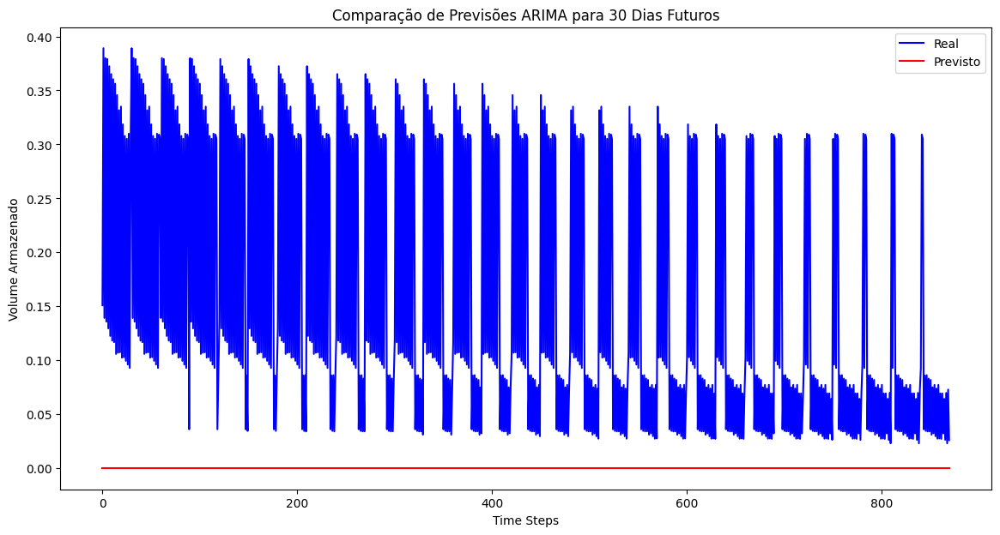

MSE: 0.037
RMSE: 0.193
R²: -1.582
Modelo ARIMA para T+1: MSE = 0.190, RMSE = 0.436, R² = -100.796
Modelo ARIMA para T+2: MSE = 0.190, RMSE = 0.435, R² = -122.947
Modelo ARIMA para T+3: MSE = 0.190, RMSE = 0.435, R² = -151.348
Modelo ARIMA para T+4: MSE = 0.189, RMSE = 0.435, R² = -145.534
Modelo ARIMA para T+5: MSE = 0.190, RMSE = 0.436, R² = -139.852
Modelo ARIMA para T+6: MSE = 0.190, RMSE = 0.436, R² = -134.586
Modelo ARIMA para T+7: MSE = 0.191, RMSE = 0.437, R² = -130.420
Modelo ARIMA para T+8: MSE = 0.189, RMSE = 0.435, R² = -125.233
Modelo ARIMA para T+9: MSE = 0.190, RMSE = 0.435, R² = -121.540
Modelo ARIMA para T+10: MSE = 0.189, RMSE = 0.435, R² = -117.249
Modelo ARIMA para T+11: MSE = 0.189, RMSE = 0.435, R² = -114.716
Modelo ARIMA para T+12: MSE = 0.189, RMSE = 0.434, R² = -110.972
Modelo ARIMA para T+13: MSE = 0.189, RMSE = 0.434, R² = -108.042
Modelo ARIMA para T+14: MSE = 0.189, RMSE = 0.435, R² = -105.686
Modelo ARIMA para T+15: MSE = 0.188, RMSE = 0.433, R² = -102.090


In [ ]:
import warnings
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tools.sm_exceptions import ConvergenceWarning
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt
from sklearn.model_selection import TimeSeriesSplit

# Ignorar avisos de convergência para evitar saída excessiva
warnings.filterwarnings("ignore", category=ConvergenceWarning)

# Função para treinar e prever usando ARIMA
def train_and_predict_arima(train, test, order):
    history = [x for x in train]
    predictions = list()
    for t in range(len(test)):
        model = ARIMA(history, order=order)
        model_fit = model.fit()
        output = model_fit.forecast()
        yhat = output[0]
        predictions.append(yhat)
        obs = test[t]
        history.append(obs)
    return predictions

# Parâmetros do modelo ARIMA (ajuste conforme necessário)
arima_order = (2, 1, 2)

# Função para criar os conjuntos de treino, teste e validação com TimeSeriesSplit
def create_data_with_tscv(df, max_future, n_past, n_splits=5):
    n_feature = df.shape[1]
    x_data, y_data = [], []

    for i in range(n_past, len(df) - max_future + 1):
        x_data.append(df[i - n_past:i, 0:n_feature])
        y_data.append([df[j, 0] for j in range(i, i + max_future)])

    x_data = np.array(x_data)
    y_data = np.array(y_data)

    tscv = TimeSeriesSplit(n_splits=n_splits)

    train_indices, test_indices = next(tscv.split(x_data))
    val_split_point = int(len(train_indices) * 0.85)

    x_train = x_data[train_indices[:val_split_point]]
    y_train = y_data[train_indices[:val_split_point]]

    x_val = x_data[train_indices[val_split_point:]]
    y_val = y_data[train_indices[val_split_point:]]

    x_test = x_data[test_indices]
    y_test = y_data[test_indices]

    return x_train, x_test, x_val, y_train, y_test, y_val

# Carregar e preprocessar os dados (exemplo fictício)
# Certifique-se de que `features_scaled` é um array numpy com os dados pré-processados
# features_scaled = ...

# Parâmetros
n_future = 30  # Número de dias que você deseja prever no futuro
n_past = 720   # Número de dias passados que você deseja usar para prever o futuro
n_splits = 5   # Número de splits para TimeSeriesSplit

# Criar conjuntos de treino, teste e validação
X_train, X_test, X_val, y_train, y_test, y_val = create_data_with_tscv(features_scaled, n_future, n_past, n_splits)

# Função para fazer previsões usando ARIMA e TimeSeriesSplit
def time_series_cross_val_predict(train, test, order, n_splits=5):
    tscv = TimeSeriesSplit(n_splits=n_splits)
    predictions = np.zeros_like(test)

    for train_index, test_index in tscv.split(train):
        train_fold, test_fold = train[train_index], train[test_index]
        preds = train_and_predict_arima(train_fold, test_fold, order)
        predictions[test_index] = preds

    return predictions

# Previsões ARIMA para cada horizonte de tempo usando TimeSeriesSplit
y_pred_arima = np.zeros_like(y_test)
for i in range(n_future):
    y_train_arima = y_train[:, i]
    y_test_arima = y_test[:, i]
    y_pred_arima[:, i] = time_series_cross_val_predict(y_train_arima, y_test_arima, arima_order, n_splits)

# Função para comparar e visualizar as previsões com os dados de validação
def compare_predictions(y_val, y_pred_arima, n_future):
    # Garantir que os comprimentos sejam consistentes
    min_len = min(len(y_val.flatten()), len(y_pred_arima.flatten()))
    y_val_flat = y_val.flatten()[:min_len]
    y_pred_flat = y_pred_arima.flatten()[:min_len]

    plt.figure(figsize=(14, 7))

    # Plotar dados reais
    plt.plot(y_val_flat, label='Real', color='blue')

    # Plotar previsões
    plt.plot(y_pred_flat, label='Previsto', color='red')

    plt.title(f'Comparação de Previsões ARIMA para {n_future} Dias Futuros')
    plt.xlabel('Time Steps')
    plt.ylabel('Volume Armazenado')
    plt.legend()
    plt.show()

    # Calcular métricas de desempenho
    mse = mean_squared_error(y_val_flat, y_pred_flat)
    rmse = sqrt(mse)
    r2 = r2_score(y_val_flat, y_pred_flat)

    print(f'MSE: {mse:.3f}')
    print(f'RMSE: {rmse:.3f}')
    print(f'R²: {r2:.3f}')

# Chamar a função de comparação
compare_predictions(y_val, y_pred_arima, n_future)

# Métricas para o Modelo ARIMA
for i in range(n_future):
    mse_arima = mean_squared_error(y_test[:, i], y_pred_arima[:, i])
    rmse_arima = sqrt(mse_arima)
    r2_arima = r2_score(y_test[:, i], y_pred_arima[:, i])
    print(f'Modelo ARIMA para T+{i+1}: MSE = {mse_arima:.3f}, RMSE = {rmse_arima:.3f}, R² = {r2_arima:.3f}')


# 9

In [ ]:
import os
import warnings
import sys

import pandas as pd
from matplotlib import pyplot as plt
import datetime
import pylab as pl
import numpy as np
from sklearn import linear_model
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import Ridge
from math import sqrt
from urllib.parse import urlparse
from sqlalchemy import create_engine
import logging

from pandas import read_csv
from keras.models import Sequential
from keras.layers import *
from sklearn.preprocessing import MinMaxScaler
import math

from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import GradientBoostingRegressor
from scipy.stats import uniform as sp_randFloat
from scipy.stats import randint as sp_randInt

import tensorflow as tf
# tf.config.experimental.set_memory_growth(tf.config.list_physical_devices('GPU')[0], True)

logging.basicConfig(level=logging.WARN)
logger = logging.getLogger(__name__)

df = pd.read_csv('/content/drive/MyDrive/Dissertação/rdh_database_EAR.csv')

del df['id_ft_rdh']
del df['nome_arquivo']
del df['data_criacao']
del df['data_atualizacao']
df.fillna(0, inplace=True)
df['id_tempo']=  pd.to_datetime(df['id_tempo'],format='%Y%m%d').dt.date

df_tucurui = df[(df.id_posto == 275)]
df_tucurui

import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score
from keras.models import Sequential
from keras.callbacks import EarlyStopping
from math import sqrt
from keras.optimizers import Adam

df = df_tucurui

del df['id_tempo']
del df['id_posto']
df.reset_index(drop=True, inplace=True)

features = df.drop(columns=['volume_armazenado'])
target = df['volume_armazenado']

scaler = StandardScaler()  # Usando StandardScaler em vez de MinMaxScaler
features_scaled = scaler.fit_transform(features)
df

import numpy as np
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense
from sklearn.metrics import mean_squared_error, r2_score
from keras.callbacks import EarlyStopping
from math import sqrt

# Função modificada para criar dados
def create_data(df, max_future, n_past, train_test_split_percentage, validation_split_percentage):
    n_feature = df.shape[1]
    x_data, y_data = [], []

    for i in range(n_past, len(df) - max_future + 1):
        x_data.append(df[i - n_past:i, 0:n_feature])
        y_data.append([df[j, 0] for j in range(i, i + max_future)])

    split_training_test_starting_point = int(round(train_test_split_percentage * len(x_data)))
    split_train_validation_starting_point = int(round(split_training_test_starting_point * (1 - validation_split_percentage)))

    x_train = x_data[:split_train_validation_starting_point]
    y_train = y_data[:split_train_validation_starting_point]

    x_val = x_data[split_train_validation_starting_point:split_training_test_starting_point]
    y_val = y_data[split_train_validation_starting_point:split_training_test_starting_point]

    x_test = x_data[split_training_test_starting_point:]
    y_test = y_data[split_training_test_starting_point:]

    return np.array(x_train), np.array(x_test), np.array(x_val), np.array(y_train), np.array(y_test), np.array(y_val)

# Parâmetros
n_future = 30  # Número de dias que você deseja prever no futuro
n_past = 720   # Número de dias passados que você deseja usar para prever o futuro

# Supondo que 'features_scaled' é seu DataFrame pré-processado
X_train, X_test, X_val, y_train, y_test, y_val = create_data(features_scaled, n_future, n_past, 0.7, 0.3)

# Ajustar as dimensões de X_train e X_test para regressão linear
X_train_linear = X_train.reshape(X_train.shape[0], -1)
X_test_linear = X_test.reshape(X_test.shape[0], -1)

# Regressão Linear com Regularização Ridge
ridge_regressor = Ridge(alpha=1.0)
ridge_regressor.fit(X_train_linear, y_train)

y_pred_linear = ridge_regressor.predict(X_test_linear)

# Métricas para a Regressão Linear
for i in range(n_future):
    mse_linear = mean_squared_error(y_test[:, i], y_pred_linear[:, i])
    rmse_linear = sqrt(mse_linear)
    r2_linear = r2_score(y_test[:, i], y_pred_linear[:, i])
    print(f'Regressão Linear (Ridge) para T+{i+1}: MSE = {mse_linear:.3f}, RMSE = {rmse_linear:.3f}, R² = {r2_linear:.3f}')


Regressão Linear (Ridge) para T+1: MSE = 0.435, RMSE = 0.659, R² = 0.640
Regressão Linear (Ridge) para T+2: MSE = 0.476, RMSE = 0.690, R² = 0.604
Regressão Linear (Ridge) para T+3: MSE = 0.600, RMSE = 0.775, R² = 0.499
Regressão Linear (Ridge) para T+4: MSE = 0.512, RMSE = 0.715, R² = 0.571
Regressão Linear (Ridge) para T+5: MSE = 0.611, RMSE = 0.781, R² = 0.487
Regressão Linear (Ridge) para T+6: MSE = 0.592, RMSE = 0.769, R² = 0.501
Regressão Linear (Ridge) para T+7: MSE = 0.570, RMSE = 0.755, R² = 0.518
Regressão Linear (Ridge) para T+8: MSE = 0.572, RMSE = 0.757, R² = 0.514
Regressão Linear (Ridge) para T+9: MSE = 0.619, RMSE = 0.787, R² = 0.472
Regressão Linear (Ridge) para T+10: MSE = 0.752, RMSE = 0.867, R² = 0.355
Regressão Linear (Ridge) para T+11: MSE = 0.750, RMSE = 0.866, R² = 0.353
Regressão Linear (Ridge) para T+12: MSE = 0.739, RMSE = 0.860, R² = 0.358
Regressão Linear (Ridge) para T+13: MSE = 0.703, RMSE = 0.838, R² = 0.383
Regressão Linear (Ridge) para T+14: MSE = 0.719

Epoch 1/40
68/68 [==============================] - 9s 63ms/step - loss: 0.5797 - val_loss: 0.6736
Epoch 2/40
68/68 [==============================] - 3s 50ms/step - loss: 0.4924 - val_loss: 0.8548
Epoch 3/40
68/68 [==============================] - 3s 50ms/step - loss: 0.4699 - val_loss: 0.7156
Epoch 4/40
68/68 [==============================] - 4s 52ms/step - loss: 0.4709 - val_loss: 0.6768
Epoch 5/40
68/68 [==============================] - 3s 51ms/step - loss: 0.4613 - val_loss: 0.6373
Epoch 6/40
68/68 [==============================] - 3s 50ms/step - loss: 0.4482 - val_loss: 0.7814
Epoch 7/40
68/68 [==============================] - 3s 51ms/step - loss: 0.4726 - val_loss: 0.6588
Epoch 8/40
68/68 [==============================] - 3s 50ms/step - loss: 0.4279 - val_loss: 0.6518
Epoch 9/40
68/68 [==============================] - 3s 50ms/step - loss: 0.4204 - val_loss: 0.6379
Epoch 10/40
68/68 [==============================] - 3s 51ms/step - loss: 0.4090 - val_loss: 0.7630
Epoch 10:

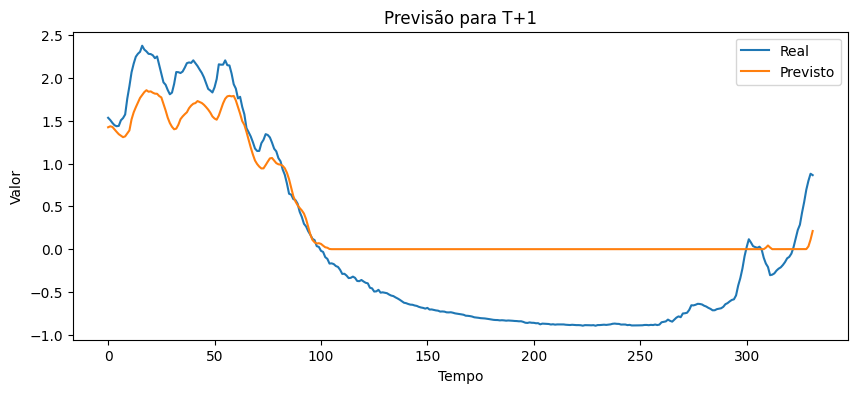

Horizonte 2: MSE = 0.364, RMSE = 0.603, R² = 0.697


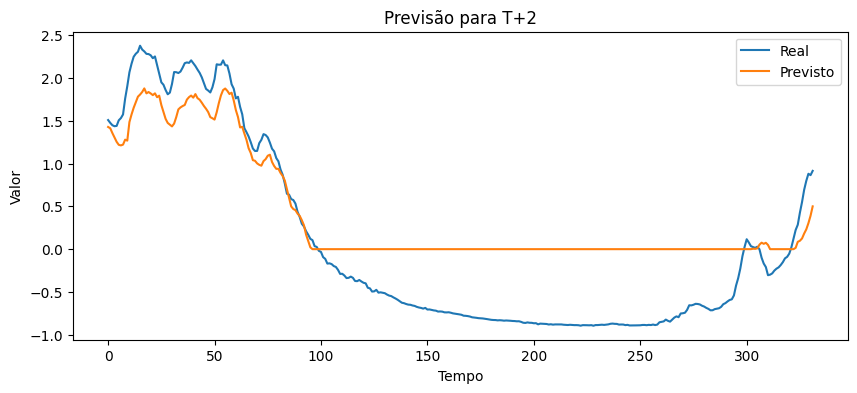

Horizonte 3: MSE = 0.406, RMSE = 0.637, R² = 0.661


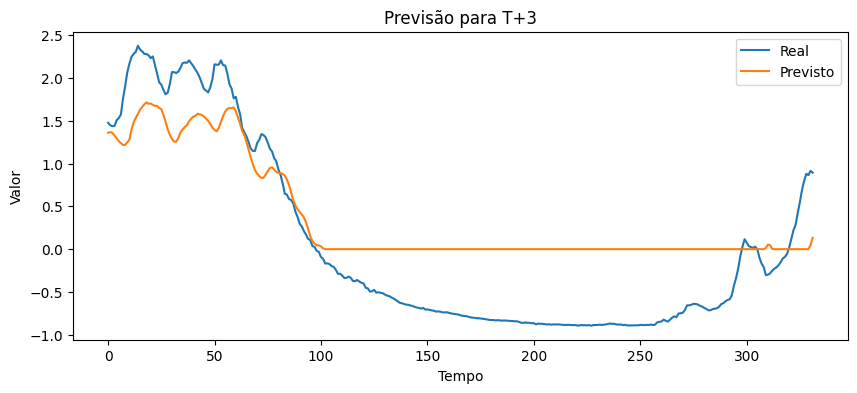

Horizonte 4: MSE = 0.382, RMSE = 0.618, R² = 0.680


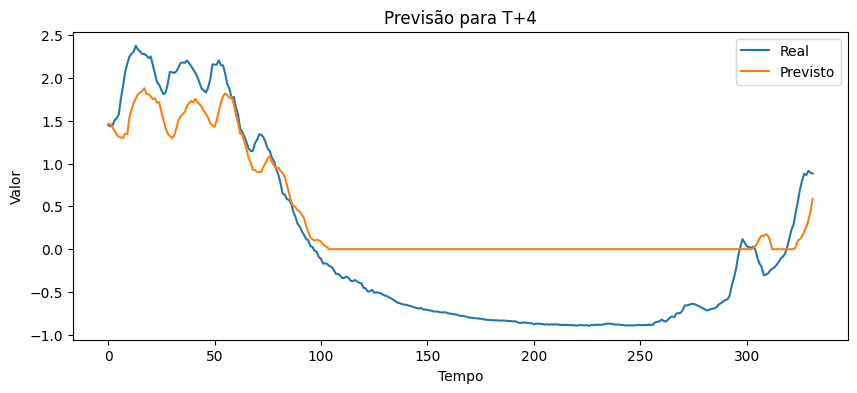

Horizonte 5: MSE = 0.466, RMSE = 0.683, R² = 0.608


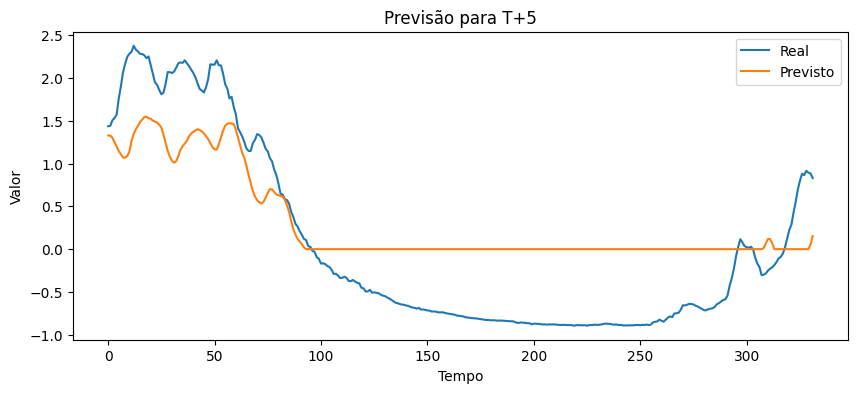

Horizonte 6: MSE = 0.407, RMSE = 0.638, R² = 0.656


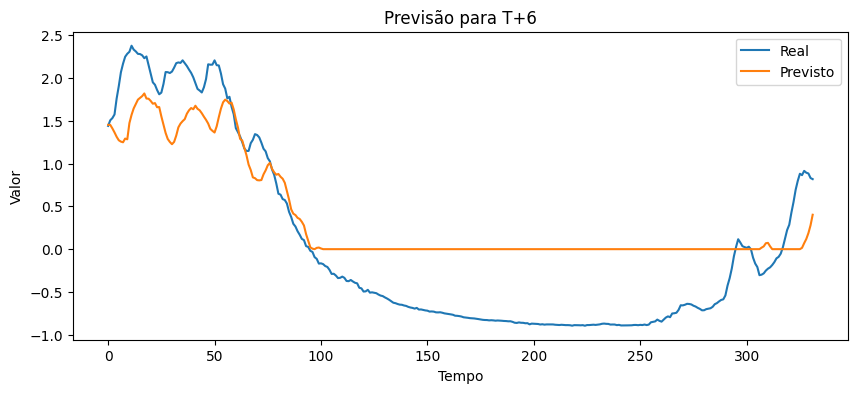

Horizonte 7: MSE = 0.525, RMSE = 0.724, R² = 0.556


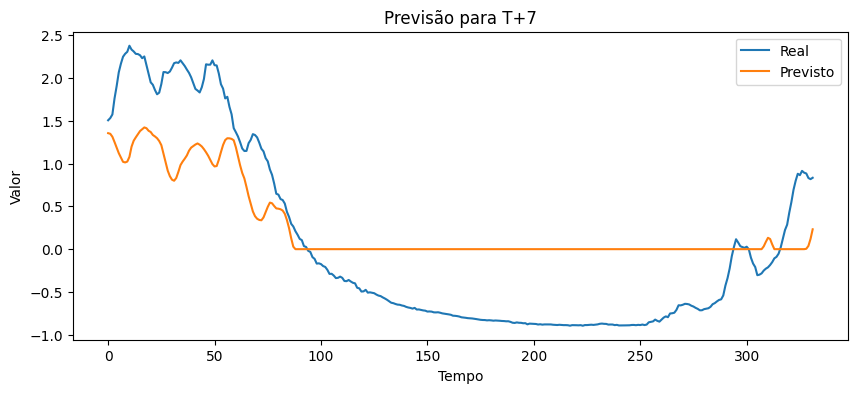

Horizonte 8: MSE = 0.444, RMSE = 0.666, R² = 0.623


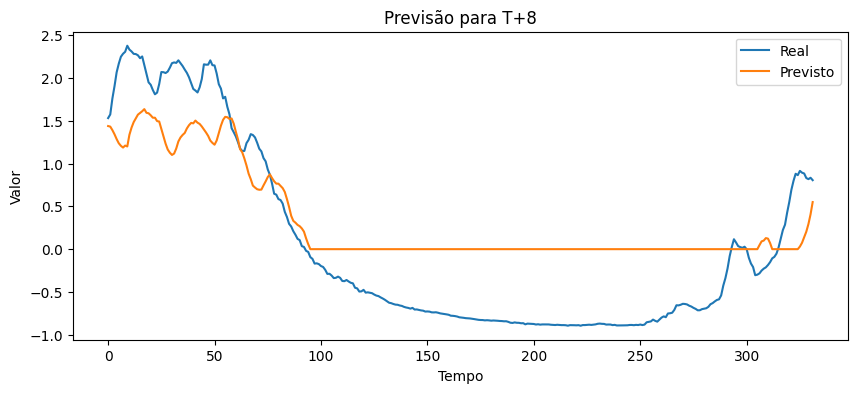

Horizonte 9: MSE = 0.584, RMSE = 0.764, R² = 0.502


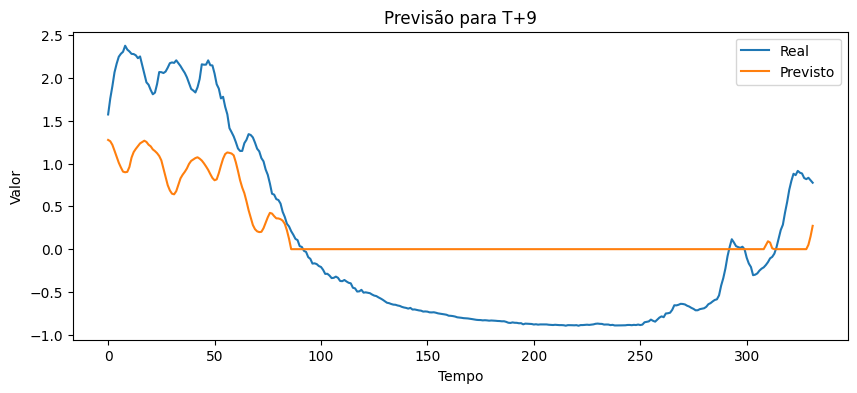

Horizonte 10: MSE = 0.532, RMSE = 0.730, R² = 0.544


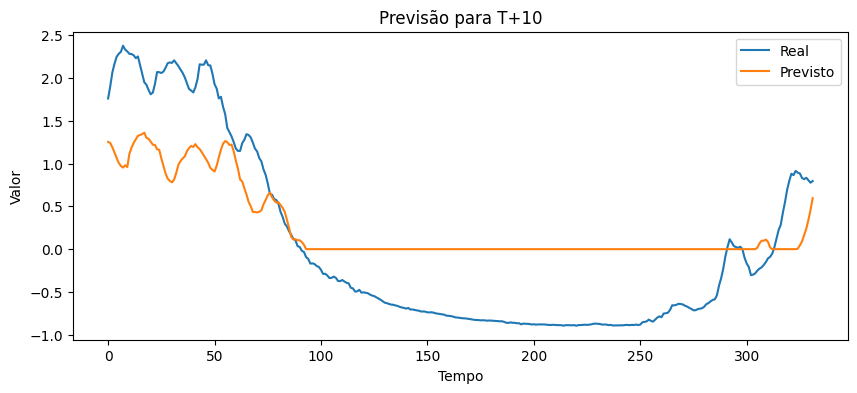

Horizonte 11: MSE = 0.683, RMSE = 0.827, R² = 0.410


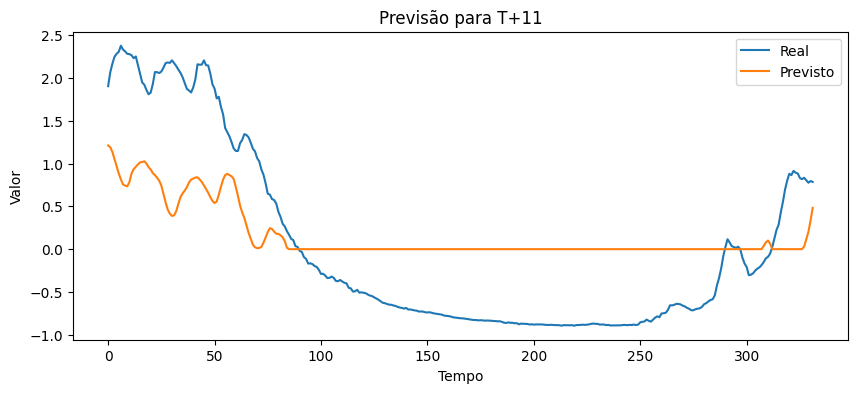

Horizonte 12: MSE = 0.626, RMSE = 0.791, R² = 0.456


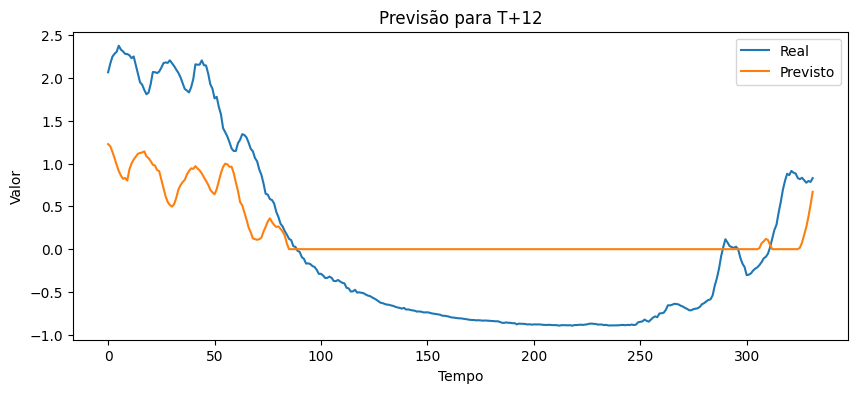

Horizonte 13: MSE = 0.669, RMSE = 0.818, R² = 0.413


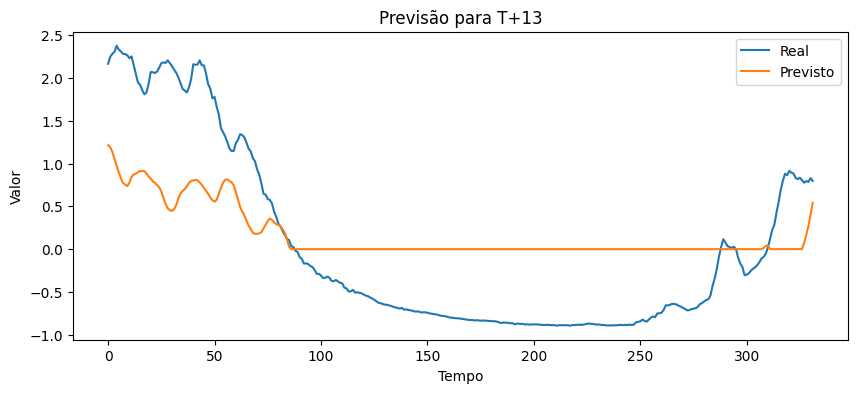

Horizonte 14: MSE = 0.660, RMSE = 0.812, R² = 0.415


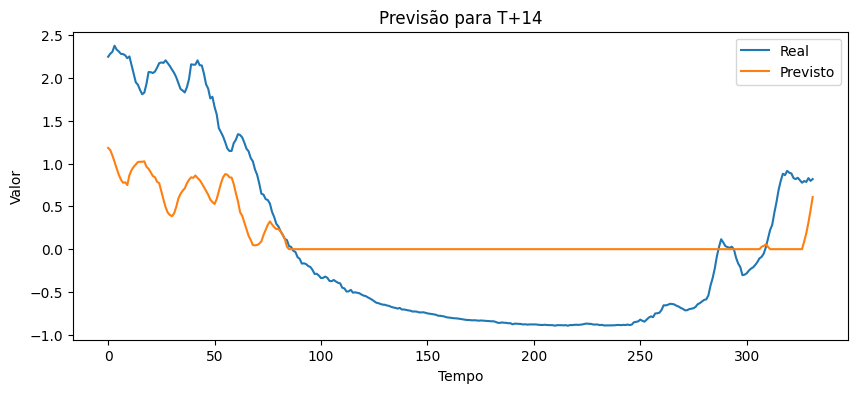

Horizonte 15: MSE = 0.736, RMSE = 0.858, R² = 0.340


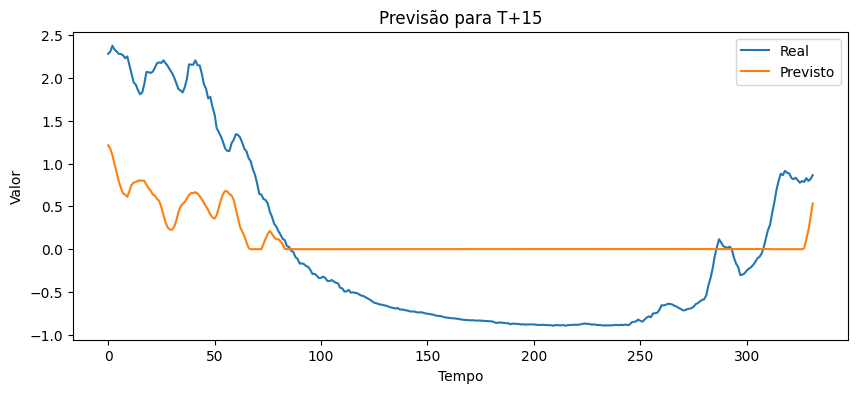

Horizonte 16: MSE = 0.695, RMSE = 0.834, R² = 0.369


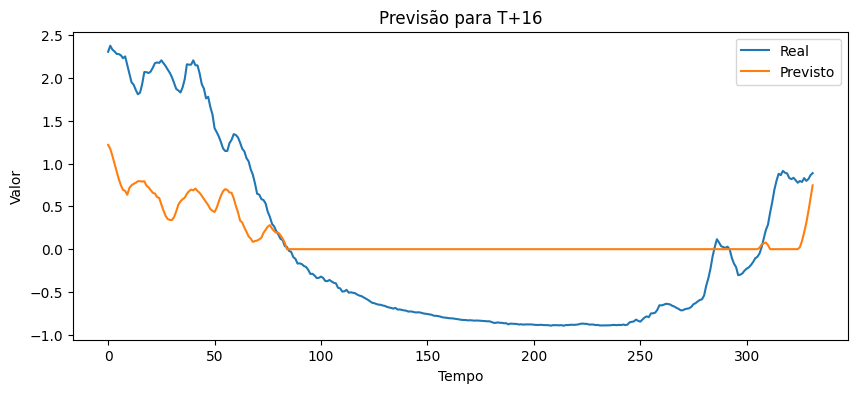

Horizonte 17: MSE = 0.711, RMSE = 0.843, R² = 0.347


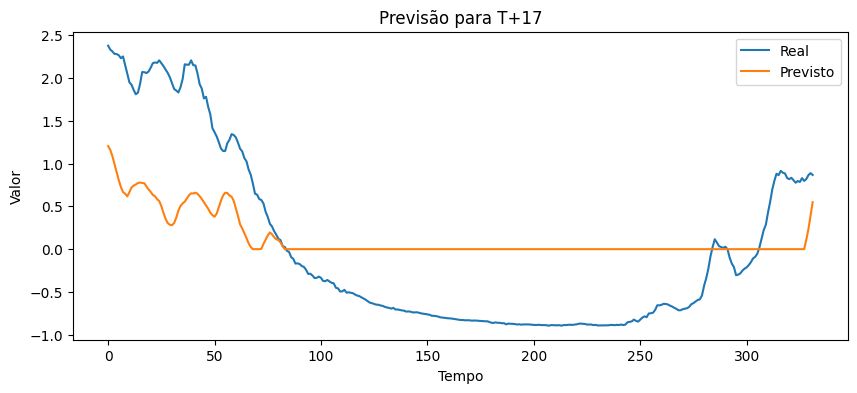

Horizonte 18: MSE = 0.807, RMSE = 0.899, R² = 0.248


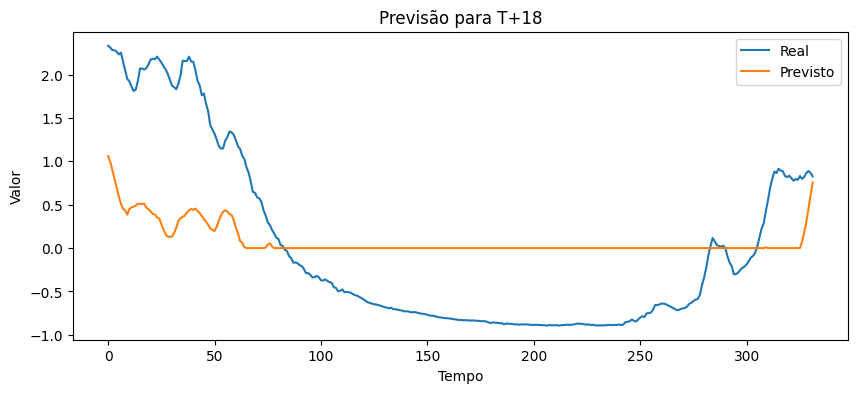

Horizonte 19: MSE = 0.753, RMSE = 0.868, R² = 0.289


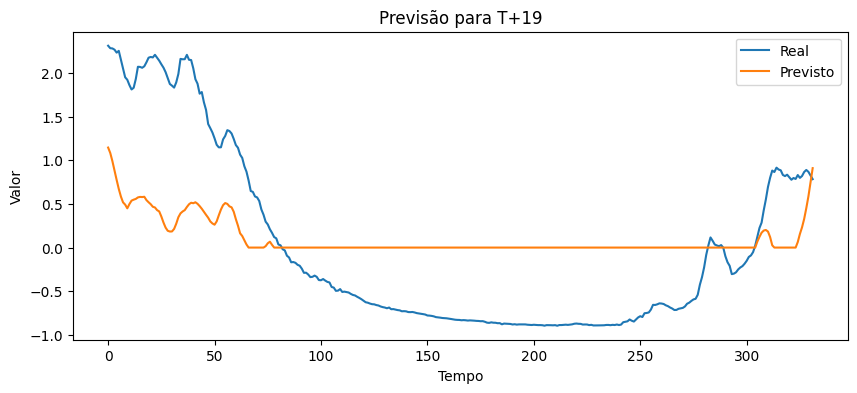

Horizonte 20: MSE = 0.885, RMSE = 0.941, R² = 0.153


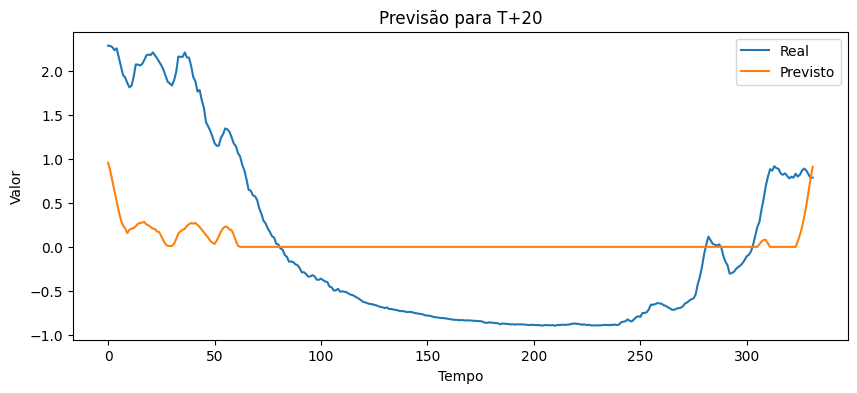

Horizonte 21: MSE = 0.708, RMSE = 0.841, R² = 0.313


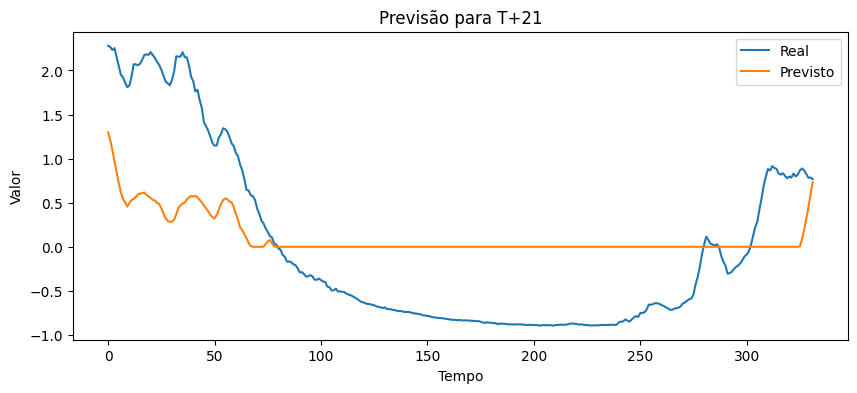

Horizonte 22: MSE = 0.812, RMSE = 0.901, R² = 0.202


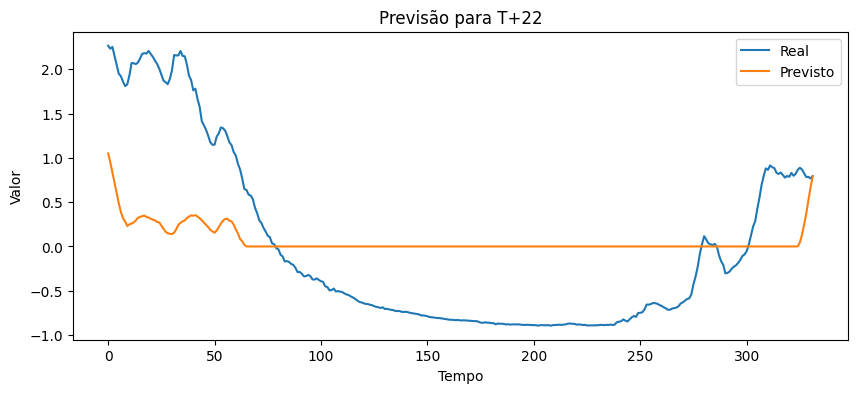

Horizonte 23: MSE = 0.702, RMSE = 0.838, R² = 0.300


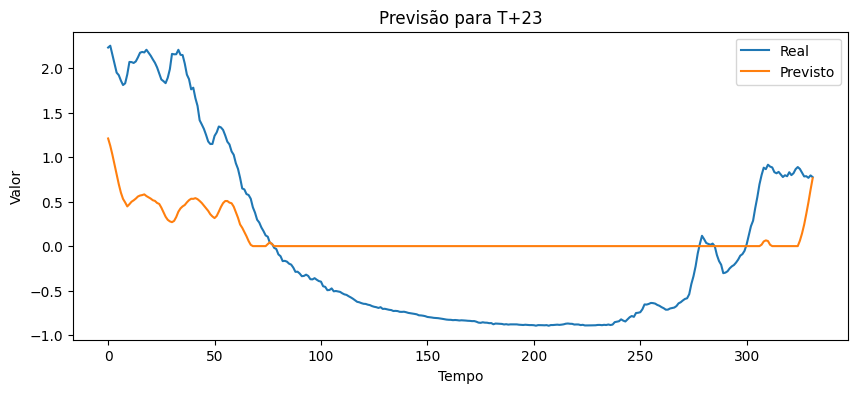

Horizonte 24: MSE = 0.950, RMSE = 0.975, R² = 0.040


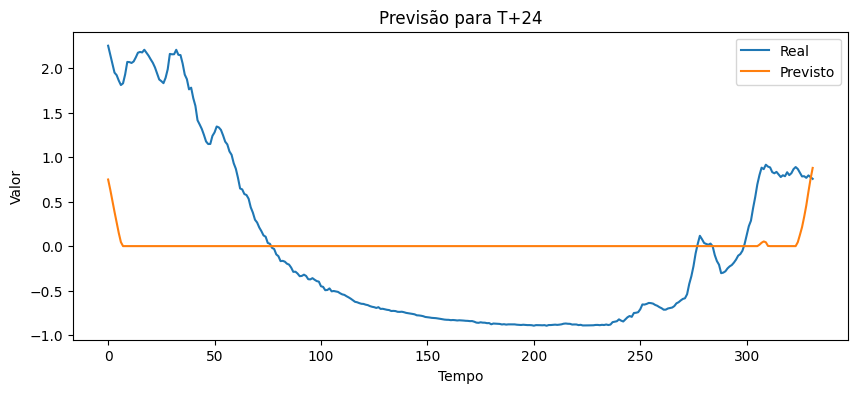

Horizonte 25: MSE = 0.719, RMSE = 0.848, R² = 0.264


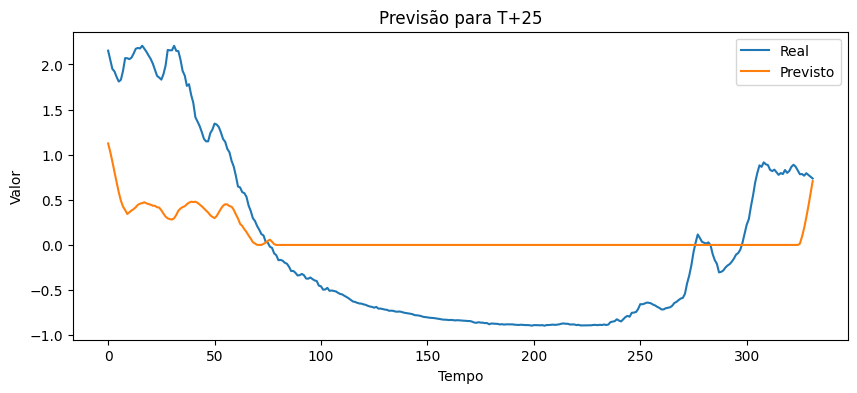

Horizonte 26: MSE = 0.921, RMSE = 0.960, R² = 0.044


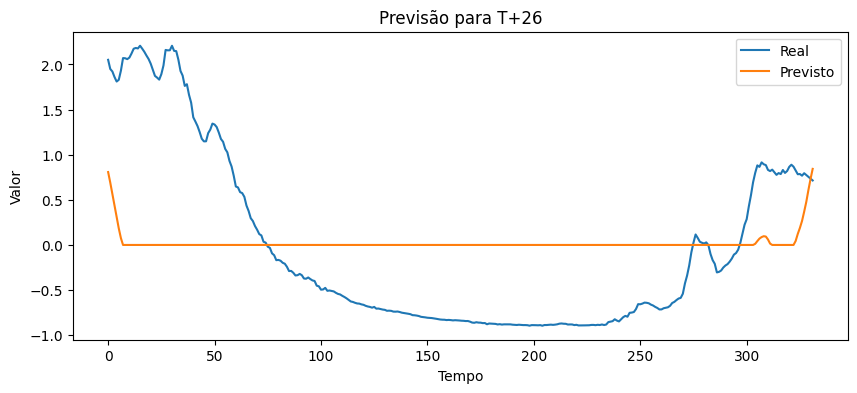

Horizonte 27: MSE = 0.852, RMSE = 0.923, R² = 0.106


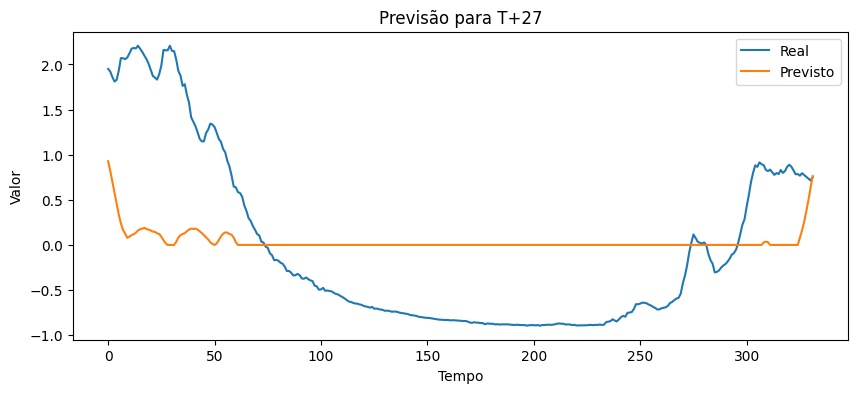

Horizonte 28: MSE = 0.912, RMSE = 0.955, R² = 0.032


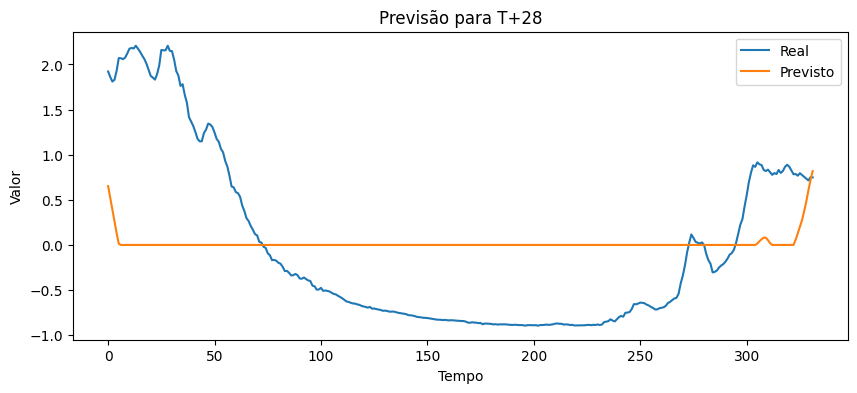

Horizonte 29: MSE = 0.875, RMSE = 0.935, R² = 0.062


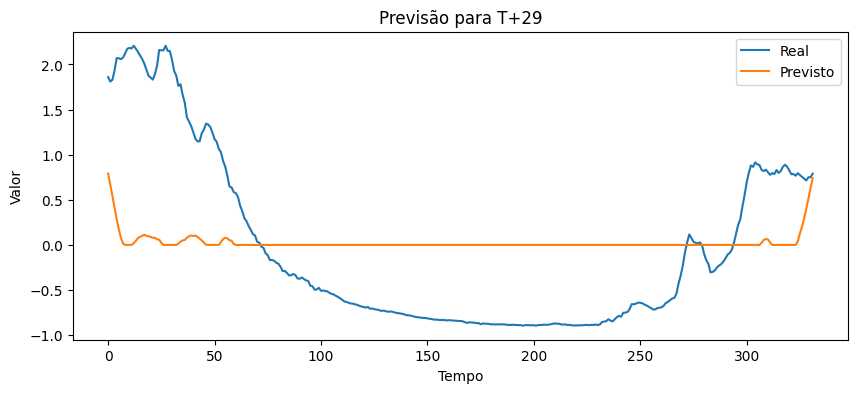

Horizonte 30: MSE = 0.896, RMSE = 0.946, R² = 0.031


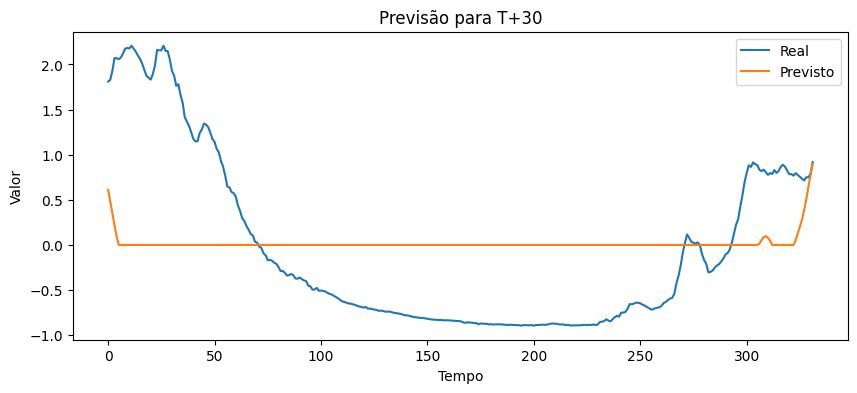

In [ ]:
# Modelo LSTM
regressor = Sequential()
regressor.add(LSTM(units=256, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
# regressor.add(LSTM(units=256, return_sequences=True))
# regressor.add(Dropout(0.2))
regressor.add(GRU(units=256, return_sequences=False))
regressor.add(Dropout(0.2))
# regressor.add(LSTM(units=64, return_sequences=False))
# regressor.add(Dropout(0.2))
regressor.add(Dense(units=n_future, activation='relu'))
# regressor.add(Dense(units=n_future, activation='linear'))
regressor.compile(optimizer='adam', loss='mse')

# Callbacks
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=5)

# Treinamento
history = regressor.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=40, batch_size=8, callbacks=[es])

# Avaliação e Visualização
y_pred = regressor.predict(X_test)

for i in range(n_future):
    y_true = y_test[:, i]
    y_pred_i = y_pred[:, i]

    mse = mean_squared_error(y_true, y_pred_i)
    rmse = sqrt(mse)
    r2 = r2_score(y_true, y_pred_i)

    print(f'Horizonte {i+1}: MSE = {mse:.3f}, RMSE = {rmse:.3f}, R² = {r2:.3f}')

    plt.figure(figsize=(10, 4))
    plt.plot(y_true, label='Real')
    plt.plot(y_pred_i, label='Previsto')
    plt.title(f'Previsão para T+{i+1}')
    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()


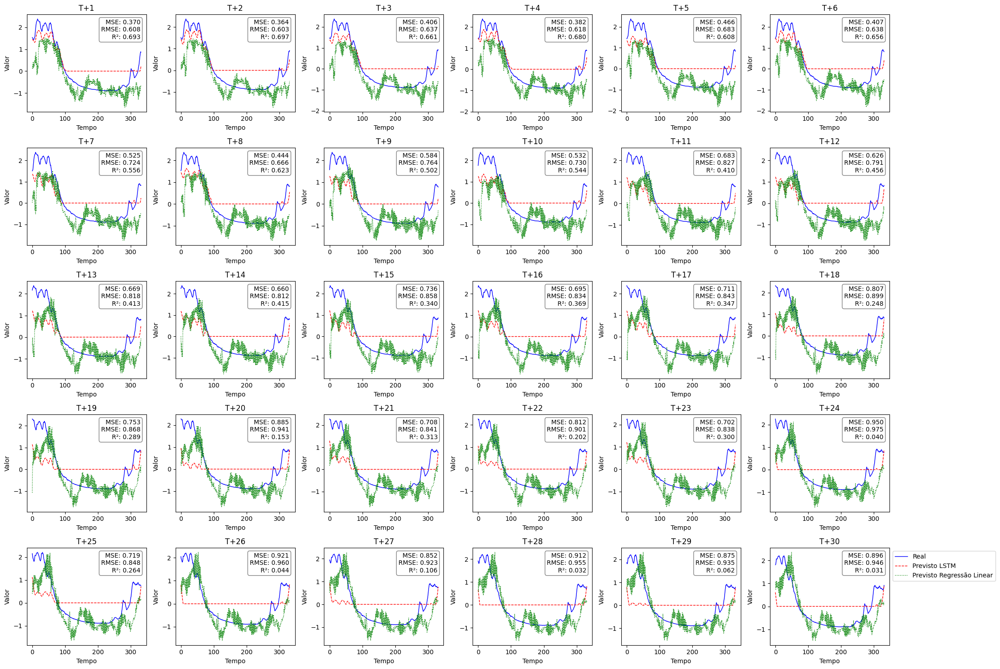

In [ ]:
# Número de linhas e colunas para os subplots
n_rows = 5
n_cols = 6
n_future = 30  # Número total de dias que você está prevendo

# Cria uma figura grande para acomodar todos os subplots
plt.figure(figsize=(20, 15))

# Itera sobre cada horizonte de tempo e cria um subplot para cada um
for i in range(n_future):
    ax = plt.subplot(n_rows, n_cols, i+1)
    plt.plot(y_test[:, i], label='Real', color='blue', linewidth=1)
    plt.plot(y_pred[:, i], label='Previsto LSTM', color='red', linestyle='dashed', linewidth=1)

    if i < y_pred_linear.shape[1]:
        plt.plot(y_pred_linear[:, i], label='Previsto Regressão Linear', color='green', linestyle='dotted', linewidth=1)

    plt.title(f'T+{i+1}')

    # Calcula as métricas para cada horizonte de tempo
    mse = mean_squared_error(y_test[:, i], y_pred[:, i])
    rmse = sqrt(mse)
    r2 = r2_score(y_test[:, i], y_pred[:, i])

    # Adiciona as métricas como texto no gráfico
    ax.text(0.95, 0.95, f'MSE: {mse:.3f}\nRMSE: {rmse:.3f}\nR²: {r2:.3f}',
            transform=ax.transAxes, verticalalignment='top', horizontalalignment='right',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

    plt.xlabel('Tempo')
    plt.ylabel('Valor')
    plt.tight_layout()

plt.legend(loc='upper left', bbox_to_anchor=(1,1))
plt.show()
